In [32]:
# Los imports necesarios
# Matplotlib para graficos, tensorflow/tensorflowhub/keras para entrenar el modelo, cv2 para la deteccion de imagenes

import cv2
import os
import sys
from glob import glob
import itertools

import matplotlib.pylab as plt
import numpy as np

import tensorflow as tf
import tensorflow_hub as hub

In [50]:
# Se obtiene MobileNetV2 de tensorflowhub
# Se usa el tamano de 96x96 para las imagenes
# Se escoge un batch size de 16

model_name = "mobilenet_v2_100_96"

model_handle_map = {
    "inception_v3": "https://tfhub.dev/google/imagenet/inception_v3/feature_vector/5",
    "inception_resnet_v2": "https://tfhub.dev/google/imagenet/inception_resnet_v2/feature_vector/5",
    "mobilenet_v2_100_96": "https://tfhub.dev/google/imagenet/mobilenet_v2_100_96/feature_vector/5",
    "efficientnet_b7": "https://tfhub.dev/tensorflow/efficientnet/b7/feature-vector/1",
    "vit_b8_fe": "https://tfhub.dev/sayakpaul/vit_b8_fe/1",
}

model_image_size_map = {
    "inception_v3": 96,
    "inception_resnet_v2": 96,
    "mobilenet_v2_100_96": 96,
    "efficientnet_b7": 96,
    "vit_b8_fe": 224
}

model_handle = model_handle_map.get(model_name)
pixels = model_image_size_map.get(model_name, 96)
IMAGE_SIZE = (pixels,pixels)
BATCH_SIZE = 16

(96, 96)


In [34]:
# Se hace el preprocesamiento al dataset de imagenes de train
# Funcion de build_dataset para preprocesar cada dataset

data_dir = "train"
def build_dataset(subset):
  # Esta funcion recibe un directorio con clases que contienen imagenes y lo preprocesa para usar como dataset
  return tf.keras.preprocessing.image_dataset_from_directory(
      data_dir,
      validation_split=.18,
      subset=subset,
      label_mode="categorical",

      seed=321,
      image_size=IMAGE_SIZE,
      batch_size=1)

In [35]:
# Se hace build al dataset de training y tambien el de validation
# Se guarda el tamano del dataset de train y de validation para usarlo cuando se hacen los epochs
# Se agregan las capas a la red neuronal 

train_ds = build_dataset("training")
class_names = tuple(train_ds.class_names)
train_size = train_ds.cardinality().numpy()
train_ds = train_ds.unbatch().batch(BATCH_SIZE)
train_ds = train_ds.repeat()

normalization_layer = tf.keras.layers.Rescaling(1. / 255)
preprocessing_model = tf.keras.Sequential([normalization_layer])
do_data_augmentation = True #@param {type:"boolean"}
if do_data_augmentation:
  preprocessing_model.add(tf.keras.layers.RandomRotation(40))
  preprocessing_model.add(tf.keras.layers.RandomRotation(0.4))
  preprocessing_model.add(tf.keras.layers.RandomTranslation(0, 0.2))
  preprocessing_model.add(tf.keras.layers.RandomTranslation(0.2, 0))
  preprocessing_model.add(tf.keras.layers.RandomZoom(0.2, 0.2))
  preprocessing_model.add(tf.keras.layers.RandomFlip(mode="horizontal_and_vertical"))
  preprocessing_model.add(tf.keras.layers.RandomContrast(0.2))
train_ds = train_ds.map(lambda images, labels:(preprocessing_model(images), labels))

val_ds = build_dataset("validation")
val_ds_all = val_ds
validation_size = val_ds.cardinality().numpy()
val_ds = val_ds.unbatch().batch(BATCH_SIZE)
val_ds = val_ds.map(lambda images, labels:(normalization_layer(images), labels))

do_fine_tuning = True 

Found 3172 files belonging to 70 classes.
Using 2602 files for training.
Found 3172 files belonging to 70 classes.
Using 570 files for validation.


In [36]:
# Se construye el modelo
model = tf.keras.Sequential([
    tf.keras.layers.InputLayer(input_shape=IMAGE_SIZE + (3,)),
    hub.KerasLayer(model_handle, trainable=do_fine_tuning),
    tf.keras.layers.Dropout(rate=0.5),
    tf.keras.layers.Dense(len(class_names), 
                          kernel_regularizer=tf.keras.regularizers.l2(0.0001))
])
model.build((None,)+IMAGE_SIZE+(3,))
model.summary() # Un resumen de la shape del modelo y las capas

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer_3 (KerasLayer)  (None, 1280)              2257984   
                                                                 
 dropout_3 (Dropout)         (None, 1280)              0         
                                                                 
 dense_3 (Dense)             (None, 70)                89670     
                                                                 
Total params: 2347654 (8.96 MB)
Trainable params: 2313542 (8.83 MB)
Non-trainable params: 34112 (133.25 KB)
_________________________________________________________________


In [37]:
# Se compila el modelo con 100 epochs y un loss rate de 0.005
epoch = 100
lr = 0.005

model.compile(
  optimizer=tf.keras.optimizers.SGD(learning_rate=lr, momentum=0.9, nesterov=False), 
  loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True, label_smoothing=0.1),
  metrics=['accuracy',tf.keras.metrics.TopKCategoricalAccuracy(name='top-5-accuracy')],)

callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=6)
reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2,patience=3, min_lr=0.00001)

In [38]:
# Creacion del checkpoint para guardar los weights del modelo

checkpoint_filepath = f"/tmp/{model_name}/cp"

checkpoint_filepath_end = f"/tmp/{model_name}"

if not os.path.exists(checkpoint_filepath_end):
            os.makedirs(checkpoint_filepath_end)

checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    checkpoint_filepath,
    monitor="val_accuracy",
    save_best_only=True,
    save_weights_only=True,
)

In [39]:
# Se entrena el modelo, utilizando 100 epochs con un batch size de 16

steps_per_epoch = train_size // BATCH_SIZE
validation_steps = validation_size // BATCH_SIZE
hist = model.fit(
    train_ds,
    epochs=epoch, steps_per_epoch=steps_per_epoch,
    validation_data=val_ds,
    validation_steps=validation_steps,
    callbacks=[reduce_lr, checkpoint_callback, callback]).history

Epoch 1/100


Exception ignored in: <function WeakKeyDictionary.__init__.<locals>.remove at 0x0000017102218F70>
Traceback (most recent call last):
  File "c:\Python310\lib\weakref.py", line 371, in remove
    self = selfref()
KeyboardInterrupt: 


162/162 [==============================] - 51s 274ms/step - loss: 4.4271 - accuracy: 0.0563 - top-5-accuracy: 0.1975 - val_loss: 6.5750 - val_accuracy: 0.0179 - val_top-5-accuracy: 0.0893 - lr: 0.0050
Epoch 2/100
162/162 [==============================] - 42s 259ms/step - loss: 3.5903 - accuracy: 0.1601 - top-5-accuracy: 0.4524 - val_loss: 3.8476 - val_accuracy: 0.1125 - val_top-5-accuracy: 0.4804 - lr: 0.0050
Epoch 3/100
162/162 [==============================] - 42s 257ms/step - loss: 3.1207 - accuracy: 0.2664 - top-5-accuracy: 0.6292 - val_loss: 3.2947 - val_accuracy: 0.2589 - val_top-5-accuracy: 0.6750 - lr: 0.0050
Epoch 4/100
162/162 [==============================] - 43s 265ms/step - loss: 2.8876 - accuracy: 0.3148 - top-5-accuracy: 0.7030 - val_loss: 2.8332 - val_accuracy: 0.3446 - val_top-5-accuracy: 0.7482 - lr: 0.0050
Epoch 5/100
162/162 [==============================] - 40s 244ms/step - loss: 2.6837 - accuracy: 0.3983 - top-5-accuracy: 0.7726 - val_loss: 3.0472 - val_accura

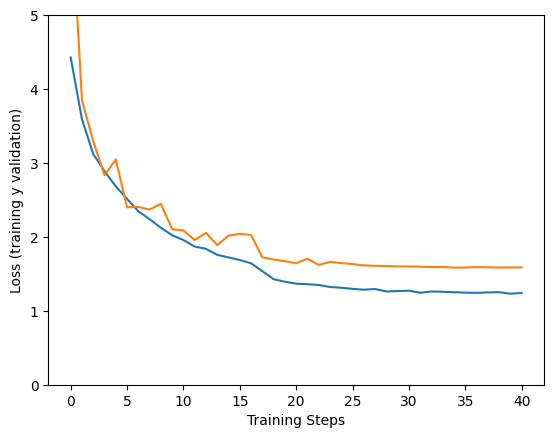

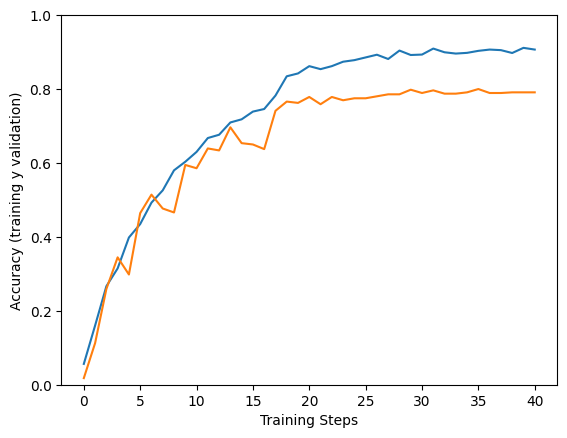

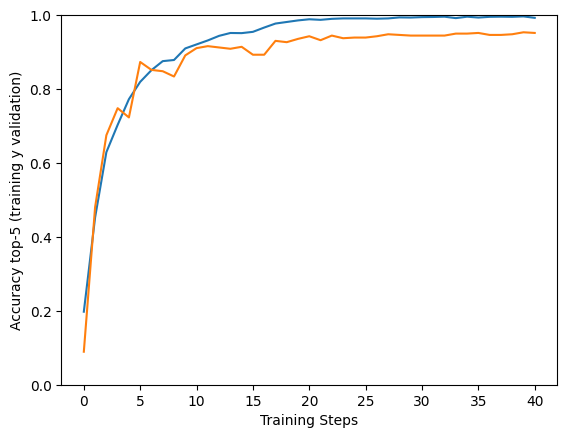

In [40]:
# Graficos con matplotlib para ver las estadisticas del training

plt.figure()
plt.ylabel("Loss (training y validation)")
plt.xlabel("Training Steps")
plt.ylim([0,5])
plt.plot(hist["loss"])
plt.plot(hist["val_loss"])

plt.figure()
plt.ylabel("Accuracy (training y validation)")
plt.xlabel("Training Steps")
plt.ylim([0,1])
plt.plot(hist["accuracy"])
plt.plot(hist["val_accuracy"])

plt.figure()
plt.ylabel("Accuracy top-5 (training y validation)")
plt.xlabel("Training Steps")
plt.ylim([0,1])
plt.plot(hist["top-5-accuracy"])
plt.plot(hist["val_top-5-accuracy"])

plt.show()

In [42]:
# Se evalua el modelo luego de haberlo entrenado

test_data_dir = "test"
model.load_weights(checkpoint_filepath)
test_ds = tf.keras.utils.image_dataset_from_directory(
  test_data_dir,
  image_size=IMAGE_SIZE,
  label_mode="categorical",
  batch_size=1)

test_ds = test_ds.map(lambda images, labels:(normalization_layer(images), labels))

_, accuracy, top_5_accuracy = model.evaluate(test_ds)
print(f"Accuracy test : {round(accuracy * 100, 2)}%")
print(f"Accuracy top 5 test: {round(top_5_accuracy * 100, 2)}%")

Found 1077 files belonging to 70 classes.
1077/1077 [==============================] - 10s 9ms/step - loss: 1.5216 - accuracy: 0.8124 - top-5-accuracy: 0.9526
Accuracy test : 81.24%
Accuracy top 5 test: 95.26%


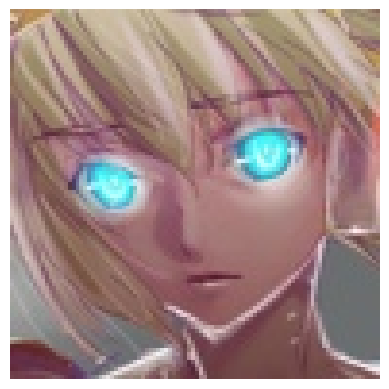

Label verdadera: Aegis-Persona
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Aegis-Persona : 47.92 % confianza.
> Sinon-Sword Art Online : 14.31 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 5.16 % confianza.
> Gawr Gura-Hololive : 3.89 % confianza.
> Miku Nakano-Quintessential Quintuplets : 3.14 % confianza.


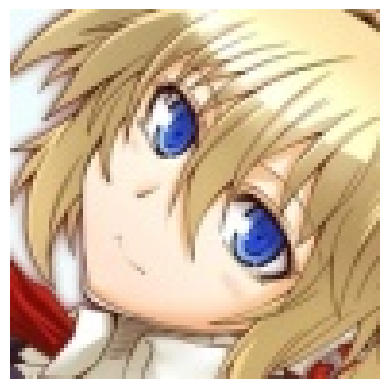

Label verdadera: Aegis-Persona
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Aegis-Persona : 54.48 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 26.11 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 2.16 % confianza.
> Kotobuki Tsumugi-K ON! : 1.52 % confianza.
> Amelia Watson-Hololive : 1.45 % confianza.


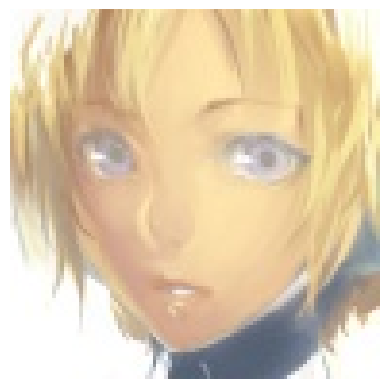

Label verdadera: Aegis-Persona
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Aegis-Persona : 37.92 % confianza.
> Amelia Watson-Hololive : 25.19 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 4.90 % confianza.
> Sinon-Sword Art Online : 4.83 % confianza.
> Emilia-Re Zero : 2.71 % confianza.


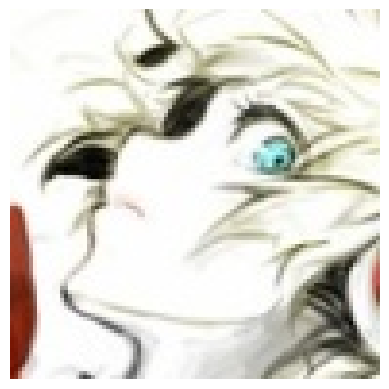

Label verdadera: Aegis-Persona
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Aegis-Persona : 33.21 % confianza.
> Sinon-Sword Art Online : 30.96 % confianza.
> Fubuki-One Punch Man : 10.84 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 4.03 % confianza.
> Kurisu Makise-Steins Gate : 2.56 % confianza.


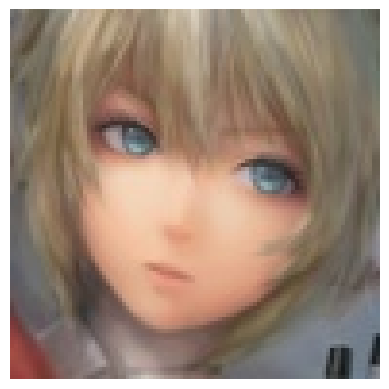

Label verdadera: Aegis-Persona
Este personaje posiblemente es:
1/1 [==============================] - 0s 35ms/step
> Aegis-Persona : 69.60 % confianza.
> Amelia Watson-Hololive : 6.28 % confianza.
> Ouro Kronii-Hololive : 3.63 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 3.22 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 2.77 % confianza.


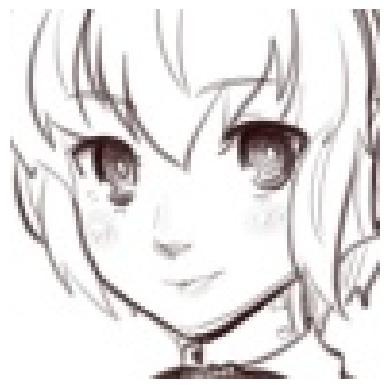

Label verdadera: Aegis-Persona
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Asuna Yuuki-Sword Art Online : 22.57 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 14.44 % confianza.
> Gawr Gura-Hololive : 13.98 % confianza.
> Miku Nakano-Quintessential Quintuplets : 11.50 % confianza.
> Maki Nishikino-Love Live : 7.52 % confianza.


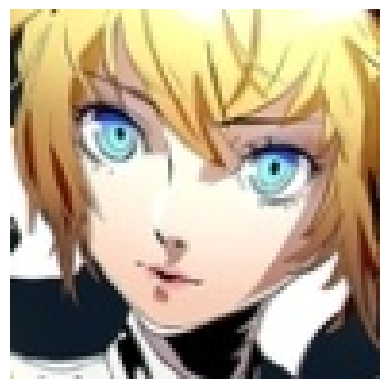

Label verdadera: Aegis-Persona
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Aegis-Persona : 96.25 % confianza.
> Amelia Watson-Hololive : 0.47 % confianza.
> Sinon-Sword Art Online : 0.32 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 0.32 % confianza.
> C.C-Code Geass : 0.29 % confianza.


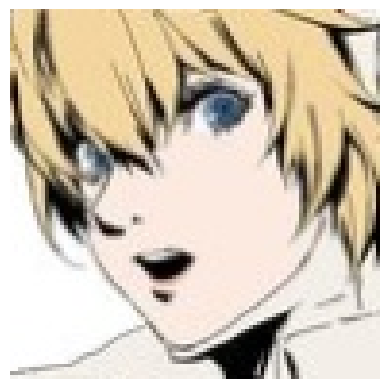

Label verdadera: Aegis-Persona
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Aegis-Persona : 84.65 % confianza.
> Asuna Yuuki-Sword Art Online : 4.24 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 2.39 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 1.98 % confianza.
> Sinon-Sword Art Online : 1.54 % confianza.


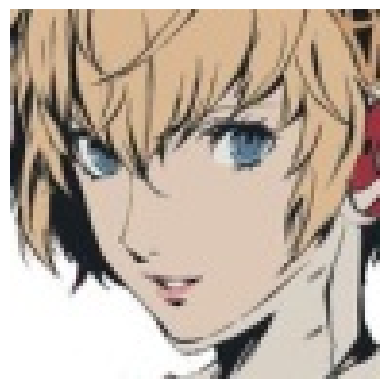

Label verdadera: Aegis-Persona
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Aegis-Persona : 67.10 % confianza.
> Amelia Watson-Hololive : 27.95 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 0.82 % confianza.
> Asuna Yuuki-Sword Art Online : 0.60 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 0.58 % confianza.


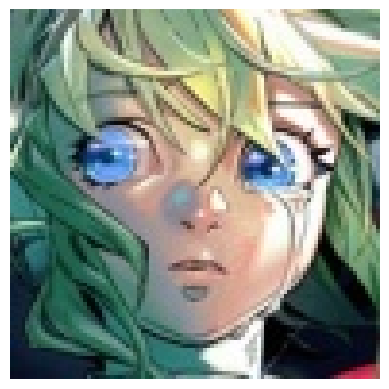

Label verdadera: Aegis-Persona
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Aegis-Persona : 41.11 % confianza.
> Sinon-Sword Art Online : 36.91 % confianza.
> C.C-Code Geass : 6.44 % confianza.
> Cirno-Touhou : 3.18 % confianza.
> Hatsune Miku-Vocaloid : 1.00 % confianza.


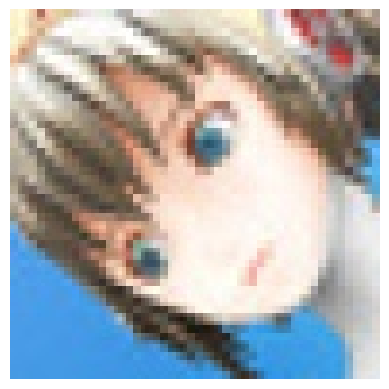

Label verdadera: Aegis-Persona
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Jonathan Joestar-Jojos Bizarre Adventure : 39.30 % confianza.
> Ouro Kronii-Hololive : 11.56 % confianza.
> Fubuki-One Punch Man : 11.33 % confianza.
> Aqua-Konosuba : 3.87 % confianza.
> Aegis-Persona : 2.95 % confianza.


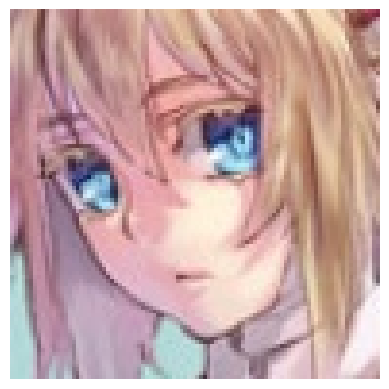

Label verdadera: Aegis-Persona
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Amelia Watson-Hololive : 59.52 % confianza.
> Aegis-Persona : 11.74 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 8.35 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 2.20 % confianza.
> Saber-Fate : 1.22 % confianza.


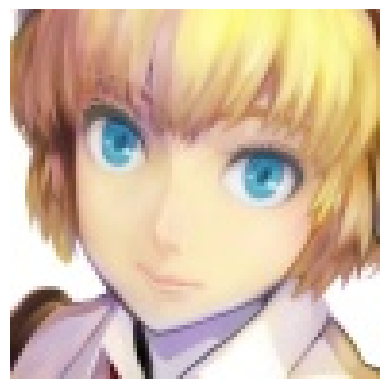

Label verdadera: Aegis-Persona
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Amelia Watson-Hololive : 61.81 % confianza.
> Aegis-Persona : 21.34 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 5.92 % confianza.
> Suzaku Kururugi-Code Geass : 0.78 % confianza.
> Saber-Fate : 0.73 % confianza.


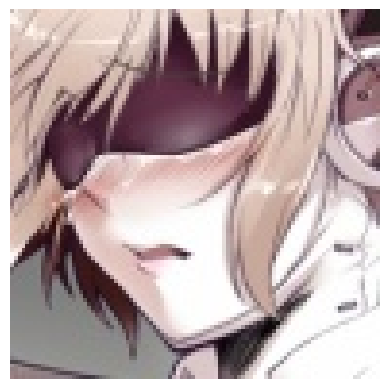

Label verdadera: Aegis-Persona
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Paimon-Genshin Impact : 41.49 % confianza.
> Kirito-Sword Art Online : 12.78 % confianza.
> Albedo-Overlord : 11.42 % confianza.
> Astolfo-Fate : 6.56 % confianza.
> Shinobu Kochou-Demon Slayer : 2.80 % confianza.


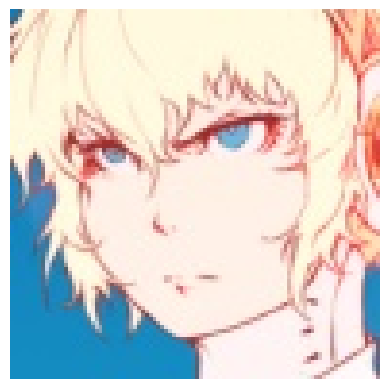

Label verdadera: Aegis-Persona
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Jonathan Joestar-Jojos Bizarre Adventure : 13.56 % confianza.
> Reimu Hakurei-Touhou : 8.00 % confianza.
> Nino Nakano-Quintessential Quintuplets : 7.83 % confianza.
> Nezuko Kamado-Demon Slayer : 5.26 % confianza.
> Sinon-Sword Art Online : 3.65 % confianza.


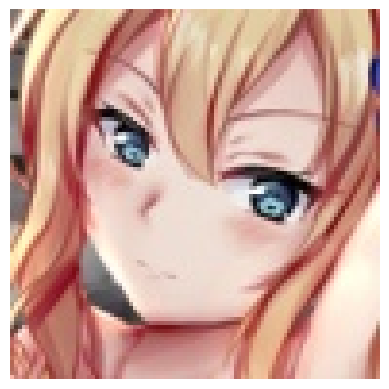

Label verdadera: Ai Hayasaka-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 39ms/step
> Ai Hayasaka-Kaguya Sama Love Is War : 44.13 % confianza.
> Miku Nakano-Quintessential Quintuplets : 18.76 % confianza.
> Paimon-Genshin Impact : 4.01 % confianza.
> Nico Robin-One Piece : 3.64 % confianza.
> Zero Two-Darling In the Franxx : 3.37 % confianza.


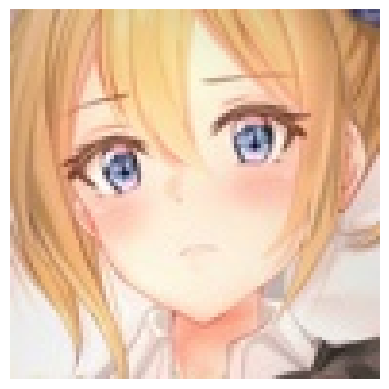

Label verdadera: Ai Hayasaka-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Amelia Watson-Hololive : 51.50 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 9.86 % confianza.
> Asuna Yuuki-Sword Art Online : 8.09 % confianza.
> Nami-One Piece : 6.06 % confianza.
> Aegis-Persona : 2.69 % confianza.


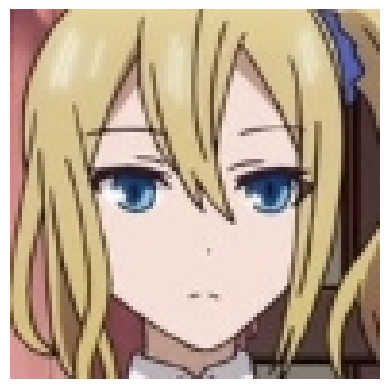

Label verdadera: Ai Hayasaka-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Aegis-Persona : 71.70 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 21.39 % confianza.
> Kotobuki Tsumugi-K ON! : 2.10 % confianza.
> Amelia Watson-Hololive : 0.81 % confianza.
> Hifumi Takimoto-New Game! : 0.60 % confianza.


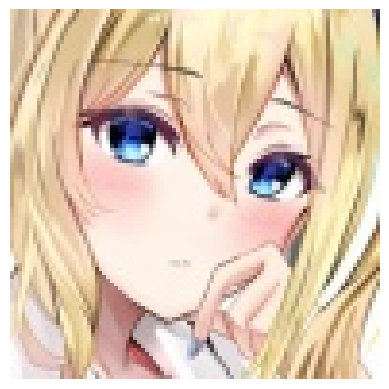

Label verdadera: Ai Hayasaka-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Amelia Watson-Hololive : 68.86 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 12.56 % confianza.
> Aegis-Persona : 4.05 % confianza.
> Asuna Yuuki-Sword Art Online : 1.83 % confianza.
> Paimon-Genshin Impact : 0.80 % confianza.


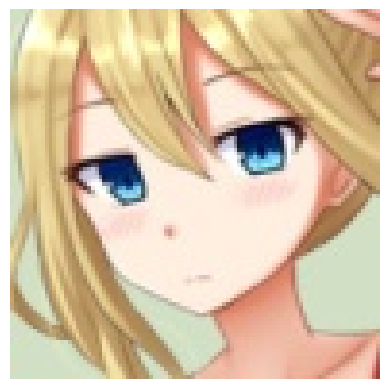

Label verdadera: Ai Hayasaka-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Ai Hayasaka-Kaguya Sama Love Is War : 60.39 % confianza.
> Aegis-Persona : 10.43 % confianza.
> Amelia Watson-Hololive : 3.79 % confianza.
> Kotobuki Tsumugi-K ON! : 2.66 % confianza.
> C.C-Code Geass : 2.38 % confianza.


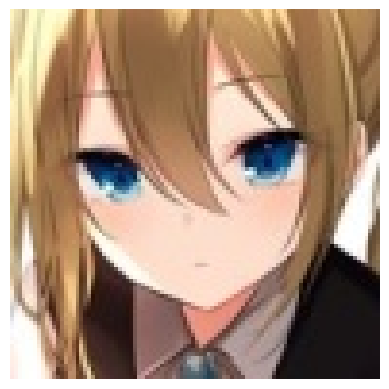

Label verdadera: Ai Hayasaka-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 35ms/step
> Ai Hayasaka-Kaguya Sama Love Is War : 52.23 % confianza.
> Miku Nakano-Quintessential Quintuplets : 26.01 % confianza.
> Kurisu Makise-Steins Gate : 7.13 % confianza.
> Hifumi Takimoto-New Game! : 2.08 % confianza.
> Kirito-Sword Art Online : 1.47 % confianza.


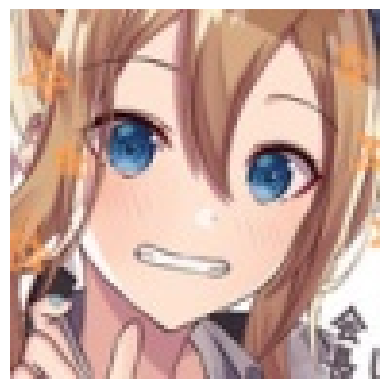

Label verdadera: Ai Hayasaka-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Ai Hayasaka-Kaguya Sama Love Is War : 90.25 % confianza.
> Miku Nakano-Quintessential Quintuplets : 3.52 % confianza.
> Aegis-Persona : 0.52 % confianza.
> Hifumi Takimoto-New Game! : 0.48 % confianza.
> Amelia Watson-Hololive : 0.48 % confianza.


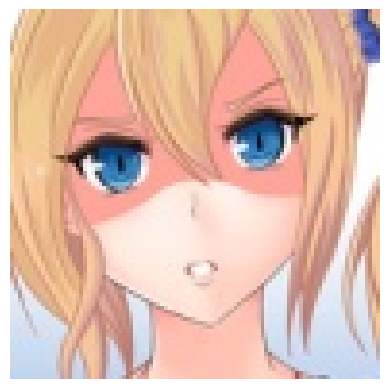

Label verdadera: Ai Hayasaka-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Ai Hayasaka-Kaguya Sama Love Is War : 52.49 % confianza.
> Amelia Watson-Hololive : 37.17 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 1.36 % confianza.
> Paimon-Genshin Impact : 0.85 % confianza.
> Gawr Gura-Hololive : 0.75 % confianza.


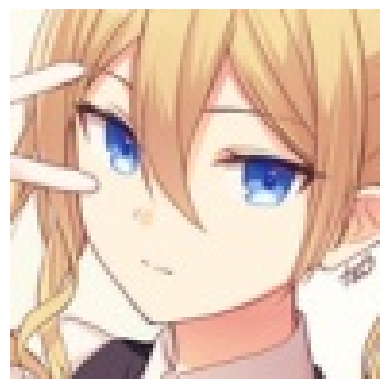

Label verdadera: Ai Hayasaka-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Ai Hayasaka-Kaguya Sama Love Is War : 90.30 % confianza.
> Amelia Watson-Hololive : 2.16 % confianza.
> Miku Nakano-Quintessential Quintuplets : 1.18 % confianza.
> Aegis-Persona : 0.91 % confianza.
> Kurisu Makise-Steins Gate : 0.49 % confianza.


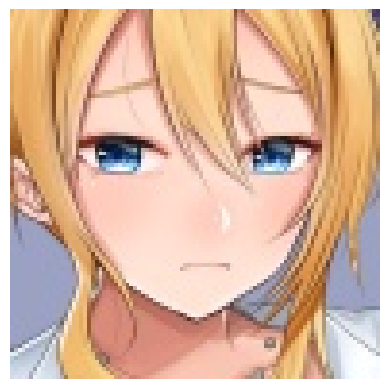

Label verdadera: Ai Hayasaka-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Ai Hayasaka-Kaguya Sama Love Is War : 91.49 % confianza.
> Amelia Watson-Hololive : 3.77 % confianza.
> Aegis-Persona : 2.52 % confianza.
> Kotobuki Tsumugi-K ON! : 0.26 % confianza.
> Asuna Yuuki-Sword Art Online : 0.22 % confianza.


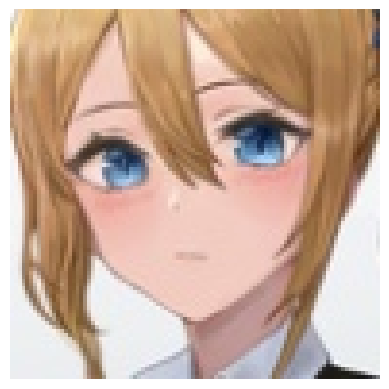

Label verdadera: Ai Hayasaka-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Ai Hayasaka-Kaguya Sama Love Is War : 91.08 % confianza.
> Miku Nakano-Quintessential Quintuplets : 2.65 % confianza.
> Kurisu Makise-Steins Gate : 0.62 % confianza.
> Aegis-Persona : 0.50 % confianza.
> Ritsu Tainaka-K ON! : 0.34 % confianza.


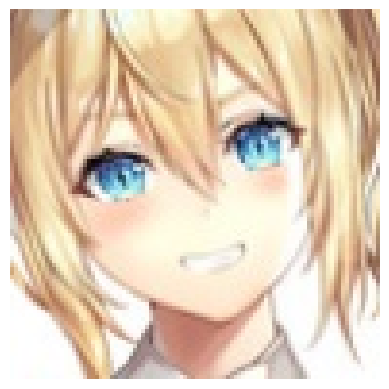

Label verdadera: Ai Hayasaka-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Amelia Watson-Hololive : 88.93 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 1.99 % confianza.
> Aegis-Persona : 1.48 % confianza.
> Gawr Gura-Hololive : 0.90 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.82 % confianza.


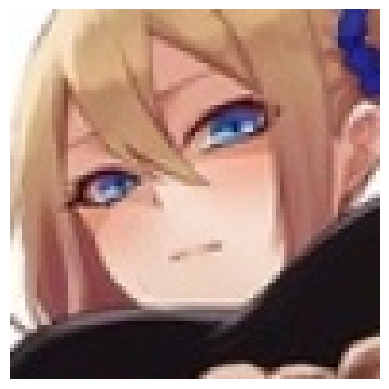

Label verdadera: Ai Hayasaka-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Ai Hayasaka-Kaguya Sama Love Is War : 91.39 % confianza.
> Amelia Watson-Hololive : 1.58 % confianza.
> Aegis-Persona : 1.28 % confianza.
> Hifumi Takimoto-New Game! : 0.71 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.59 % confianza.


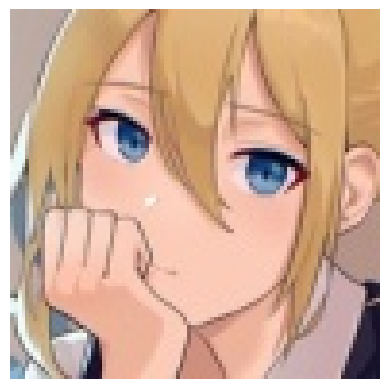

Label verdadera: Ai Hayasaka-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 36ms/step
> Ai Hayasaka-Kaguya Sama Love Is War : 98.96 % confianza.
> Miku Nakano-Quintessential Quintuplets : 0.17 % confianza.
> Amelia Watson-Hololive : 0.16 % confianza.
> Aegis-Persona : 0.08 % confianza.
> Paimon-Genshin Impact : 0.07 % confianza.


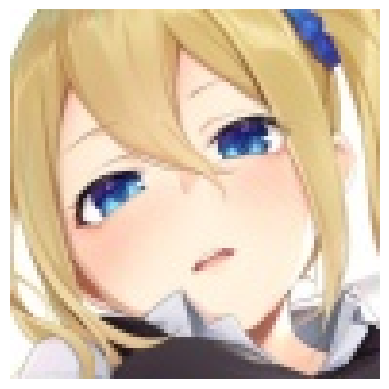

Label verdadera: Ai Hayasaka-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Ai Hayasaka-Kaguya Sama Love Is War : 96.84 % confianza.
> Paimon-Genshin Impact : 0.74 % confianza.
> Aegis-Persona : 0.39 % confianza.
> Amelia Watson-Hololive : 0.27 % confianza.
> Kotobuki Tsumugi-K ON! : 0.19 % confianza.


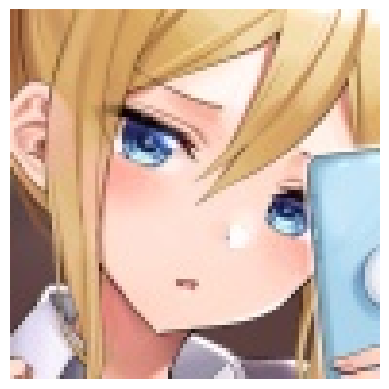

Label verdadera: Ai Hayasaka-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Ai Hayasaka-Kaguya Sama Love Is War : 96.87 % confianza.
> Aegis-Persona : 0.60 % confianza.
> Amelia Watson-Hololive : 0.50 % confianza.
> Miku Nakano-Quintessential Quintuplets : 0.44 % confianza.
> Sinon-Sword Art Online : 0.12 % confianza.


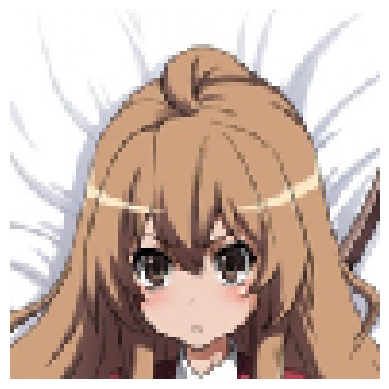

Label verdadera: Aisaka Taiga-Toradora
Este personaje posiblemente es:
1/1 [==============================] - 0s 38ms/step
> Aisaka Taiga-Toradora : 91.74 % confianza.
> Kotobuki Tsumugi-K ON! : 3.32 % confianza.
> Saber-Fate : 0.82 % confianza.
> Maka Albarn-Soul Eater : 0.69 % confianza.
> Yui Hirasawa-K ON! : 0.43 % confianza.


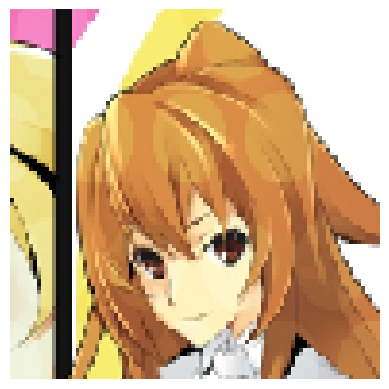

Label verdadera: Aisaka Taiga-Toradora
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Aisaka Taiga-Toradora : 54.58 % confianza.
> Yui Hirasawa-K ON! : 25.25 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 8.49 % confianza.
> Arcueid Brunestud-Tsukihime : 1.52 % confianza.
> Shirley Fenette-Code Geass : 1.26 % confianza.


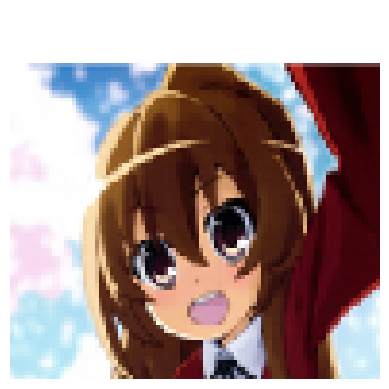

Label verdadera: Aisaka Taiga-Toradora
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Yui Hirasawa-K ON! : 90.09 % confianza.
> Shirley Fenette-Code Geass : 1.04 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.95 % confianza.
> Aisaka Taiga-Toradora : 0.91 % confianza.
> Suzaku Kururugi-Code Geass : 0.70 % confianza.


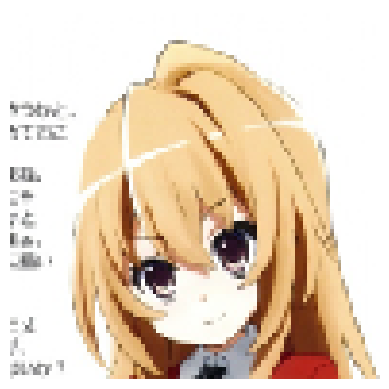

Label verdadera: Aisaka Taiga-Toradora
Este personaje posiblemente es:
1/1 [==============================] - 0s 38ms/step
> Aisaka Taiga-Toradora : 29.90 % confianza.
> Kotobuki Tsumugi-K ON! : 23.65 % confianza.
> Arcueid Brunestud-Tsukihime : 11.93 % confianza.
> Flandre Scarlet-Touhou : 6.34 % confianza.
> Saber-Fate : 3.44 % confianza.


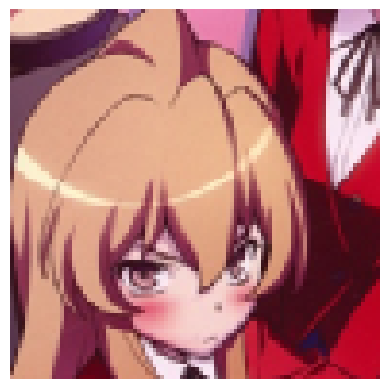

Label verdadera: Aisaka Taiga-Toradora
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Maki Nishikino-Love Live : 47.28 % confianza.
> Yoko Littner-Gurrenn Lagann : 9.35 % confianza.
> Maka Albarn-Soul Eater : 7.31 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 5.35 % confianza.
> Flandre Scarlet-Touhou : 3.19 % confianza.


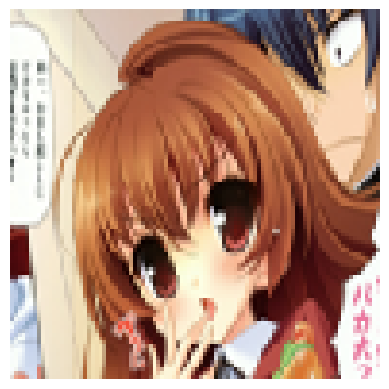

Label verdadera: Aisaka Taiga-Toradora
Este personaje posiblemente es:
1/1 [==============================] - 0s 34ms/step
> Aisaka Taiga-Toradora : 52.56 % confianza.
> Yui Hirasawa-K ON! : 23.82 % confianza.
> Reimu Hakurei-Touhou : 6.37 % confianza.
> Shirley Fenette-Code Geass : 4.41 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 2.33 % confianza.


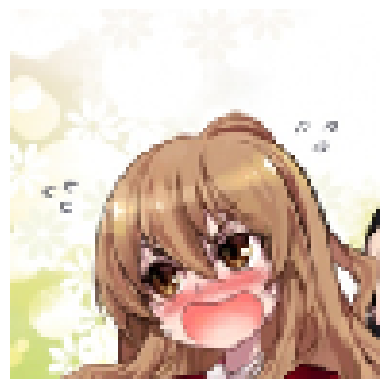

Label verdadera: Aisaka Taiga-Toradora
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Aisaka Taiga-Toradora : 90.74 % confianza.
> Shirley Fenette-Code Geass : 2.03 % confianza.
> Flandre Scarlet-Touhou : 0.96 % confianza.
> Arcueid Brunestud-Tsukihime : 0.92 % confianza.
> Saber-Fate : 0.82 % confianza.


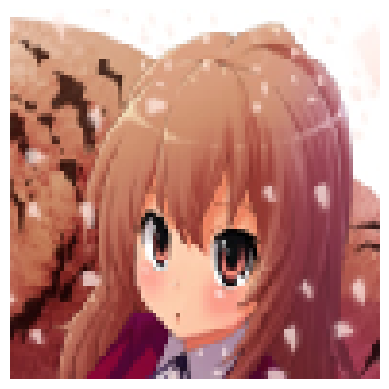

Label verdadera: Aisaka Taiga-Toradora
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Suzaku Kururugi-Code Geass : 29.94 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 17.99 % confianza.
> Saber-Fate : 16.62 % confianza.
> Kallen Stadtfeld-Code Geass : 10.25 % confianza.
> Rin Tohsakaka-Fate : 4.85 % confianza.


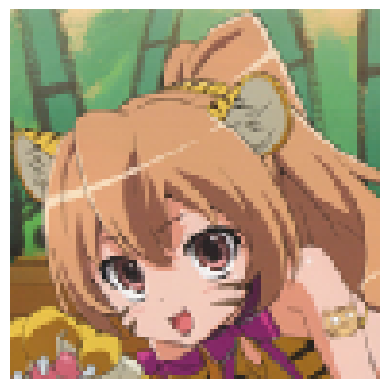

Label verdadera: Aisaka Taiga-Toradora
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Aisaka Taiga-Toradora : 97.96 % confianza.
> Yui Hirasawa-K ON! : 0.83 % confianza.
> Shirley Fenette-Code Geass : 0.24 % confianza.
> Nia Teppelin-Gurrenn Lagann : 0.18 % confianza.
> Raphtalia-Rising of the Shield Hero : 0.13 % confianza.


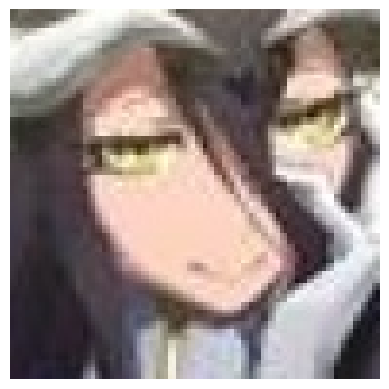

Label verdadera: Albedo-Overlord
Este personaje posiblemente es:
1/1 [==============================] - 0s 32ms/step
> Albedo-Overlord : 98.30 % confianza.
> Kirito-Sword Art Online : 0.80 % confianza.
> Nico Robin-One Piece : 0.22 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.08 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 0.07 % confianza.


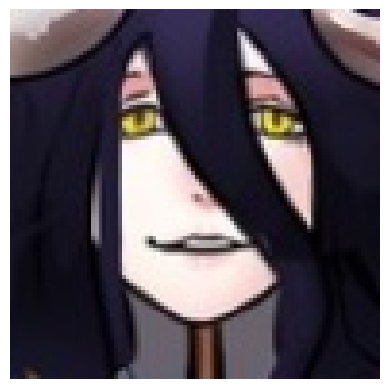

Label verdadera: Albedo-Overlord
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Albedo-Overlord : 98.24 % confianza.
> Kirito-Sword Art Online : 0.75 % confianza.
> Nico Robin-One Piece : 0.15 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.06 % confianza.
> Hinata Hyuuga-Naruto : 0.06 % confianza.


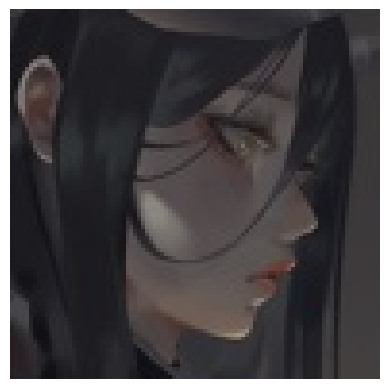

Label verdadera: Albedo-Overlord
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Albedo-Overlord : 96.85 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 0.64 % confianza.
> Gawr Gura-Hololive : 0.35 % confianza.
> Fubuki-One Punch Man : 0.31 % confianza.
> Scarlet Remilia-Touhou : 0.29 % confianza.


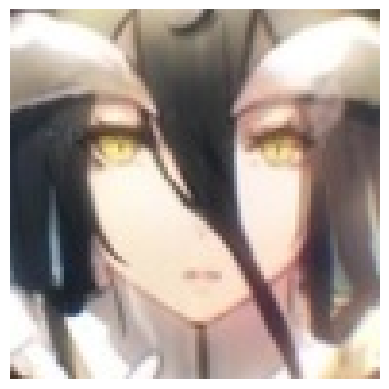

Label verdadera: Albedo-Overlord
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Albedo-Overlord : 99.72 % confianza.
> Kirito-Sword Art Online : 0.07 % confianza.
> Nico Robin-One Piece : 0.03 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.02 % confianza.
> Paimon-Genshin Impact : 0.01 % confianza.


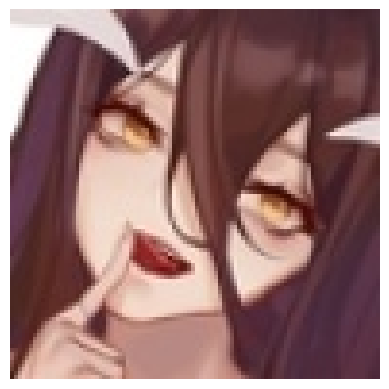

Label verdadera: Albedo-Overlord
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Albedo-Overlord : 98.60 % confianza.
> Kirito-Sword Art Online : 0.73 % confianza.
> Megumin-Konosuba : 0.23 % confianza.
> Miku Nakano-Quintessential Quintuplets : 0.06 % confianza.
> Nico Robin-One Piece : 0.05 % confianza.


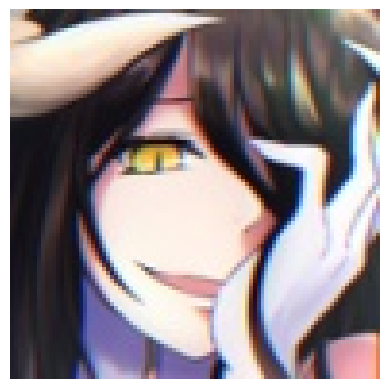

Label verdadera: Albedo-Overlord
Este personaje posiblemente es:
1/1 [==============================] - 0s 33ms/step
> Albedo-Overlord : 93.64 % confianza.
> Nico Robin-One Piece : 0.96 % confianza.
> Nezuko Kamado-Demon Slayer : 0.46 % confianza.
> Lelouch Lamperouge-Code Geass : 0.45 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.43 % confianza.


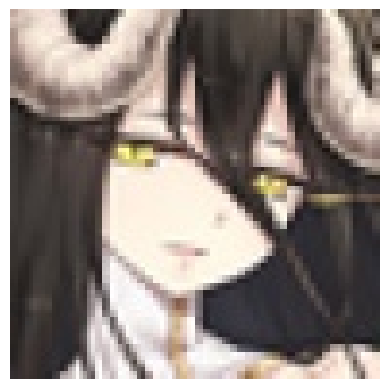

Label verdadera: Albedo-Overlord
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Albedo-Overlord : 99.19 % confianza.
> Nico Robin-One Piece : 0.28 % confianza.
> Kirito-Sword Art Online : 0.20 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.04 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.04 % confianza.


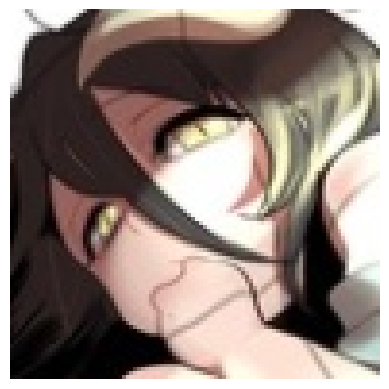

Label verdadera: Albedo-Overlord
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Albedo-Overlord : 91.70 % confianza.
> Kirito-Sword Art Online : 6.39 % confianza.
> Nico Robin-One Piece : 0.44 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.24 % confianza.
> Lelouch Lamperouge-Code Geass : 0.17 % confianza.


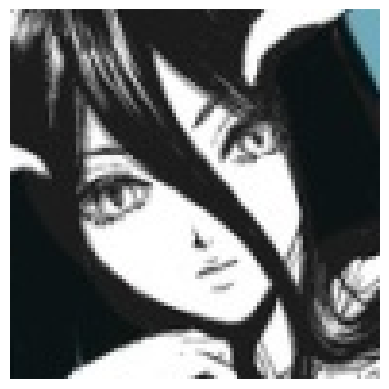

Label verdadera: Albedo-Overlord
Este personaje posiblemente es:
1/1 [==============================] - 0s 35ms/step
> Albedo-Overlord : 67.01 % confianza.
> Kirito-Sword Art Online : 21.38 % confianza.
> Shiki Ryougi-Garden of Sinners : 3.27 % confianza.
> Nico Robin-One Piece : 1.03 % confianza.
> Kurisu Makise-Steins Gate : 0.74 % confianza.


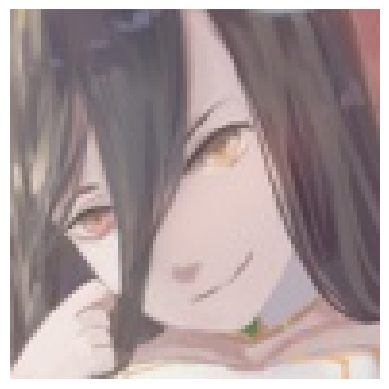

Label verdadera: Albedo-Overlord
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Albedo-Overlord : 89.90 % confianza.
> Kirito-Sword Art Online : 1.77 % confianza.
> Nico Robin-One Piece : 1.04 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.97 % confianza.
> Astolfo-Fate : 0.70 % confianza.


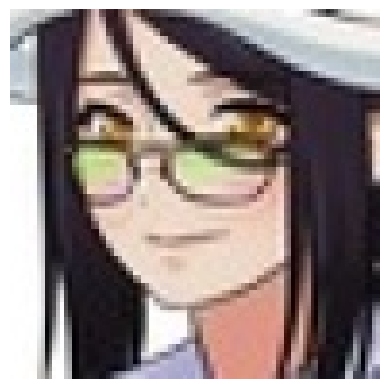

Label verdadera: Albedo-Overlord
Este personaje posiblemente es:
1/1 [==============================] - 0s 37ms/step
> Albedo-Overlord : 42.36 % confianza.
> Nico Robin-One Piece : 8.54 % confianza.
> Maka Albarn-Soul Eater : 6.49 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 5.11 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 4.23 % confianza.


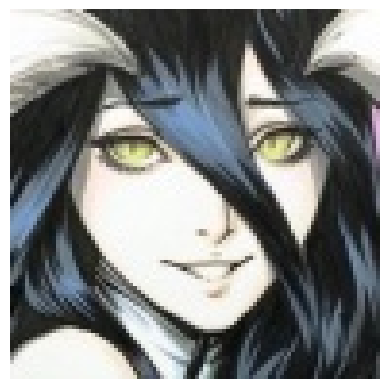

Label verdadera: Albedo-Overlord
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Albedo-Overlord : 98.82 % confianza.
> Kirito-Sword Art Online : 0.71 % confianza.
> Nico Robin-One Piece : 0.11 % confianza.
> Sinon-Sword Art Online : 0.05 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.05 % confianza.


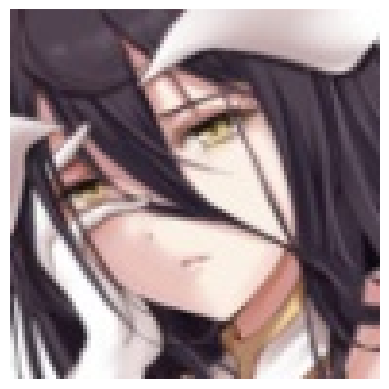

Label verdadera: Albedo-Overlord
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Albedo-Overlord : 99.18 % confianza.
> Kirito-Sword Art Online : 0.45 % confianza.
> Nico Robin-One Piece : 0.09 % confianza.
> Lelouch Lamperouge-Code Geass : 0.04 % confianza.
> Paimon-Genshin Impact : 0.03 % confianza.


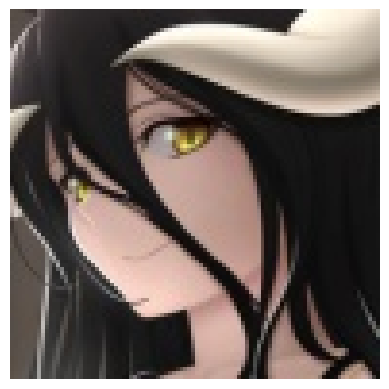

Label verdadera: Albedo-Overlord
Este personaje posiblemente es:
1/1 [==============================] - 0s 32ms/step
> Albedo-Overlord : 99.74 % confianza.
> Kirito-Sword Art Online : 0.10 % confianza.
> Nico Robin-One Piece : 0.04 % confianza.
> Lelouch Lamperouge-Code Geass : 0.01 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 0.01 % confianza.


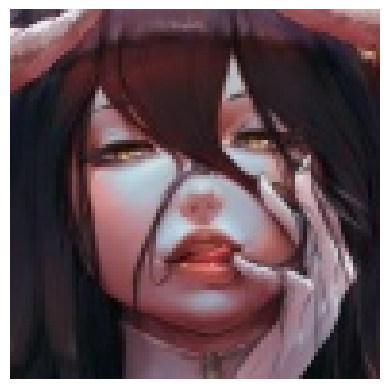

Label verdadera: Albedo-Overlord
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Scarlet Remilia-Touhou : 55.13 % confianza.
> Albedo-Overlord : 26.34 % confianza.
> Fubuki-One Punch Man : 4.16 % confianza.
> Miku Nakano-Quintessential Quintuplets : 1.84 % confianza.
> Kurisu Makise-Steins Gate : 1.21 % confianza.


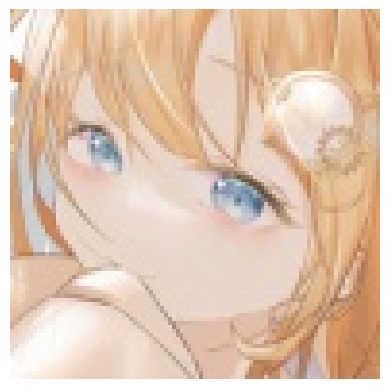

Label verdadera: Amelia Watson-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Amelia Watson-Hololive : 98.98 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 0.15 % confianza.
> Aegis-Persona : 0.11 % confianza.
> Gawr Gura-Hololive : 0.08 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.07 % confianza.


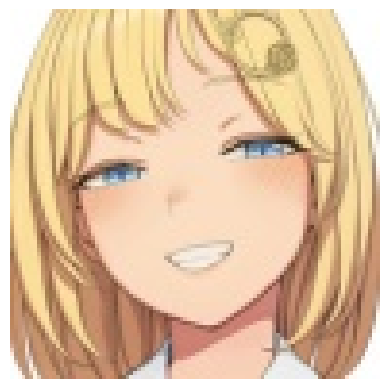

Label verdadera: Amelia Watson-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Amelia Watson-Hololive : 93.73 % confianza.
> Aegis-Persona : 1.38 % confianza.
> Nami-One Piece : 0.55 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 0.54 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.31 % confianza.


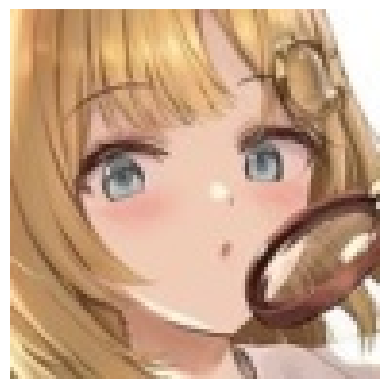

Label verdadera: Amelia Watson-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 32ms/step
> Amelia Watson-Hololive : 48.78 % confianza.
> Aegis-Persona : 35.44 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 3.32 % confianza.
> Nami-One Piece : 2.29 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 1.77 % confianza.


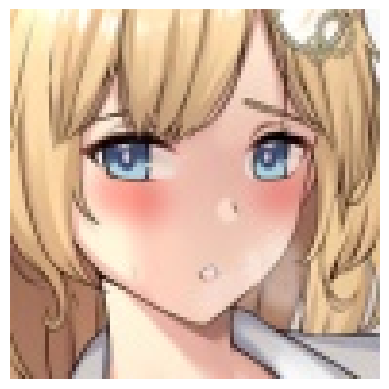

Label verdadera: Amelia Watson-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Amelia Watson-Hololive : 86.49 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 4.74 % confianza.
> Aegis-Persona : 4.44 % confianza.
> Asuna Yuuki-Sword Art Online : 0.34 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.31 % confianza.


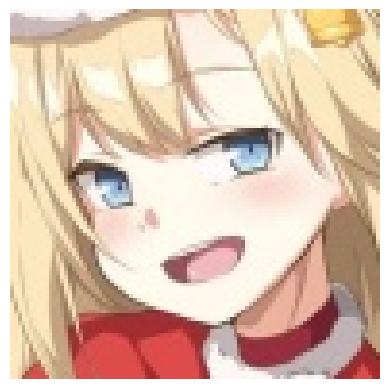

Label verdadera: Amelia Watson-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 39ms/step
> Amelia Watson-Hololive : 77.61 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 14.45 % confianza.
> Aegis-Persona : 1.39 % confianza.
> Asuna Yuuki-Sword Art Online : 0.61 % confianza.
> Kotobuki Tsumugi-K ON! : 0.50 % confianza.


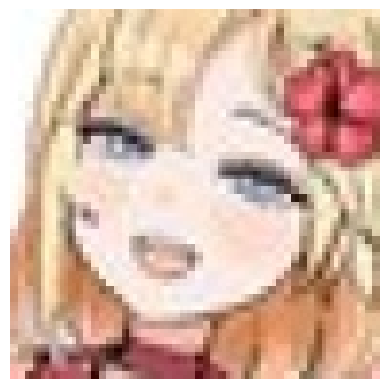

Label verdadera: Amelia Watson-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Giorno Giovanna-JoJos Bizarre Adventure : 34.76 % confianza.
> Nami-One Piece : 27.52 % confianza.
> Amelia Watson-Hololive : 16.61 % confianza.
> Asuna Yuuki-Sword Art Online : 4.43 % confianza.
> Flandre Scarlet-Touhou : 2.31 % confianza.


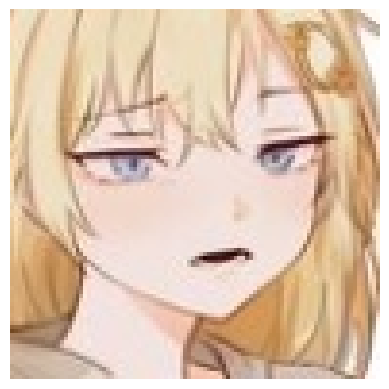

Label verdadera: Amelia Watson-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 32ms/step
> Asuna Yuuki-Sword Art Online : 73.20 % confianza.
> Amelia Watson-Hololive : 8.67 % confianza.
> Nami-One Piece : 4.94 % confianza.
> Maki Nishikino-Love Live : 1.20 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 1.17 % confianza.


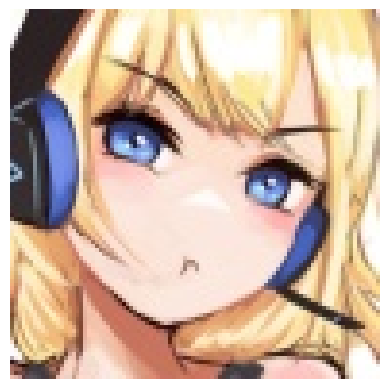

Label verdadera: Amelia Watson-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Amelia Watson-Hololive : 48.38 % confianza.
> Aegis-Persona : 34.25 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 7.53 % confianza.
> Asuna Yuuki-Sword Art Online : 0.84 % confianza.
> Shinobu Kochou-Demon Slayer : 0.50 % confianza.


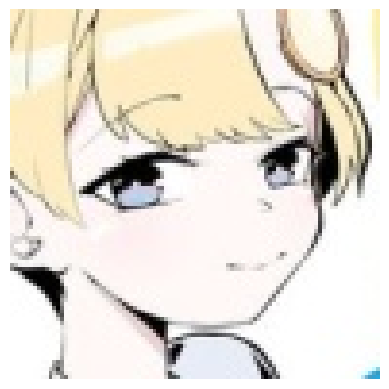

Label verdadera: Amelia Watson-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Paimon-Genshin Impact : 42.33 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 10.15 % confianza.
> Asuna Yuuki-Sword Art Online : 9.33 % confianza.
> Maki Nishikino-Love Live : 5.18 % confianza.
> Sinon-Sword Art Online : 4.00 % confianza.


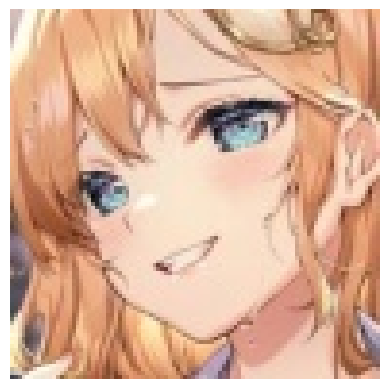

Label verdadera: Amelia Watson-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Amelia Watson-Hololive : 94.58 % confianza.
> Aegis-Persona : 1.72 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 0.55 % confianza.
> Asuna Yuuki-Sword Art Online : 0.43 % confianza.
> Nami-One Piece : 0.26 % confianza.


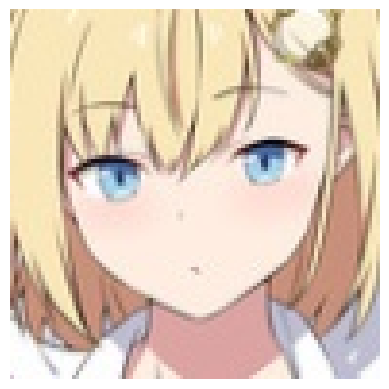

Label verdadera: Amelia Watson-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Ai Hayasaka-Kaguya Sama Love Is War : 82.65 % confianza.
> Aegis-Persona : 4.04 % confianza.
> Amelia Watson-Hololive : 3.38 % confianza.
> Kotobuki Tsumugi-K ON! : 1.02 % confianza.
> Paimon-Genshin Impact : 0.81 % confianza.


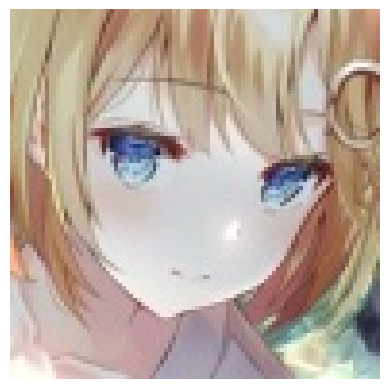

Label verdadera: Amelia Watson-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Amelia Watson-Hololive : 44.92 % confianza.
> Aegis-Persona : 21.14 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 15.57 % confianza.
> Asuna Yuuki-Sword Art Online : 1.67 % confianza.
> Kurisu Makise-Steins Gate : 0.82 % confianza.


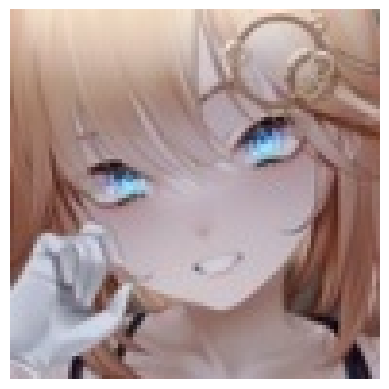

Label verdadera: Amelia Watson-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Amelia Watson-Hololive : 50.85 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 30.11 % confianza.
> Kurisu Makise-Steins Gate : 4.25 % confianza.
> Aegis-Persona : 2.20 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 1.42 % confianza.


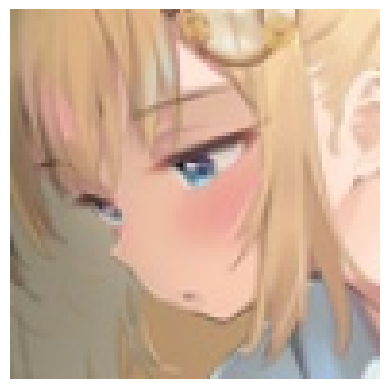

Label verdadera: Amelia Watson-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Amelia Watson-Hololive : 79.31 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 10.84 % confianza.
> Aegis-Persona : 1.11 % confianza.
> Saber-Fate : 1.00 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.49 % confianza.


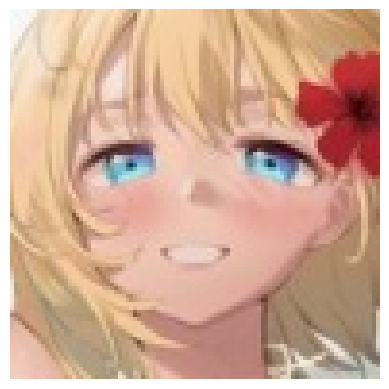

Label verdadera: Amelia Watson-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Amelia Watson-Hololive : 82.70 % confianza.
> Aegis-Persona : 8.00 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 2.19 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.52 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.42 % confianza.


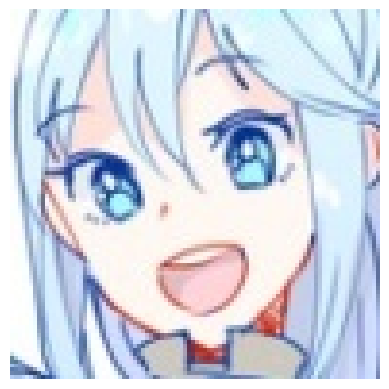

Label verdadera: Aqua-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Gawr Gura-Hololive : 67.61 % confianza.
> Paimon-Genshin Impact : 12.45 % confianza.
> Sinon-Sword Art Online : 3.24 % confianza.
> Aqua-Konosuba : 2.65 % confianza.
> Nozomi Tojo-Love Live : 1.82 % confianza.


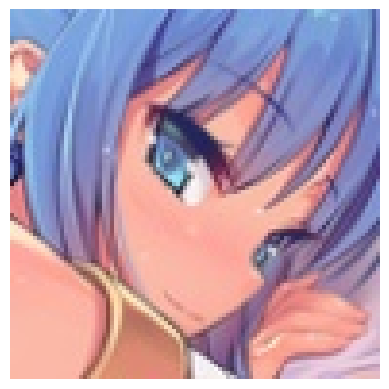

Label verdadera: Aqua-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Aqua-Konosuba : 45.21 % confianza.
> Rem-Re Zero : 40.69 % confianza.
> Sinon-Sword Art Online : 3.29 % confianza.
> Cirno-Touhou : 1.37 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.88 % confianza.


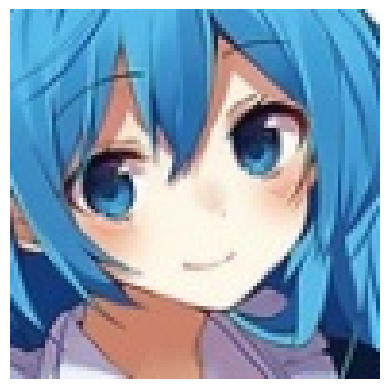

Label verdadera: Aqua-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Aqua-Konosuba : 87.30 % confianza.
> Sinon-Sword Art Online : 6.09 % confianza.
> Rem-Re Zero : 1.09 % confianza.
> Kirito-Sword Art Online : 0.46 % confianza.
> Nami-One Piece : 0.37 % confianza.


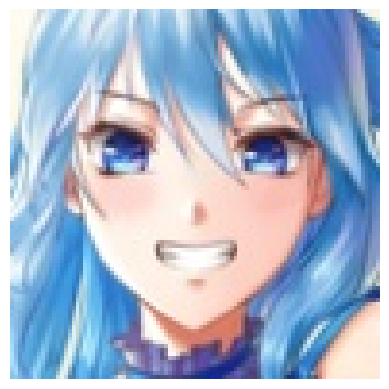

Label verdadera: Aqua-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 54ms/step
> Aqua-Konosuba : 96.38 % confianza.
> Rem-Re Zero : 1.06 % confianza.
> Sinon-Sword Art Online : 0.86 % confianza.
> Nami-One Piece : 0.17 % confianza.
> Paimon-Genshin Impact : 0.10 % confianza.


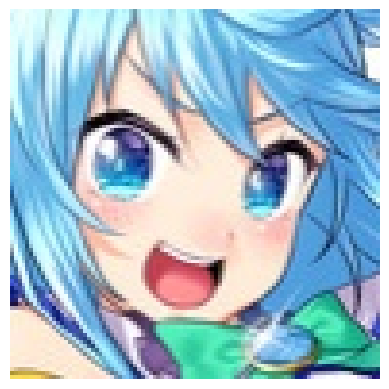

Label verdadera: Aqua-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Aqua-Konosuba : 96.69 % confianza.
> Sinon-Sword Art Online : 1.21 % confianza.
> Rem-Re Zero : 0.71 % confianza.
> Cirno-Touhou : 0.16 % confianza.
> Emilia-Re Zero : 0.12 % confianza.


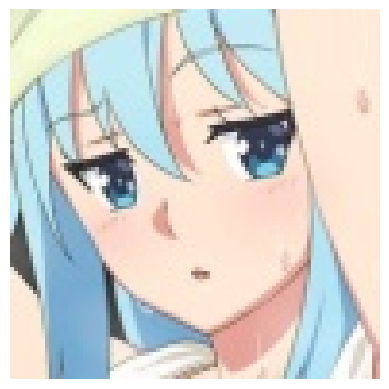

Label verdadera: Aqua-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Aqua-Konosuba : 54.28 % confianza.
> Sinon-Sword Art Online : 35.81 % confianza.
> Rem-Re Zero : 1.72 % confianza.
> Paimon-Genshin Impact : 1.56 % confianza.
> Nico Robin-One Piece : 0.59 % confianza.


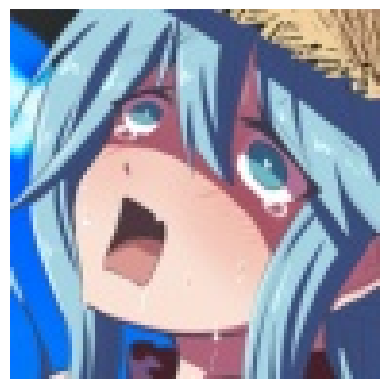

Label verdadera: Aqua-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Aqua-Konosuba : 79.18 % confianza.
> Sinon-Sword Art Online : 13.56 % confianza.
> Rem-Re Zero : 2.06 % confianza.
> Paimon-Genshin Impact : 0.68 % confianza.
> Cirno-Touhou : 0.47 % confianza.


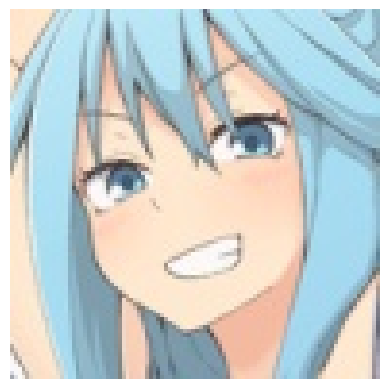

Label verdadera: Aqua-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Aqua-Konosuba : 93.59 % confianza.
> Sinon-Sword Art Online : 2.36 % confianza.
> Paimon-Genshin Impact : 0.79 % confianza.
> Rem-Re Zero : 0.44 % confianza.
> Kirito-Sword Art Online : 0.34 % confianza.


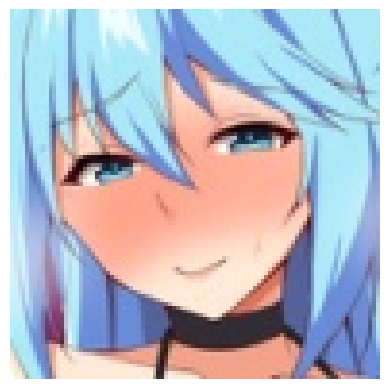

Label verdadera: Aqua-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Aqua-Konosuba : 93.88 % confianza.
> Sinon-Sword Art Online : 3.69 % confianza.
> Rem-Re Zero : 1.38 % confianza.
> C.C-Code Geass : 0.09 % confianza.
> Emilia-Re Zero : 0.07 % confianza.


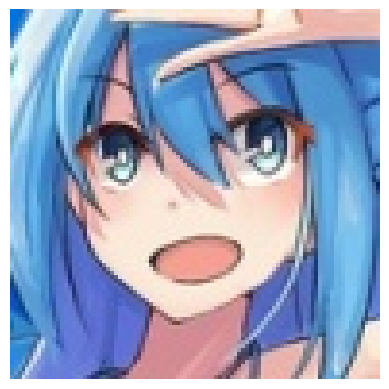

Label verdadera: Aqua-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Aqua-Konosuba : 90.49 % confianza.
> Sinon-Sword Art Online : 1.72 % confianza.
> Cirno-Touhou : 1.33 % confianza.
> Rem-Re Zero : 1.04 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.61 % confianza.


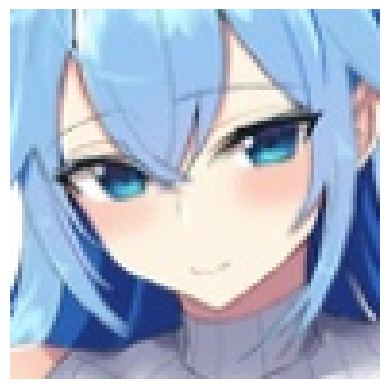

Label verdadera: Aqua-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 41ms/step
> Aqua-Konosuba : 93.84 % confianza.
> Sinon-Sword Art Online : 2.91 % confianza.
> Rem-Re Zero : 1.25 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.19 % confianza.
> Albedo-Overlord : 0.17 % confianza.


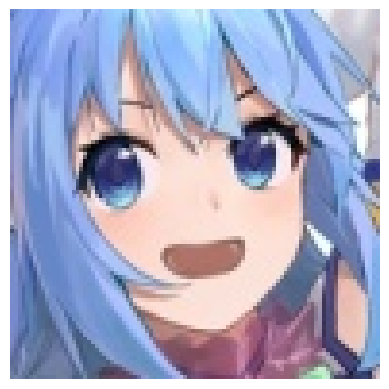

Label verdadera: Aqua-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Aqua-Konosuba : 94.16 % confianza.
> Rem-Re Zero : 2.22 % confianza.
> Cirno-Touhou : 0.44 % confianza.
> Sinon-Sword Art Online : 0.33 % confianza.
> Keqing-Genshin Impact : 0.29 % confianza.


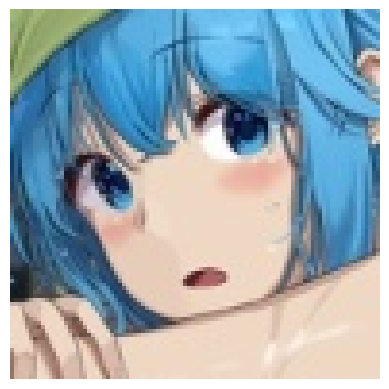

Label verdadera: Aqua-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 44ms/step
> Rem-Re Zero : 66.12 % confianza.
> Aqua-Konosuba : 12.86 % confianza.
> Sinon-Sword Art Online : 3.82 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 1.95 % confianza.
> Cirno-Touhou : 1.89 % confianza.


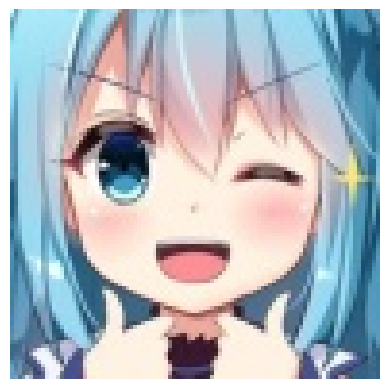

Label verdadera: Aqua-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Aqua-Konosuba : 76.80 % confianza.
> Paimon-Genshin Impact : 6.31 % confianza.
> Rem-Re Zero : 4.97 % confianza.
> Sinon-Sword Art Online : 3.54 % confianza.
> Nico Robin-One Piece : 2.05 % confianza.


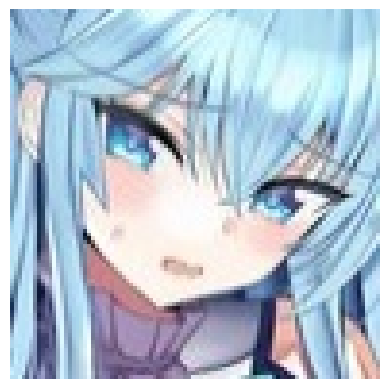

Label verdadera: Aqua-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Aqua-Konosuba : 59.97 % confianza.
> Sinon-Sword Art Online : 21.01 % confianza.
> Rem-Re Zero : 7.57 % confianza.
> Emilia-Re Zero : 2.04 % confianza.
> Gawr Gura-Hololive : 1.83 % confianza.


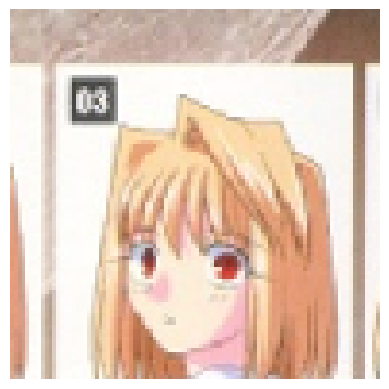

Label verdadera: Arcueid Brunestud-Tsukihime
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Arcueid Brunestud-Tsukihime : 96.33 % confianza.
> Asuna Yuuki-Sword Art Online : 0.76 % confianza.
> Flandre Scarlet-Touhou : 0.57 % confianza.
> Illyasviel Von Einzbern-Fate : 0.45 % confianza.
> Aisaka Taiga-Toradora : 0.22 % confianza.


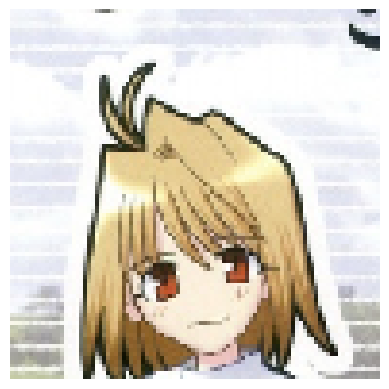

Label verdadera: Arcueid Brunestud-Tsukihime
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Arcueid Brunestud-Tsukihime : 89.40 % confianza.
> Saber-Fate : 3.55 % confianza.
> Flandre Scarlet-Touhou : 1.21 % confianza.
> Illyasviel Von Einzbern-Fate : 1.04 % confianza.
> Aisaka Taiga-Toradora : 0.63 % confianza.


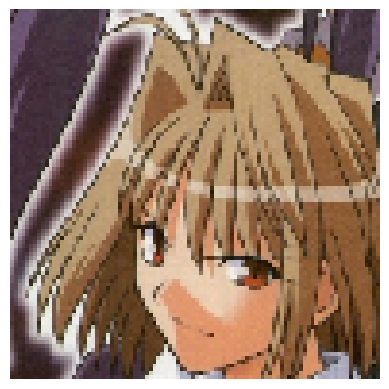

Label verdadera: Arcueid Brunestud-Tsukihime
Este personaje posiblemente es:
1/1 [==============================] - 0s 44ms/step
> Arcueid Brunestud-Tsukihime : 24.40 % confianza.
> Reimu Hakurei-Touhou : 17.34 % confianza.
> Scarlet Remilia-Touhou : 17.03 % confianza.
> Flandre Scarlet-Touhou : 6.58 % confianza.
> Aisaka Taiga-Toradora : 6.32 % confianza.


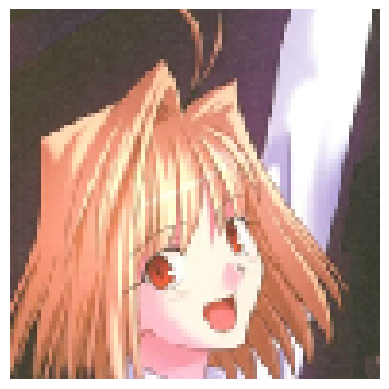

Label verdadera: Arcueid Brunestud-Tsukihime
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Arcueid Brunestud-Tsukihime : 96.61 % confianza.
> Sakuya Izayoi-Touhou : 0.65 % confianza.
> Illyasviel Von Einzbern-Fate : 0.62 % confianza.
> Scarlet Remilia-Touhou : 0.53 % confianza.
> Kotobuki Tsumugi-K ON! : 0.24 % confianza.


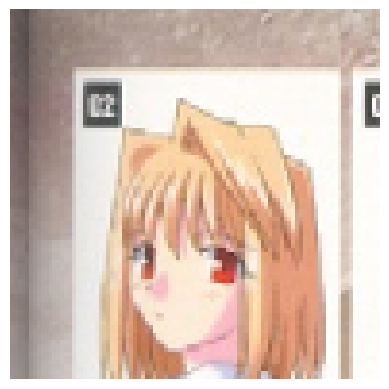

Label verdadera: Arcueid Brunestud-Tsukihime
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Arcueid Brunestud-Tsukihime : 97.27 % confianza.
> Illyasviel Von Einzbern-Fate : 0.40 % confianza.
> Flandre Scarlet-Touhou : 0.31 % confianza.
> Asuna Yuuki-Sword Art Online : 0.29 % confianza.
> Sakuya Izayoi-Touhou : 0.23 % confianza.


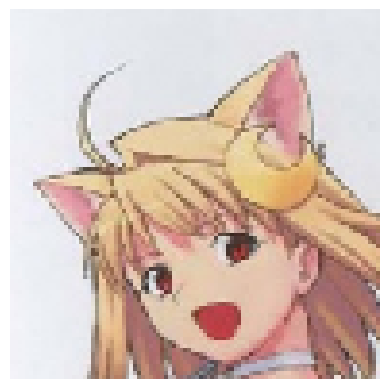

Label verdadera: Arcueid Brunestud-Tsukihime
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Arcueid Brunestud-Tsukihime : 88.46 % confianza.
> Flandre Scarlet-Touhou : 6.41 % confianza.
> Aisaka Taiga-Toradora : 1.72 % confianza.
> Illyasviel Von Einzbern-Fate : 0.34 % confianza.
> Asuna Yuuki-Sword Art Online : 0.27 % confianza.


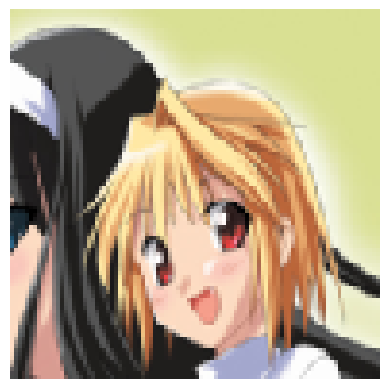

Label verdadera: Arcueid Brunestud-Tsukihime
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Arcueid Brunestud-Tsukihime : 53.70 % confianza.
> Saber-Fate : 16.84 % confianza.
> Kotobuki Tsumugi-K ON! : 5.54 % confianza.
> Flandre Scarlet-Touhou : 3.54 % confianza.
> Illyasviel Von Einzbern-Fate : 2.64 % confianza.


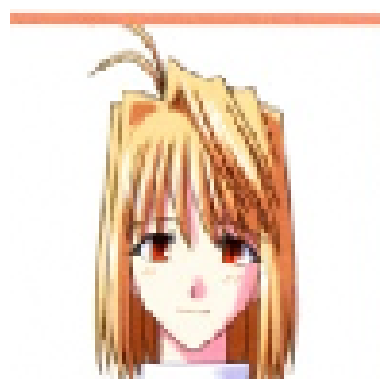

Label verdadera: Arcueid Brunestud-Tsukihime
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Arcueid Brunestud-Tsukihime : 79.17 % confianza.
> Saber-Fate : 2.48 % confianza.
> Illyasviel Von Einzbern-Fate : 1.78 % confianza.
> Flandre Scarlet-Touhou : 1.53 % confianza.
> Kotobuki Tsumugi-K ON! : 0.86 % confianza.


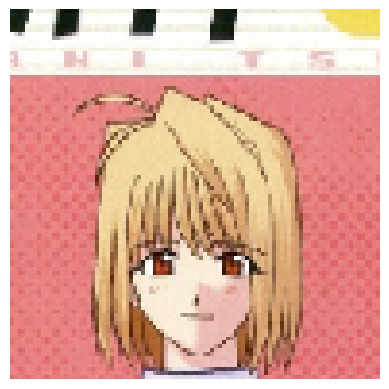

Label verdadera: Arcueid Brunestud-Tsukihime
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Arcueid Brunestud-Tsukihime : 78.09 % confianza.
> Aisaka Taiga-Toradora : 2.41 % confianza.
> Flandre Scarlet-Touhou : 1.84 % confianza.
> Kotobuki Tsumugi-K ON! : 1.21 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.95 % confianza.


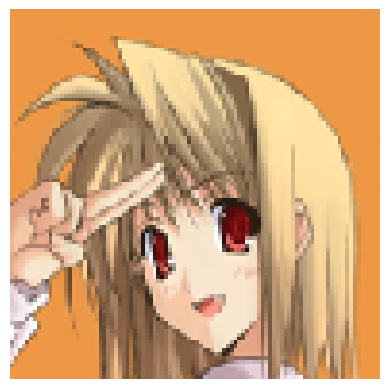

Label verdadera: Arcueid Brunestud-Tsukihime
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Arcueid Brunestud-Tsukihime : 55.59 % confianza.
> Aisaka Taiga-Toradora : 13.06 % confianza.
> Yui Hirasawa-K ON! : 5.23 % confianza.
> Asuna Yuuki-Sword Art Online : 4.36 % confianza.
> Megumin-Konosuba : 3.95 % confianza.


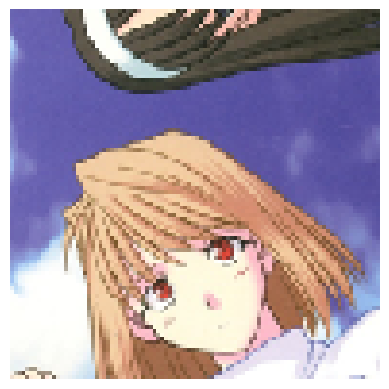

Label verdadera: Arcueid Brunestud-Tsukihime
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Arcueid Brunestud-Tsukihime : 98.77 % confianza.
> Saber-Fate : 0.26 % confianza.
> Kotobuki Tsumugi-K ON! : 0.21 % confianza.
> Flandre Scarlet-Touhou : 0.11 % confianza.
> Illyasviel Von Einzbern-Fate : 0.09 % confianza.


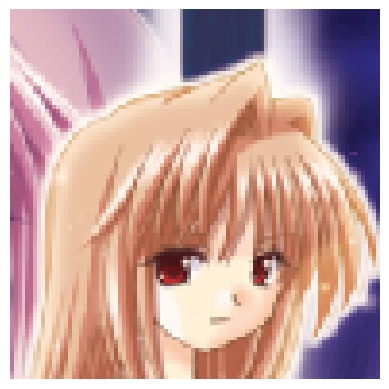

Label verdadera: Arcueid Brunestud-Tsukihime
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Arcueid Brunestud-Tsukihime : 94.03 % confianza.
> Sakuya Izayoi-Touhou : 0.86 % confianza.
> Illyasviel Von Einzbern-Fate : 0.77 % confianza.
> Saber-Fate : 0.61 % confianza.
> Aisaka Taiga-Toradora : 0.51 % confianza.


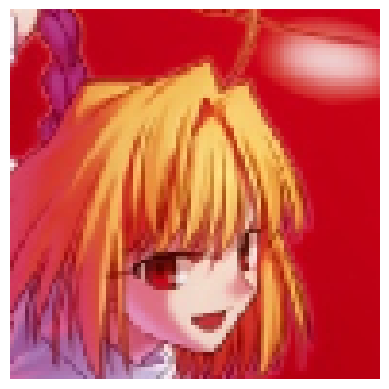

Label verdadera: Arcueid Brunestud-Tsukihime
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Arcueid Brunestud-Tsukihime : 84.71 % confianza.
> Flandre Scarlet-Touhou : 3.82 % confianza.
> Aisaka Taiga-Toradora : 3.03 % confianza.
> Sakuya Izayoi-Touhou : 0.92 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.89 % confianza.


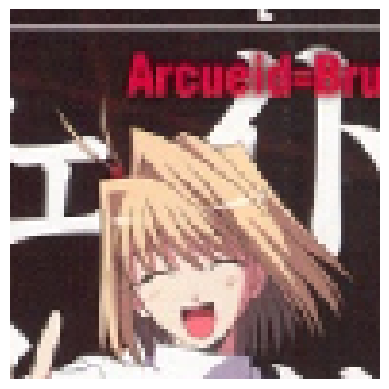

Label verdadera: Arcueid Brunestud-Tsukihime
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Arcueid Brunestud-Tsukihime : 93.50 % confianza.
> Flandre Scarlet-Touhou : 2.07 % confianza.
> Kotobuki Tsumugi-K ON! : 0.59 % confianza.
> Aisaka Taiga-Toradora : 0.50 % confianza.
> Illyasviel Von Einzbern-Fate : 0.45 % confianza.


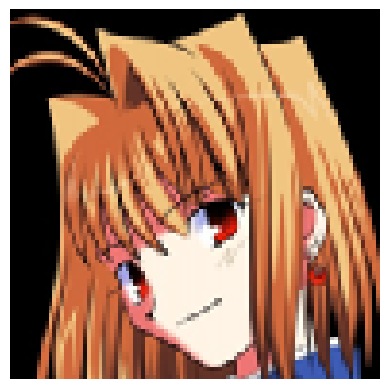

Label verdadera: Arcueid Brunestud-Tsukihime
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Arcueid Brunestud-Tsukihime : 70.79 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 15.24 % confianza.
> Flandre Scarlet-Touhou : 2.01 % confianza.
> Aisaka Taiga-Toradora : 1.44 % confianza.
> Sakuya Izayoi-Touhou : 1.23 % confianza.


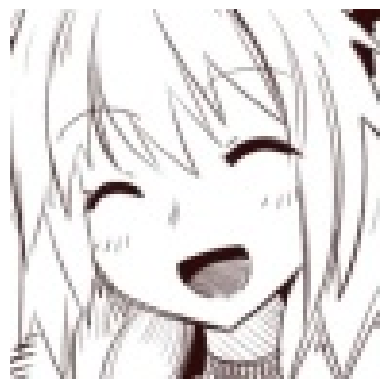

Label verdadera: Astolfo-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 20.85 % confianza.
> Kurisu Makise-Steins Gate : 12.11 % confianza.
> Gawr Gura-Hololive : 11.88 % confianza.
> Miku Nakano-Quintessential Quintuplets : 11.27 % confianza.
> Fubuki-One Punch Man : 9.20 % confianza.


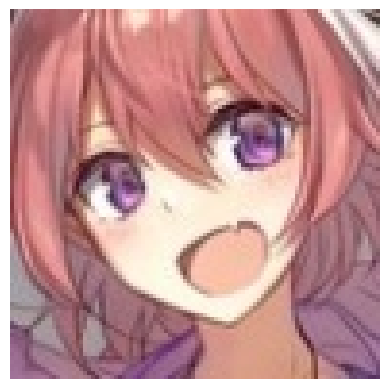

Label verdadera: Astolfo-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Astolfo-Fate : 95.57 % confianza.
> Maki Nishikino-Love Live : 2.02 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.40 % confianza.
> Kirito-Sword Art Online : 0.34 % confianza.
> Miku Nakano-Quintessential Quintuplets : 0.28 % confianza.


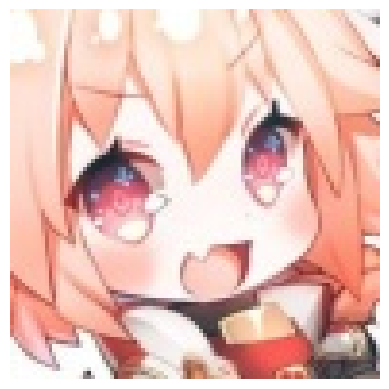

Label verdadera: Astolfo-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Astolfo-Fate : 67.57 % confianza.
> Raphtalia-Rising of the Shield Hero : 7.13 % confianza.
> Gawr Gura-Hololive : 4.31 % confianza.
> Paimon-Genshin Impact : 2.11 % confianza.
> Miku Nakano-Quintessential Quintuplets : 2.01 % confianza.


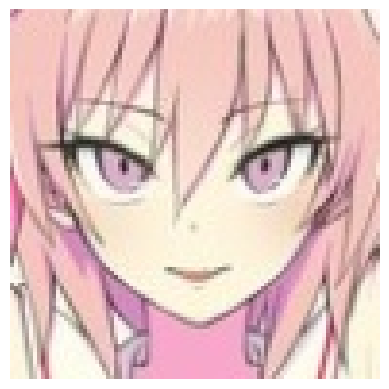

Label verdadera: Astolfo-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Astolfo-Fate : 97.59 % confianza.
> Raphtalia-Rising of the Shield Hero : 0.81 % confianza.
> Zero Two-Darling In the Franxx : 0.28 % confianza.
> Maki Nishikino-Love Live : 0.15 % confianza.
> Flandre Scarlet-Touhou : 0.08 % confianza.


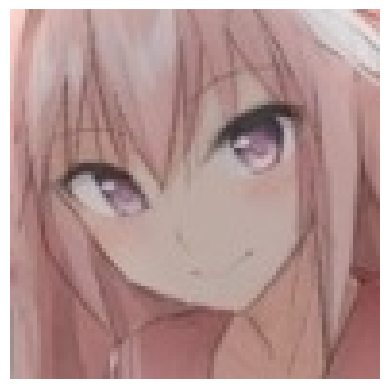

Label verdadera: Astolfo-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Astolfo-Fate : 80.63 % confianza.
> Raphtalia-Rising of the Shield Hero : 7.35 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 1.49 % confianza.
> Emilia-Re Zero : 1.21 % confianza.
> Asuna Yuuki-Sword Art Online : 1.03 % confianza.


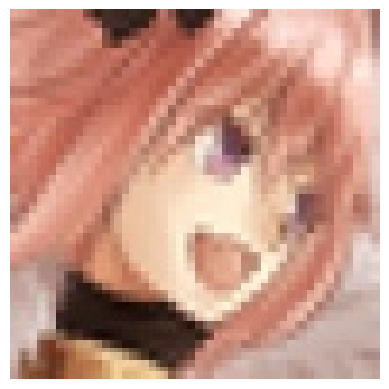

Label verdadera: Astolfo-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Astolfo-Fate : 94.13 % confianza.
> Arcueid Brunestud-Tsukihime : 1.12 % confianza.
> Aisaka Taiga-Toradora : 0.80 % confianza.
> Shirley Fenette-Code Geass : 0.55 % confianza.
> Raphtalia-Rising of the Shield Hero : 0.44 % confianza.


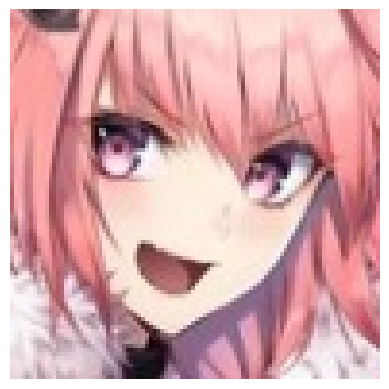

Label verdadera: Astolfo-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Astolfo-Fate : 99.66 % confianza.
> Miku Nakano-Quintessential Quintuplets : 0.05 % confianza.
> Zero Two-Darling In the Franxx : 0.05 % confianza.
> Raphtalia-Rising of the Shield Hero : 0.03 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.03 % confianza.


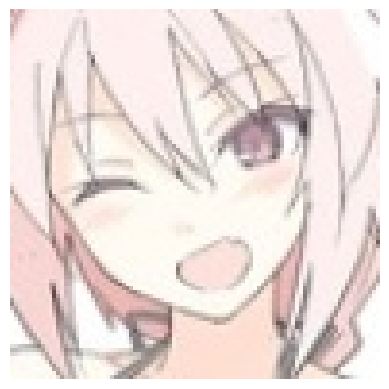

Label verdadera: Astolfo-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Gawr Gura-Hololive : 28.42 % confianza.
> Miku Nakano-Quintessential Quintuplets : 20.03 % confianza.
> Asuna Yuuki-Sword Art Online : 5.17 % confianza.
> Cirno-Touhou : 3.75 % confianza.
> Megumin-Konosuba : 3.74 % confianza.


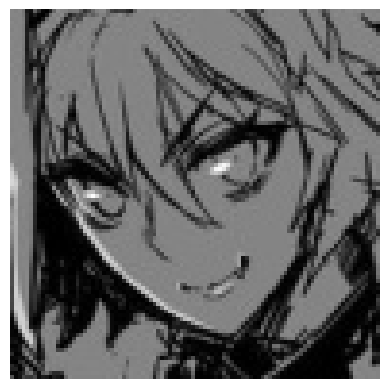

Label verdadera: Astolfo-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Giorno Giovanna-JoJos Bizarre Adventure : 41.50 % confianza.
> Nico Robin-One Piece : 19.10 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 15.79 % confianza.
> Maka Albarn-Soul Eater : 4.85 % confianza.
> Scarlet Remilia-Touhou : 3.24 % confianza.


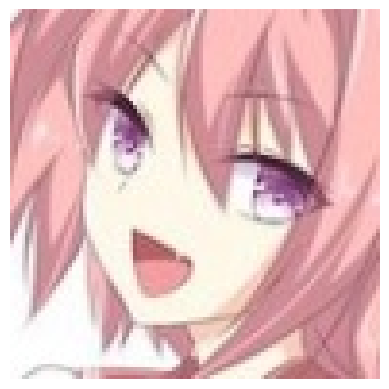

Label verdadera: Astolfo-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Astolfo-Fate : 99.76 % confianza.
> Miku Nakano-Quintessential Quintuplets : 0.07 % confianza.
> Zero Two-Darling In the Franxx : 0.02 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.02 % confianza.
> Kurisu Makise-Steins Gate : 0.01 % confianza.


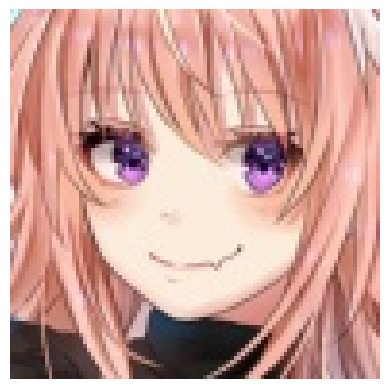

Label verdadera: Astolfo-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 41ms/step
> Astolfo-Fate : 60.55 % confianza.
> Emilia-Re Zero : 8.25 % confianza.
> Asuna Yuuki-Sword Art Online : 6.24 % confianza.
> Maki Nishikino-Love Live : 3.09 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 3.08 % confianza.


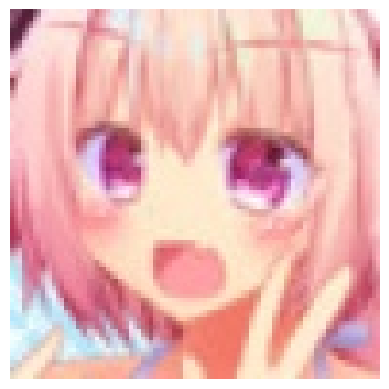

Label verdadera: Astolfo-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Astolfo-Fate : 96.49 % confianza.
> Raphtalia-Rising of the Shield Hero : 1.13 % confianza.
> Flandre Scarlet-Touhou : 0.31 % confianza.
> Ram-Re Zero : 0.23 % confianza.
> Emilia-Re Zero : 0.17 % confianza.


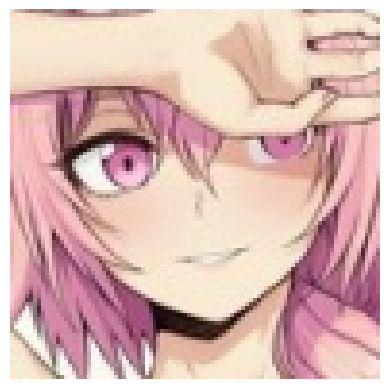

Label verdadera: Astolfo-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Astolfo-Fate : 59.41 % confianza.
> Ram-Re Zero : 5.16 % confianza.
> Raphtalia-Rising of the Shield Hero : 4.17 % confianza.
> Maki Nishikino-Love Live : 3.55 % confianza.
> Keqing-Genshin Impact : 2.91 % confianza.


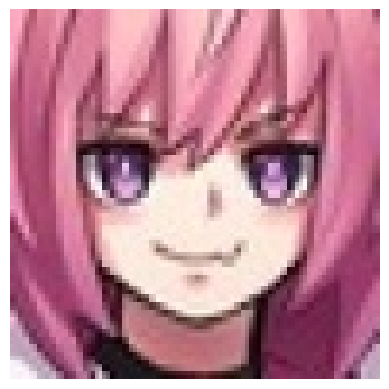

Label verdadera: Astolfo-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Astolfo-Fate : 98.96 % confianza.
> Maki Nishikino-Love Live : 0.39 % confianza.
> Zero Two-Darling In the Franxx : 0.14 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.10 % confianza.
> Miku Nakano-Quintessential Quintuplets : 0.06 % confianza.


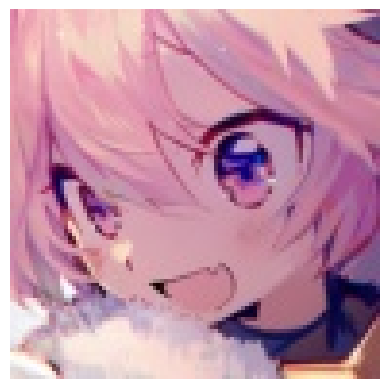

Label verdadera: Astolfo-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Astolfo-Fate : 33.52 % confianza.
> Emilia-Re Zero : 16.93 % confianza.
> Aisaka Taiga-Toradora : 11.03 % confianza.
> Kagami Hiiragi-Lucky Star : 4.57 % confianza.
> Ram-Re Zero : 2.79 % confianza.


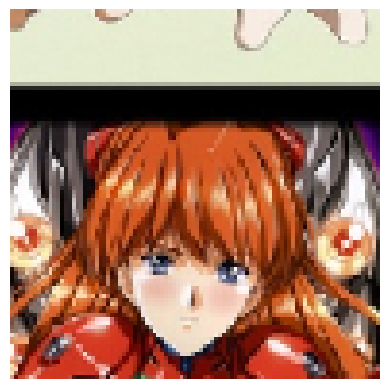

Label verdadera: Asuka Langley Souryuu-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Asuka Langley Souryuu-Neon Genesis Evangelion : 93.54 % confianza.
> Reimu Hakurei-Touhou : 0.93 % confianza.
> Yui Hirasawa-K ON! : 0.65 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 0.39 % confianza.
> Nami-One Piece : 0.34 % confianza.


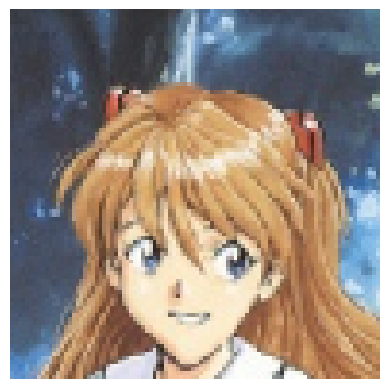

Label verdadera: Asuka Langley Souryuu-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Asuka Langley Souryuu-Neon Genesis Evangelion : 67.48 % confianza.
> Arcueid Brunestud-Tsukihime : 9.10 % confianza.
> Flandre Scarlet-Touhou : 2.83 % confianza.
> Saber-Fate : 2.25 % confianza.
> Kotobuki Tsumugi-K ON! : 2.17 % confianza.


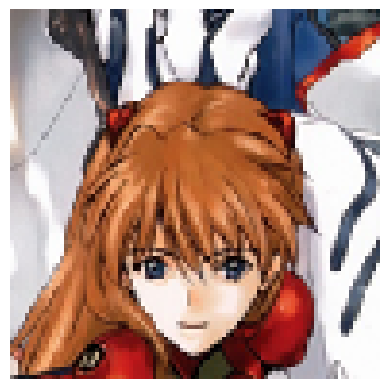

Label verdadera: Asuka Langley Souryuu-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Suzaku Kururugi-Code Geass : 61.63 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 16.86 % confianza.
> Yui Hirasawa-K ON! : 5.95 % confianza.
> Reimu Hakurei-Touhou : 2.31 % confianza.
> Shirley Fenette-Code Geass : 1.58 % confianza.


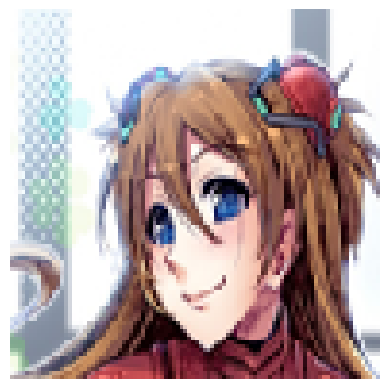

Label verdadera: Asuka Langley Souryuu-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Asuka Langley Souryuu-Neon Genesis Evangelion : 63.93 % confianza.
> Aegis-Persona : 5.80 % confianza.
> Flandre Scarlet-Touhou : 2.78 % confianza.
> Aisaka Taiga-Toradora : 2.37 % confianza.
> Yui Hirasawa-K ON! : 2.37 % confianza.


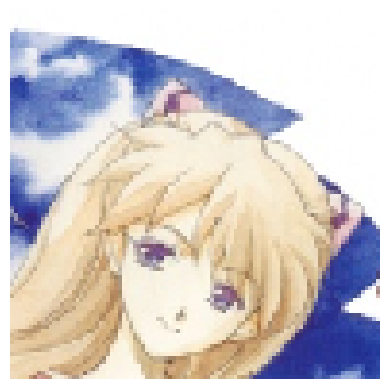

Label verdadera: Asuka Langley Souryuu-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Arcueid Brunestud-Tsukihime : 34.67 % confianza.
> Kotobuki Tsumugi-K ON! : 6.53 % confianza.
> Saber-Fate : 6.34 % confianza.
> C.C-Code Geass : 4.19 % confianza.
> Aisaka Taiga-Toradora : 3.33 % confianza.


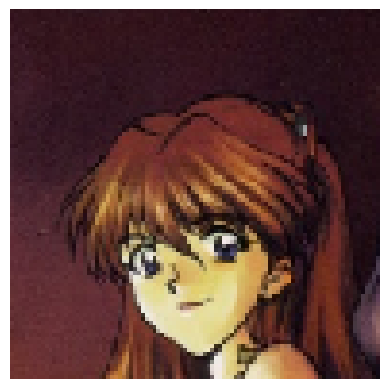

Label verdadera: Asuka Langley Souryuu-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Shirley Fenette-Code Geass : 88.70 % confianza.
> Suzaku Kururugi-Code Geass : 4.68 % confianza.
> Aisaka Taiga-Toradora : 1.13 % confianza.
> Lelouch Lamperouge-Code Geass : 0.70 % confianza.
> Yui Hirasawa-K ON! : 0.59 % confianza.


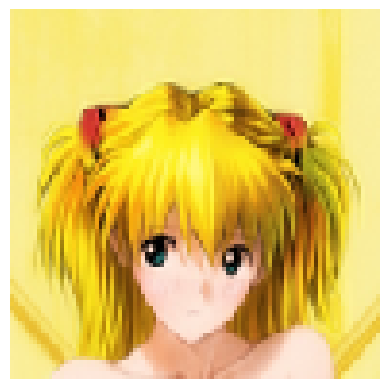

Label verdadera: Asuka Langley Souryuu-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Asuka Langley Souryuu-Neon Genesis Evangelion : 51.87 % confianza.
> Saber-Fate : 15.50 % confianza.
> Suzaku Kururugi-Code Geass : 13.02 % confianza.
> Aegis-Persona : 3.02 % confianza.
> Arcueid Brunestud-Tsukihime : 2.15 % confianza.


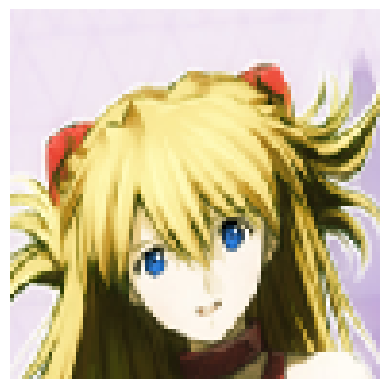

Label verdadera: Asuka Langley Souryuu-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Saber-Fate : 32.34 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 20.52 % confianza.
> Aegis-Persona : 4.98 % confianza.
> Flandre Scarlet-Touhou : 4.88 % confianza.
> C.C-Code Geass : 4.30 % confianza.


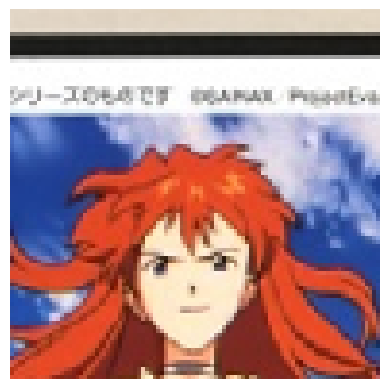

Label verdadera: Asuka Langley Souryuu-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Asuka Langley Souryuu-Neon Genesis Evangelion : 69.87 % confianza.
> Yoko Littner-Gurrenn Lagann : 9.85 % confianza.
> Yui Hirasawa-K ON! : 5.93 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 1.85 % confianza.
> Scarlet Remilia-Touhou : 0.87 % confianza.


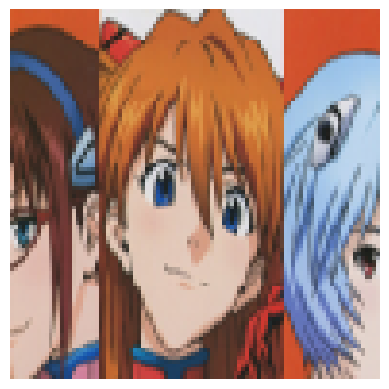

Label verdadera: Asuka Langley Souryuu-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Asuka Langley Souryuu-Neon Genesis Evangelion : 90.95 % confianza.
> Yui Hirasawa-K ON! : 1.09 % confianza.
> Nami-One Piece : 0.55 % confianza.
> Kallen Stadtfeld-Code Geass : 0.48 % confianza.
> Kurisu Makise-Steins Gate : 0.36 % confianza.


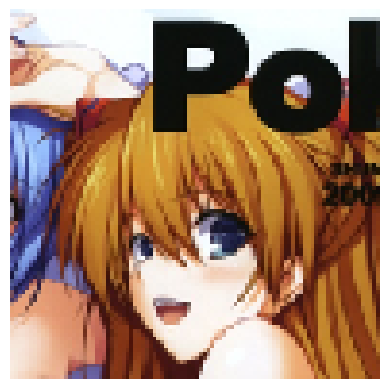

Label verdadera: Asuka Langley Souryuu-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Asuka Langley Souryuu-Neon Genesis Evangelion : 96.43 % confianza.
> Aegis-Persona : 1.06 % confianza.
> Flandre Scarlet-Touhou : 0.39 % confianza.
> Nami-One Piece : 0.16 % confianza.
> Arcueid Brunestud-Tsukihime : 0.14 % confianza.


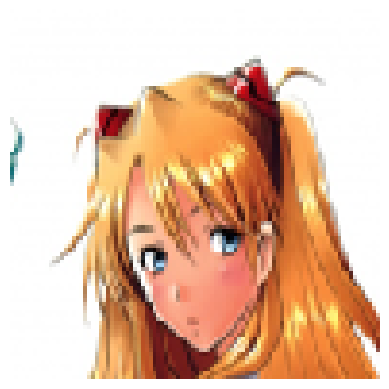

Label verdadera: Asuka Langley Souryuu-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Asuka Langley Souryuu-Neon Genesis Evangelion : 94.62 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 1.29 % confianza.
> Suzaku Kururugi-Code Geass : 0.59 % confianza.
> Saber-Fate : 0.32 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.31 % confianza.


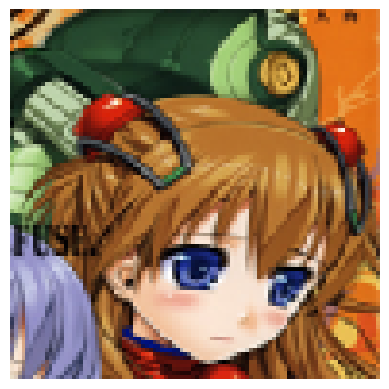

Label verdadera: Asuka Langley Souryuu-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Asuka Langley Souryuu-Neon Genesis Evangelion : 89.59 % confianza.
> Aisaka Taiga-Toradora : 1.65 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 0.96 % confianza.
> Yui Hirasawa-K ON! : 0.92 % confianza.
> Nami-One Piece : 0.46 % confianza.


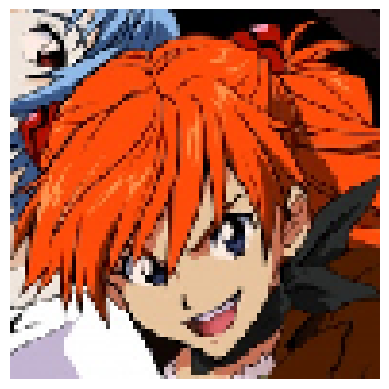

Label verdadera: Asuka Langley Souryuu-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 40ms/step
> Yui Hirasawa-K ON! : 35.76 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 13.31 % confianza.
> Reimu Hakurei-Touhou : 9.06 % confianza.
> Aisaka Taiga-Toradora : 8.03 % confianza.
> Yoko Littner-Gurrenn Lagann : 2.28 % confianza.


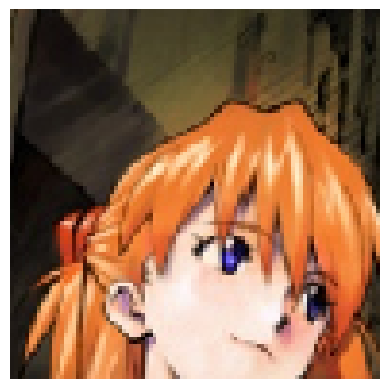

Label verdadera: Asuka Langley Souryuu-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 33ms/step
> Asuka Langley Souryuu-Neon Genesis Evangelion : 80.35 % confianza.
> Aisaka Taiga-Toradora : 4.28 % confianza.
> Arcueid Brunestud-Tsukihime : 1.65 % confianza.
> Yui Hirasawa-K ON! : 1.52 % confianza.
> Sakuya Izayoi-Touhou : 1.32 % confianza.


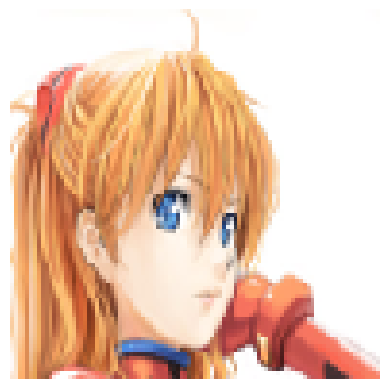

Label verdadera: Asuka Langley Souryuu-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Asuka Langley Souryuu-Neon Genesis Evangelion : 97.89 % confianza.
> Arcueid Brunestud-Tsukihime : 0.25 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.22 % confianza.
> Saber-Fate : 0.16 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.13 % confianza.


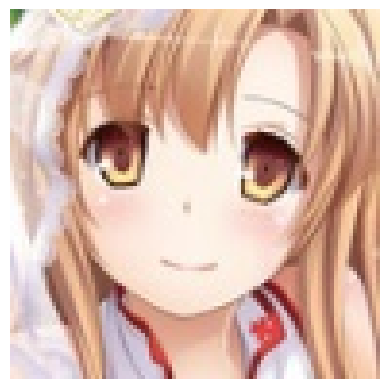

Label verdadera: Asuna Yuuki-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Asuna Yuuki-Sword Art Online : 87.01 % confianza.
> Gawr Gura-Hololive : 3.48 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 2.30 % confianza.
> Emilia-Re Zero : 1.37 % confianza.
> Nami-One Piece : 0.47 % confianza.


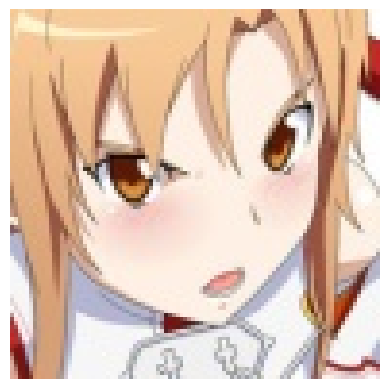

Label verdadera: Asuna Yuuki-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Asuna Yuuki-Sword Art Online : 95.15 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.86 % confianza.
> Nami-One Piece : 0.54 % confianza.
> Gawr Gura-Hololive : 0.38 % confianza.
> Ritsu Tainaka-K ON! : 0.33 % confianza.


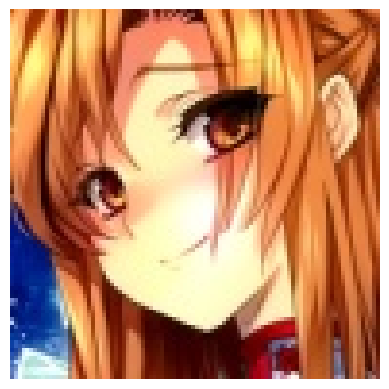

Label verdadera: Asuna Yuuki-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Asuna Yuuki-Sword Art Online : 61.98 % confianza.
> Nami-One Piece : 29.39 % confianza.
> Aegis-Persona : 1.53 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 1.08 % confianza.
> Flandre Scarlet-Touhou : 0.81 % confianza.


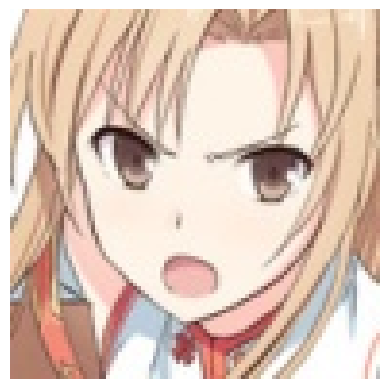

Label verdadera: Asuna Yuuki-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Asuna Yuuki-Sword Art Online : 98.59 % confianza.
> Nami-One Piece : 0.31 % confianza.
> Gawr Gura-Hololive : 0.14 % confianza.
> Emilia-Re Zero : 0.08 % confianza.
> Aegis-Persona : 0.08 % confianza.


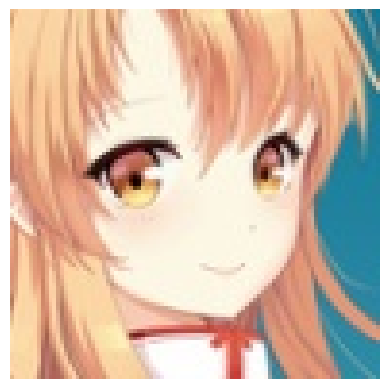

Label verdadera: Asuna Yuuki-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Asuna Yuuki-Sword Art Online : 97.84 % confianza.
> Arcueid Brunestud-Tsukihime : 0.64 % confianza.
> Nami-One Piece : 0.47 % confianza.
> Emilia-Re Zero : 0.21 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.09 % confianza.


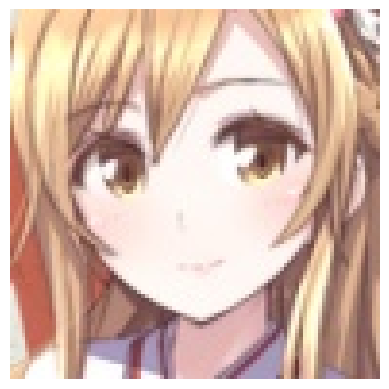

Label verdadera: Asuna Yuuki-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Asuna Yuuki-Sword Art Online : 99.67 % confianza.
> Nami-One Piece : 0.11 % confianza.
> Aegis-Persona : 0.03 % confianza.
> Maki Nishikino-Love Live : 0.02 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.02 % confianza.


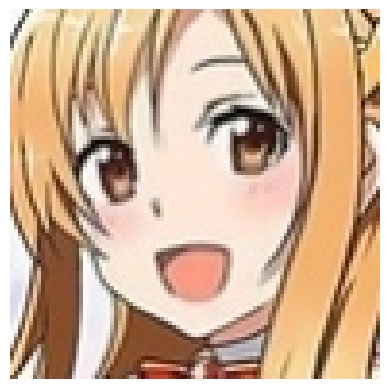

Label verdadera: Asuna Yuuki-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Asuna Yuuki-Sword Art Online : 74.05 % confianza.
> Nami-One Piece : 22.43 % confianza.
> Ritsu Tainaka-K ON! : 1.73 % confianza.
> Kotobuki Tsumugi-K ON! : 0.23 % confianza.
> Gawr Gura-Hololive : 0.19 % confianza.


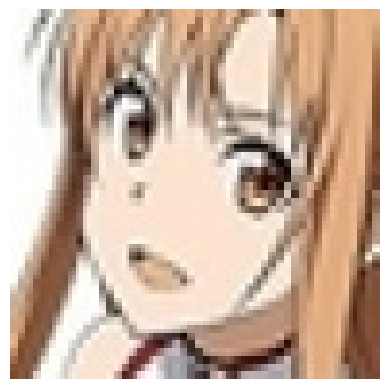

Label verdadera: Asuna Yuuki-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Asuna Yuuki-Sword Art Online : 99.62 % confianza.
> Nami-One Piece : 0.14 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.04 % confianza.
> Megumin-Konosuba : 0.02 % confianza.
> Gawr Gura-Hololive : 0.02 % confianza.


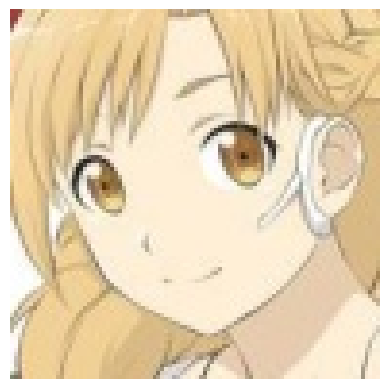

Label verdadera: Asuna Yuuki-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Asuna Yuuki-Sword Art Online : 59.49 % confianza.
> Nami-One Piece : 16.81 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 12.51 % confianza.
> Gawr Gura-Hololive : 1.27 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 1.24 % confianza.


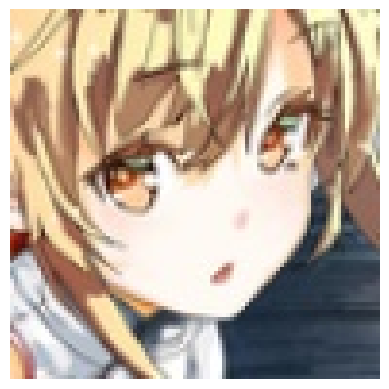

Label verdadera: Asuna Yuuki-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Asuna Yuuki-Sword Art Online : 69.08 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 7.70 % confianza.
> Flandre Scarlet-Touhou : 5.20 % confianza.
> Aegis-Persona : 3.42 % confianza.
> Megumin-Konosuba : 3.34 % confianza.


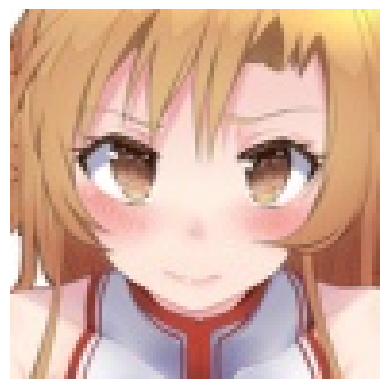

Label verdadera: Asuna Yuuki-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Asuna Yuuki-Sword Art Online : 88.30 % confianza.
> Raphtalia-Rising of the Shield Hero : 2.83 % confianza.
> Nami-One Piece : 1.83 % confianza.
> Aisaka Taiga-Toradora : 1.16 % confianza.
> Amelia Watson-Hololive : 0.58 % confianza.


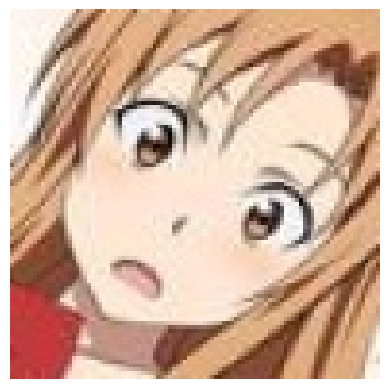

Label verdadera: Asuna Yuuki-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Asuna Yuuki-Sword Art Online : 91.34 % confianza.
> Nami-One Piece : 6.81 % confianza.
> Gawr Gura-Hololive : 0.23 % confianza.
> Maki Nishikino-Love Live : 0.11 % confianza.
> Megumin-Konosuba : 0.10 % confianza.


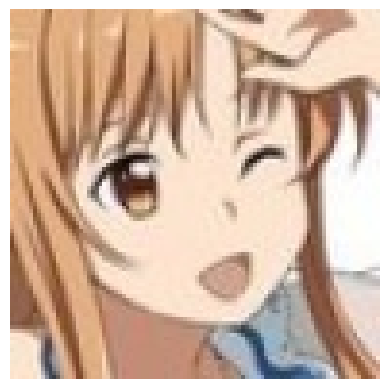

Label verdadera: Asuna Yuuki-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Asuna Yuuki-Sword Art Online : 99.08 % confianza.
> Nami-One Piece : 0.36 % confianza.
> Maki Nishikino-Love Live : 0.06 % confianza.
> Raphtalia-Rising of the Shield Hero : 0.05 % confianza.
> Arcueid Brunestud-Tsukihime : 0.04 % confianza.


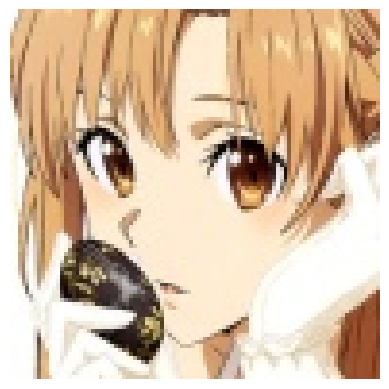

Label verdadera: Asuna Yuuki-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Asuna Yuuki-Sword Art Online : 99.37 % confianza.
> Nami-One Piece : 0.26 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 0.12 % confianza.
> Aegis-Persona : 0.08 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.04 % confianza.


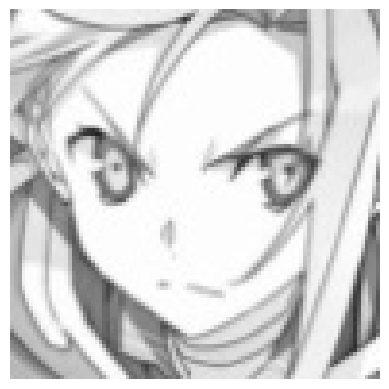

Label verdadera: Asuna Yuuki-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 45ms/step
> Asuna Yuuki-Sword Art Online : 16.09 % confianza.
> Maki Nishikino-Love Live : 14.72 % confianza.
> Fubuki-One Punch Man : 14.31 % confianza.
> Gawr Gura-Hololive : 7.69 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 6.34 % confianza.


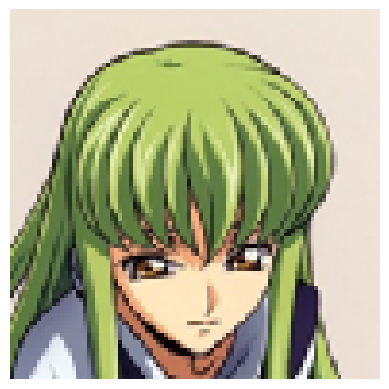

Label verdadera: C.C-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> C.C-Code Geass : 87.32 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.95 % confianza.
> Lelouch Lamperouge-Code Geass : 0.91 % confianza.
> Sakuya Izayoi-Touhou : 0.62 % confianza.
> Suzaku Kururugi-Code Geass : 0.43 % confianza.


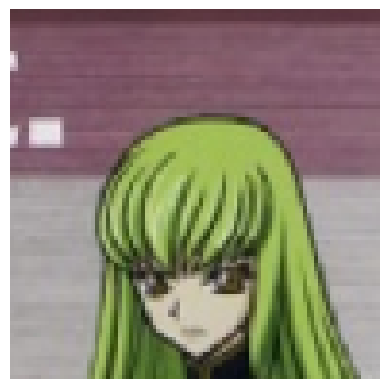

Label verdadera: C.C-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> C.C-Code Geass : 94.56 % confianza.
> Sakuya Izayoi-Touhou : 0.24 % confianza.
> Maka Albarn-Soul Eater : 0.23 % confianza.
> Emilia-Re Zero : 0.19 % confianza.
> Suzaku Kururugi-Code Geass : 0.19 % confianza.


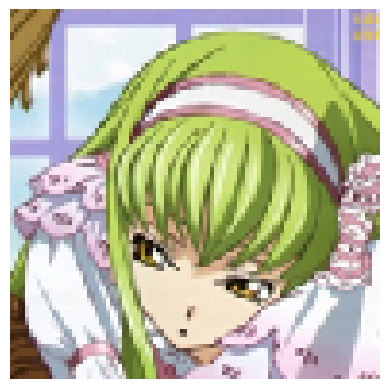

Label verdadera: C.C-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> C.C-Code Geass : 84.44 % confianza.
> Suzaku Kururugi-Code Geass : 0.94 % confianza.
> Sakuya Izayoi-Touhou : 0.75 % confianza.
> Nozomi Tojo-Love Live : 0.72 % confianza.
> Emilia-Re Zero : 0.64 % confianza.


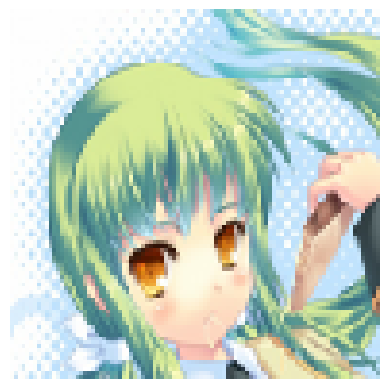

Label verdadera: C.C-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 41ms/step
> C.C-Code Geass : 64.71 % confianza.
> Nia Teppelin-Gurrenn Lagann : 4.60 % confianza.
> Aegis-Persona : 2.58 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 2.30 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 2.03 % confianza.


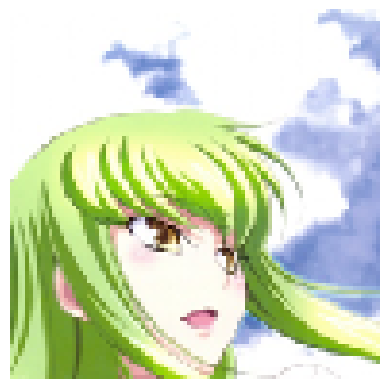

Label verdadera: C.C-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> C.C-Code Geass : 89.26 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 1.64 % confianza.
> Arcueid Brunestud-Tsukihime : 1.22 % confianza.
> Flandre Scarlet-Touhou : 0.89 % confianza.
> Aegis-Persona : 0.52 % confianza.


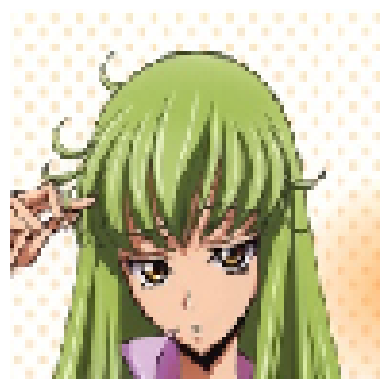

Label verdadera: C.C-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> C.C-Code Geass : 88.48 % confianza.
> Suzaku Kururugi-Code Geass : 2.32 % confianza.
> Hatsune Miku-Vocaloid : 1.10 % confianza.
> Saber-Fate : 0.70 % confianza.
> Sinon-Sword Art Online : 0.48 % confianza.


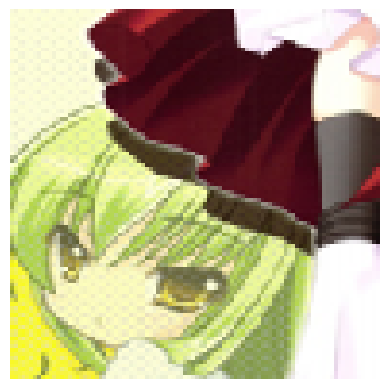

Label verdadera: C.C-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> C.C-Code Geass : 93.51 % confianza.
> Suzaku Kururugi-Code Geass : 0.29 % confianza.
> Saber-Fate : 0.27 % confianza.
> Emilia-Re Zero : 0.27 % confianza.
> Hatsune Miku-Vocaloid : 0.26 % confianza.


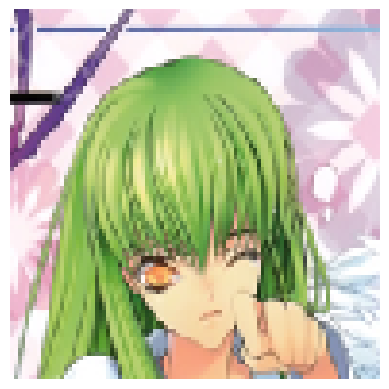

Label verdadera: C.C-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> C.C-Code Geass : 88.28 % confianza.
> Suzaku Kururugi-Code Geass : 0.86 % confianza.
> Hatsune Miku-Vocaloid : 0.46 % confianza.
> Emilia-Re Zero : 0.45 % confianza.
> Sinon-Sword Art Online : 0.39 % confianza.


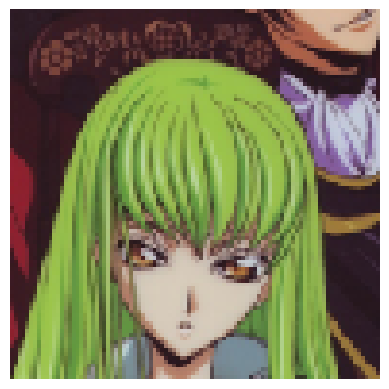

Label verdadera: C.C-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> C.C-Code Geass : 86.35 % confianza.
> Emilia-Re Zero : 0.60 % confianza.
> Hatsune Miku-Vocaloid : 0.53 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.50 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.48 % confianza.


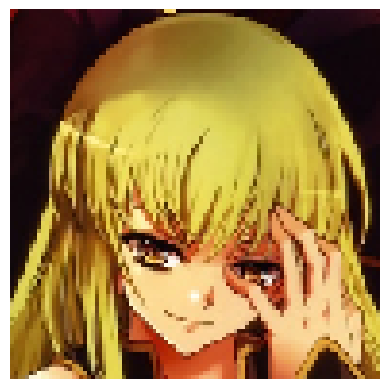

Label verdadera: C.C-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Saber-Fate : 26.83 % confianza.
> Arcueid Brunestud-Tsukihime : 19.28 % confianza.
> C.C-Code Geass : 9.59 % confianza.
> Flandre Scarlet-Touhou : 3.64 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 2.83 % confianza.


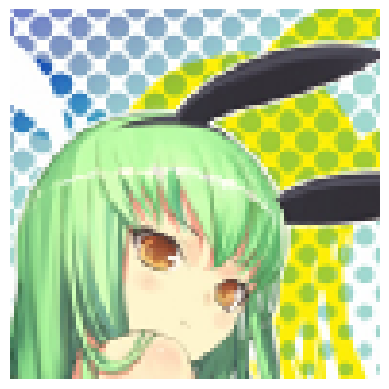

Label verdadera: C.C-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> C.C-Code Geass : 93.24 % confianza.
> Emilia-Re Zero : 0.34 % confianza.
> Hatsune Miku-Vocaloid : 0.30 % confianza.
> Nezuko Kamado-Demon Slayer : 0.26 % confianza.
> Flandre Scarlet-Touhou : 0.23 % confianza.


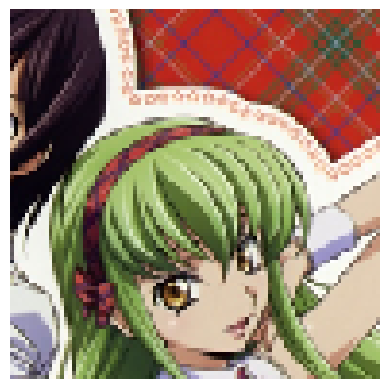

Label verdadera: C.C-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> C.C-Code Geass : 96.85 % confianza.
> Sakuya Izayoi-Touhou : 0.23 % confianza.
> Suzaku Kururugi-Code Geass : 0.14 % confianza.
> Hatsune Miku-Vocaloid : 0.13 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.11 % confianza.


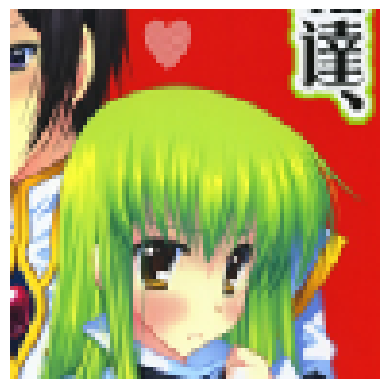

Label verdadera: C.C-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> C.C-Code Geass : 77.45 % confianza.
> Maka Albarn-Soul Eater : 4.25 % confianza.
> Hatsune Miku-Vocaloid : 1.78 % confianza.
> Aisaka Taiga-Toradora : 1.29 % confianza.
> Lelouch Lamperouge-Code Geass : 1.11 % confianza.


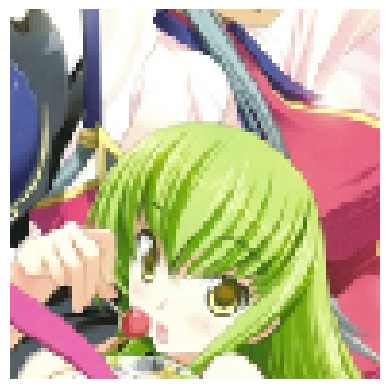

Label verdadera: C.C-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> C.C-Code Geass : 88.83 % confianza.
> Sakuya Izayoi-Touhou : 0.69 % confianza.
> Suzaku Kururugi-Code Geass : 0.66 % confianza.
> Nozomi Tojo-Love Live : 0.54 % confianza.
> Saber-Fate : 0.48 % confianza.


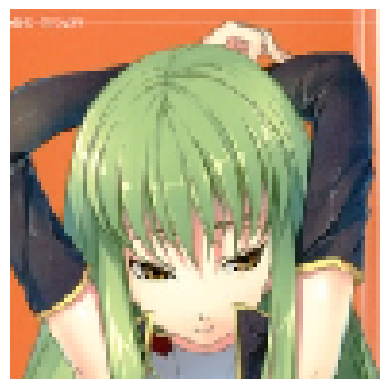

Label verdadera: C.C-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 34ms/step
> C.C-Code Geass : 93.18 % confianza.
> Hatsune Miku-Vocaloid : 0.51 % confianza.
> Sakuya Izayoi-Touhou : 0.31 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.23 % confianza.
> Nozomi Tojo-Love Live : 0.22 % confianza.


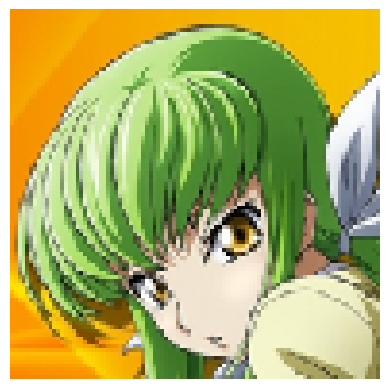

Label verdadera: C.C-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 45ms/step
> C.C-Code Geass : 84.39 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.75 % confianza.
> Lelouch Lamperouge-Code Geass : 0.74 % confianza.
> Suzaku Kururugi-Code Geass : 0.74 % confianza.
> Sakuya Izayoi-Touhou : 0.73 % confianza.


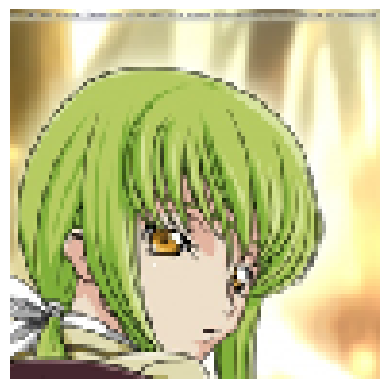

Label verdadera: C.C-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> C.C-Code Geass : 90.41 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 1.08 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.69 % confianza.
> Arcueid Brunestud-Tsukihime : 0.64 % confianza.
> Sakuya Izayoi-Touhou : 0.41 % confianza.


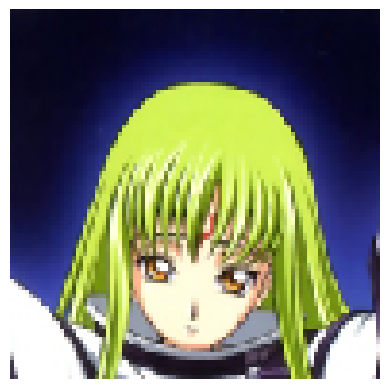

Label verdadera: C.C-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> C.C-Code Geass : 80.99 % confianza.
> Arcueid Brunestud-Tsukihime : 2.67 % confianza.
> Saber-Fate : 1.42 % confianza.
> Maka Albarn-Soul Eater : 0.99 % confianza.
> Flandre Scarlet-Touhou : 0.96 % confianza.


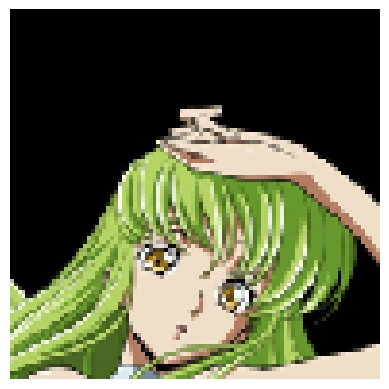

Label verdadera: C.C-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> C.C-Code Geass : 94.22 % confianza.
> Sakuya Izayoi-Touhou : 0.50 % confianza.
> Hatsune Miku-Vocaloid : 0.34 % confianza.
> Sakura Matou-Fate : 0.34 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.28 % confianza.


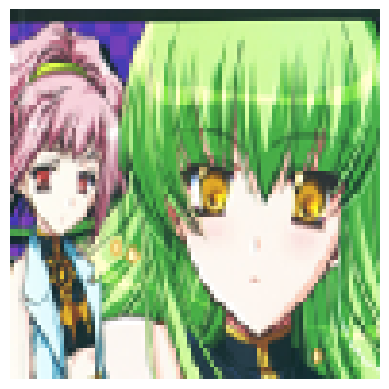

Label verdadera: C.C-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> C.C-Code Geass : 97.27 % confianza.
> Hatsune Miku-Vocaloid : 0.17 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.13 % confianza.
> Sinon-Sword Art Online : 0.12 % confianza.
> Flandre Scarlet-Touhou : 0.11 % confianza.


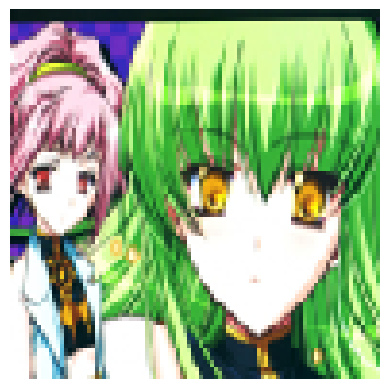

Label verdadera: C.C-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> C.C-Code Geass : 97.03 % confianza.
> Hatsune Miku-Vocaloid : 0.23 % confianza.
> Flandre Scarlet-Touhou : 0.16 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.14 % confianza.
> Sinon-Sword Art Online : 0.13 % confianza.


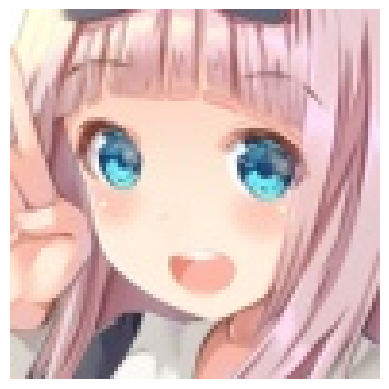

Label verdadera: Chika Fujiwara-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Chika Fujiwara-Kaguya Sama Love Is War : 99.64 % confianza.
> Zero Two-Darling In the Franxx : 0.10 % confianza.
> Amelia Watson-Hololive : 0.06 % confianza.
> Nozomi Tojo-Love Live : 0.05 % confianza.
> Gawr Gura-Hololive : 0.03 % confianza.


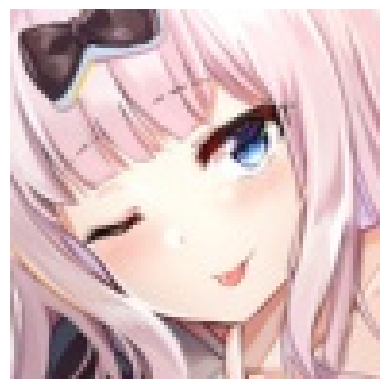

Label verdadera: Chika Fujiwara-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Chika Fujiwara-Kaguya Sama Love Is War : 88.36 % confianza.
> Gawr Gura-Hololive : 2.68 % confianza.
> Paimon-Genshin Impact : 1.55 % confianza.
> Emilia-Re Zero : 0.86 % confianza.
> Amelia Watson-Hololive : 0.69 % confianza.


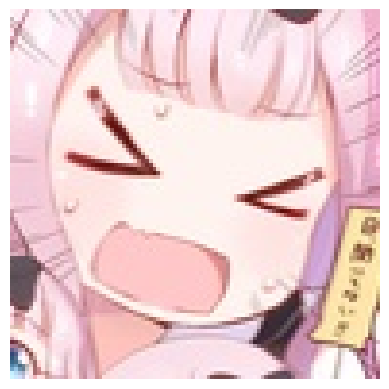

Label verdadera: Chika Fujiwara-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Chika Fujiwara-Kaguya Sama Love Is War : 71.23 % confianza.
> Paimon-Genshin Impact : 8.13 % confianza.
> Gawr Gura-Hololive : 8.02 % confianza.
> Astolfo-Fate : 1.21 % confianza.
> Zero Two-Darling In the Franxx : 1.19 % confianza.


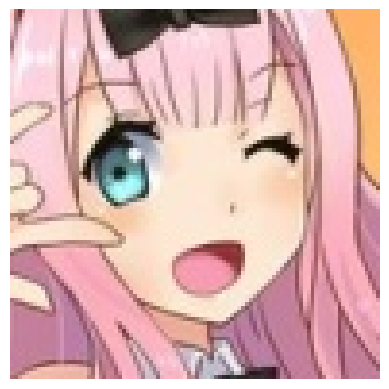

Label verdadera: Chika Fujiwara-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Chika Fujiwara-Kaguya Sama Love Is War : 95.07 % confianza.
> Zero Two-Darling In the Franxx : 2.04 % confianza.
> Nozomi Tojo-Love Live : 0.57 % confianza.
> Astolfo-Fate : 0.32 % confianza.
> Amelia Watson-Hololive : 0.29 % confianza.


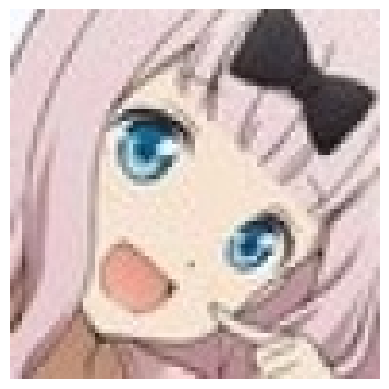

Label verdadera: Chika Fujiwara-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 50ms/step
> Chika Fujiwara-Kaguya Sama Love Is War : 96.20 % confianza.
> Gawr Gura-Hololive : 1.31 % confianza.
> Paimon-Genshin Impact : 0.72 % confianza.
> Nico Robin-One Piece : 0.51 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.25 % confianza.


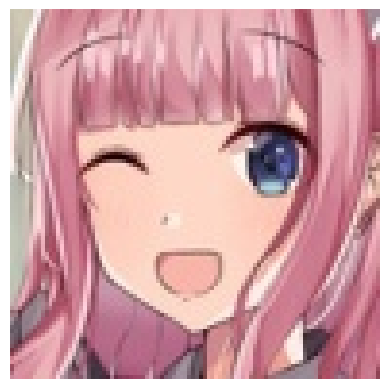

Label verdadera: Chika Fujiwara-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Chika Fujiwara-Kaguya Sama Love Is War : 93.77 % confianza.
> Nino Nakano-Quintessential Quintuplets : 1.91 % confianza.
> Zero Two-Darling In the Franxx : 1.31 % confianza.
> Astolfo-Fate : 1.06 % confianza.
> Miku Nakano-Quintessential Quintuplets : 0.30 % confianza.


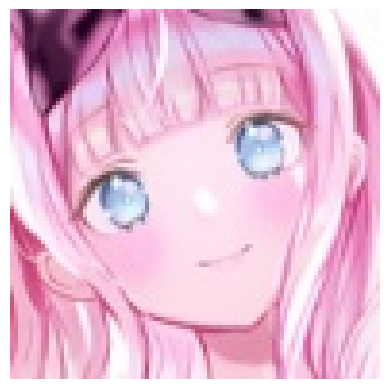

Label verdadera: Chika Fujiwara-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Chika Fujiwara-Kaguya Sama Love Is War : 97.14 % confianza.
> Zero Two-Darling In the Franxx : 1.49 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.54 % confianza.
> Nozomi Tojo-Love Live : 0.09 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 0.08 % confianza.


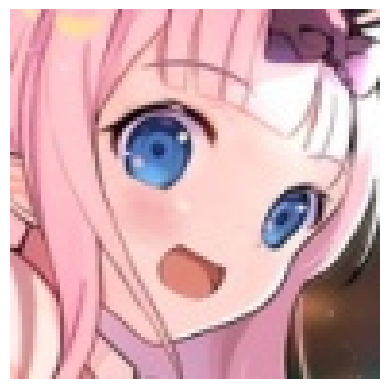

Label verdadera: Chika Fujiwara-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Chika Fujiwara-Kaguya Sama Love Is War : 96.86 % confianza.
> Paimon-Genshin Impact : 0.42 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.32 % confianza.
> Gawr Gura-Hololive : 0.27 % confianza.
> Nico Robin-One Piece : 0.23 % confianza.


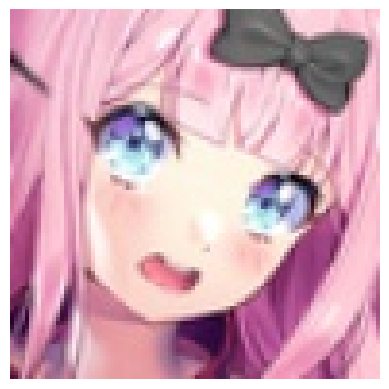

Label verdadera: Chika Fujiwara-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Chika Fujiwara-Kaguya Sama Love Is War : 96.00 % confianza.
> Nino Nakano-Quintessential Quintuplets : 1.38 % confianza.
> Zero Two-Darling In the Franxx : 1.25 % confianza.
> Astolfo-Fate : 0.33 % confianza.
> Nozomi Tojo-Love Live : 0.14 % confianza.


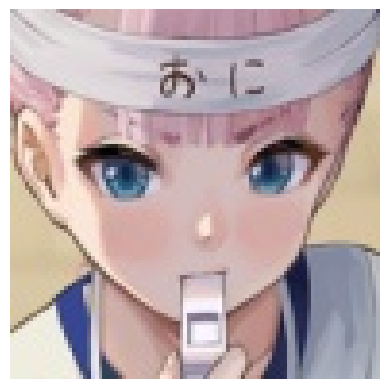

Label verdadera: Chika Fujiwara-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Paimon-Genshin Impact : 66.03 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 18.41 % confianza.
> Nico Robin-One Piece : 8.52 % confianza.
> Gawr Gura-Hololive : 3.22 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 0.77 % confianza.


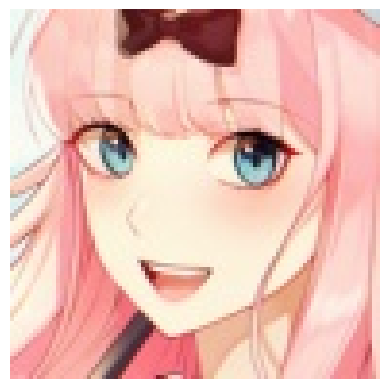

Label verdadera: Chika Fujiwara-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Chika Fujiwara-Kaguya Sama Love Is War : 55.92 % confianza.
> Zero Two-Darling In the Franxx : 37.88 % confianza.
> Nino Nakano-Quintessential Quintuplets : 1.02 % confianza.
> Nozomi Tojo-Love Live : 0.68 % confianza.
> Nico Robin-One Piece : 0.57 % confianza.


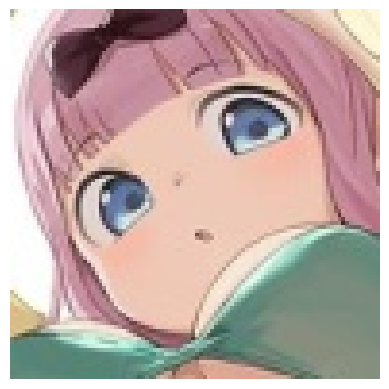

Label verdadera: Chika Fujiwara-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 35ms/step
> Chika Fujiwara-Kaguya Sama Love Is War : 86.97 % confianza.
> Nino Nakano-Quintessential Quintuplets : 1.48 % confianza.
> Paimon-Genshin Impact : 1.35 % confianza.
> Shinobu Kochou-Demon Slayer : 0.94 % confianza.
> Hifumi Takimoto-New Game! : 0.84 % confianza.


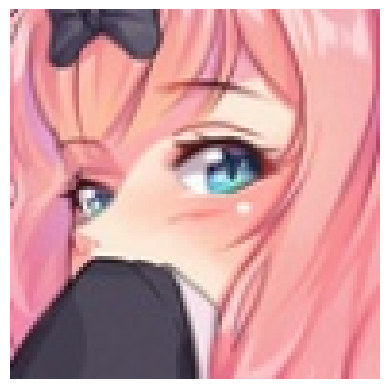

Label verdadera: Chika Fujiwara-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Zero Two-Darling In the Franxx : 75.26 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 10.71 % confianza.
> Astolfo-Fate : 8.84 % confianza.
> Miku Nakano-Quintessential Quintuplets : 0.66 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.45 % confianza.


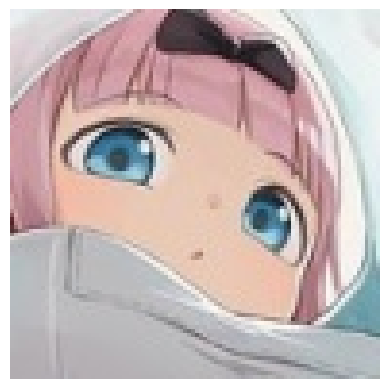

Label verdadera: Chika Fujiwara-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Chika Fujiwara-Kaguya Sama Love Is War : 61.52 % confianza.
> Gawr Gura-Hololive : 10.29 % confianza.
> Paimon-Genshin Impact : 6.96 % confianza.
> Nico Robin-One Piece : 5.43 % confianza.
> Kallen Stadtfeld-Code Geass : 2.65 % confianza.


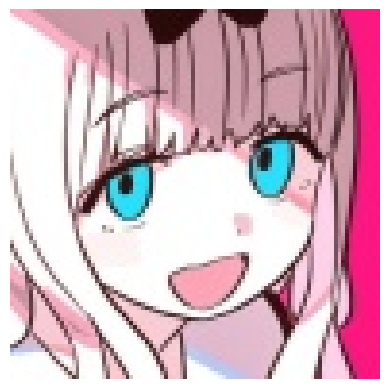

Label verdadera: Chika Fujiwara-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Zero Two-Darling In the Franxx : 61.43 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 31.16 % confianza.
> Nozomi Tojo-Love Live : 1.44 % confianza.
> Fubuki-One Punch Man : 0.63 % confianza.
> Sinon-Sword Art Online : 0.61 % confianza.


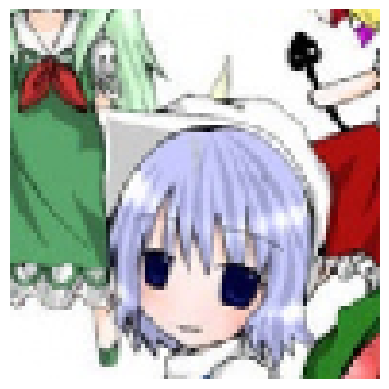

Label verdadera: Cirno-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Sakuya Izayoi-Touhou : 97.50 % confianza.
> Sakura Matou-Fate : 0.52 % confianza.
> Cirno-Touhou : 0.50 % confianza.
> Scarlet Remilia-Touhou : 0.38 % confianza.
> Kagami Hiiragi-Lucky Star : 0.32 % confianza.


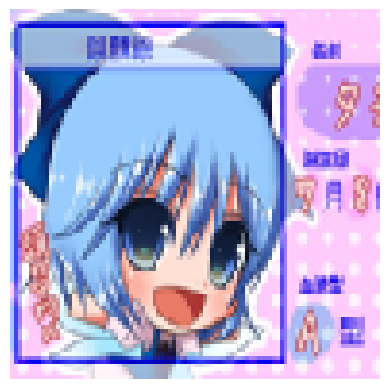

Label verdadera: Cirno-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Cirno-Touhou : 92.96 % confianza.
> Sakuya Izayoi-Touhou : 2.79 % confianza.
> Konata Izumi-Lucky Star : 1.16 % confianza.
> Hatsune Miku-Vocaloid : 0.89 % confianza.
> Maka Albarn-Soul Eater : 0.43 % confianza.


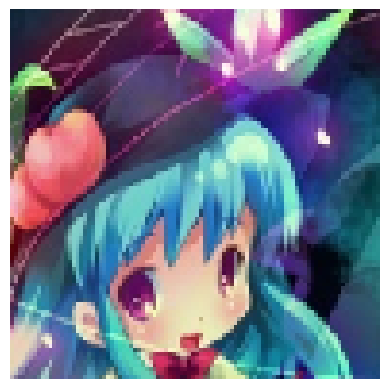

Label verdadera: Cirno-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Hatsune Miku-Vocaloid : 72.01 % confianza.
> Cirno-Touhou : 22.85 % confianza.
> C.C-Code Geass : 2.54 % confianza.
> Flandre Scarlet-Touhou : 0.36 % confianza.
> Sakuya Izayoi-Touhou : 0.35 % confianza.


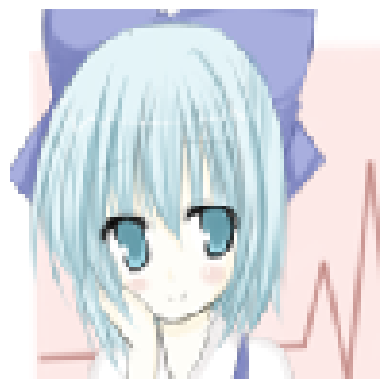

Label verdadera: Cirno-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 40ms/step
> Cirno-Touhou : 73.91 % confianza.
> Hatsune Miku-Vocaloid : 10.52 % confianza.
> Sakuya Izayoi-Touhou : 3.46 % confianza.
> Miku Nakano-Quintessential Quintuplets : 1.95 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 1.30 % confianza.


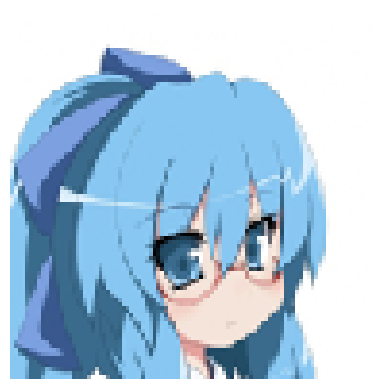

Label verdadera: Cirno-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Cirno-Touhou : 66.93 % confianza.
> Hatsune Miku-Vocaloid : 19.95 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 8.30 % confianza.
> Sakuya Izayoi-Touhou : 0.87 % confianza.
> Konata Izumi-Lucky Star : 0.56 % confianza.


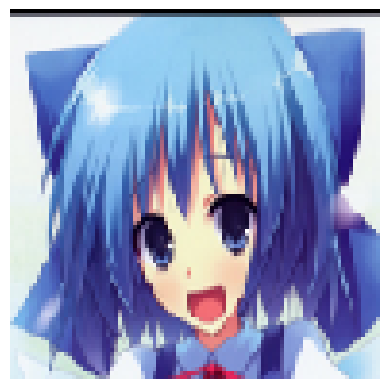

Label verdadera: Cirno-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 32ms/step
> Cirno-Touhou : 78.44 % confianza.
> Sakuya Izayoi-Touhou : 4.75 % confianza.
> Konata Izumi-Lucky Star : 4.31 % confianza.
> Hatsune Miku-Vocaloid : 2.05 % confianza.
> Shiki Ryougi-Garden of Sinners : 1.15 % confianza.


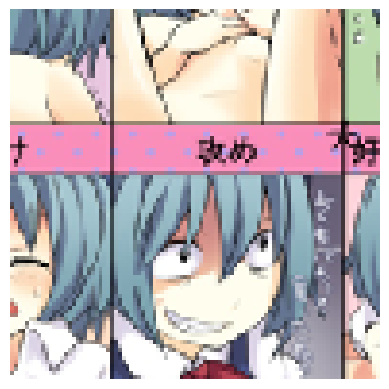

Label verdadera: Cirno-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Cirno-Touhou : 70.58 % confianza.
> Hatsune Miku-Vocaloid : 15.13 % confianza.
> Sakuya Izayoi-Touhou : 6.47 % confianza.
> Gawr Gura-Hololive : 0.62 % confianza.
> Scarlet Remilia-Touhou : 0.52 % confianza.


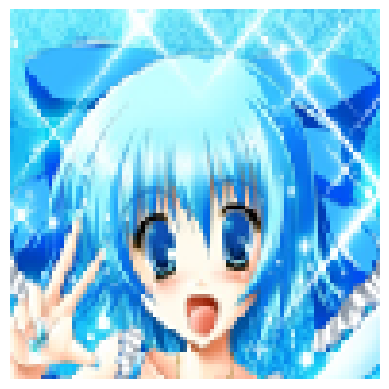

Label verdadera: Cirno-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Cirno-Touhou : 94.76 % confianza.
> Hatsune Miku-Vocaloid : 0.87 % confianza.
> Kagami Hiiragi-Lucky Star : 0.51 % confianza.
> Gawr Gura-Hololive : 0.43 % confianza.
> Sakuya Izayoi-Touhou : 0.42 % confianza.


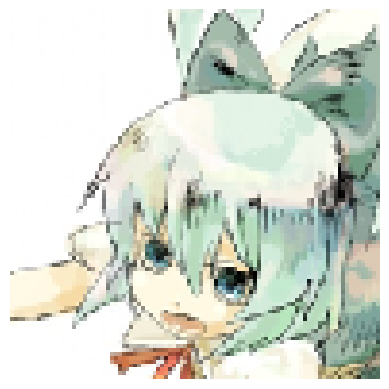

Label verdadera: Cirno-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Cirno-Touhou : 80.90 % confianza.
> Hatsune Miku-Vocaloid : 7.56 % confianza.
> Sakuya Izayoi-Touhou : 3.78 % confianza.
> Maka Albarn-Soul Eater : 3.60 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.53 % confianza.


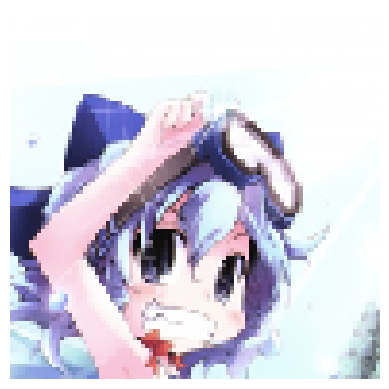

Label verdadera: Cirno-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Sakuya Izayoi-Touhou : 58.44 % confianza.
> Scarlet Remilia-Touhou : 17.29 % confianza.
> Cirno-Touhou : 7.76 % confianza.
> Kagami Hiiragi-Lucky Star : 5.07 % confianza.
> Rin Tohsakaka-Fate : 2.42 % confianza.


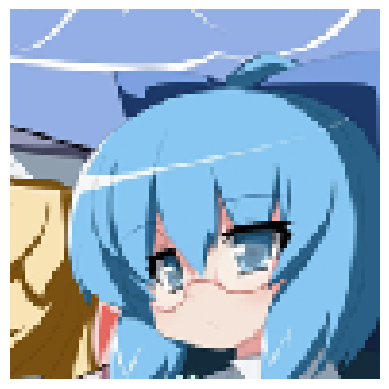

Label verdadera: Cirno-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Hatsune Miku-Vocaloid : 49.58 % confianza.
> Cirno-Touhou : 24.54 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 19.63 % confianza.
> Sakuya Izayoi-Touhou : 1.30 % confianza.
> Konata Izumi-Lucky Star : 0.32 % confianza.


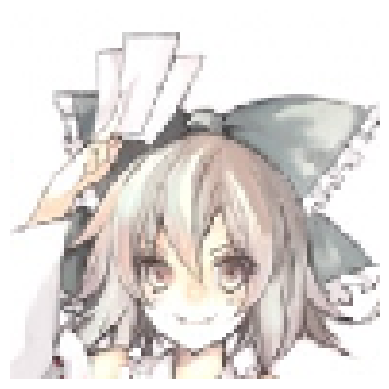

Label verdadera: Cirno-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Cirno-Touhou : 36.90 % confianza.
> Sakuya Izayoi-Touhou : 27.93 % confianza.
> Scarlet Remilia-Touhou : 10.22 % confianza.
> Illyasviel Von Einzbern-Fate : 2.57 % confianza.
> Hatsune Miku-Vocaloid : 1.94 % confianza.


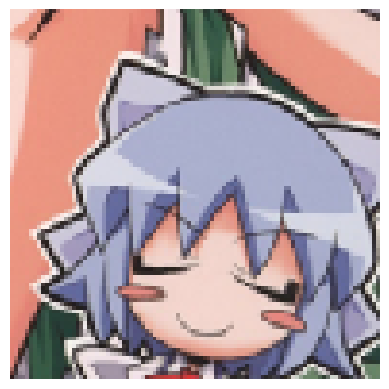

Label verdadera: Cirno-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Cirno-Touhou : 95.77 % confianza.
> Sakuya Izayoi-Touhou : 3.45 % confianza.
> Hatsune Miku-Vocaloid : 0.28 % confianza.
> Scarlet Remilia-Touhou : 0.17 % confianza.
> Konata Izumi-Lucky Star : 0.09 % confianza.


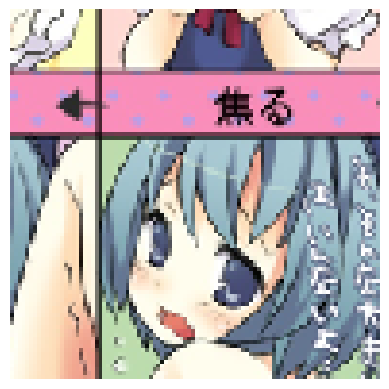

Label verdadera: Cirno-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Cirno-Touhou : 49.24 % confianza.
> Sakuya Izayoi-Touhou : 46.73 % confianza.
> Hatsune Miku-Vocaloid : 1.25 % confianza.
> Scarlet Remilia-Touhou : 0.68 % confianza.
> Kagami Hiiragi-Lucky Star : 0.23 % confianza.


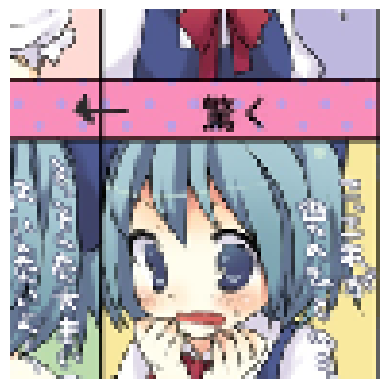

Label verdadera: Cirno-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Sakuya Izayoi-Touhou : 48.34 % confianza.
> Cirno-Touhou : 42.04 % confianza.
> Kagami Hiiragi-Lucky Star : 3.66 % confianza.
> Hatsune Miku-Vocaloid : 0.81 % confianza.
> Maka Albarn-Soul Eater : 0.34 % confianza.


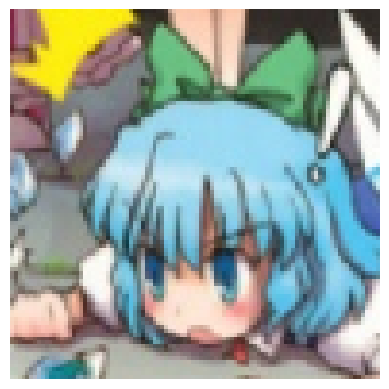

Label verdadera: Cirno-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 34ms/step
> Cirno-Touhou : 84.00 % confianza.
> Hatsune Miku-Vocaloid : 13.16 % confianza.
> Sakuya Izayoi-Touhou : 1.29 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.20 % confianza.
> Konata Izumi-Lucky Star : 0.10 % confianza.


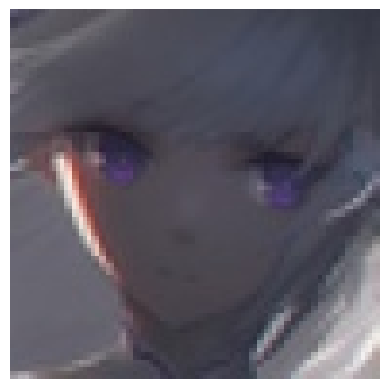

Label verdadera: Emilia-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Hinata Hyuuga-Naruto : 53.23 % confianza.
> Albedo-Overlord : 21.02 % confianza.
> Shiki Ryougi-Garden of Sinners : 5.22 % confianza.
> Aegis-Persona : 2.48 % confianza.
> Gawr Gura-Hololive : 2.19 % confianza.


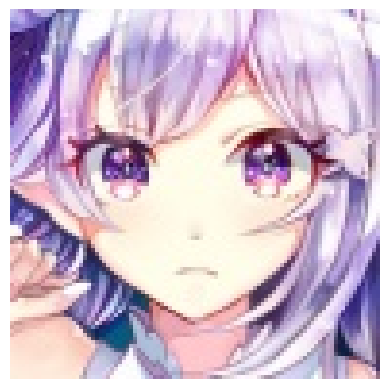

Label verdadera: Emilia-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Emilia-Re Zero : 73.59 % confianza.
> Keqing-Genshin Impact : 9.46 % confianza.
> Rem-Re Zero : 2.14 % confianza.
> Nozomi Tojo-Love Live : 1.21 % confianza.
> Gawr Gura-Hololive : 1.08 % confianza.


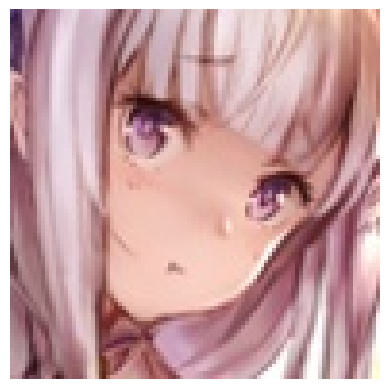

Label verdadera: Emilia-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Emilia-Re Zero : 89.61 % confianza.
> Astolfo-Fate : 3.15 % confianza.
> Asuna Yuuki-Sword Art Online : 0.78 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.73 % confianza.
> Gawr Gura-Hololive : 0.52 % confianza.


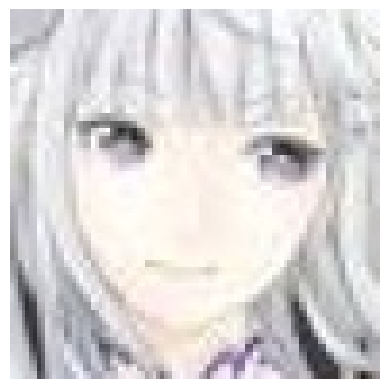

Label verdadera: Emilia-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Asuna Yuuki-Sword Art Online : 62.88 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 7.81 % confianza.
> Maki Nishikino-Love Live : 7.54 % confianza.
> Emilia-Re Zero : 6.19 % confianza.
> Shouko Komi-Komi Cant Communicate : 5.06 % confianza.


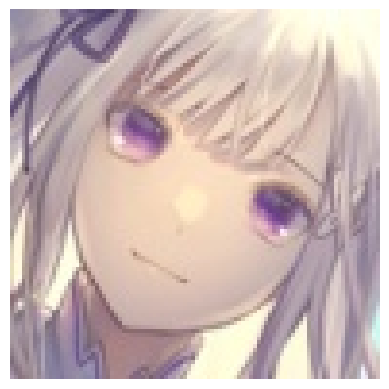

Label verdadera: Emilia-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Emilia-Re Zero : 99.86 % confianza.
> Keqing-Genshin Impact : 0.03 % confianza.
> Shinobu Kochou-Demon Slayer : 0.02 % confianza.
> Shouko Komi-Komi Cant Communicate : 0.02 % confianza.
> C.C-Code Geass : 0.01 % confianza.


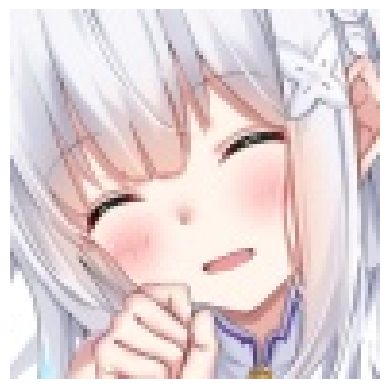

Label verdadera: Emilia-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Emilia-Re Zero : 57.10 % confianza.
> Gawr Gura-Hololive : 33.07 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 2.09 % confianza.
> Miku Nakano-Quintessential Quintuplets : 1.47 % confianza.
> Shouko Komi-Komi Cant Communicate : 1.34 % confianza.


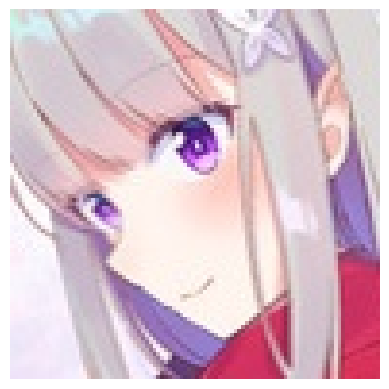

Label verdadera: Emilia-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Emilia-Re Zero : 96.56 % confianza.
> Keqing-Genshin Impact : 0.77 % confianza.
> Ram-Re Zero : 0.76 % confianza.
> Rem-Re Zero : 0.15 % confianza.
> Asuna Yuuki-Sword Art Online : 0.12 % confianza.


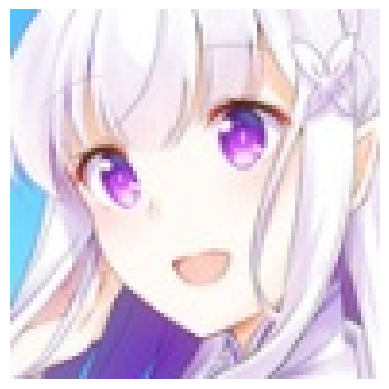

Label verdadera: Emilia-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 42ms/step
> Emilia-Re Zero : 98.38 % confianza.
> Gawr Gura-Hololive : 1.03 % confianza.
> Paimon-Genshin Impact : 0.11 % confianza.
> Asuna Yuuki-Sword Art Online : 0.05 % confianza.
> Nezuko Kamado-Demon Slayer : 0.03 % confianza.


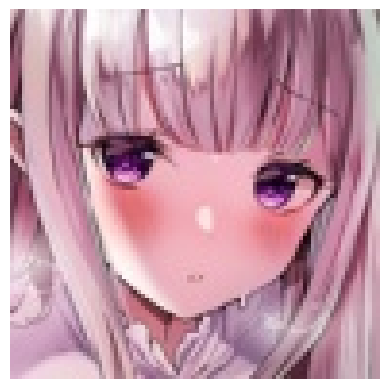

Label verdadera: Emilia-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Chika Fujiwara-Kaguya Sama Love Is War : 33.53 % confianza.
> Emilia-Re Zero : 27.91 % confianza.
> Nino Nakano-Quintessential Quintuplets : 8.20 % confianza.
> Paimon-Genshin Impact : 3.62 % confianza.
> Astolfo-Fate : 3.22 % confianza.


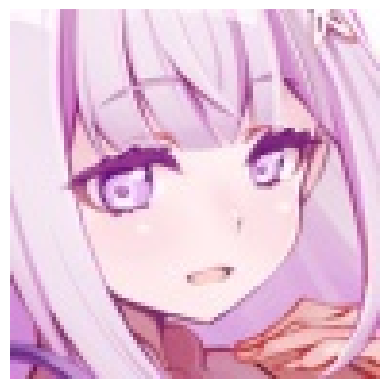

Label verdadera: Emilia-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Emilia-Re Zero : 19.84 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 12.33 % confianza.
> Gawr Gura-Hololive : 9.52 % confianza.
> Paimon-Genshin Impact : 7.52 % confianza.
> Nezuko Kamado-Demon Slayer : 6.20 % confianza.


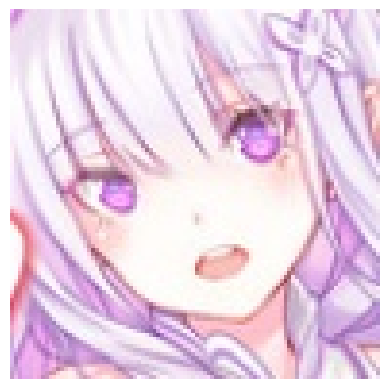

Label verdadera: Emilia-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Emilia-Re Zero : 87.37 % confianza.
> Gawr Gura-Hololive : 1.94 % confianza.
> Keqing-Genshin Impact : 1.13 % confianza.
> Asuna Yuuki-Sword Art Online : 0.97 % confianza.
> Raphtalia-Rising of the Shield Hero : 0.91 % confianza.


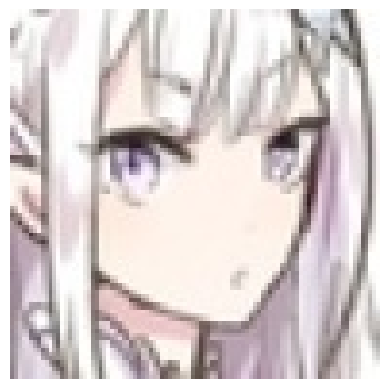

Label verdadera: Emilia-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Asuna Yuuki-Sword Art Online : 34.87 % confianza.
> Kurisu Makise-Steins Gate : 20.82 % confianza.
> Maki Nishikino-Love Live : 8.45 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 6.55 % confianza.
> Miku Nakano-Quintessential Quintuplets : 4.13 % confianza.


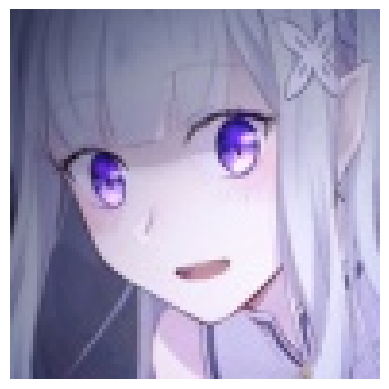

Label verdadera: Emilia-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Emilia-Re Zero : 59.06 % confianza.
> Keqing-Genshin Impact : 15.53 % confianza.
> Shinobu Kochou-Demon Slayer : 11.61 % confianza.
> Hinata Hyuuga-Naruto : 1.58 % confianza.
> Megumin-Konosuba : 0.81 % confianza.


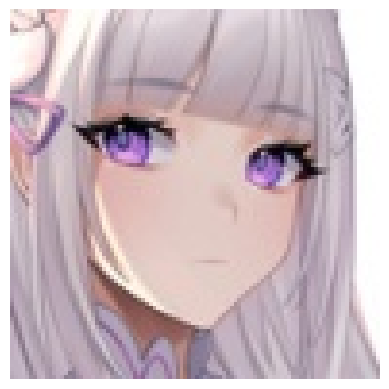

Label verdadera: Emilia-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Emilia-Re Zero : 99.71 % confianza.
> Keqing-Genshin Impact : 0.08 % confianza.
> Gawr Gura-Hololive : 0.02 % confianza.
> Shouko Komi-Komi Cant Communicate : 0.02 % confianza.
> Raphtalia-Rising of the Shield Hero : 0.01 % confianza.


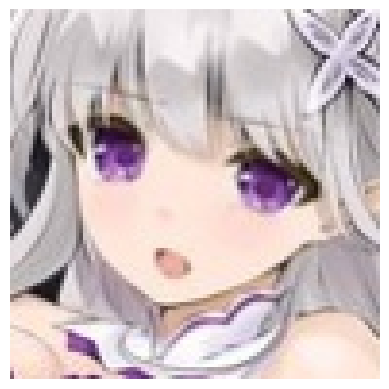

Label verdadera: Emilia-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Emilia-Re Zero : 97.51 % confianza.
> Gawr Gura-Hololive : 0.40 % confianza.
> Paimon-Genshin Impact : 0.33 % confianza.
> Keqing-Genshin Impact : 0.24 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.15 % confianza.


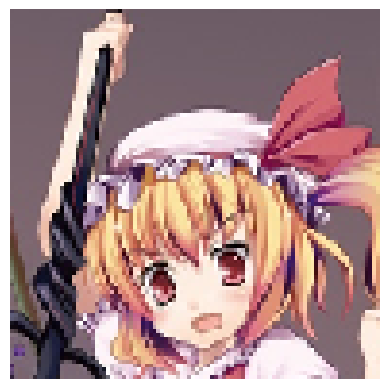

Label verdadera: Flandre Scarlet-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Flandre Scarlet-Touhou : 70.49 % confianza.
> Arcueid Brunestud-Tsukihime : 15.29 % confianza.
> Saber-Fate : 5.23 % confianza.
> Illyasviel Von Einzbern-Fate : 1.27 % confianza.
> C.C-Code Geass : 0.71 % confianza.


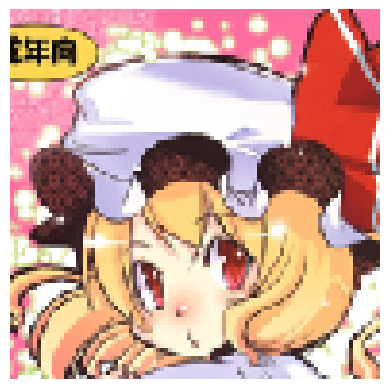

Label verdadera: Flandre Scarlet-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Flandre Scarlet-Touhou : 99.89 % confianza.
> C.C-Code Geass : 0.03 % confianza.
> Arcueid Brunestud-Tsukihime : 0.02 % confianza.
> Reimu Hakurei-Touhou : 0.01 % confianza.
> Nia Teppelin-Gurrenn Lagann : 0.00 % confianza.


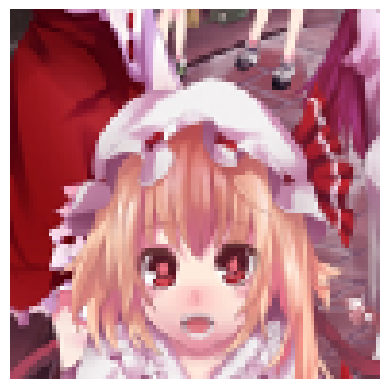

Label verdadera: Flandre Scarlet-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Scarlet Remilia-Touhou : 50.36 % confianza.
> Arcueid Brunestud-Tsukihime : 23.27 % confianza.
> Flandre Scarlet-Touhou : 14.23 % confianza.
> Sakuya Izayoi-Touhou : 4.50 % confianza.
> Illyasviel Von Einzbern-Fate : 1.29 % confianza.


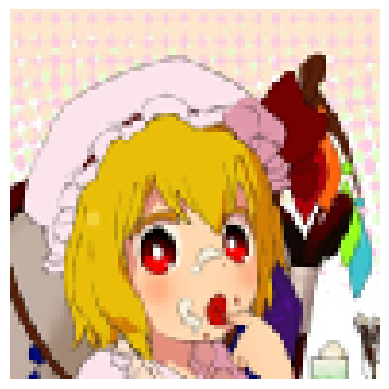

Label verdadera: Flandre Scarlet-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Aisaka Taiga-Toradora : 39.64 % confianza.
> Yui Hirasawa-K ON! : 13.84 % confianza.
> Nia Teppelin-Gurrenn Lagann : 10.28 % confianza.
> Arcueid Brunestud-Tsukihime : 7.41 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 5.40 % confianza.


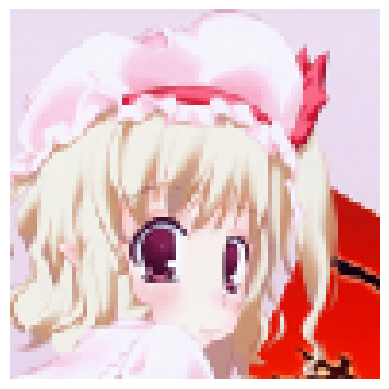

Label verdadera: Flandre Scarlet-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Illyasviel Von Einzbern-Fate : 17.93 % confianza.
> Scarlet Remilia-Touhou : 15.64 % confianza.
> Flandre Scarlet-Touhou : 14.43 % confianza.
> Arcueid Brunestud-Tsukihime : 11.83 % confianza.
> Sakuya Izayoi-Touhou : 6.74 % confianza.


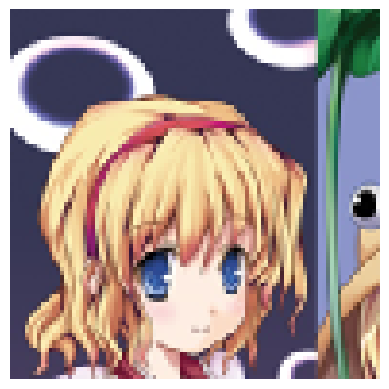

Label verdadera: Flandre Scarlet-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Saber-Fate : 40.50 % confianza.
> Flandre Scarlet-Touhou : 10.76 % confianza.
> Arcueid Brunestud-Tsukihime : 5.76 % confianza.
> Kotobuki Tsumugi-K ON! : 4.29 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 4.25 % confianza.


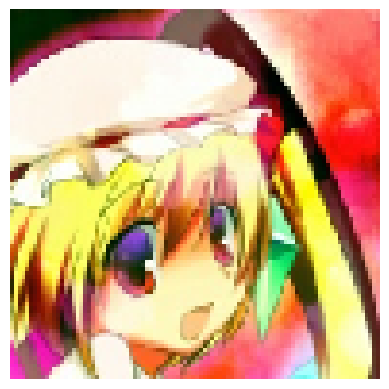

Label verdadera: Flandre Scarlet-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 48ms/step
> Flandre Scarlet-Touhou : 44.13 % confianza.
> C.C-Code Geass : 12.34 % confianza.
> Saber-Fate : 7.90 % confianza.
> Hatsune Miku-Vocaloid : 5.86 % confianza.
> Arcueid Brunestud-Tsukihime : 4.97 % confianza.


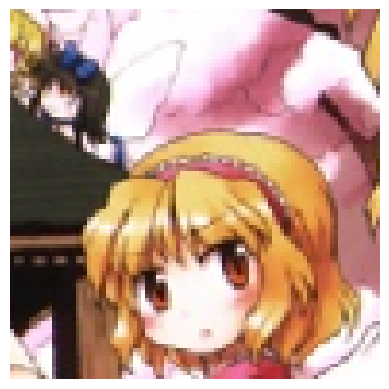

Label verdadera: Flandre Scarlet-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Flandre Scarlet-Touhou : 98.04 % confianza.
> Arcueid Brunestud-Tsukihime : 1.35 % confianza.
> Aisaka Taiga-Toradora : 0.13 % confianza.
> C.C-Code Geass : 0.08 % confianza.
> Saber-Fate : 0.08 % confianza.


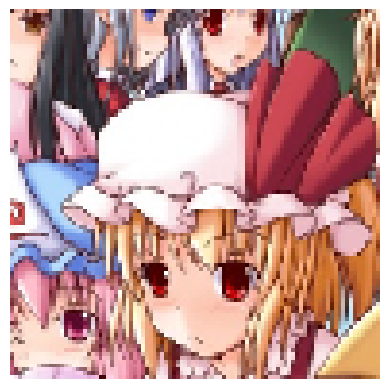

Label verdadera: Flandre Scarlet-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Flandre Scarlet-Touhou : 62.81 % confianza.
> Scarlet Remilia-Touhou : 19.11 % confianza.
> Reimu Hakurei-Touhou : 2.82 % confianza.
> Arcueid Brunestud-Tsukihime : 1.92 % confianza.
> Asuna Yuuki-Sword Art Online : 1.20 % confianza.


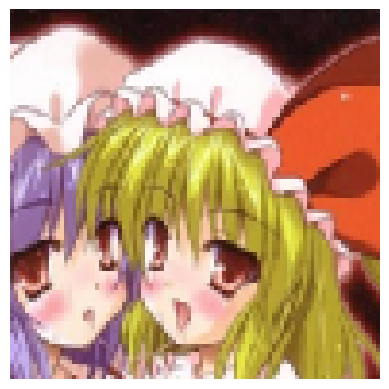

Label verdadera: Flandre Scarlet-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 35ms/step
> Flandre Scarlet-Touhou : 93.29 % confianza.
> C.C-Code Geass : 3.59 % confianza.
> Arcueid Brunestud-Tsukihime : 0.43 % confianza.
> Reimu Hakurei-Touhou : 0.25 % confianza.
> Aisaka Taiga-Toradora : 0.22 % confianza.


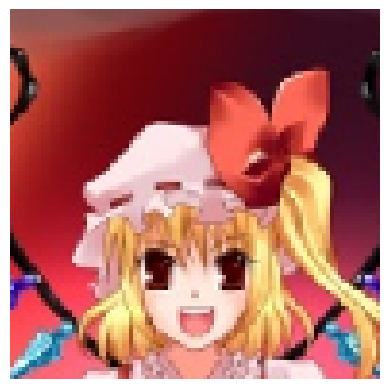

Label verdadera: Flandre Scarlet-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Flandre Scarlet-Touhou : 76.43 % confianza.
> Scarlet Remilia-Touhou : 12.43 % confianza.
> Arcueid Brunestud-Tsukihime : 3.58 % confianza.
> Nia Teppelin-Gurrenn Lagann : 1.47 % confianza.
> Illyasviel Von Einzbern-Fate : 0.94 % confianza.


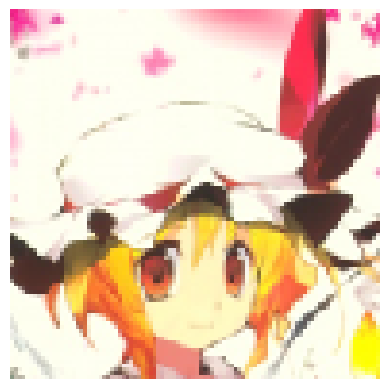

Label verdadera: Flandre Scarlet-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Flandre Scarlet-Touhou : 99.50 % confianza.
> Reimu Hakurei-Touhou : 0.08 % confianza.
> Illyasviel Von Einzbern-Fate : 0.07 % confianza.
> Nia Teppelin-Gurrenn Lagann : 0.06 % confianza.
> Yoko Littner-Gurrenn Lagann : 0.04 % confianza.


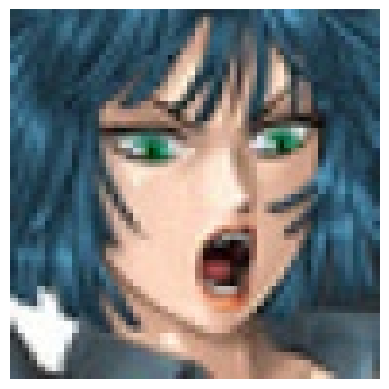

Label verdadera: Fubuki-One Punch Man
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Fubuki-One Punch Man : 41.31 % confianza.
> Sinon-Sword Art Online : 14.36 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 3.59 % confianza.
> Nico Robin-One Piece : 3.15 % confianza.
> Gawr Gura-Hololive : 3.10 % confianza.


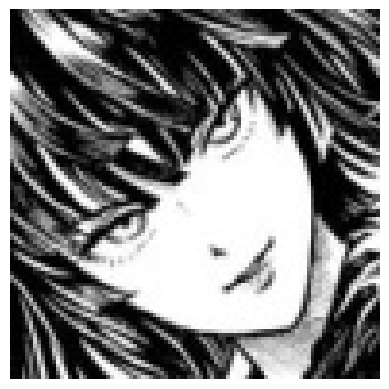

Label verdadera: Fubuki-One Punch Man
Este personaje posiblemente es:
1/1 [==============================] - 0s 42ms/step
> Fubuki-One Punch Man : 95.56 % confianza.
> Suzaku Kururugi-Code Geass : 0.59 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.47 % confianza.
> Kurisu Makise-Steins Gate : 0.45 % confianza.
> C.C-Code Geass : 0.35 % confianza.


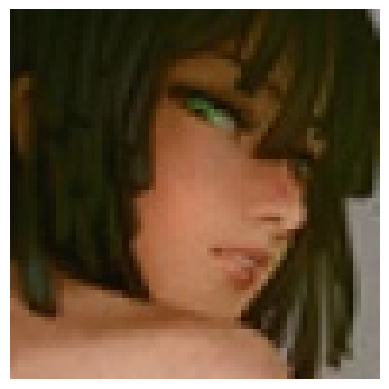

Label verdadera: Fubuki-One Punch Man
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Fubuki-One Punch Man : 97.97 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 1.09 % confianza.
> Nico Robin-One Piece : 0.13 % confianza.
> Albedo-Overlord : 0.13 % confianza.
> Zero Two-Darling In the Franxx : 0.10 % confianza.


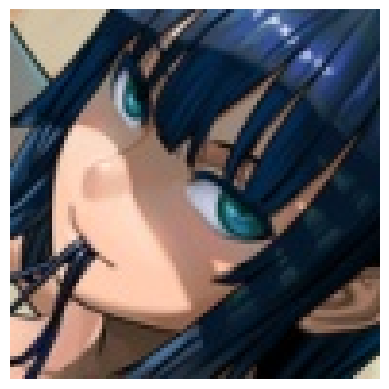

Label verdadera: Fubuki-One Punch Man
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Fubuki-One Punch Man : 25.73 % confianza.
> Kirito-Sword Art Online : 11.77 % confianza.
> Ouro Kronii-Hololive : 11.64 % confianza.
> Nico Robin-One Piece : 5.79 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 5.17 % confianza.


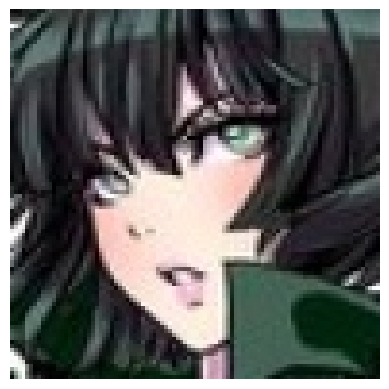

Label verdadera: Fubuki-One Punch Man
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Fubuki-One Punch Man : 97.48 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.73 % confianza.
> Suzaku Kururugi-Code Geass : 0.45 % confianza.
> Lelouch Lamperouge-Code Geass : 0.26 % confianza.
> Kirito-Sword Art Online : 0.09 % confianza.


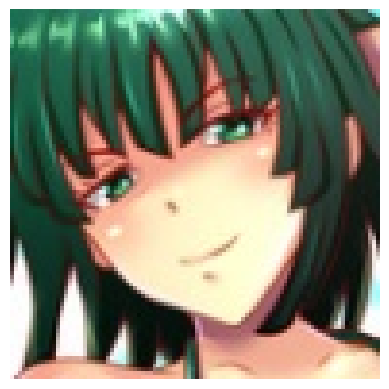

Label verdadera: Fubuki-One Punch Man
Este personaje posiblemente es:
1/1 [==============================] - 0s 32ms/step
> Fubuki-One Punch Man : 96.21 % confianza.
> Sinon-Sword Art Online : 0.57 % confianza.
> Nezuko Kamado-Demon Slayer : 0.52 % confianza.
> Hatsune Miku-Vocaloid : 0.45 % confianza.
> C.C-Code Geass : 0.36 % confianza.


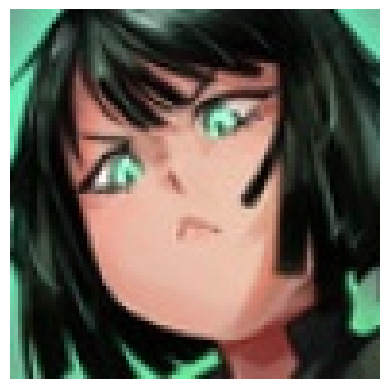

Label verdadera: Fubuki-One Punch Man
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Fubuki-One Punch Man : 99.55 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.08 % confianza.
> Zero Two-Darling In the Franxx : 0.05 % confianza.
> Rin Tohsakaka-Fate : 0.04 % confianza.
> Suzaku Kururugi-Code Geass : 0.03 % confianza.


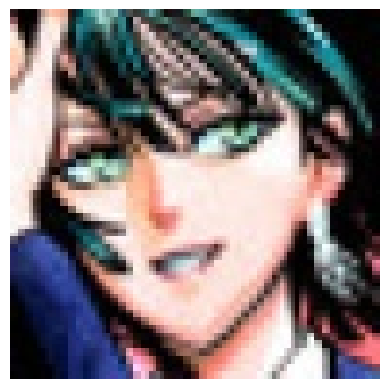

Label verdadera: Fubuki-One Punch Man
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Fubuki-One Punch Man : 95.84 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 2.97 % confianza.
> Nico Robin-One Piece : 0.20 % confianza.
> Lelouch Lamperouge-Code Geass : 0.11 % confianza.
> Suzaku Kururugi-Code Geass : 0.07 % confianza.


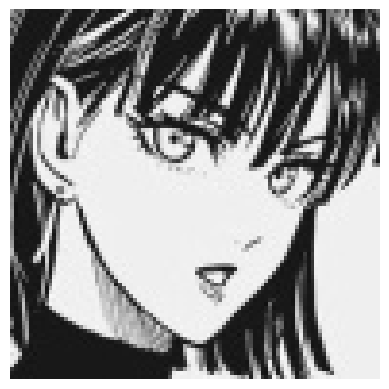

Label verdadera: Fubuki-One Punch Man
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Fubuki-One Punch Man : 71.87 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 5.08 % confianza.
> Shouko Komi-Komi Cant Communicate : 4.73 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 3.72 % confianza.
> Hifumi Takimoto-New Game! : 2.02 % confianza.


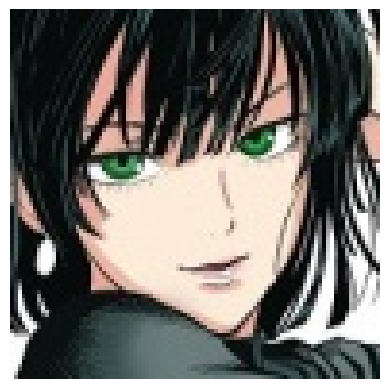

Label verdadera: Fubuki-One Punch Man
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Fubuki-One Punch Man : 91.13 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 1.39 % confianza.
> Lelouch Lamperouge-Code Geass : 1.03 % confianza.
> Suzaku Kururugi-Code Geass : 0.95 % confianza.
> Zero Two-Darling In the Franxx : 0.62 % confianza.


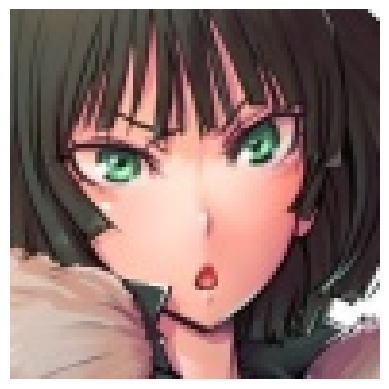

Label verdadera: Fubuki-One Punch Man
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Fubuki-One Punch Man : 97.73 % confianza.
> Zero Two-Darling In the Franxx : 0.41 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.39 % confianza.
> Suzaku Kururugi-Code Geass : 0.10 % confianza.
> Sinon-Sword Art Online : 0.10 % confianza.


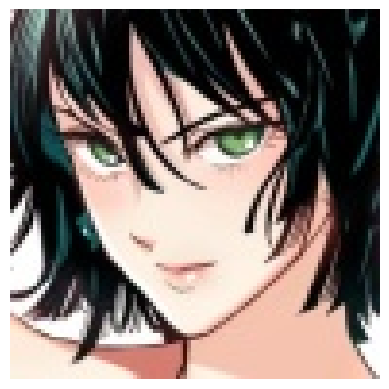

Label verdadera: Fubuki-One Punch Man
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Fubuki-One Punch Man : 90.44 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 1.75 % confianza.
> Zero Two-Darling In the Franxx : 0.89 % confianza.
> Nico Robin-One Piece : 0.67 % confianza.
> Lelouch Lamperouge-Code Geass : 0.60 % confianza.


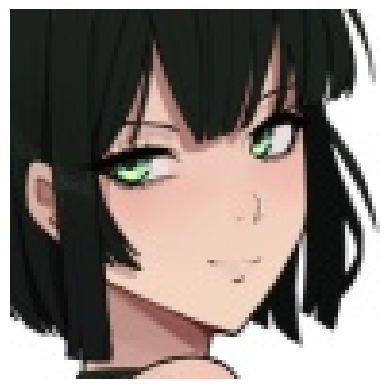

Label verdadera: Fubuki-One Punch Man
Este personaje posiblemente es:
1/1 [==============================] - 0s 50ms/step
> Fubuki-One Punch Man : 60.14 % confianza.
> Kirito-Sword Art Online : 8.85 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 6.08 % confianza.
> Nico Robin-One Piece : 4.90 % confianza.
> Albedo-Overlord : 3.00 % confianza.


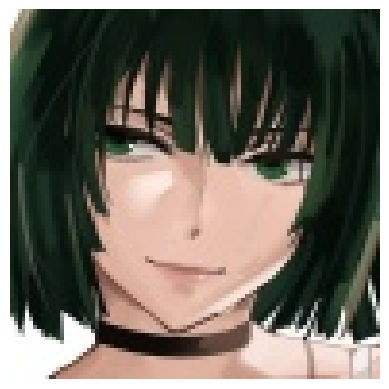

Label verdadera: Fubuki-One Punch Man
Este personaje posiblemente es:
1/1 [==============================] - 0s 22ms/step
> Fubuki-One Punch Man : 98.34 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.33 % confianza.
> Nico Robin-One Piece : 0.17 % confianza.
> Lelouch Lamperouge-Code Geass : 0.16 % confianza.
> Rin Tohsakaka-Fate : 0.11 % confianza.


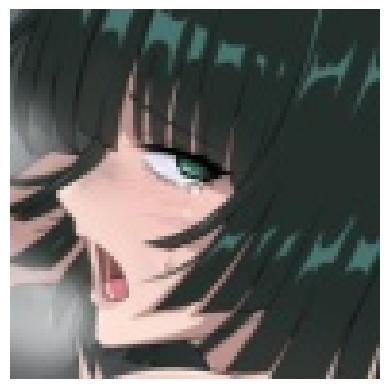

Label verdadera: Fubuki-One Punch Man
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Fubuki-One Punch Man : 98.95 % confianza.
> Albedo-Overlord : 0.19 % confianza.
> Kirito-Sword Art Online : 0.18 % confianza.
> Nico Robin-One Piece : 0.14 % confianza.
> Sinon-Sword Art Online : 0.08 % confianza.


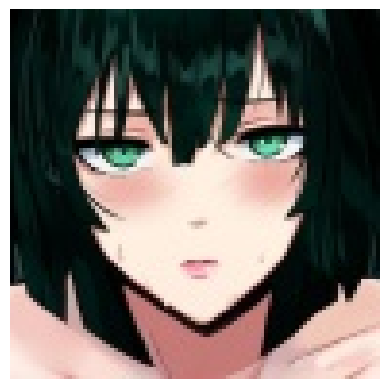

Label verdadera: Fubuki-One Punch Man
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Fubuki-One Punch Man : 93.69 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 1.21 % confianza.
> Zero Two-Darling In the Franxx : 0.34 % confianza.
> Nico Robin-One Piece : 0.33 % confianza.
> Albedo-Overlord : 0.33 % confianza.


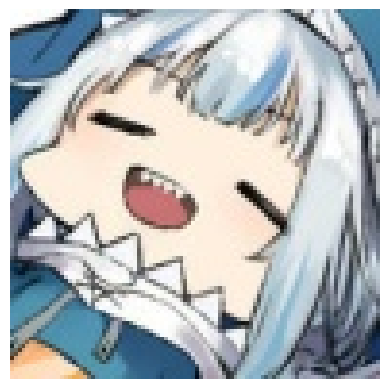

Label verdadera: Gawr Gura-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Gawr Gura-Hololive : 87.77 % confianza.
> Paimon-Genshin Impact : 6.39 % confianza.
> Cirno-Touhou : 0.81 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.54 % confianza.
> Aqua-Konosuba : 0.54 % confianza.


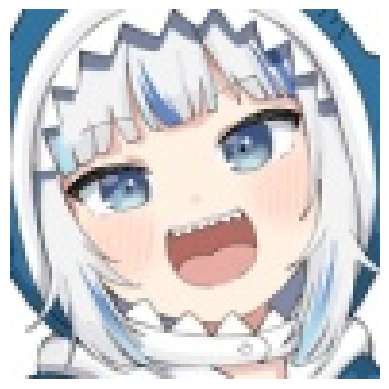

Label verdadera: Gawr Gura-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Gawr Gura-Hololive : 98.48 % confianza.
> Paimon-Genshin Impact : 0.85 % confianza.
> Nico Robin-One Piece : 0.19 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.09 % confianza.
> Rem-Re Zero : 0.08 % confianza.


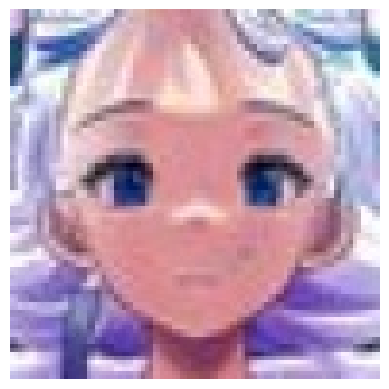

Label verdadera: Gawr Gura-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Gawr Gura-Hololive : 57.12 % confianza.
> Rem-Re Zero : 26.21 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 3.04 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 1.46 % confianza.
> Amelia Watson-Hololive : 1.40 % confianza.


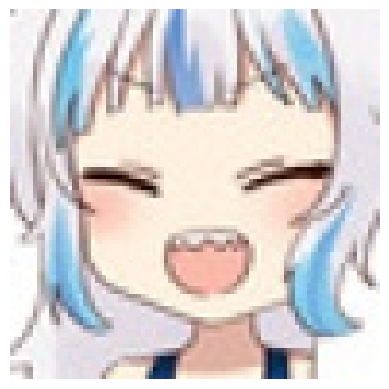

Label verdadera: Gawr Gura-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Gawr Gura-Hololive : 97.92 % confianza.
> Rem-Re Zero : 0.27 % confianza.
> Aqua-Konosuba : 0.25 % confianza.
> Paimon-Genshin Impact : 0.22 % confianza.
> Sinon-Sword Art Online : 0.20 % confianza.


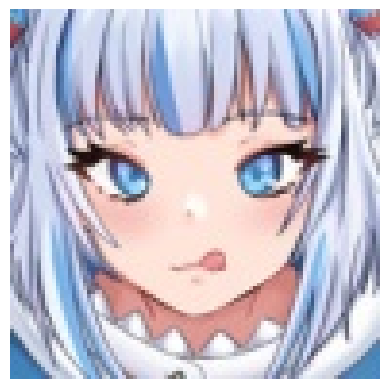

Label verdadera: Gawr Gura-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Gawr Gura-Hololive : 91.84 % confianza.
> Rem-Re Zero : 2.38 % confianza.
> Paimon-Genshin Impact : 1.67 % confianza.
> Aqua-Konosuba : 1.31 % confianza.
> Cirno-Touhou : 0.28 % confianza.


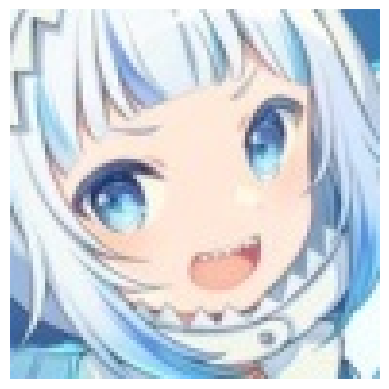

Label verdadera: Gawr Gura-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 39ms/step
> Gawr Gura-Hololive : 98.18 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 0.30 % confianza.
> Paimon-Genshin Impact : 0.15 % confianza.
> Cirno-Touhou : 0.13 % confianza.
> Rem-Re Zero : 0.12 % confianza.


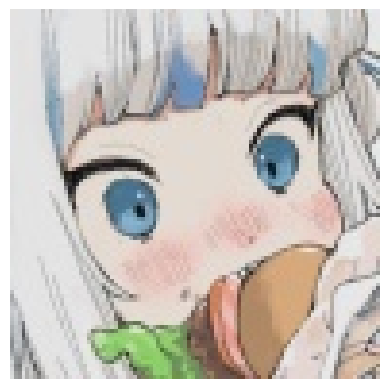

Label verdadera: Gawr Gura-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Gawr Gura-Hololive : 71.48 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 17.04 % confianza.
> Paimon-Genshin Impact : 6.15 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 0.57 % confianza.
> Amelia Watson-Hololive : 0.50 % confianza.


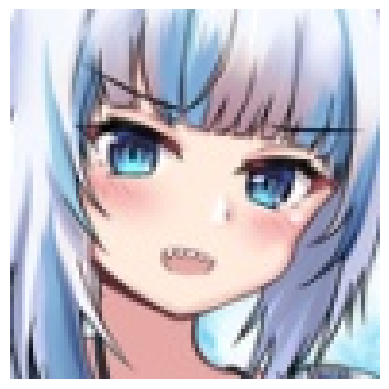

Label verdadera: Gawr Gura-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Aqua-Konosuba : 77.34 % confianza.
> Sinon-Sword Art Online : 8.63 % confianza.
> Rem-Re Zero : 5.42 % confianza.
> Paimon-Genshin Impact : 1.90 % confianza.
> Cirno-Touhou : 0.69 % confianza.


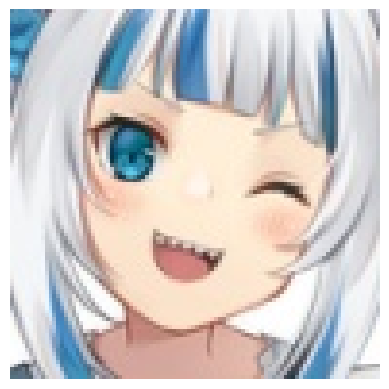

Label verdadera: Gawr Gura-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Gawr Gura-Hololive : 97.64 % confianza.
> Paimon-Genshin Impact : 0.64 % confianza.
> Aqua-Konosuba : 0.22 % confianza.
> Rem-Re Zero : 0.21 % confianza.
> Sinon-Sword Art Online : 0.16 % confianza.


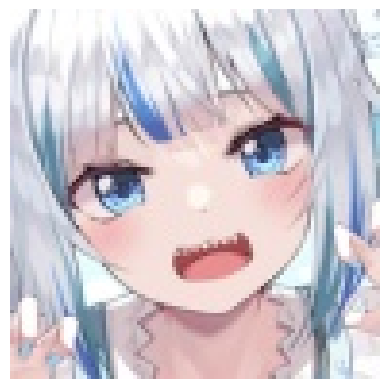

Label verdadera: Gawr Gura-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Gawr Gura-Hololive : 97.68 % confianza.
> Paimon-Genshin Impact : 0.49 % confianza.
> Rem-Re Zero : 0.38 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.18 % confianza.
> Cirno-Touhou : 0.13 % confianza.


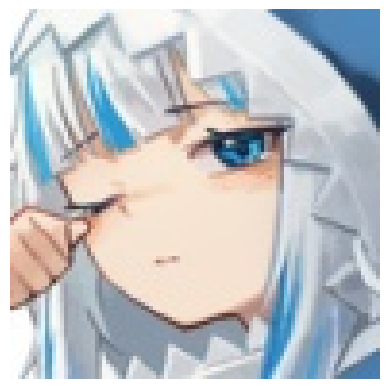

Label verdadera: Gawr Gura-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Gawr Gura-Hololive : 58.28 % confianza.
> Sinon-Sword Art Online : 7.77 % confianza.
> Rem-Re Zero : 6.97 % confianza.
> Aqua-Konosuba : 6.59 % confianza.
> Ouro Kronii-Hololive : 6.41 % confianza.


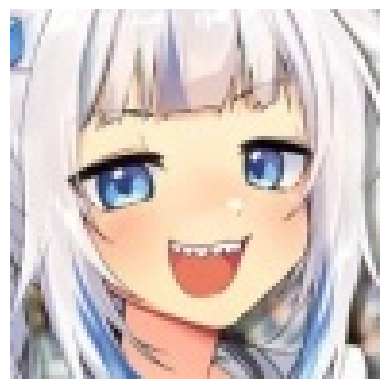

Label verdadera: Gawr Gura-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Gawr Gura-Hololive : 73.91 % confianza.
> Paimon-Genshin Impact : 21.21 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.62 % confianza.
> Aqua-Konosuba : 0.60 % confianza.
> Nico Robin-One Piece : 0.52 % confianza.


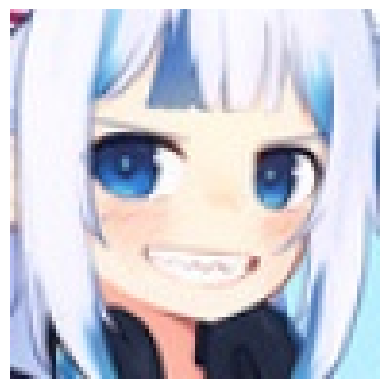

Label verdadera: Gawr Gura-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Paimon-Genshin Impact : 81.64 % confianza.
> Gawr Gura-Hololive : 10.32 % confianza.
> Aqua-Konosuba : 1.71 % confianza.
> Sinon-Sword Art Online : 0.80 % confianza.
> Nico Robin-One Piece : 0.77 % confianza.


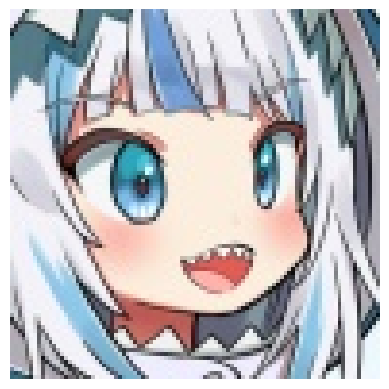

Label verdadera: Gawr Gura-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Gawr Gura-Hololive : 97.99 % confianza.
> Sinon-Sword Art Online : 0.30 % confianza.
> Rem-Re Zero : 0.25 % confianza.
> Paimon-Genshin Impact : 0.23 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 0.18 % confianza.


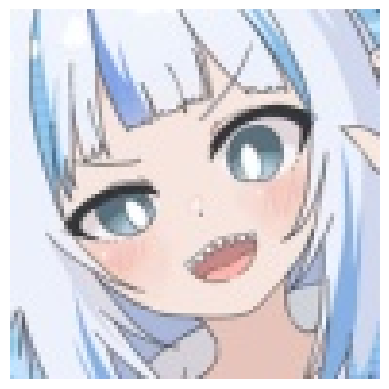

Label verdadera: Gawr Gura-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 22ms/step
> Gawr Gura-Hololive : 97.12 % confianza.
> Paimon-Genshin Impact : 1.29 % confianza.
> Aqua-Konosuba : 0.17 % confianza.
> Nico Robin-One Piece : 0.15 % confianza.
> Rem-Re Zero : 0.11 % confianza.


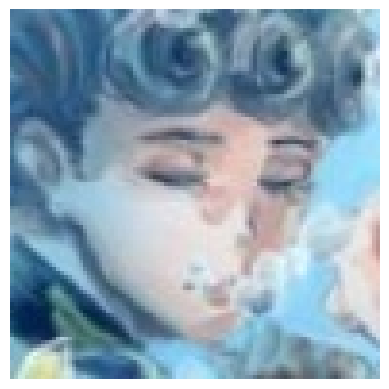

Label verdadera: Giorno Giovanna-JoJos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Gawr Gura-Hololive : 32.41 % confianza.
> Aqua-Konosuba : 23.29 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 10.12 % confianza.
> Rem-Re Zero : 6.37 % confianza.
> Sinon-Sword Art Online : 3.69 % confianza.


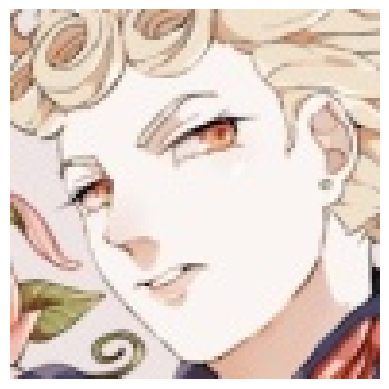

Label verdadera: Giorno Giovanna-JoJos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 35ms/step
> Giorno Giovanna-JoJos Bizarre Adventure : 57.65 % confianza.
> Gawr Gura-Hololive : 10.92 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 8.05 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 7.34 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 2.87 % confianza.


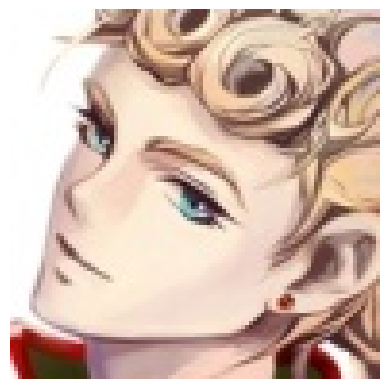

Label verdadera: Giorno Giovanna-JoJos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Giorno Giovanna-JoJos Bizarre Adventure : 98.03 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.41 % confianza.
> Nami-One Piece : 0.34 % confianza.
> Gawr Gura-Hololive : 0.20 % confianza.
> Nico Robin-One Piece : 0.15 % confianza.


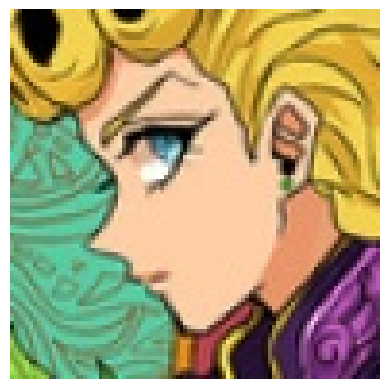

Label verdadera: Giorno Giovanna-JoJos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Giorno Giovanna-JoJos Bizarre Adventure : 38.97 % confianza.
> Aegis-Persona : 23.89 % confianza.
> Sinon-Sword Art Online : 14.54 % confianza.
> Nami-One Piece : 3.83 % confianza.
> Fubuki-One Punch Man : 1.75 % confianza.


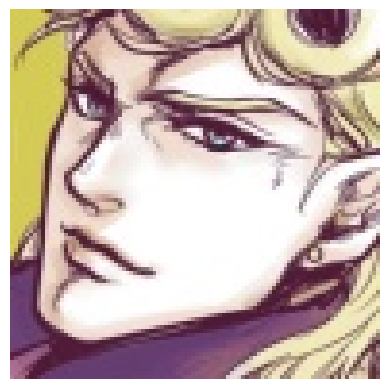

Label verdadera: Giorno Giovanna-JoJos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Giorno Giovanna-JoJos Bizarre Adventure : 59.35 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 14.99 % confianza.
> Nozomi Tojo-Love Live : 9.42 % confianza.
> Fubuki-One Punch Man : 3.80 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 2.49 % confianza.


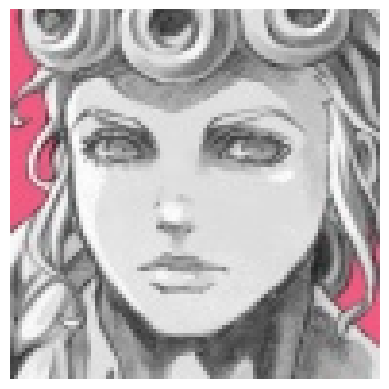

Label verdadera: Giorno Giovanna-JoJos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Giorno Giovanna-JoJos Bizarre Adventure : 60.47 % confianza.
> Fubuki-One Punch Man : 13.77 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 9.37 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 4.36 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 1.97 % confianza.


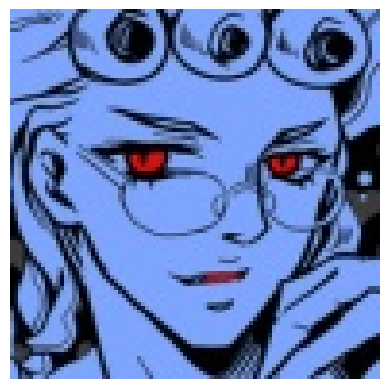

Label verdadera: Giorno Giovanna-JoJos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Scarlet Remilia-Touhou : 38.68 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 11.57 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 10.57 % confianza.
> Albedo-Overlord : 6.30 % confianza.
> Nami-One Piece : 4.91 % confianza.


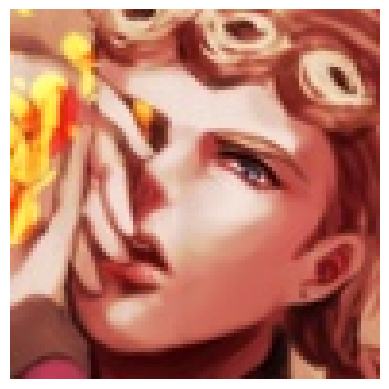

Label verdadera: Giorno Giovanna-JoJos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Nami-One Piece : 27.13 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 12.02 % confianza.
> Asuna Yuuki-Sword Art Online : 11.66 % confianza.
> Flandre Scarlet-Touhou : 10.14 % confianza.
> Raphtalia-Rising of the Shield Hero : 3.88 % confianza.


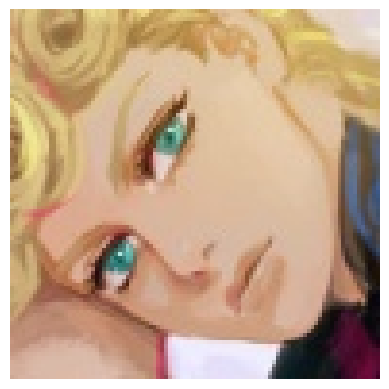

Label verdadera: Giorno Giovanna-JoJos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Giorno Giovanna-JoJos Bizarre Adventure : 57.14 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 23.87 % confianza.
> Zero Two-Darling In the Franxx : 5.32 % confianza.
> Nico Robin-One Piece : 2.56 % confianza.
> Nozomi Tojo-Love Live : 2.43 % confianza.


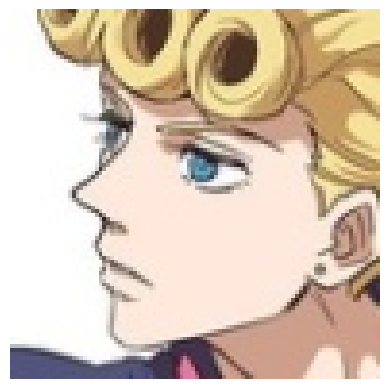

Label verdadera: Giorno Giovanna-JoJos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 22ms/step
> Aegis-Persona : 38.39 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 34.26 % confianza.
> Amelia Watson-Hololive : 6.81 % confianza.
> Nico Robin-One Piece : 4.55 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 2.95 % confianza.


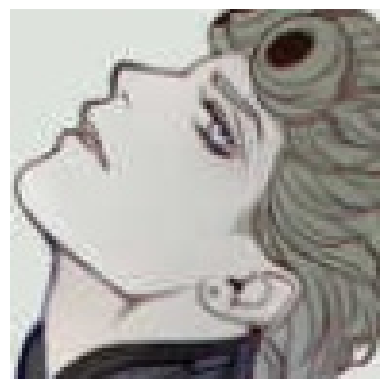

Label verdadera: Giorno Giovanna-JoJos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Fubuki-One Punch Man : 49.60 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 10.91 % confianza.
> Nico Robin-One Piece : 8.17 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 6.25 % confianza.
> Nezuko Kamado-Demon Slayer : 4.91 % confianza.


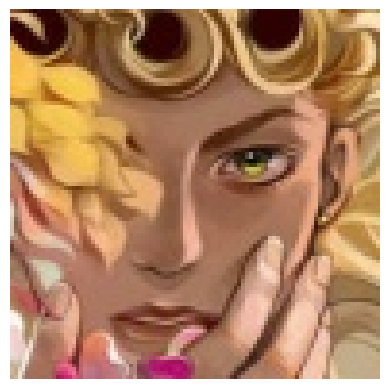

Label verdadera: Giorno Giovanna-JoJos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Giorno Giovanna-JoJos Bizarre Adventure : 99.49 % confianza.
> Raphtalia-Rising of the Shield Hero : 0.17 % confianza.
> Albedo-Overlord : 0.04 % confianza.
> Shirley Fenette-Code Geass : 0.04 % confianza.
> Astolfo-Fate : 0.04 % confianza.


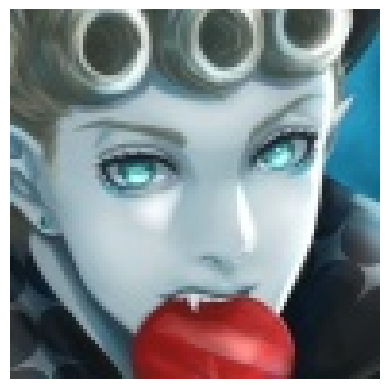

Label verdadera: Giorno Giovanna-JoJos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Sinon-Sword Art Online : 29.89 % confianza.
> Nico Robin-One Piece : 20.54 % confianza.
> Cirno-Touhou : 16.65 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 4.54 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 3.97 % confianza.


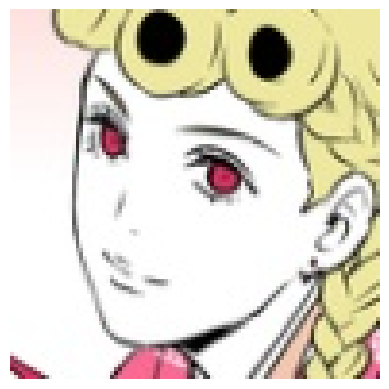

Label verdadera: Giorno Giovanna-JoJos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Giorno Giovanna-JoJos Bizarre Adventure : 87.94 % confianza.
> Nezuko Kamado-Demon Slayer : 4.52 % confianza.
> Gawr Gura-Hololive : 0.92 % confianza.
> Nami-One Piece : 0.63 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.58 % confianza.


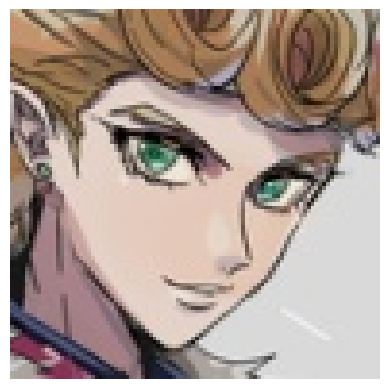

Label verdadera: Giorno Giovanna-JoJos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Giorno Giovanna-JoJos Bizarre Adventure : 84.88 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 6.21 % confianza.
> Zero Two-Darling In the Franxx : 4.25 % confianza.
> Nico Robin-One Piece : 1.08 % confianza.
> Nozomi Tojo-Love Live : 1.00 % confianza.


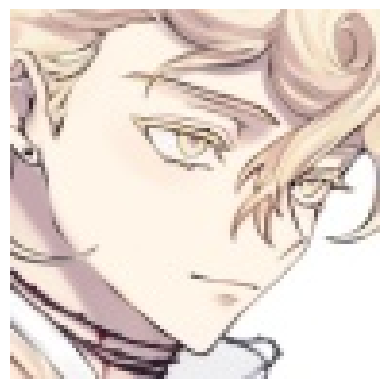

Label verdadera: Giorno Giovanna-JoJos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Jonathan Joestar-Jojos Bizarre Adventure : 25.76 % confianza.
> Fubuki-One Punch Man : 24.60 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 16.57 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 7.96 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 7.82 % confianza.


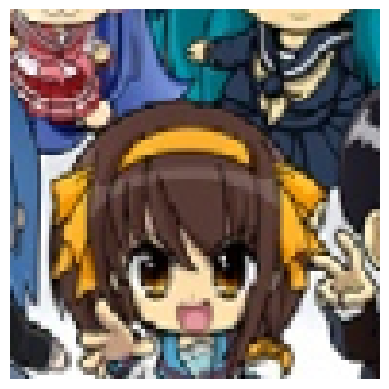

Label verdadera: Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 96.39 % confianza.
> Lelouch Lamperouge-Code Geass : 0.52 % confianza.
> Gawr Gura-Hololive : 0.22 % confianza.
> Nami-One Piece : 0.18 % confianza.
> Megumin-Konosuba : 0.16 % confianza.


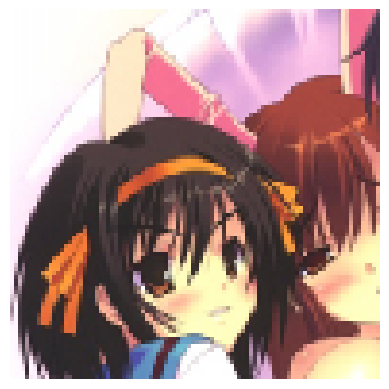

Label verdadera: Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya
Este personaje posiblemente es:
1/1 [==============================] - 0s 50ms/step
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 98.99 % confianza.
> Rin Tohsakaka-Fate : 0.11 % confianza.
> Lelouch Lamperouge-Code Geass : 0.08 % confianza.
> Gawr Gura-Hololive : 0.06 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.05 % confianza.


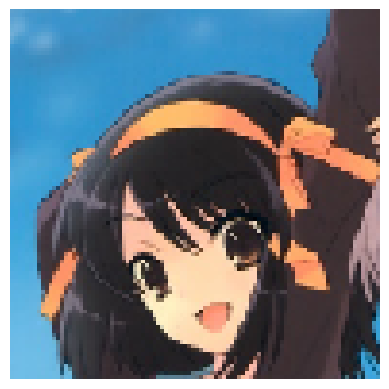

Label verdadera: Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 96.50 % confianza.
> Gawr Gura-Hololive : 0.30 % confianza.
> Megumin-Konosuba : 0.21 % confianza.
> Lelouch Lamperouge-Code Geass : 0.18 % confianza.
> Nami-One Piece : 0.16 % confianza.


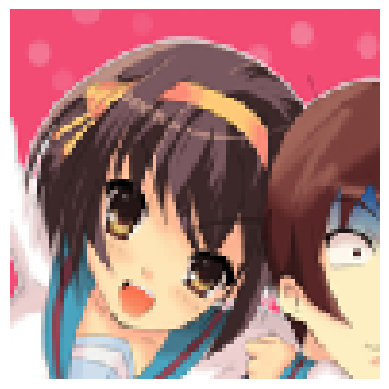

Label verdadera: Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 82.52 % confianza.
> Reimu Hakurei-Touhou : 4.25 % confianza.
> Gawr Gura-Hololive : 1.40 % confianza.
> Rin Tohsakaka-Fate : 1.32 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.68 % confianza.


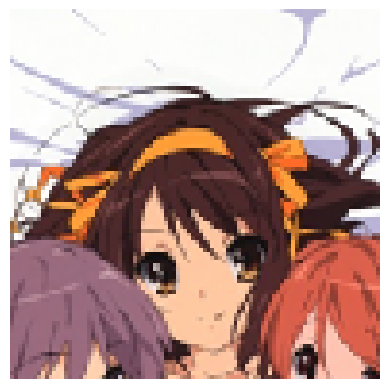

Label verdadera: Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 93.85 % confianza.
> Gawr Gura-Hololive : 0.60 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.33 % confianza.
> Nami-One Piece : 0.31 % confianza.
> Kallen Stadtfeld-Code Geass : 0.25 % confianza.


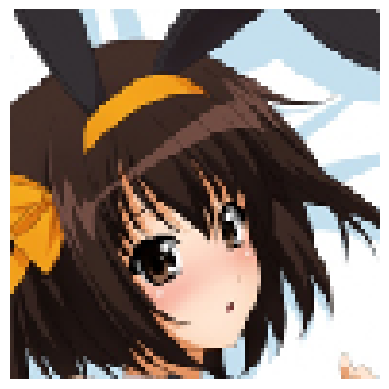

Label verdadera: Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 96.83 % confianza.
> Rin Tohsakaka-Fate : 0.27 % confianza.
> Gawr Gura-Hololive : 0.22 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.14 % confianza.
> Lelouch Lamperouge-Code Geass : 0.12 % confianza.


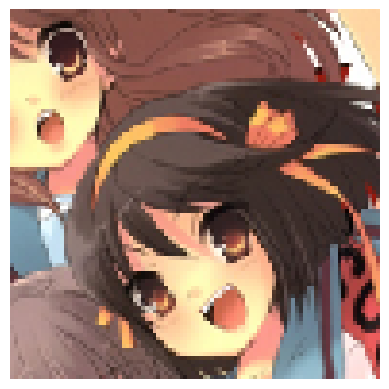

Label verdadera: Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya
Este personaje posiblemente es:
1/1 [==============================] - 0s 49ms/step
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 97.70 % confianza.
> Lelouch Lamperouge-Code Geass : 0.24 % confianza.
> Reimu Hakurei-Touhou : 0.22 % confianza.
> Gawr Gura-Hololive : 0.15 % confianza.
> Megumin-Konosuba : 0.12 % confianza.


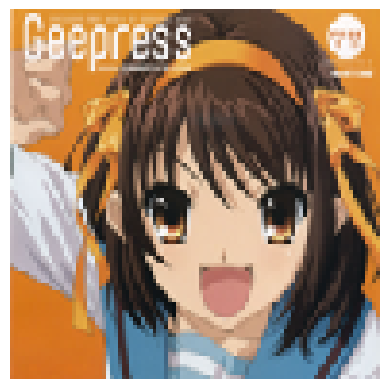

Label verdadera: Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya
Este personaje posiblemente es:
1/1 [==============================] - 0s 32ms/step
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 95.61 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.51 % confianza.
> Lelouch Lamperouge-Code Geass : 0.35 % confianza.
> Reimu Hakurei-Touhou : 0.35 % confianza.
> Nami-One Piece : 0.34 % confianza.


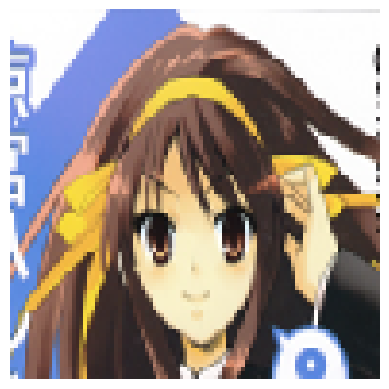

Label verdadera: Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 98.41 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.12 % confianza.
> Megumin-Konosuba : 0.11 % confianza.
> Ritsu Tainaka-K ON! : 0.07 % confianza.
> Gawr Gura-Hololive : 0.06 % confianza.


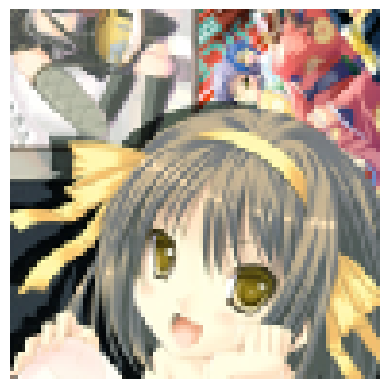

Label verdadera: Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 94.83 % confianza.
> Reimu Hakurei-Touhou : 1.02 % confianza.
> Rin Tohsakaka-Fate : 0.58 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 0.45 % confianza.
> Lelouch Lamperouge-Code Geass : 0.38 % confianza.


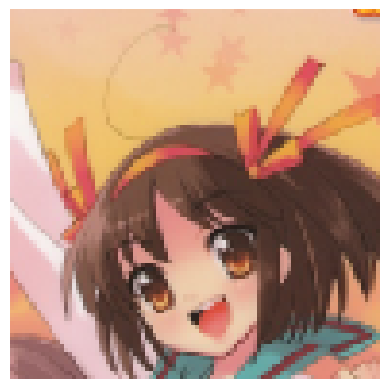

Label verdadera: Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 74.74 % confianza.
> Rin Tohsakaka-Fate : 11.81 % confianza.
> Reimu Hakurei-Touhou : 8.56 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 0.72 % confianza.
> Lelouch Lamperouge-Code Geass : 0.44 % confianza.


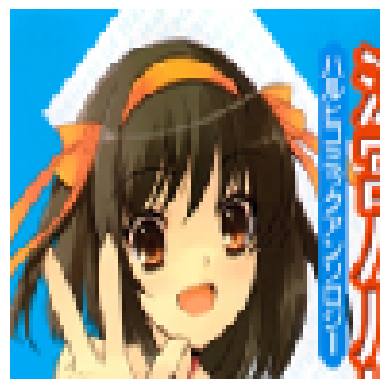

Label verdadera: Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 98.36 % confianza.
> Gawr Gura-Hololive : 0.14 % confianza.
> Reimu Hakurei-Touhou : 0.09 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.08 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 0.08 % confianza.


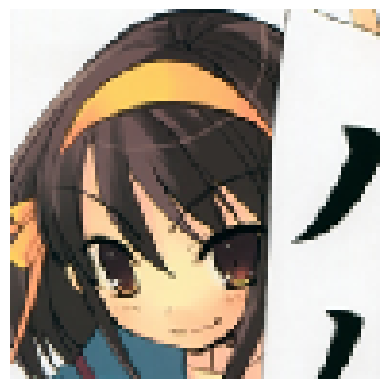

Label verdadera: Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 90.43 % confianza.
> Rin Tohsakaka-Fate : 2.01 % confianza.
> Gawr Gura-Hololive : 0.47 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.46 % confianza.
> Suzaku Kururugi-Code Geass : 0.31 % confianza.


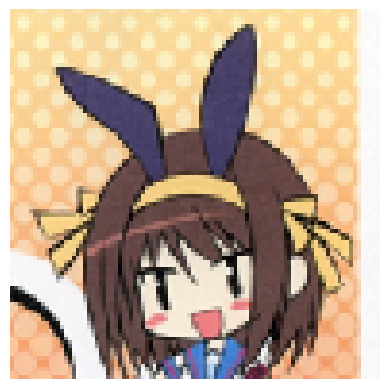

Label verdadera: Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya
Este personaje posiblemente es:
1/1 [==============================] - 0s 44ms/step
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 96.42 % confianza.
> Rin Tohsakaka-Fate : 0.77 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.23 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 0.21 % confianza.
> Lelouch Lamperouge-Code Geass : 0.17 % confianza.


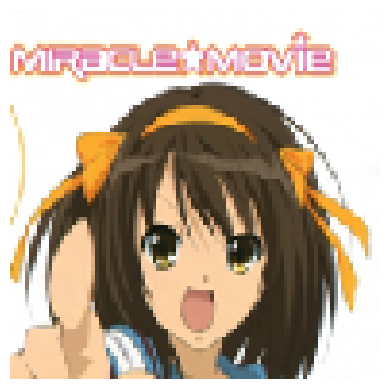

Label verdadera: Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya
Este personaje posiblemente es:
1/1 [==============================] - 0s 56ms/step
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 95.57 % confianza.
> Gawr Gura-Hololive : 0.46 % confianza.
> Kallen Stadtfeld-Code Geass : 0.30 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.18 % confianza.
> Rin Tohsakaka-Fate : 0.15 % confianza.


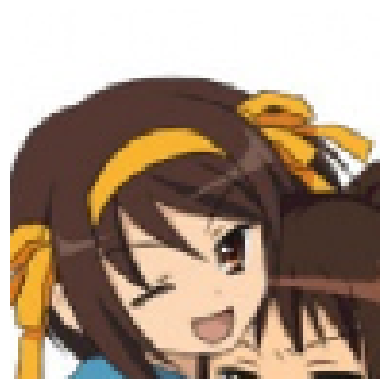

Label verdadera: Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 96.59 % confianza.
> Nami-One Piece : 0.19 % confianza.
> Nico Robin-One Piece : 0.18 % confianza.
> Kallen Stadtfeld-Code Geass : 0.18 % confianza.
> Megumin-Konosuba : 0.17 % confianza.


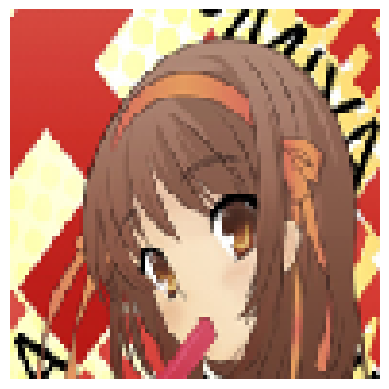

Label verdadera: Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Reimu Hakurei-Touhou : 36.30 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 14.20 % confianza.
> Aisaka Taiga-Toradora : 11.07 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 7.09 % confianza.
> Yui Hirasawa-K ON! : 5.14 % confianza.


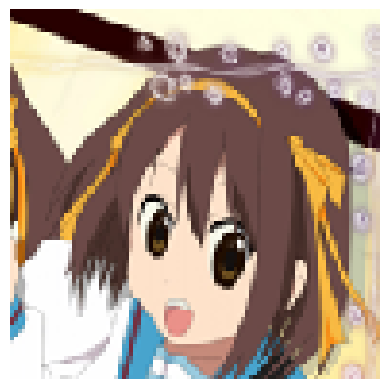

Label verdadera: Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 99.26 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 0.07 % confianza.
> Rin Tohsakaka-Fate : 0.07 % confianza.
> Gawr Gura-Hololive : 0.04 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.04 % confianza.


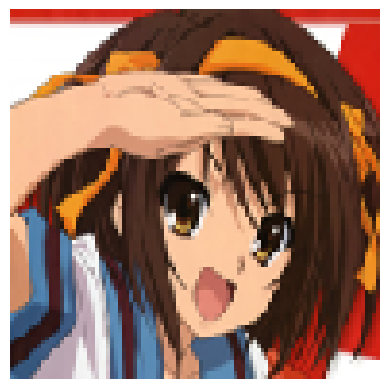

Label verdadera: Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 97.72 % confianza.
> Gawr Gura-Hololive : 0.23 % confianza.
> Reimu Hakurei-Touhou : 0.22 % confianza.
> Rin Tohsakaka-Fate : 0.12 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.12 % confianza.


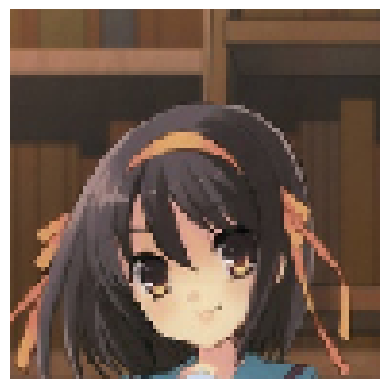

Label verdadera: Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 88.72 % confianza.
> Lelouch Lamperouge-Code Geass : 1.53 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.99 % confianza.
> Megumin-Konosuba : 0.82 % confianza.
> Reimu Hakurei-Touhou : 0.81 % confianza.


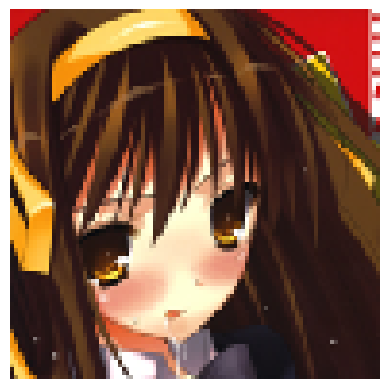

Label verdadera: Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 67.01 % confianza.
> Reimu Hakurei-Touhou : 7.99 % confianza.
> Megumin-Konosuba : 4.83 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 3.51 % confianza.
> Lelouch Lamperouge-Code Geass : 2.33 % confianza.


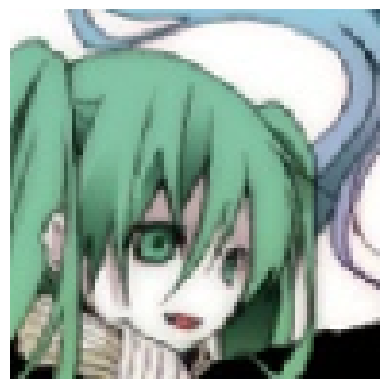

Label verdadera: Hatsune Miku-Vocaloid
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> C.C-Code Geass : 71.53 % confianza.
> Hatsune Miku-Vocaloid : 16.13 % confianza.
> Cirno-Touhou : 1.52 % confianza.
> Maka Albarn-Soul Eater : 1.38 % confianza.
> Sinon-Sword Art Online : 0.81 % confianza.


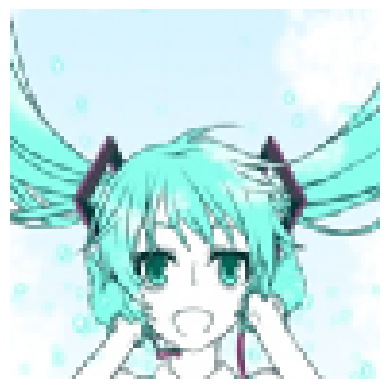

Label verdadera: Hatsune Miku-Vocaloid
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Hatsune Miku-Vocaloid : 91.70 % confianza.
> Cirno-Touhou : 4.93 % confianza.
> Sinon-Sword Art Online : 0.71 % confianza.
> C.C-Code Geass : 0.61 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.20 % confianza.


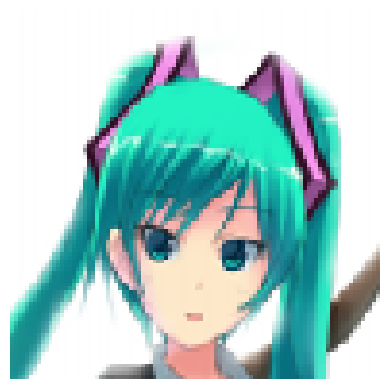

Label verdadera: Hatsune Miku-Vocaloid
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Hatsune Miku-Vocaloid : 99.21 % confianza.
> C.C-Code Geass : 0.14 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.11 % confianza.
> Cirno-Touhou : 0.08 % confianza.
> Rin Tohsakaka-Fate : 0.06 % confianza.


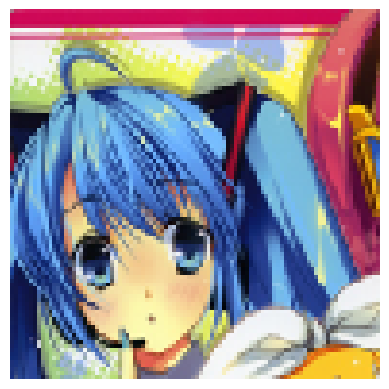

Label verdadera: Hatsune Miku-Vocaloid
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Sakuya Izayoi-Touhou : 84.26 % confianza.
> Cirno-Touhou : 6.59 % confianza.
> Sakura Matou-Fate : 1.70 % confianza.
> Scarlet Remilia-Touhou : 1.42 % confianza.
> Kagami Hiiragi-Lucky Star : 1.19 % confianza.


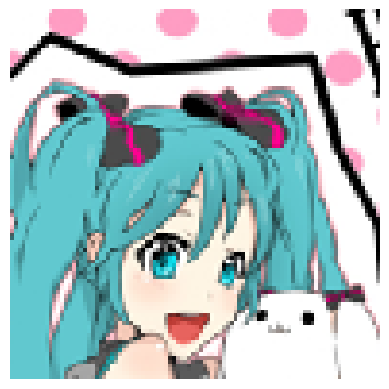

Label verdadera: Hatsune Miku-Vocaloid
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Hatsune Miku-Vocaloid : 97.50 % confianza.
> Cirno-Touhou : 0.89 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.20 % confianza.
> C.C-Code Geass : 0.13 % confianza.
> Rin Tohsakaka-Fate : 0.10 % confianza.


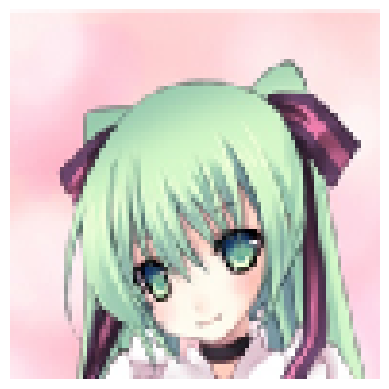

Label verdadera: Hatsune Miku-Vocaloid
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> C.C-Code Geass : 51.84 % confianza.
> Hatsune Miku-Vocaloid : 19.18 % confianza.
> Cirno-Touhou : 3.39 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 1.30 % confianza.
> Sakuya Izayoi-Touhou : 1.28 % confianza.


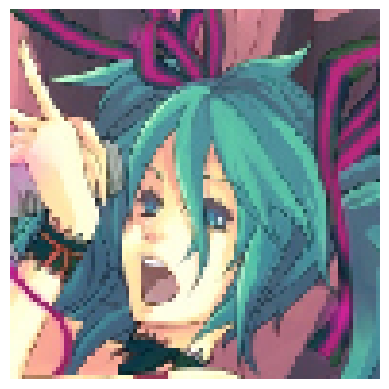

Label verdadera: Hatsune Miku-Vocaloid
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Hatsune Miku-Vocaloid : 97.88 % confianza.
> Cirno-Touhou : 0.64 % confianza.
> C.C-Code Geass : 0.47 % confianza.
> Rin Tohsakaka-Fate : 0.06 % confianza.
> Sakuya Izayoi-Touhou : 0.06 % confianza.


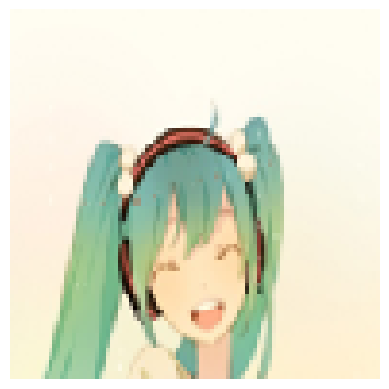

Label verdadera: Hatsune Miku-Vocaloid
Este personaje posiblemente es:
1/1 [==============================] - 0s 33ms/step
> Hatsune Miku-Vocaloid : 96.06 % confianza.
> C.C-Code Geass : 0.76 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.58 % confianza.
> Sinon-Sword Art Online : 0.55 % confianza.
> Cirno-Touhou : 0.44 % confianza.


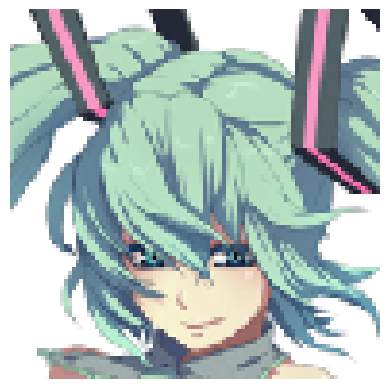

Label verdadera: Hatsune Miku-Vocaloid
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Cirno-Touhou : 27.33 % confianza.
> Hatsune Miku-Vocaloid : 21.65 % confianza.
> C.C-Code Geass : 15.42 % confianza.
> Sakuya Izayoi-Touhou : 2.90 % confianza.
> Maka Albarn-Soul Eater : 2.19 % confianza.


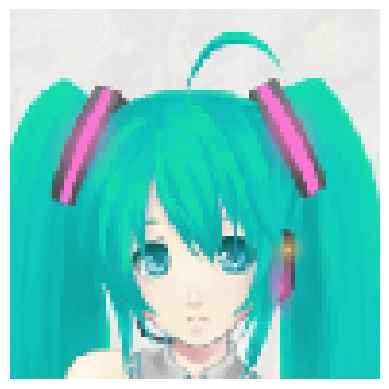

Label verdadera: Hatsune Miku-Vocaloid
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Hatsune Miku-Vocaloid : 98.73 % confianza.
> C.C-Code Geass : 0.15 % confianza.
> Nezuko Kamado-Demon Slayer : 0.14 % confianza.
> Hinata Hyuuga-Naruto : 0.14 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.13 % confianza.


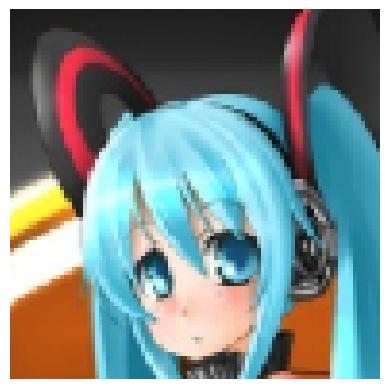

Label verdadera: Hatsune Miku-Vocaloid
Este personaje posiblemente es:
1/1 [==============================] - 0s 42ms/step
> Hatsune Miku-Vocaloid : 95.25 % confianza.
> Cirno-Touhou : 2.12 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.79 % confianza.
> C.C-Code Geass : 0.25 % confianza.
> Sakuya Izayoi-Touhou : 0.14 % confianza.


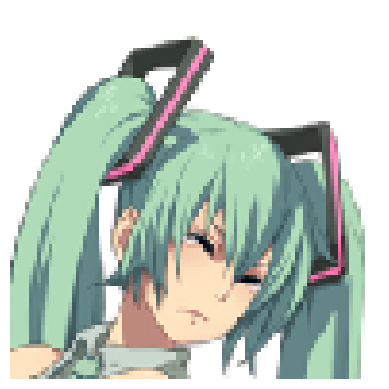

Label verdadera: Hatsune Miku-Vocaloid
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Hatsune Miku-Vocaloid : 71.26 % confianza.
> C.C-Code Geass : 12.19 % confianza.
> Cirno-Touhou : 3.42 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 1.37 % confianza.
> Sakuya Izayoi-Touhou : 0.76 % confianza.


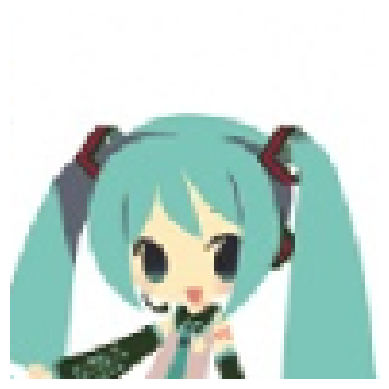

Label verdadera: Hatsune Miku-Vocaloid
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Hatsune Miku-Vocaloid : 97.64 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.66 % confianza.
> Cirno-Touhou : 0.51 % confianza.
> C.C-Code Geass : 0.28 % confianza.
> Nezuko Kamado-Demon Slayer : 0.06 % confianza.


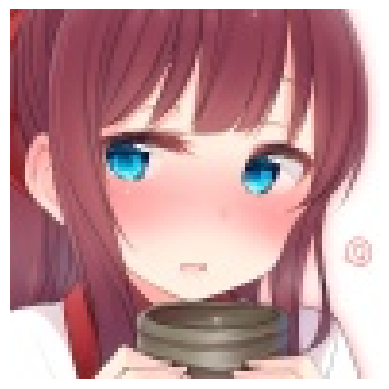

Label verdadera: Hifumi Takimoto-New Game!
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Hifumi Takimoto-New Game! : 88.57 % confianza.
> Kurisu Makise-Steins Gate : 1.09 % confianza.
> Kallen Stadtfeld-Code Geass : 0.98 % confianza.
> Rin Tohsakaka-Fate : 0.96 % confianza.
> Miku Nakano-Quintessential Quintuplets : 0.96 % confianza.


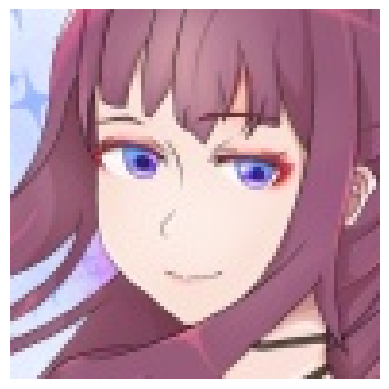

Label verdadera: Hifumi Takimoto-New Game!
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Hifumi Takimoto-New Game! : 72.88 % confianza.
> Nino Nakano-Quintessential Quintuplets : 11.42 % confianza.
> Shinobu Kochou-Demon Slayer : 1.56 % confianza.
> Sakura Matou-Fate : 1.42 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.94 % confianza.


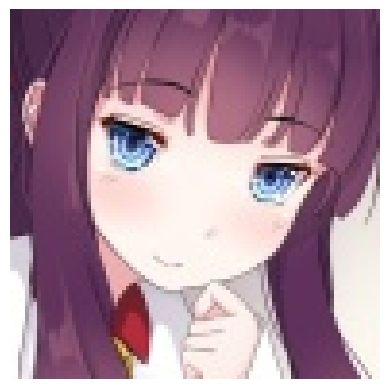

Label verdadera: Hifumi Takimoto-New Game!
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Hifumi Takimoto-New Game! : 94.26 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.79 % confianza.
> Ouro Kronii-Hololive : 0.51 % confianza.
> Nozomi Tojo-Love Live : 0.41 % confianza.
> Sakura Matou-Fate : 0.25 % confianza.


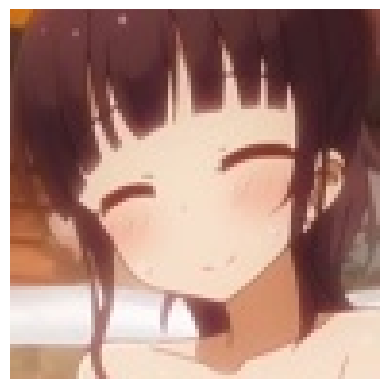

Label verdadera: Hifumi Takimoto-New Game!
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Shouko Komi-Komi Cant Communicate : 57.73 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 29.76 % confianza.
> Maki Nishikino-Love Live : 1.96 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 1.44 % confianza.
> Hinata Hyuuga-Naruto : 1.40 % confianza.


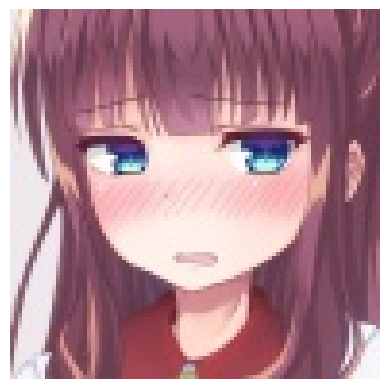

Label verdadera: Hifumi Takimoto-New Game!
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Hifumi Takimoto-New Game! : 91.45 % confianza.
> Ouro Kronii-Hololive : 1.29 % confianza.
> Kurisu Makise-Steins Gate : 0.86 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.85 % confianza.
> Megumin-Konosuba : 0.37 % confianza.


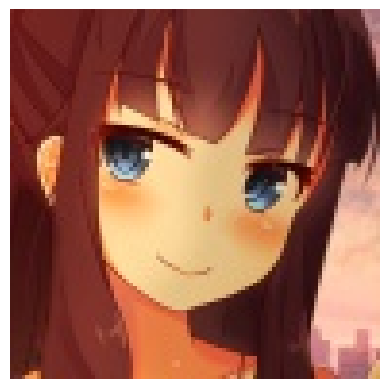

Label verdadera: Hifumi Takimoto-New Game!
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Hifumi Takimoto-New Game! : 77.85 % confianza.
> Kurisu Makise-Steins Gate : 3.13 % confianza.
> Fubuki-One Punch Man : 2.02 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 1.91 % confianza.
> Megumin-Konosuba : 1.71 % confianza.


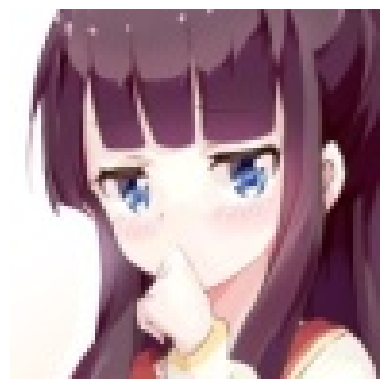

Label verdadera: Hifumi Takimoto-New Game!
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Hifumi Takimoto-New Game! : 96.89 % confianza.
> Rin Tohsakaka-Fate : 0.96 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.34 % confianza.
> Shouko Komi-Komi Cant Communicate : 0.20 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.16 % confianza.


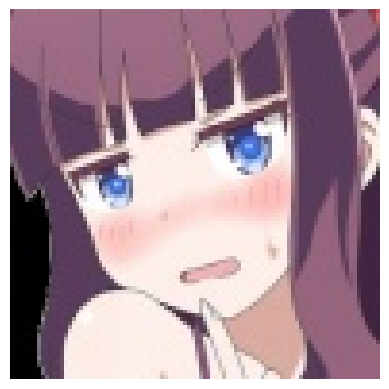

Label verdadera: Hifumi Takimoto-New Game!
Este personaje posiblemente es:
1/1 [==============================] - 0s 35ms/step
> Hifumi Takimoto-New Game! : 96.12 % confianza.
> Ouro Kronii-Hololive : 0.49 % confianza.
> Shouko Komi-Komi Cant Communicate : 0.48 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.36 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.16 % confianza.


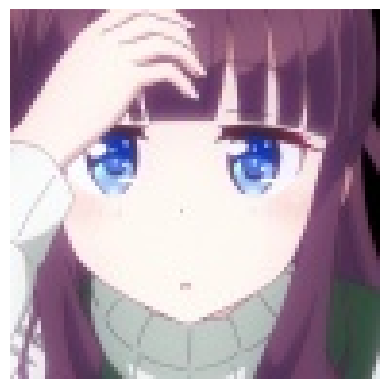

Label verdadera: Hifumi Takimoto-New Game!
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Hifumi Takimoto-New Game! : 95.87 % confianza.
> Shinobu Kochou-Demon Slayer : 1.92 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.63 % confianza.
> Nozomi Tojo-Love Live : 0.11 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 0.11 % confianza.


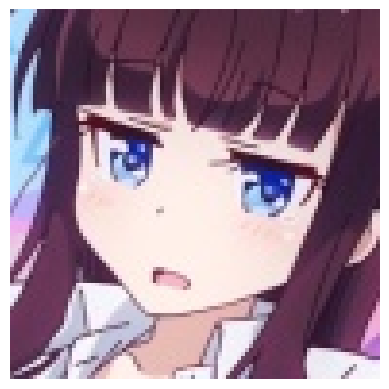

Label verdadera: Hifumi Takimoto-New Game!
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Hifumi Takimoto-New Game! : 94.14 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.80 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 0.42 % confianza.
> Shinobu Kochou-Demon Slayer : 0.28 % confianza.
> Shouko Komi-Komi Cant Communicate : 0.27 % confianza.


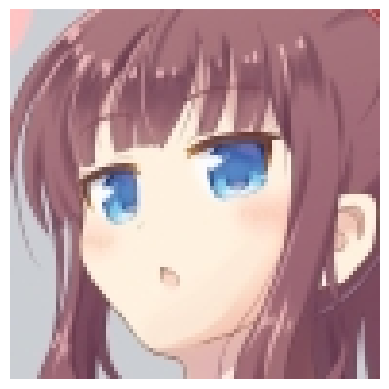

Label verdadera: Hifumi Takimoto-New Game!
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Hifumi Takimoto-New Game! : 96.61 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.94 % confianza.
> Rin Tohsakaka-Fate : 0.34 % confianza.
> Shouko Komi-Komi Cant Communicate : 0.13 % confianza.
> Reimu Hakurei-Touhou : 0.11 % confianza.


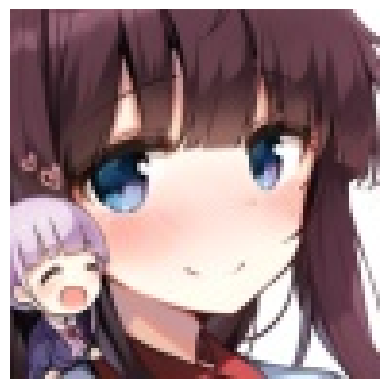

Label verdadera: Hifumi Takimoto-New Game!
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Hifumi Takimoto-New Game! : 45.20 % confianza.
> Shouko Komi-Komi Cant Communicate : 18.30 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 3.52 % confianza.
> Nino Nakano-Quintessential Quintuplets : 2.29 % confianza.
> Reimu Hakurei-Touhou : 2.07 % confianza.


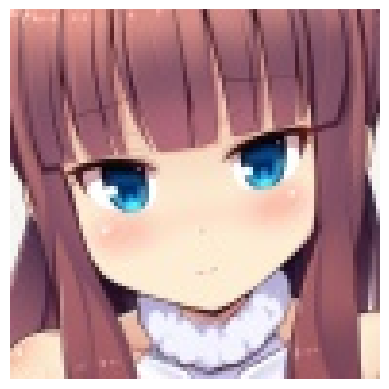

Label verdadera: Hifumi Takimoto-New Game!
Este personaje posiblemente es:
1/1 [==============================] - 0s 32ms/step
> Hifumi Takimoto-New Game! : 93.93 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.64 % confianza.
> Shouko Komi-Komi Cant Communicate : 0.29 % confianza.
> Rin Tohsakaka-Fate : 0.28 % confianza.
> Ouro Kronii-Hololive : 0.27 % confianza.


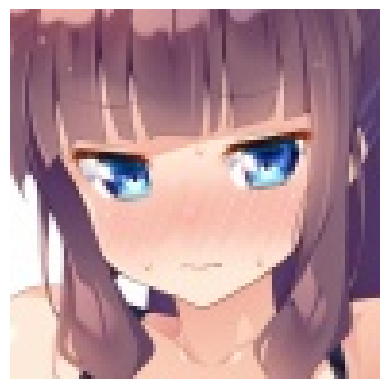

Label verdadera: Hifumi Takimoto-New Game!
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Hifumi Takimoto-New Game! : 92.79 % confianza.
> Ouro Kronii-Hololive : 1.35 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.56 % confianza.
> Rin Tohsakaka-Fate : 0.41 % confianza.
> Shouko Komi-Komi Cant Communicate : 0.40 % confianza.


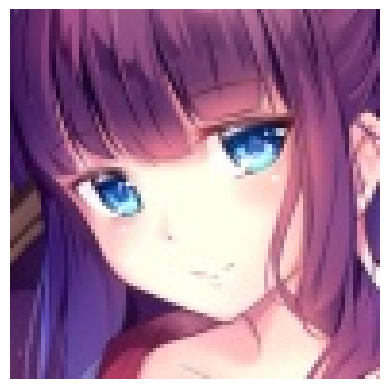

Label verdadera: Hifumi Takimoto-New Game!
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Hifumi Takimoto-New Game! : 88.44 % confianza.
> Nino Nakano-Quintessential Quintuplets : 3.38 % confianza.
> Nozomi Tojo-Love Live : 3.34 % confianza.
> Ouro Kronii-Hololive : 0.50 % confianza.
> Sakura Matou-Fate : 0.32 % confianza.


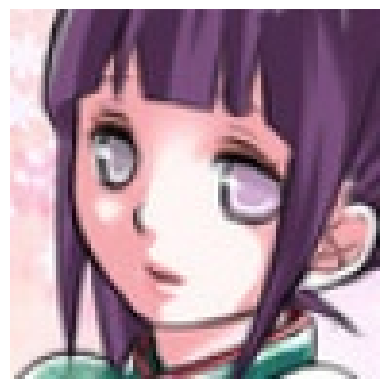

Label verdadera: Hinata Hyuuga-Naruto
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Hinata Hyuuga-Naruto : 27.69 % confianza.
> Nozomi Tojo-Love Live : 17.43 % confianza.
> Shinobu Kochou-Demon Slayer : 15.86 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 10.58 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 7.27 % confianza.


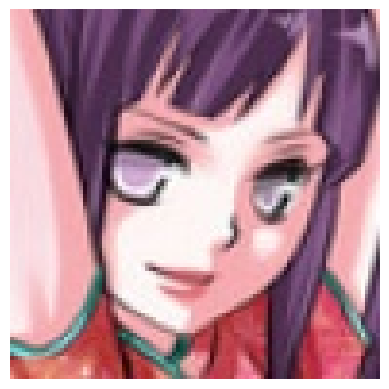

Label verdadera: Hinata Hyuuga-Naruto
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Shinobu Kochou-Demon Slayer : 14.38 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 12.29 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 9.99 % confianza.
> Nico Robin-One Piece : 6.82 % confianza.
> Nozomi Tojo-Love Live : 5.30 % confianza.


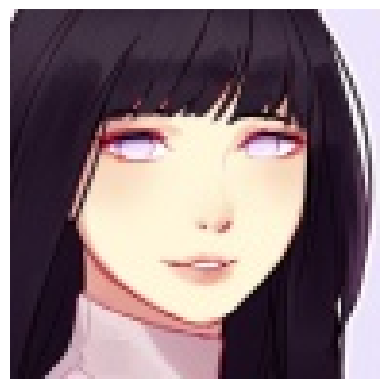

Label verdadera: Hinata Hyuuga-Naruto
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Nezuko Kamado-Demon Slayer : 39.75 % confianza.
> Hinata Hyuuga-Naruto : 25.33 % confianza.
> Fubuki-One Punch Man : 4.91 % confianza.
> Megumin-Konosuba : 3.28 % confianza.
> Shouko Komi-Komi Cant Communicate : 3.10 % confianza.


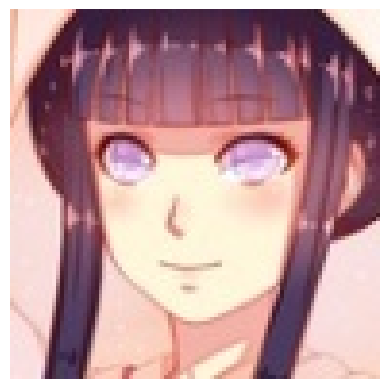

Label verdadera: Hinata Hyuuga-Naruto
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Hinata Hyuuga-Naruto : 43.83 % confianza.
> Shinobu Kochou-Demon Slayer : 8.96 % confianza.
> Hifumi Takimoto-New Game! : 7.78 % confianza.
> Maki Nishikino-Love Live : 7.01 % confianza.
> Nezuko Kamado-Demon Slayer : 4.63 % confianza.


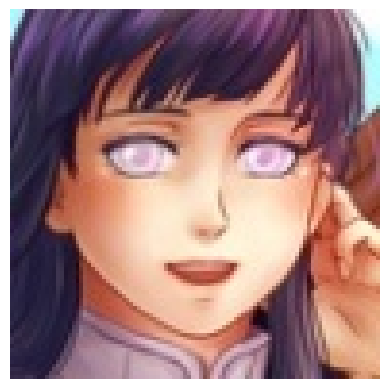

Label verdadera: Hinata Hyuuga-Naruto
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Hinata Hyuuga-Naruto : 89.99 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 1.89 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 1.13 % confianza.
> Nezuko Kamado-Demon Slayer : 1.02 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.75 % confianza.


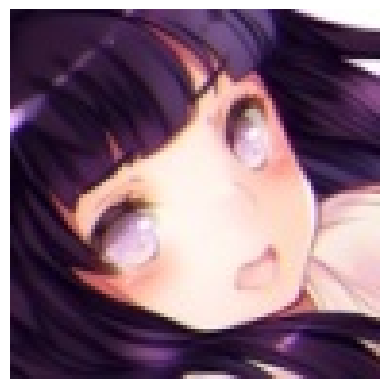

Label verdadera: Hinata Hyuuga-Naruto
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Hinata Hyuuga-Naruto : 86.99 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 2.72 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 1.35 % confianza.
> Fubuki-One Punch Man : 0.61 % confianza.
> Nezuko Kamado-Demon Slayer : 0.58 % confianza.


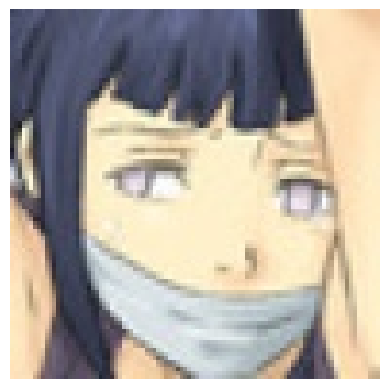

Label verdadera: Hinata Hyuuga-Naruto
Este personaje posiblemente es:
1/1 [==============================] - 0s 40ms/step
> Hinata Hyuuga-Naruto : 91.22 % confianza.
> Shinobu Kochou-Demon Slayer : 1.78 % confianza.
> Nezuko Kamado-Demon Slayer : 1.16 % confianza.
> Kirito-Sword Art Online : 0.86 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.61 % confianza.


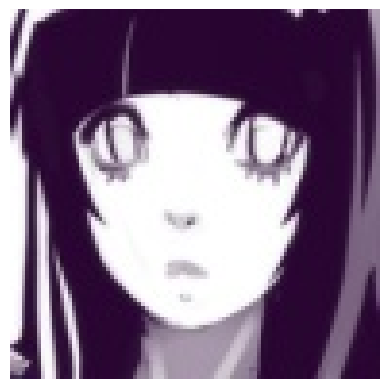

Label verdadera: Hinata Hyuuga-Naruto
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Hinata Hyuuga-Naruto : 40.22 % confianza.
> Shinobu Kochou-Demon Slayer : 29.97 % confianza.
> Maki Nishikino-Love Live : 6.04 % confianza.
> Hifumi Takimoto-New Game! : 2.72 % confianza.
> Kotobuki Tsumugi-K ON! : 2.05 % confianza.


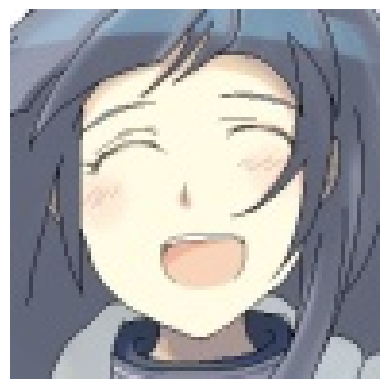

Label verdadera: Hinata Hyuuga-Naruto
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Hinata Hyuuga-Naruto : 94.17 % confianza.
> Nezuko Kamado-Demon Slayer : 1.08 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.60 % confianza.
> Nico Robin-One Piece : 0.59 % confianza.
> Albedo-Overlord : 0.27 % confianza.


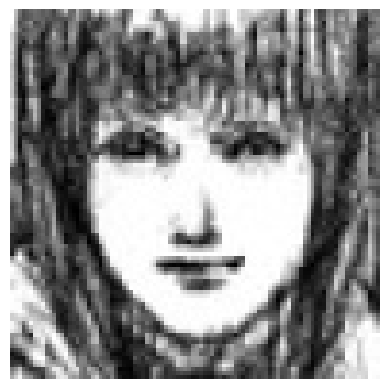

Label verdadera: Hinata Hyuuga-Naruto
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Fubuki-One Punch Man : 63.37 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 23.64 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 5.63 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 1.06 % confianza.
> Kallen Stadtfeld-Code Geass : 0.93 % confianza.


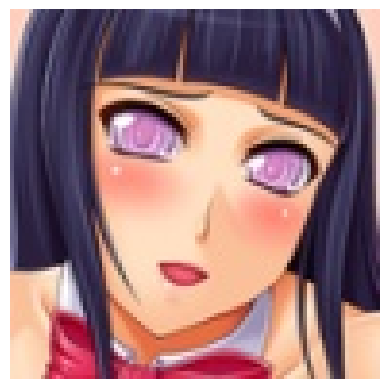

Label verdadera: Hinata Hyuuga-Naruto
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Hinata Hyuuga-Naruto : 67.70 % confianza.
> Nezuko Kamado-Demon Slayer : 13.81 % confianza.
> Shinobu Kochou-Demon Slayer : 3.81 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 1.49 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.98 % confianza.


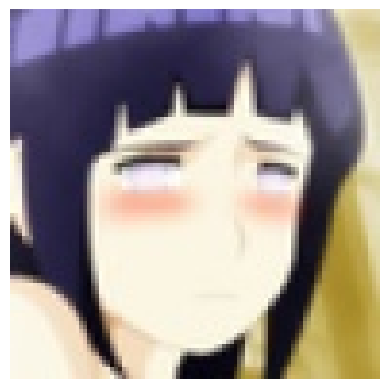

Label verdadera: Hinata Hyuuga-Naruto
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Hinata Hyuuga-Naruto : 63.94 % confianza.
> Shouko Komi-Komi Cant Communicate : 14.23 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 3.91 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 2.75 % confianza.
> Hifumi Takimoto-New Game! : 2.23 % confianza.


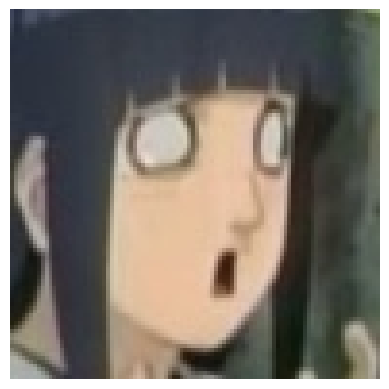

Label verdadera: Hinata Hyuuga-Naruto
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Hinata Hyuuga-Naruto : 97.81 % confianza.
> Nico Robin-One Piece : 0.61 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.38 % confianza.
> Albedo-Overlord : 0.28 % confianza.
> Kirito-Sword Art Online : 0.15 % confianza.


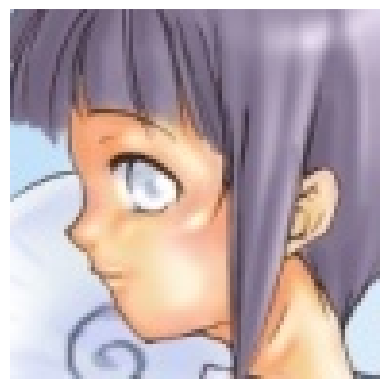

Label verdadera: Hinata Hyuuga-Naruto
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Aqua-Konosuba : 38.44 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 29.62 % confianza.
> Hinata Hyuuga-Naruto : 13.09 % confianza.
> Albedo-Overlord : 8.22 % confianza.
> Rem-Re Zero : 1.76 % confianza.


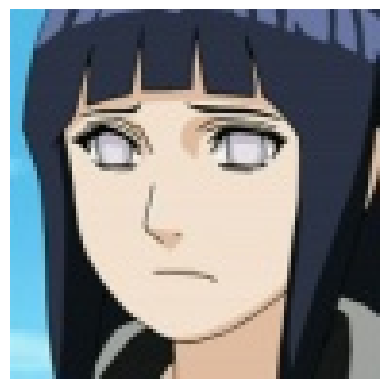

Label verdadera: Hinata Hyuuga-Naruto
Este personaje posiblemente es:
1/1 [==============================] - 0s 39ms/step
> Hinata Hyuuga-Naruto : 96.44 % confianza.
> Shinobu Kochou-Demon Slayer : 1.34 % confianza.
> Kirito-Sword Art Online : 0.43 % confianza.
> Nico Robin-One Piece : 0.29 % confianza.
> Nezuko Kamado-Demon Slayer : 0.27 % confianza.


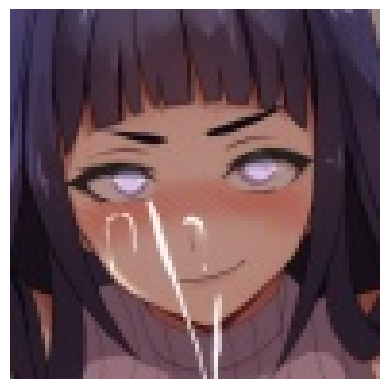

Label verdadera: Hinata Hyuuga-Naruto
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Hinata Hyuuga-Naruto : 77.60 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 7.21 % confianza.
> Shinobu Kochou-Demon Slayer : 2.81 % confianza.
> Fubuki-One Punch Man : 1.47 % confianza.
> Nezuko Kamado-Demon Slayer : 0.83 % confianza.


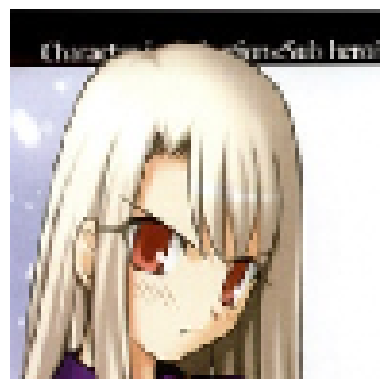

Label verdadera: Illyasviel Von Einzbern-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 48ms/step
> Illyasviel Von Einzbern-Fate : 99.10 % confianza.
> Arcueid Brunestud-Tsukihime : 0.23 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.20 % confianza.
> Ritsu Tainaka-K ON! : 0.06 % confianza.
> Flandre Scarlet-Touhou : 0.05 % confianza.


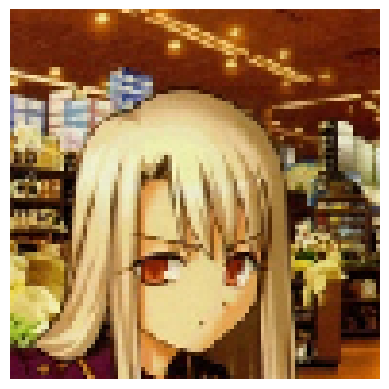

Label verdadera: Illyasviel Von Einzbern-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Saber-Fate : 36.82 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 11.99 % confianza.
> Flandre Scarlet-Touhou : 9.59 % confianza.
> Arcueid Brunestud-Tsukihime : 8.62 % confianza.
> Maka Albarn-Soul Eater : 2.82 % confianza.


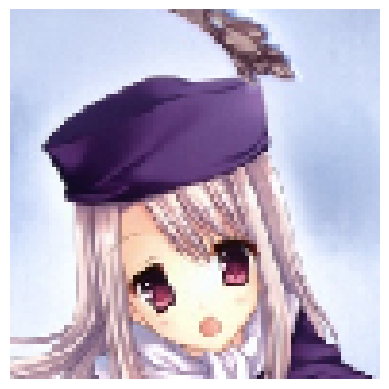

Label verdadera: Illyasviel Von Einzbern-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Illyasviel Von Einzbern-Fate : 93.77 % confianza.
> Arcueid Brunestud-Tsukihime : 2.24 % confianza.
> Flandre Scarlet-Touhou : 1.04 % confianza.
> Sakura Matou-Fate : 0.46 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.25 % confianza.


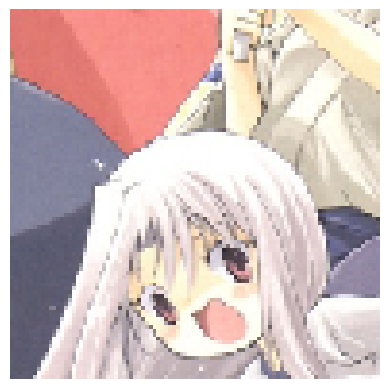

Label verdadera: Illyasviel Von Einzbern-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Illyasviel Von Einzbern-Fate : 92.54 % confianza.
> Cirno-Touhou : 2.01 % confianza.
> Sakuya Izayoi-Touhou : 2.01 % confianza.
> Arcueid Brunestud-Tsukihime : 0.87 % confianza.
> Scarlet Remilia-Touhou : 0.73 % confianza.


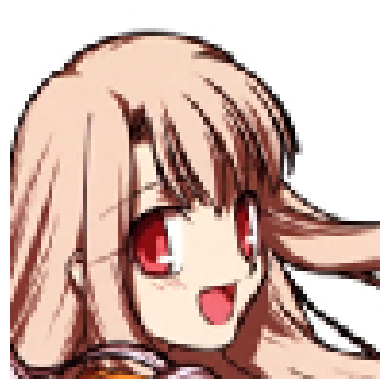

Label verdadera: Illyasviel Von Einzbern-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 22ms/step
> Illyasviel Von Einzbern-Fate : 89.78 % confianza.
> Arcueid Brunestud-Tsukihime : 6.11 % confianza.
> Flandre Scarlet-Touhou : 1.46 % confianza.
> Scarlet Remilia-Touhou : 0.38 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.24 % confianza.


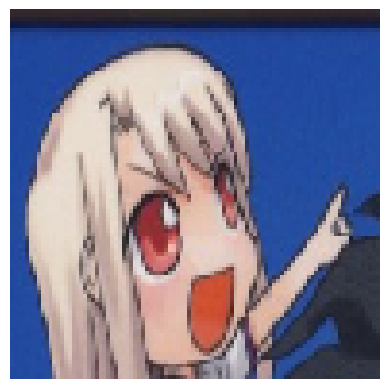

Label verdadera: Illyasviel Von Einzbern-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Illyasviel Von Einzbern-Fate : 97.32 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.39 % confianza.
> Cirno-Touhou : 0.30 % confianza.
> Sakuya Izayoi-Touhou : 0.26 % confianza.
> Arcueid Brunestud-Tsukihime : 0.25 % confianza.


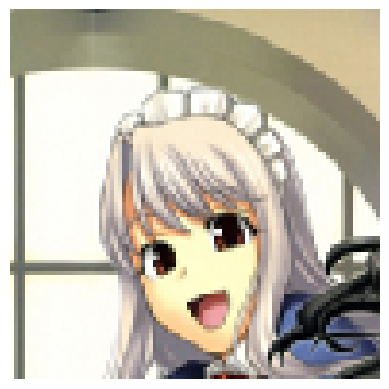

Label verdadera: Illyasviel Von Einzbern-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Illyasviel Von Einzbern-Fate : 83.17 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 6.44 % confianza.
> Sakuya Izayoi-Touhou : 3.77 % confianza.
> Cirno-Touhou : 1.40 % confianza.
> Scarlet Remilia-Touhou : 0.96 % confianza.


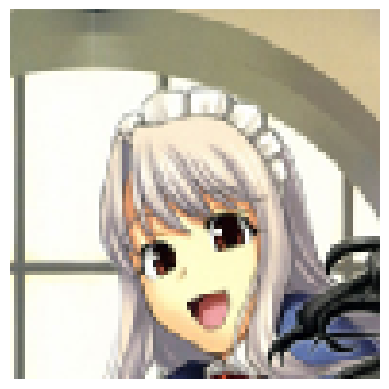

Label verdadera: Illyasviel Von Einzbern-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 22ms/step
> Illyasviel Von Einzbern-Fate : 81.13 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 6.97 % confianza.
> Sakuya Izayoi-Touhou : 4.51 % confianza.
> Cirno-Touhou : 1.57 % confianza.
> Scarlet Remilia-Touhou : 1.07 % confianza.


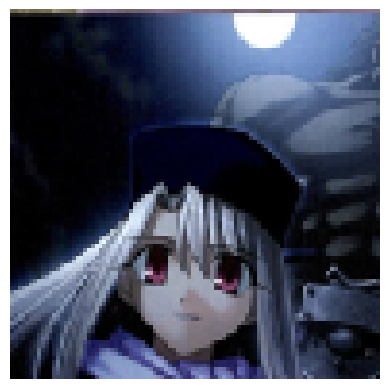

Label verdadera: Illyasviel Von Einzbern-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Illyasviel Von Einzbern-Fate : 57.62 % confianza.
> Scarlet Remilia-Touhou : 14.90 % confianza.
> Arcueid Brunestud-Tsukihime : 5.98 % confianza.
> Sakuya Izayoi-Touhou : 2.15 % confianza.
> Maka Albarn-Soul Eater : 1.14 % confianza.


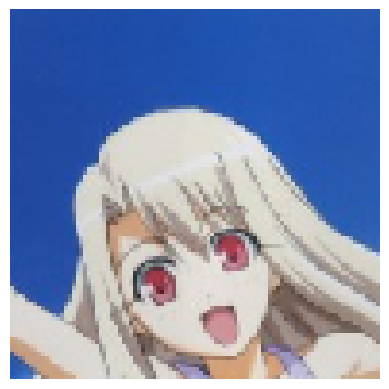

Label verdadera: Illyasviel Von Einzbern-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Illyasviel Von Einzbern-Fate : 98.90 % confianza.
> Arcueid Brunestud-Tsukihime : 0.39 % confianza.
> Nezuko Kamado-Demon Slayer : 0.11 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.07 % confianza.
> Sakuya Izayoi-Touhou : 0.06 % confianza.


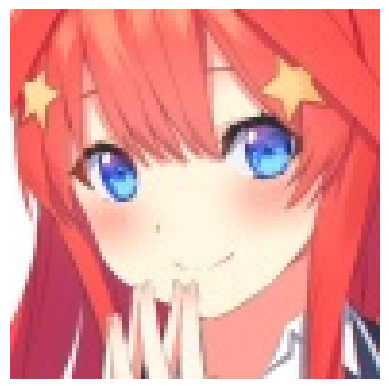

Label verdadera: Itsuki Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Itsuki Nakano-Quintessential Quintuplets : 98.83 % confianza.
> Maki Nishikino-Love Live : 0.25 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.25 % confianza.
> Yoko Littner-Gurrenn Lagann : 0.18 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 0.07 % confianza.


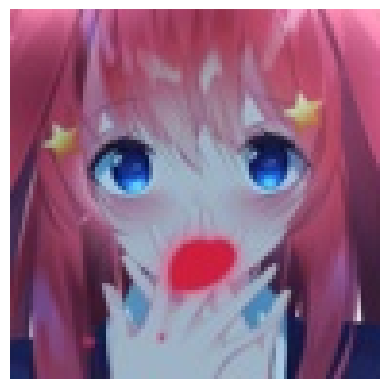

Label verdadera: Itsuki Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Itsuki Nakano-Quintessential Quintuplets : 78.07 % confianza.
> Nino Nakano-Quintessential Quintuplets : 9.88 % confianza.
> Miku Nakano-Quintessential Quintuplets : 2.52 % confianza.
> Rem-Re Zero : 1.51 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 1.09 % confianza.


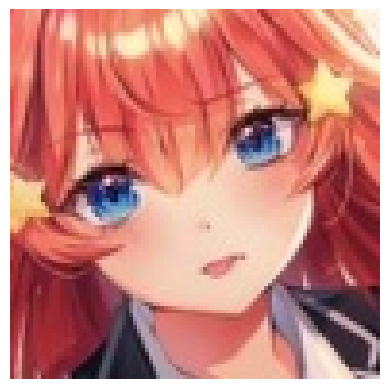

Label verdadera: Itsuki Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Itsuki Nakano-Quintessential Quintuplets : 98.89 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.41 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.19 % confianza.
> Yoko Littner-Gurrenn Lagann : 0.09 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 0.04 % confianza.


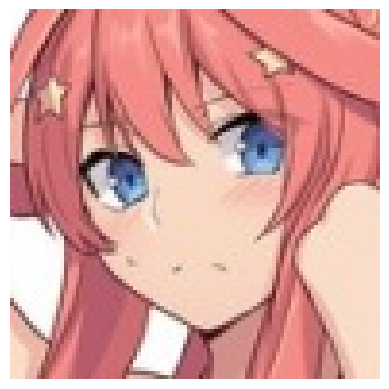

Label verdadera: Itsuki Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 22ms/step
> Itsuki Nakano-Quintessential Quintuplets : 51.08 % confianza.
> Nino Nakano-Quintessential Quintuplets : 26.83 % confianza.
> Miku Nakano-Quintessential Quintuplets : 8.68 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 1.59 % confianza.
> Hifumi Takimoto-New Game! : 1.05 % confianza.


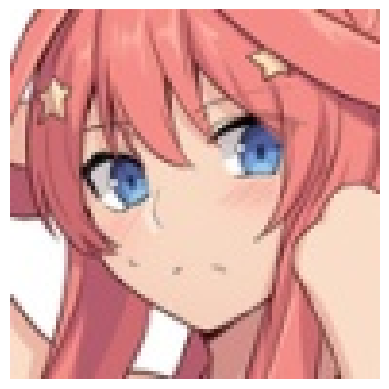

Label verdadera: Itsuki Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Nino Nakano-Quintessential Quintuplets : 38.28 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 33.14 % confianza.
> Miku Nakano-Quintessential Quintuplets : 12.57 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 2.09 % confianza.
> Arcueid Brunestud-Tsukihime : 1.02 % confianza.


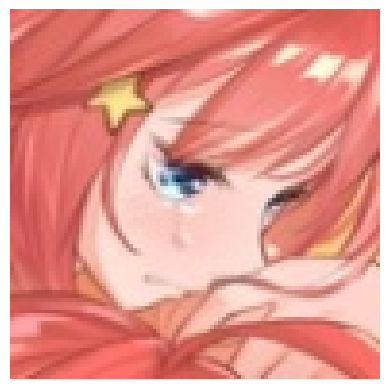

Label verdadera: Itsuki Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 34ms/step
> Nino Nakano-Quintessential Quintuplets : 64.35 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 15.41 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 2.38 % confianza.
> Sakuya Izayoi-Touhou : 2.15 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 1.55 % confianza.


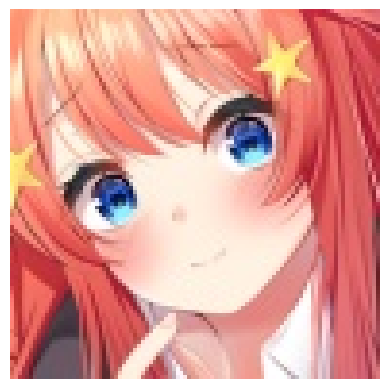

Label verdadera: Itsuki Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Itsuki Nakano-Quintessential Quintuplets : 61.87 % confianza.
> Nino Nakano-Quintessential Quintuplets : 28.09 % confianza.
> Maki Nishikino-Love Live : 1.59 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.86 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.86 % confianza.


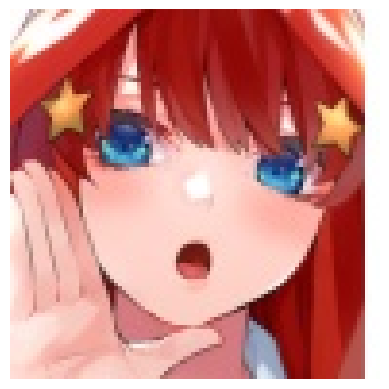

Label verdadera: Itsuki Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Itsuki Nakano-Quintessential Quintuplets : 86.48 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 2.64 % confianza.
> Nino Nakano-Quintessential Quintuplets : 2.29 % confianza.
> Hifumi Takimoto-New Game! : 2.10 % confianza.
> Yoko Littner-Gurrenn Lagann : 0.99 % confianza.


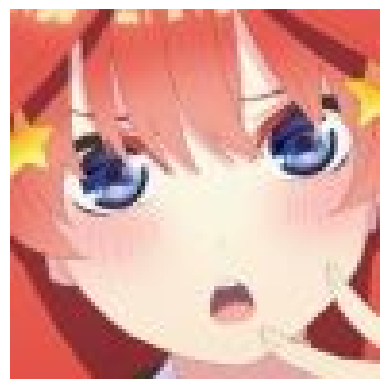

Label verdadera: Itsuki Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Itsuki Nakano-Quintessential Quintuplets : 99.65 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.08 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 0.03 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.03 % confianza.
> Hifumi Takimoto-New Game! : 0.03 % confianza.


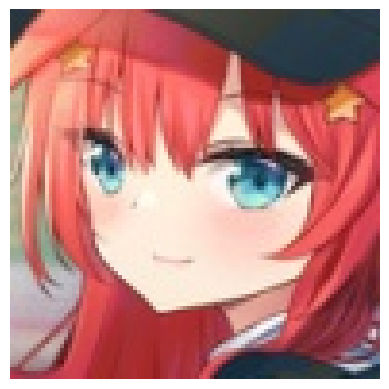

Label verdadera: Itsuki Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Itsuki Nakano-Quintessential Quintuplets : 57.37 % confianza.
> Nino Nakano-Quintessential Quintuplets : 21.45 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 4.13 % confianza.
> Hifumi Takimoto-New Game! : 3.27 % confianza.
> Yoko Littner-Gurrenn Lagann : 2.10 % confianza.


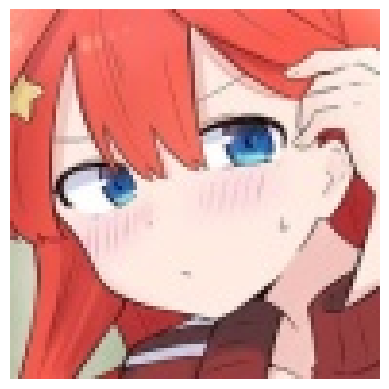

Label verdadera: Itsuki Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Itsuki Nakano-Quintessential Quintuplets : 90.73 % confianza.
> Nino Nakano-Quintessential Quintuplets : 2.02 % confianza.
> Hifumi Takimoto-New Game! : 1.63 % confianza.
> Yoko Littner-Gurrenn Lagann : 1.01 % confianza.
> Miku Nakano-Quintessential Quintuplets : 0.58 % confianza.


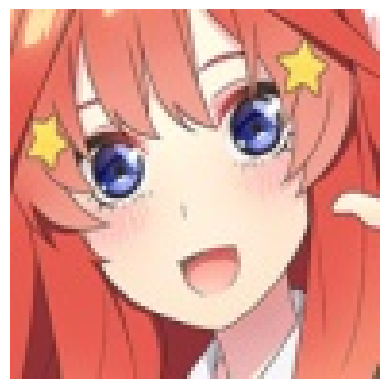

Label verdadera: Itsuki Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Itsuki Nakano-Quintessential Quintuplets : 95.39 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.90 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.54 % confianza.
> Maki Nishikino-Love Live : 0.46 % confianza.
> Nami-One Piece : 0.36 % confianza.


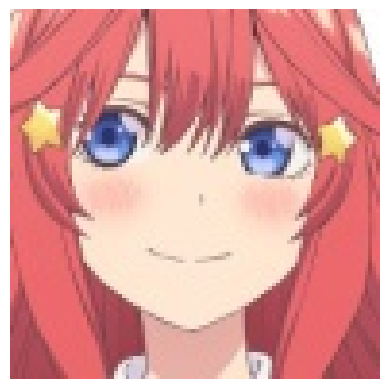

Label verdadera: Itsuki Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Itsuki Nakano-Quintessential Quintuplets : 98.81 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.30 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.16 % confianza.
> Hifumi Takimoto-New Game! : 0.10 % confianza.
> Maki Nishikino-Love Live : 0.09 % confianza.


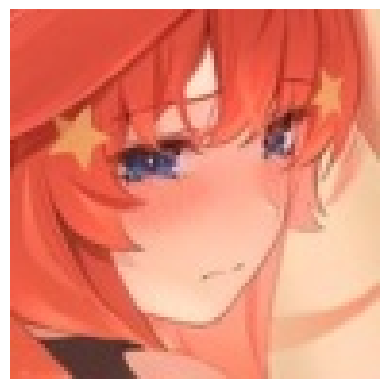

Label verdadera: Itsuki Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Itsuki Nakano-Quintessential Quintuplets : 92.88 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 2.81 % confianza.
> Nino Nakano-Quintessential Quintuplets : 2.59 % confianza.
> Yoko Littner-Gurrenn Lagann : 0.19 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.10 % confianza.


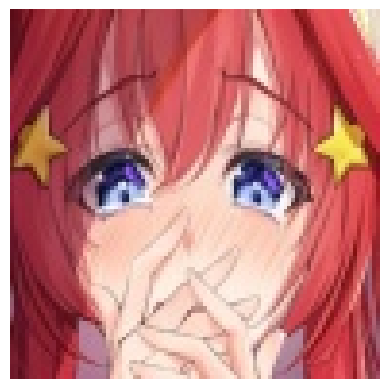

Label verdadera: Itsuki Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Itsuki Nakano-Quintessential Quintuplets : 87.29 % confianza.
> Maki Nishikino-Love Live : 2.82 % confianza.
> Nino Nakano-Quintessential Quintuplets : 2.02 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 1.39 % confianza.
> Miku Nakano-Quintessential Quintuplets : 0.46 % confianza.


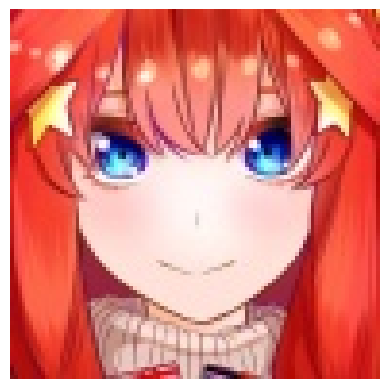

Label verdadera: Itsuki Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Itsuki Nakano-Quintessential Quintuplets : 99.26 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.20 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.15 % confianza.
> Yoko Littner-Gurrenn Lagann : 0.07 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 0.06 % confianza.


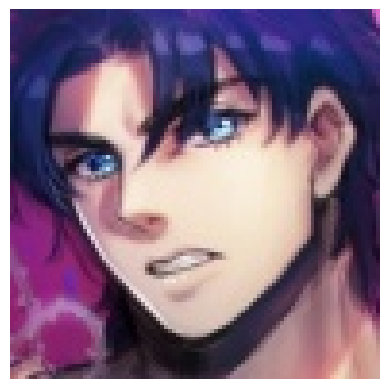

Label verdadera: Jonathan Joestar-Jojos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 22ms/step
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 49.45 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 9.56 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 6.06 % confianza.
> Sakura Matou-Fate : 6.00 % confianza.
> Hinata Hyuuga-Naruto : 5.76 % confianza.


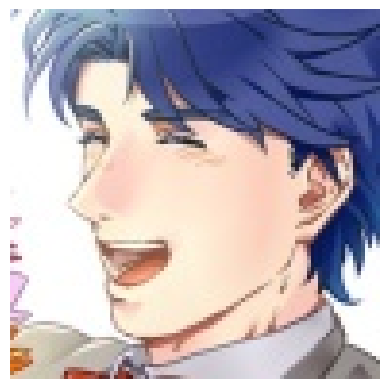

Label verdadera: Jonathan Joestar-Jojos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Misato Katsuragi-Neon Genesis Evangelion : 74.02 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 19.11 % confianza.
> Nozomi Tojo-Love Live : 0.91 % confianza.
> Hinata Hyuuga-Naruto : 0.90 % confianza.
> Ouro Kronii-Hololive : 0.63 % confianza.


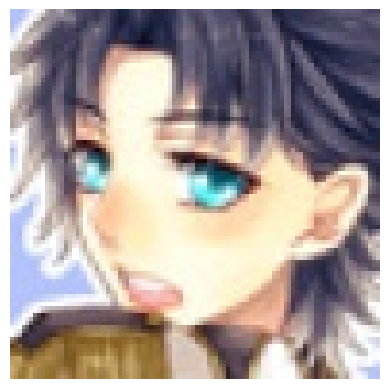

Label verdadera: Jonathan Joestar-Jojos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 40ms/step
> Jonathan Joestar-Jojos Bizarre Adventure : 42.65 % confianza.
> Ouro Kronii-Hololive : 26.80 % confianza.
> Nozomi Tojo-Love Live : 8.14 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 4.41 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 3.64 % confianza.


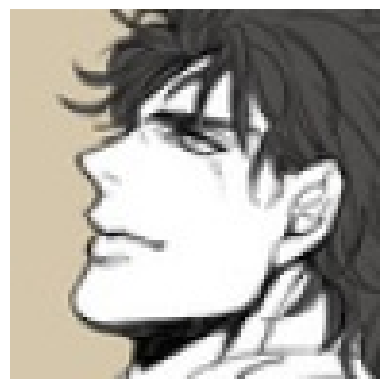

Label verdadera: Jonathan Joestar-Jojos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Shouko Komi-Komi Cant Communicate : 42.04 % confianza.
> Fubuki-One Punch Man : 22.56 % confianza.
> Kirito-Sword Art Online : 3.10 % confianza.
> Nezuko Kamado-Demon Slayer : 2.37 % confianza.
> Hifumi Takimoto-New Game! : 2.09 % confianza.


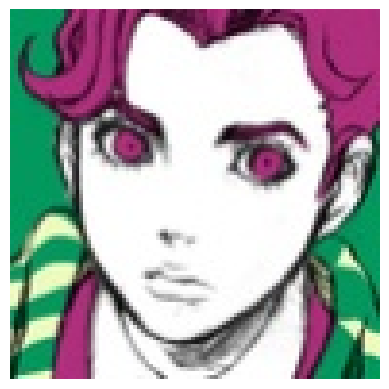

Label verdadera: Jonathan Joestar-Jojos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Nezuko Kamado-Demon Slayer : 85.19 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 6.44 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 1.05 % confianza.
> Sinon-Sword Art Online : 0.86 % confianza.
> C.C-Code Geass : 0.58 % confianza.


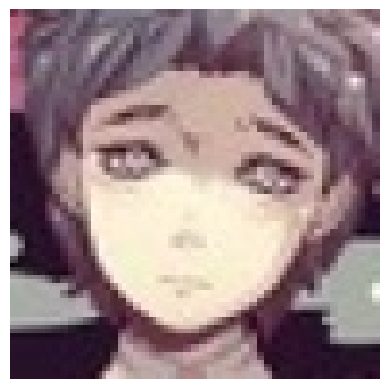

Label verdadera: Jonathan Joestar-Jojos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 32ms/step
> Shinobu Kochou-Demon Slayer : 24.50 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 23.76 % confianza.
> Hinata Hyuuga-Naruto : 13.16 % confianza.
> Nico Robin-One Piece : 8.60 % confianza.
> Maki Nishikino-Love Live : 5.63 % confianza.


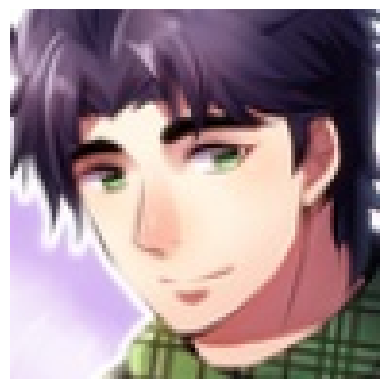

Label verdadera: Jonathan Joestar-Jojos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Jonathan Joestar-Jojos Bizarre Adventure : 44.33 % confianza.
> Nozomi Tojo-Love Live : 22.54 % confianza.
> Fubuki-One Punch Man : 14.01 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 9.62 % confianza.
> Megumin-Konosuba : 0.84 % confianza.


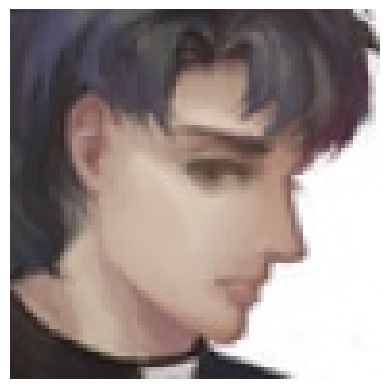

Label verdadera: Jonathan Joestar-Jojos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Kirito-Sword Art Online : 34.55 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 18.05 % confianza.
> Nico Robin-One Piece : 10.57 % confianza.
> Shouko Komi-Komi Cant Communicate : 8.56 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 5.66 % confianza.


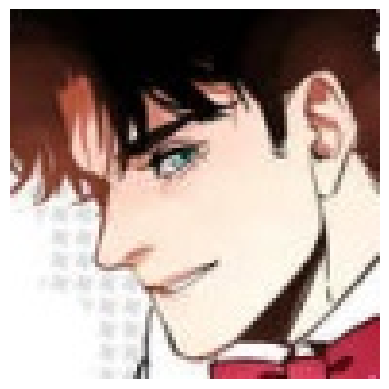

Label verdadera: Jonathan Joestar-Jojos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Jonathan Joestar-Jojos Bizarre Adventure : 87.18 % confianza.
> Fubuki-One Punch Man : 8.13 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 1.99 % confianza.
> Nico Robin-One Piece : 0.37 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 0.30 % confianza.


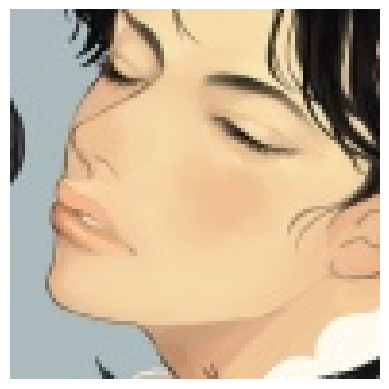

Label verdadera: Jonathan Joestar-Jojos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Jonathan Joestar-Jojos Bizarre Adventure : 78.88 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 7.39 % confianza.
> Nico Robin-One Piece : 4.82 % confianza.
> Saber-Fate : 3.14 % confianza.
> Hinata Hyuuga-Naruto : 1.00 % confianza.


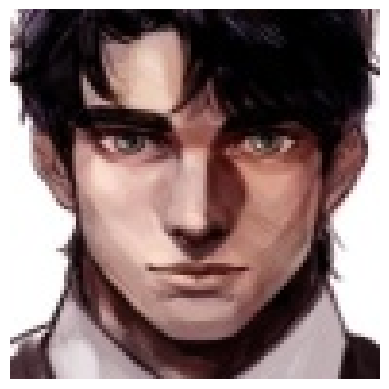

Label verdadera: Jonathan Joestar-Jojos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Jonathan Joestar-Jojos Bizarre Adventure : 21.06 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 15.94 % confianza.
> Albedo-Overlord : 15.16 % confianza.
> Nico Robin-One Piece : 8.36 % confianza.
> Kirito-Sword Art Online : 8.32 % confianza.


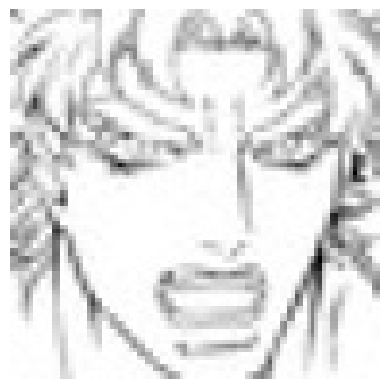

Label verdadera: Jonathan Joestar-Jojos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Fubuki-One Punch Man : 71.61 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 7.97 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 7.96 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 3.69 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 2.18 % confianza.


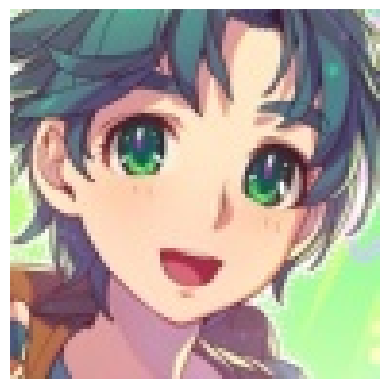

Label verdadera: Jonathan Joestar-Jojos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Sinon-Sword Art Online : 47.41 % confianza.
> Nozomi Tojo-Love Live : 13.87 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 5.45 % confianza.
> C.C-Code Geass : 3.32 % confianza.
> Aqua-Konosuba : 3.28 % confianza.


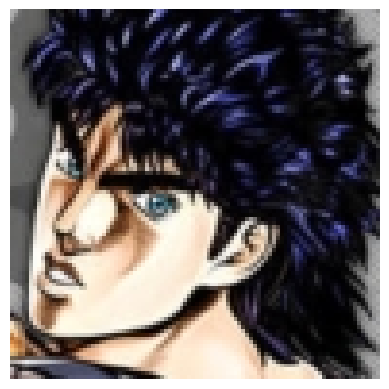

Label verdadera: Jonathan Joestar-Jojos Bizarre Adventure
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Jonathan Joestar-Jojos Bizarre Adventure : 39.28 % confianza.
> Ouro Kronii-Hololive : 19.95 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 10.00 % confianza.
> Fubuki-One Punch Man : 4.67 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 2.73 % confianza.


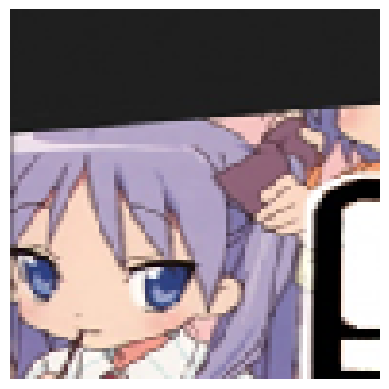

Label verdadera: Kagami Hiiragi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Kagami Hiiragi-Lucky Star : 93.58 % confianza.
> Sakuya Izayoi-Touhou : 3.34 % confianza.
> Kotobuki Tsumugi-K ON! : 0.33 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.29 % confianza.
> Scarlet Remilia-Touhou : 0.21 % confianza.


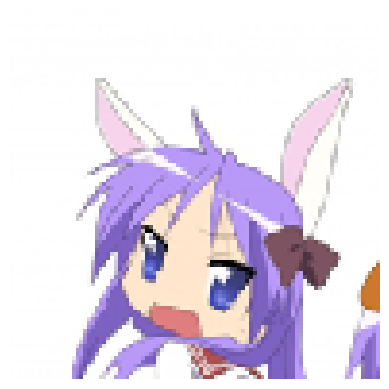

Label verdadera: Kagami Hiiragi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Kagami Hiiragi-Lucky Star : 98.39 % confianza.
> Scarlet Remilia-Touhou : 0.14 % confianza.
> Sakura Matou-Fate : 0.11 % confianza.
> Konata Izumi-Lucky Star : 0.10 % confianza.
> Sakuya Izayoi-Touhou : 0.08 % confianza.


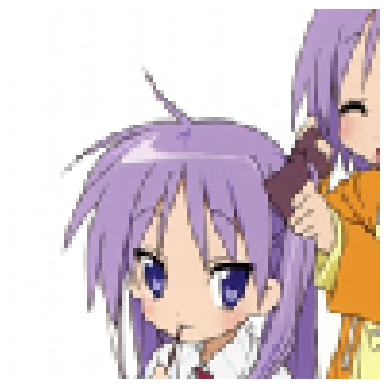

Label verdadera: Kagami Hiiragi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Kagami Hiiragi-Lucky Star : 96.00 % confianza.
> Sakuya Izayoi-Touhou : 0.33 % confianza.
> Kotobuki Tsumugi-K ON! : 0.27 % confianza.
> Sakura Matou-Fate : 0.26 % confianza.
> Astolfo-Fate : 0.25 % confianza.


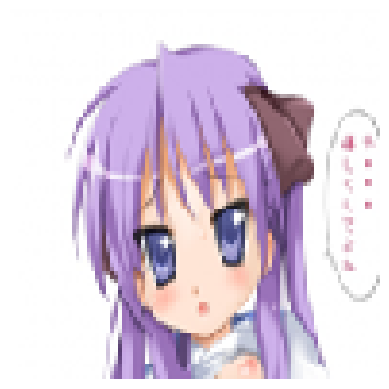

Label verdadera: Kagami Hiiragi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Kagami Hiiragi-Lucky Star : 96.98 % confianza.
> Sakuya Izayoi-Touhou : 0.29 % confianza.
> Sakura Matou-Fate : 0.23 % confianza.
> Kotobuki Tsumugi-K ON! : 0.17 % confianza.
> Raphtalia-Rising of the Shield Hero : 0.14 % confianza.


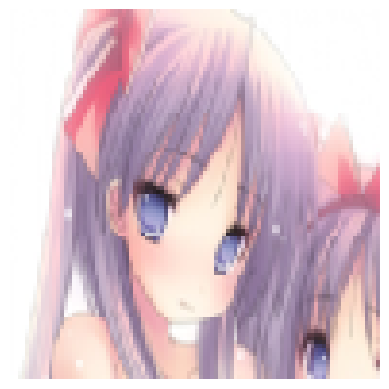

Label verdadera: Kagami Hiiragi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 32ms/step
> Sakuya Izayoi-Touhou : 56.15 % confianza.
> Kagami Hiiragi-Lucky Star : 27.75 % confianza.
> Rin Tohsakaka-Fate : 1.96 % confianza.
> Scarlet Remilia-Touhou : 1.28 % confianza.
> Sakura Matou-Fate : 1.13 % confianza.


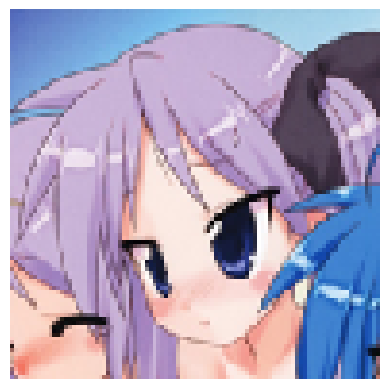

Label verdadera: Kagami Hiiragi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Kagami Hiiragi-Lucky Star : 98.17 % confianza.
> Sakuya Izayoi-Touhou : 0.87 % confianza.
> Cirno-Touhou : 0.16 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.06 % confianza.
> Scarlet Remilia-Touhou : 0.06 % confianza.


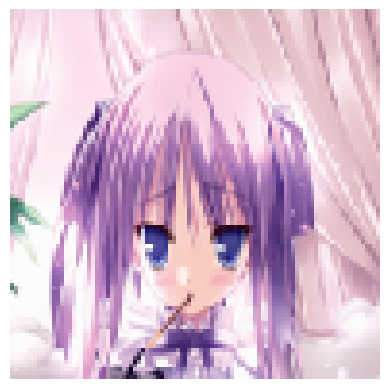

Label verdadera: Kagami Hiiragi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Kagami Hiiragi-Lucky Star : 43.37 % confianza.
> Sakuya Izayoi-Touhou : 37.69 % confianza.
> Rin Tohsakaka-Fate : 2.65 % confianza.
> Sakura Matou-Fate : 2.29 % confianza.
> Saber-Fate : 2.08 % confianza.


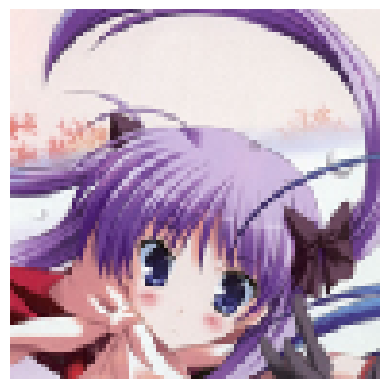

Label verdadera: Kagami Hiiragi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Sakuya Izayoi-Touhou : 44.70 % confianza.
> Kagami Hiiragi-Lucky Star : 21.18 % confianza.
> Sakura Matou-Fate : 19.73 % confianza.
> Scarlet Remilia-Touhou : 2.46 % confianza.
> Rin Tohsakaka-Fate : 1.53 % confianza.


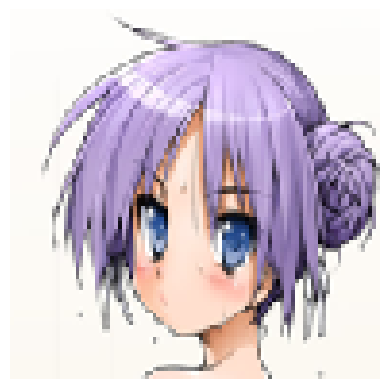

Label verdadera: Kagami Hiiragi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Kagami Hiiragi-Lucky Star : 73.05 % confianza.
> Sakuya Izayoi-Touhou : 5.35 % confianza.
> Sakura Matou-Fate : 2.55 % confianza.
> Rin Tohsakaka-Fate : 1.45 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 1.42 % confianza.


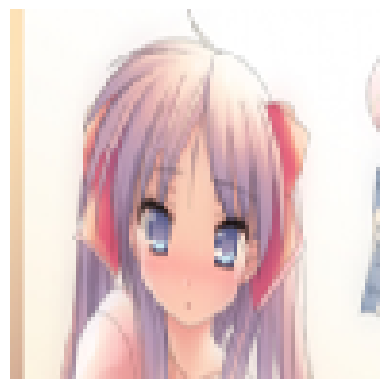

Label verdadera: Kagami Hiiragi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 22ms/step
> Kagami Hiiragi-Lucky Star : 73.49 % confianza.
> Sakuya Izayoi-Touhou : 11.35 % confianza.
> Kotobuki Tsumugi-K ON! : 2.90 % confianza.
> Saber-Fate : 2.27 % confianza.
> Aisaka Taiga-Toradora : 1.01 % confianza.


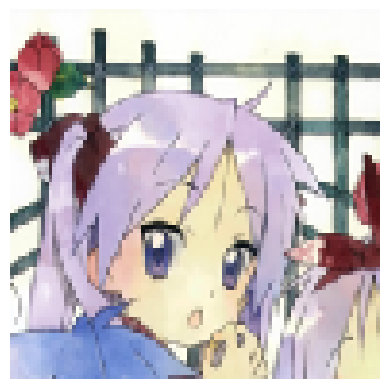

Label verdadera: Kagami Hiiragi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 22ms/step
> Kagami Hiiragi-Lucky Star : 96.42 % confianza.
> Sakuya Izayoi-Touhou : 0.62 % confianza.
> Konata Izumi-Lucky Star : 0.27 % confianza.
> Maka Albarn-Soul Eater : 0.21 % confianza.
> Raphtalia-Rising of the Shield Hero : 0.19 % confianza.


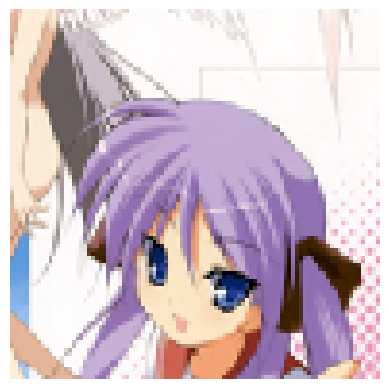

Label verdadera: Kagami Hiiragi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 38ms/step
> Kagami Hiiragi-Lucky Star : 83.67 % confianza.
> Sakuya Izayoi-Touhou : 5.59 % confianza.
> Sakura Matou-Fate : 1.54 % confianza.
> Saber-Fate : 0.79 % confianza.
> Scarlet Remilia-Touhou : 0.52 % confianza.


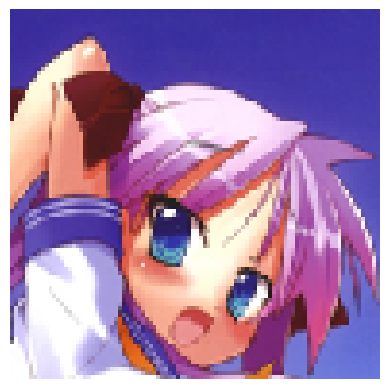

Label verdadera: Kagami Hiiragi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Kagami Hiiragi-Lucky Star : 83.19 % confianza.
> Sakuya Izayoi-Touhou : 2.76 % confianza.
> Saber-Fate : 1.97 % confianza.
> Sakura Matou-Fate : 1.87 % confianza.
> Cirno-Touhou : 0.74 % confianza.


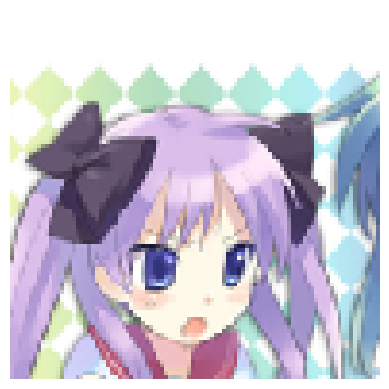

Label verdadera: Kagami Hiiragi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Kagami Hiiragi-Lucky Star : 95.86 % confianza.
> Sakuya Izayoi-Touhou : 0.98 % confianza.
> Cirno-Touhou : 0.28 % confianza.
> Scarlet Remilia-Touhou : 0.27 % confianza.
> Konata Izumi-Lucky Star : 0.20 % confianza.


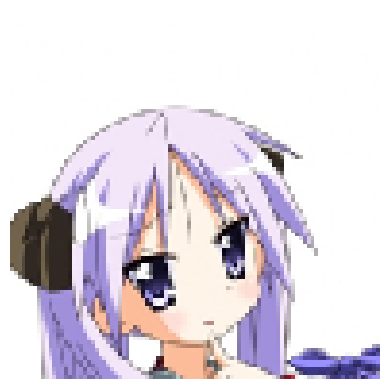

Label verdadera: Kagami Hiiragi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Sakuya Izayoi-Touhou : 43.68 % confianza.
> Kagami Hiiragi-Lucky Star : 28.04 % confianza.
> Cirno-Touhou : 16.97 % confianza.
> Maka Albarn-Soul Eater : 1.38 % confianza.
> Scarlet Remilia-Touhou : 1.23 % confianza.


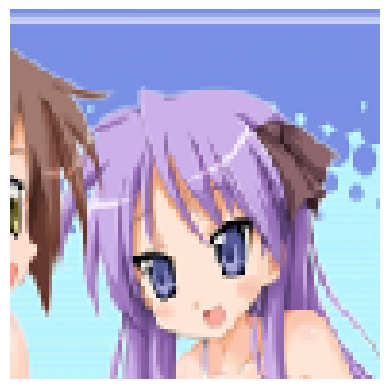

Label verdadera: Kagami Hiiragi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Kagami Hiiragi-Lucky Star : 98.04 % confianza.
> Sakuya Izayoi-Touhou : 0.26 % confianza.
> Miku Nakano-Quintessential Quintuplets : 0.14 % confianza.
> Sakura Matou-Fate : 0.11 % confianza.
> Konata Izumi-Lucky Star : 0.10 % confianza.


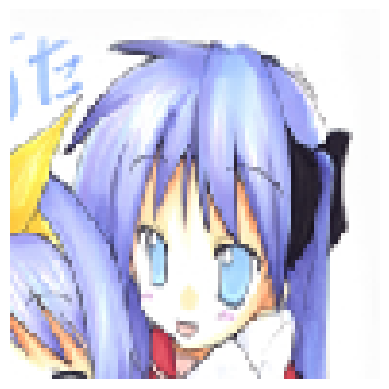

Label verdadera: Kagami Hiiragi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Kagami Hiiragi-Lucky Star : 67.16 % confianza.
> Konata Izumi-Lucky Star : 13.06 % confianza.
> Cirno-Touhou : 4.62 % confianza.
> Sakuya Izayoi-Touhou : 4.14 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.71 % confianza.


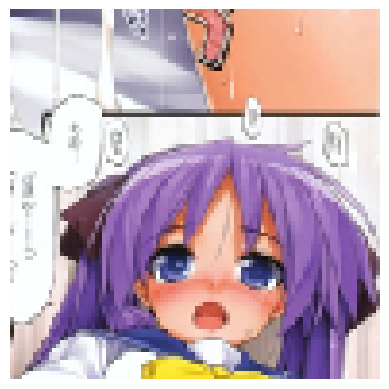

Label verdadera: Kagami Hiiragi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Kagami Hiiragi-Lucky Star : 38.31 % confianza.
> Sakura Matou-Fate : 30.73 % confianza.
> Scarlet Remilia-Touhou : 3.19 % confianza.
> Sakuya Izayoi-Touhou : 1.17 % confianza.
> Kallen Stadtfeld-Code Geass : 0.98 % confianza.


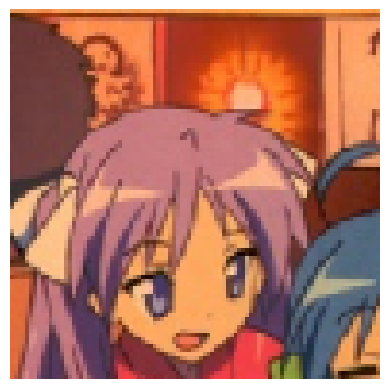

Label verdadera: Kagami Hiiragi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Kagami Hiiragi-Lucky Star : 41.96 % confianza.
> Sakura Matou-Fate : 6.66 % confianza.
> Aisaka Taiga-Toradora : 5.64 % confianza.
> Konata Izumi-Lucky Star : 5.34 % confianza.
> Scarlet Remilia-Touhou : 5.04 % confianza.


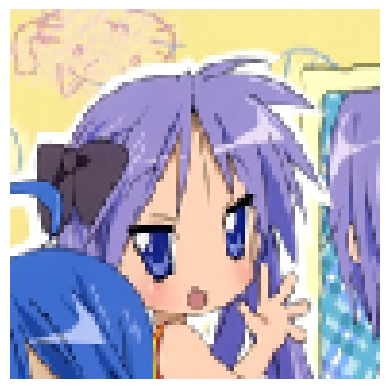

Label verdadera: Kagami Hiiragi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Kagami Hiiragi-Lucky Star : 98.57 % confianza.
> Konata Izumi-Lucky Star : 0.14 % confianza.
> Raphtalia-Rising of the Shield Hero : 0.10 % confianza.
> Kotobuki Tsumugi-K ON! : 0.09 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 0.05 % confianza.


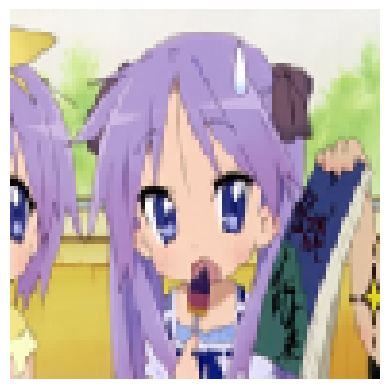

Label verdadera: Kagami Hiiragi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Kagami Hiiragi-Lucky Star : 98.60 % confianza.
> Raphtalia-Rising of the Shield Hero : 0.13 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.12 % confianza.
> Kotobuki Tsumugi-K ON! : 0.11 % confianza.
> Miku Nakano-Quintessential Quintuplets : 0.07 % confianza.


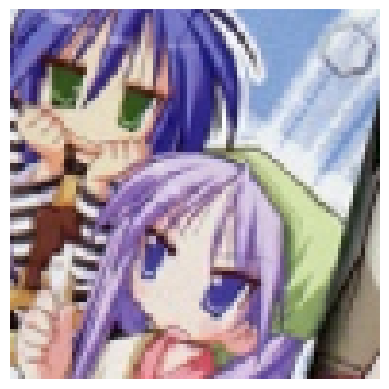

Label verdadera: Kagami Hiiragi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Kagami Hiiragi-Lucky Star : 96.49 % confianza.
> Sakuya Izayoi-Touhou : 0.61 % confianza.
> Kotobuki Tsumugi-K ON! : 0.33 % confianza.
> Miku Nakano-Quintessential Quintuplets : 0.24 % confianza.
> Raphtalia-Rising of the Shield Hero : 0.15 % confianza.


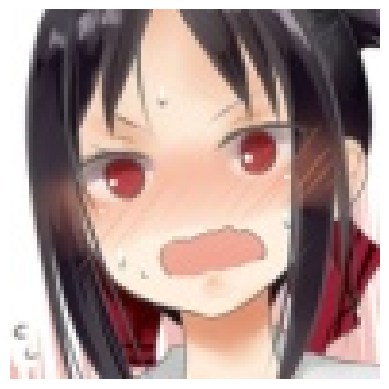

Label verdadera: Kaguya Shinomiya-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Kaguya Shinomiya-Kaguya Sama Love Is War : 89.16 % confianza.
> Nezuko Kamado-Demon Slayer : 4.80 % confianza.
> Megumin-Konosuba : 1.34 % confianza.
> Fubuki-One Punch Man : 0.28 % confianza.
> Ouro Kronii-Hololive : 0.27 % confianza.


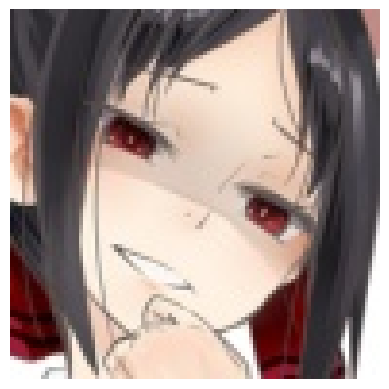

Label verdadera: Kaguya Shinomiya-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Kaguya Shinomiya-Kaguya Sama Love Is War : 98.45 % confianza.
> Nezuko Kamado-Demon Slayer : 0.89 % confianza.
> Megumin-Konosuba : 0.23 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.07 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 0.05 % confianza.


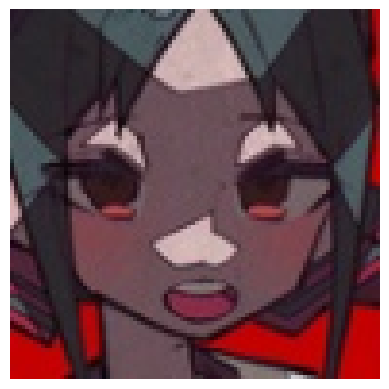

Label verdadera: Kaguya Shinomiya-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Reimu Hakurei-Touhou : 73.80 % confianza.
> Scarlet Remilia-Touhou : 9.15 % confianza.
> Yoko Littner-Gurrenn Lagann : 5.55 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 1.89 % confianza.
> Megumin-Konosuba : 1.79 % confianza.


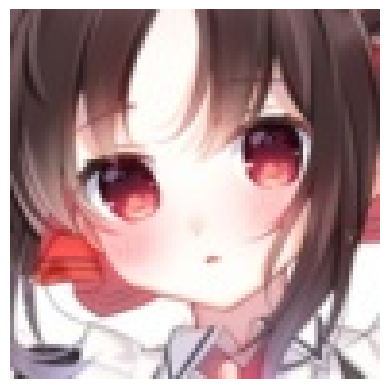

Label verdadera: Kaguya Shinomiya-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Kaguya Shinomiya-Kaguya Sama Love Is War : 81.75 % confianza.
> Megumin-Konosuba : 8.67 % confianza.
> Nezuko Kamado-Demon Slayer : 0.85 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.64 % confianza.
> Lelouch Lamperouge-Code Geass : 0.51 % confianza.


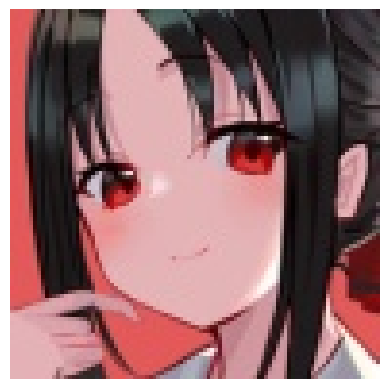

Label verdadera: Kaguya Shinomiya-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 39ms/step
> Kaguya Shinomiya-Kaguya Sama Love Is War : 70.96 % confianza.
> Megumin-Konosuba : 3.31 % confianza.
> Nezuko Kamado-Demon Slayer : 2.97 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 1.59 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 1.46 % confianza.


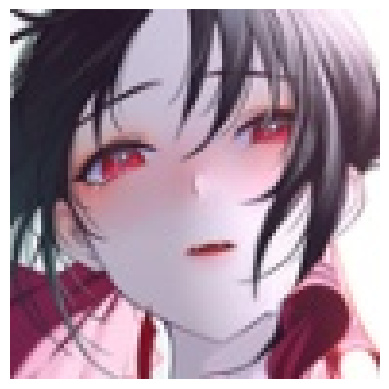

Label verdadera: Kaguya Shinomiya-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Kaguya Shinomiya-Kaguya Sama Love Is War : 92.68 % confianza.
> Scarlet Remilia-Touhou : 1.48 % confianza.
> Megumin-Konosuba : 0.53 % confianza.
> Nezuko Kamado-Demon Slayer : 0.52 % confianza.
> Nia Teppelin-Gurrenn Lagann : 0.30 % confianza.


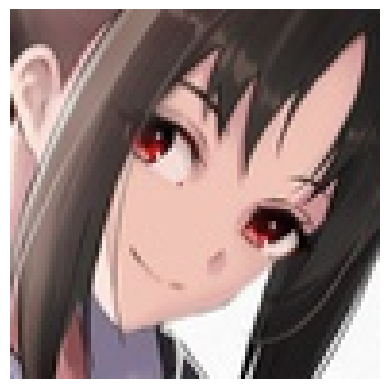

Label verdadera: Kaguya Shinomiya-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Kaguya Shinomiya-Kaguya Sama Love Is War : 78.51 % confianza.
> Megumin-Konosuba : 9.19 % confianza.
> Albedo-Overlord : 4.10 % confianza.
> Nezuko Kamado-Demon Slayer : 1.66 % confianza.
> Miku Nakano-Quintessential Quintuplets : 0.51 % confianza.


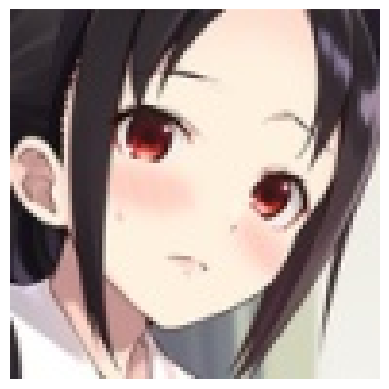

Label verdadera: Kaguya Shinomiya-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Kaguya Shinomiya-Kaguya Sama Love Is War : 89.19 % confianza.
> Nezuko Kamado-Demon Slayer : 4.50 % confianza.
> Megumin-Konosuba : 0.80 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.41 % confianza.
> Hifumi Takimoto-New Game! : 0.27 % confianza.


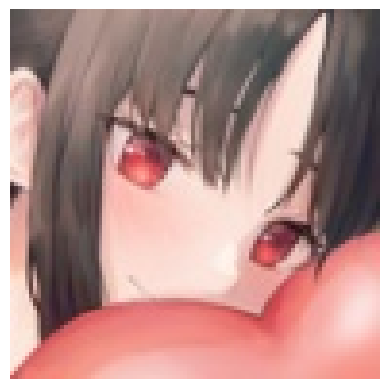

Label verdadera: Kaguya Shinomiya-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Kaguya Shinomiya-Kaguya Sama Love Is War : 57.06 % confianza.
> Megumin-Konosuba : 11.97 % confianza.
> Reimu Hakurei-Touhou : 1.66 % confianza.
> Gawr Gura-Hololive : 1.51 % confianza.
> Miku Nakano-Quintessential Quintuplets : 1.36 % confianza.


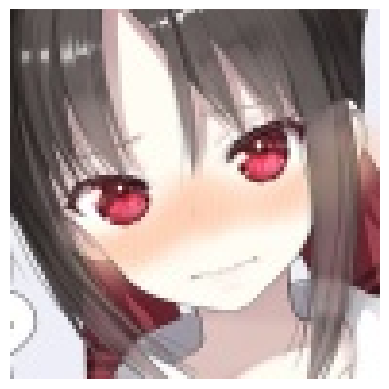

Label verdadera: Kaguya Shinomiya-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Kaguya Shinomiya-Kaguya Sama Love Is War : 79.89 % confianza.
> Megumin-Konosuba : 3.77 % confianza.
> Gawr Gura-Hololive : 1.06 % confianza.
> Nezuko Kamado-Demon Slayer : 0.75 % confianza.
> Lelouch Lamperouge-Code Geass : 0.70 % confianza.


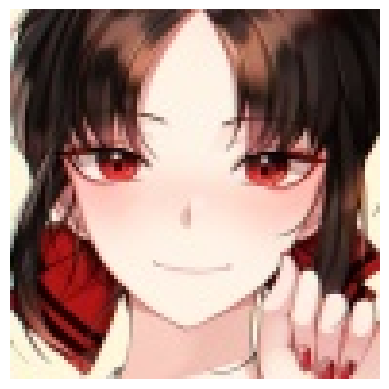

Label verdadera: Kaguya Shinomiya-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Kaguya Shinomiya-Kaguya Sama Love Is War : 79.03 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 2.04 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 1.74 % confianza.
> Reimu Hakurei-Touhou : 1.32 % confianza.
> Megumin-Konosuba : 1.21 % confianza.


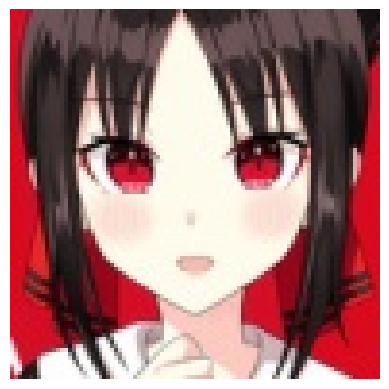

Label verdadera: Kaguya Shinomiya-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 41ms/step
> Kaguya Shinomiya-Kaguya Sama Love Is War : 73.24 % confianza.
> Reimu Hakurei-Touhou : 5.70 % confianza.
> Megumin-Konosuba : 3.85 % confianza.
> Nezuko Kamado-Demon Slayer : 1.11 % confianza.
> Lelouch Lamperouge-Code Geass : 0.79 % confianza.


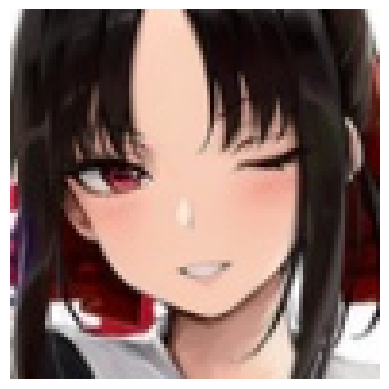

Label verdadera: Kaguya Shinomiya-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Kaguya Shinomiya-Kaguya Sama Love Is War : 47.50 % confianza.
> Megumin-Konosuba : 8.63 % confianza.
> Nezuko Kamado-Demon Slayer : 8.25 % confianza.
> Shouko Komi-Komi Cant Communicate : 7.09 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 2.83 % confianza.


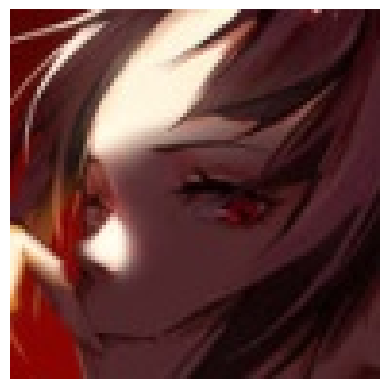

Label verdadera: Kaguya Shinomiya-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Albedo-Overlord : 28.15 % confianza.
> Megumin-Konosuba : 25.14 % confianza.
> Kurisu Makise-Steins Gate : 14.42 % confianza.
> Scarlet Remilia-Touhou : 5.76 % confianza.
> Reimu Hakurei-Touhou : 2.84 % confianza.


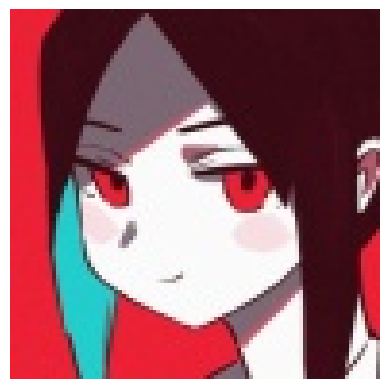

Label verdadera: Kaguya Shinomiya-Kaguya Sama Love Is War
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Kaguya Shinomiya-Kaguya Sama Love Is War : 27.08 % confianza.
> Nezuko Kamado-Demon Slayer : 22.03 % confianza.
> Megumin-Konosuba : 12.94 % confianza.
> Illyasviel Von Einzbern-Fate : 2.75 % confianza.
> Nino Nakano-Quintessential Quintuplets : 2.11 % confianza.


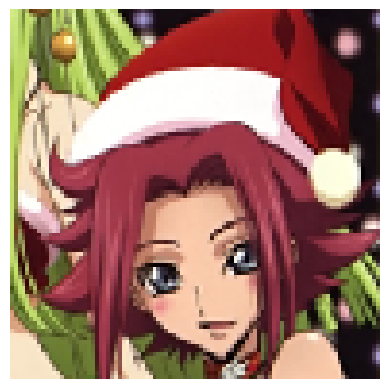

Label verdadera: Kallen Stadtfeld-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Kallen Stadtfeld-Code Geass : 96.93 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.68 % confianza.
> Ritsu Tainaka-K ON! : 0.54 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.21 % confianza.
> Nezuko Kamado-Demon Slayer : 0.11 % confianza.


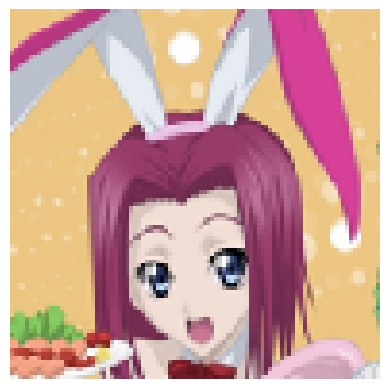

Label verdadera: Kallen Stadtfeld-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Kallen Stadtfeld-Code Geass : 88.06 % confianza.
> Ritsu Tainaka-K ON! : 2.21 % confianza.
> Maki Nishikino-Love Live : 1.55 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 1.05 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.58 % confianza.


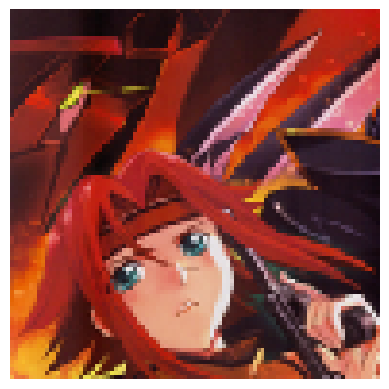

Label verdadera: Kallen Stadtfeld-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Kallen Stadtfeld-Code Geass : 70.14 % confianza.
> Yoko Littner-Gurrenn Lagann : 13.46 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 3.20 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 1.86 % confianza.
> Rin Tohsakaka-Fate : 1.51 % confianza.


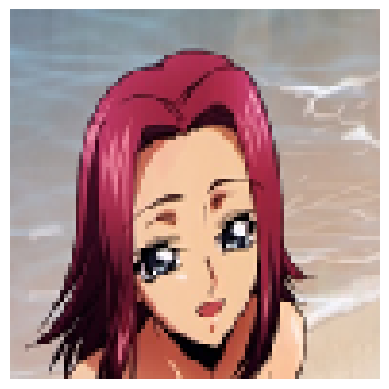

Label verdadera: Kallen Stadtfeld-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Kallen Stadtfeld-Code Geass : 91.84 % confianza.
> Ritsu Tainaka-K ON! : 2.57 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.28 % confianza.
> Paimon-Genshin Impact : 0.27 % confianza.
> Yoko Littner-Gurrenn Lagann : 0.25 % confianza.


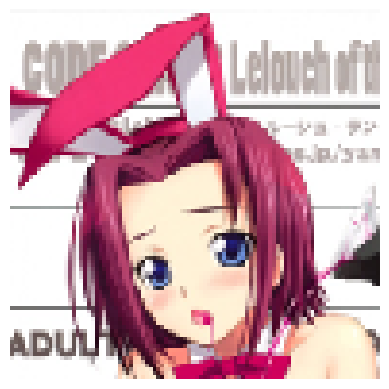

Label verdadera: Kallen Stadtfeld-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Kallen Stadtfeld-Code Geass : 98.16 % confianza.
> Ritsu Tainaka-K ON! : 0.36 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.21 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.10 % confianza.
> Maki Nishikino-Love Live : 0.09 % confianza.


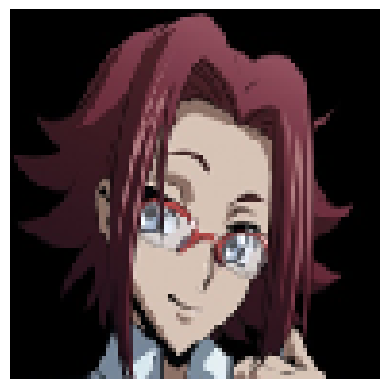

Label verdadera: Kallen Stadtfeld-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Kallen Stadtfeld-Code Geass : 83.13 % confianza.
> Shinobu Kochou-Demon Slayer : 2.91 % confianza.
> Megumin-Konosuba : 1.92 % confianza.
> Shirley Fenette-Code Geass : 1.33 % confianza.
> Ritsu Tainaka-K ON! : 1.13 % confianza.


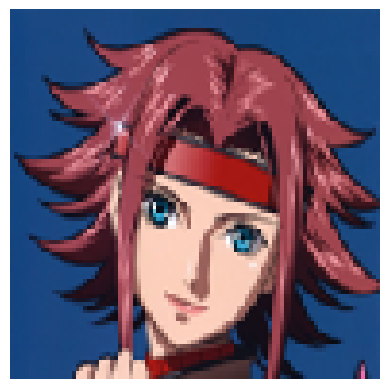

Label verdadera: Kallen Stadtfeld-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Kallen Stadtfeld-Code Geass : 93.67 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 1.02 % confianza.
> Yoko Littner-Gurrenn Lagann : 0.54 % confianza.
> Ritsu Tainaka-K ON! : 0.38 % confianza.
> Rin Tohsakaka-Fate : 0.34 % confianza.


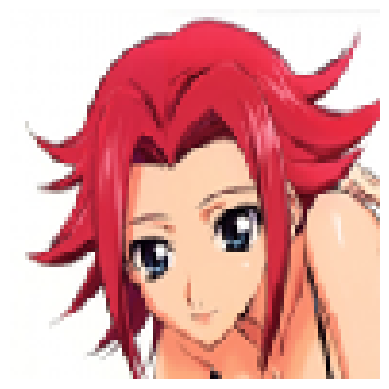

Label verdadera: Kallen Stadtfeld-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 22ms/step
> Kallen Stadtfeld-Code Geass : 89.72 % confianza.
> Yoko Littner-Gurrenn Lagann : 1.36 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 1.04 % confianza.
> Ritsu Tainaka-K ON! : 0.91 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.85 % confianza.


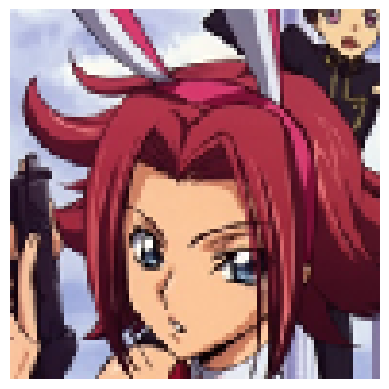

Label verdadera: Kallen Stadtfeld-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 44ms/step
> Kallen Stadtfeld-Code Geass : 80.26 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 4.04 % confianza.
> Ritsu Tainaka-K ON! : 1.26 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 1.15 % confianza.
> Yoko Littner-Gurrenn Lagann : 1.07 % confianza.


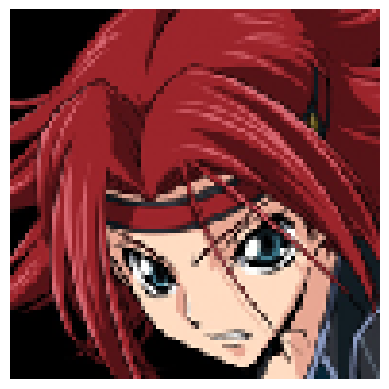

Label verdadera: Kallen Stadtfeld-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Kallen Stadtfeld-Code Geass : 48.38 % confianza.
> Rin Tohsakaka-Fate : 8.24 % confianza.
> Yoko Littner-Gurrenn Lagann : 5.39 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 5.06 % confianza.
> Shirley Fenette-Code Geass : 2.04 % confianza.


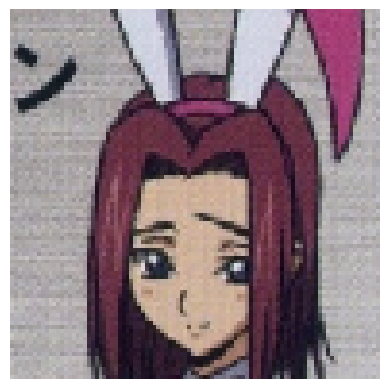

Label verdadera: Kallen Stadtfeld-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Kallen Stadtfeld-Code Geass : 98.00 % confianza.
> Shirley Fenette-Code Geass : 0.28 % confianza.
> Ritsu Tainaka-K ON! : 0.28 % confianza.
> Rin Tohsakaka-Fate : 0.16 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.13 % confianza.


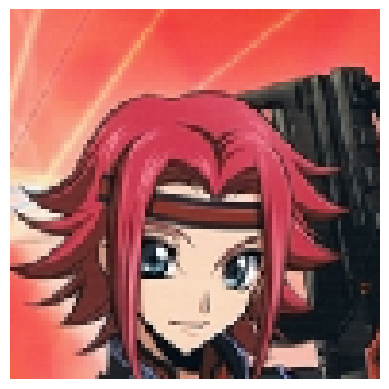

Label verdadera: Kallen Stadtfeld-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Kallen Stadtfeld-Code Geass : 98.36 % confianza.
> Rin Tohsakaka-Fate : 0.22 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.15 % confianza.
> Ritsu Tainaka-K ON! : 0.09 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.08 % confianza.


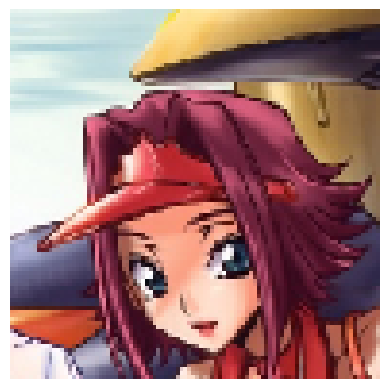

Label verdadera: Kallen Stadtfeld-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Kallen Stadtfeld-Code Geass : 93.47 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 1.54 % confianza.
> Rin Tohsakaka-Fate : 0.60 % confianza.
> Ritsu Tainaka-K ON! : 0.32 % confianza.
> Yoko Littner-Gurrenn Lagann : 0.27 % confianza.


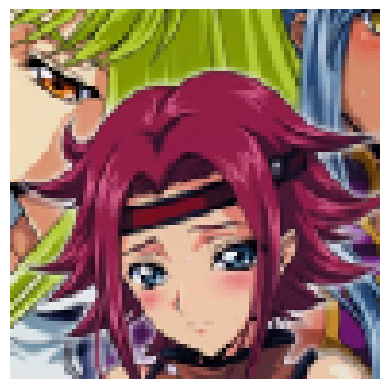

Label verdadera: Kallen Stadtfeld-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Kallen Stadtfeld-Code Geass : 98.62 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.20 % confianza.
> Yoko Littner-Gurrenn Lagann : 0.16 % confianza.
> Rin Tohsakaka-Fate : 0.13 % confianza.
> Ritsu Tainaka-K ON! : 0.10 % confianza.


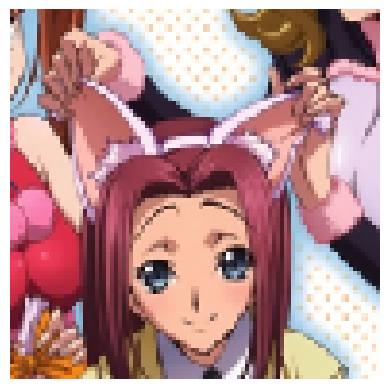

Label verdadera: Kallen Stadtfeld-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Kallen Stadtfeld-Code Geass : 92.24 % confianza.
> Ritsu Tainaka-K ON! : 1.01 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.96 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.62 % confianza.
> Kagami Hiiragi-Lucky Star : 0.29 % confianza.


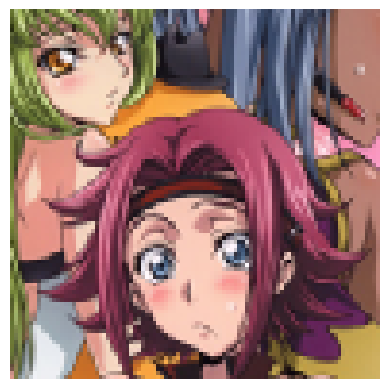

Label verdadera: Kallen Stadtfeld-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Kallen Stadtfeld-Code Geass : 93.63 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 1.09 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.40 % confianza.
> Ritsu Tainaka-K ON! : 0.36 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.36 % confianza.


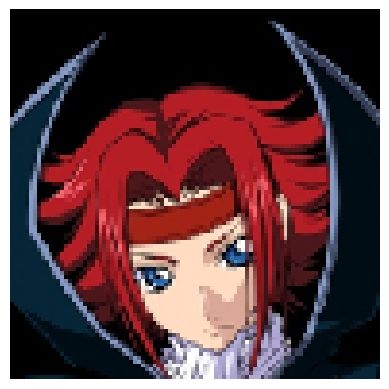

Label verdadera: Kallen Stadtfeld-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Kallen Stadtfeld-Code Geass : 78.89 % confianza.
> Rin Tohsakaka-Fate : 10.16 % confianza.
> Yoko Littner-Gurrenn Lagann : 3.77 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 1.29 % confianza.
> Hatsune Miku-Vocaloid : 0.61 % confianza.


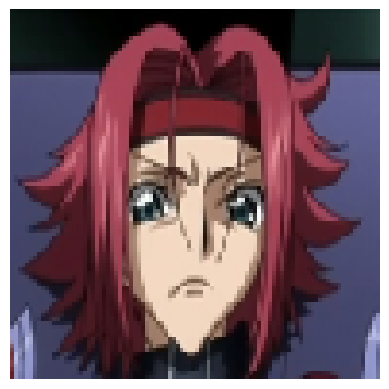

Label verdadera: Kallen Stadtfeld-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Kallen Stadtfeld-Code Geass : 96.18 % confianza.
> Shirley Fenette-Code Geass : 0.49 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.38 % confianza.
> Rin Tohsakaka-Fate : 0.31 % confianza.
> Yoko Littner-Gurrenn Lagann : 0.28 % confianza.


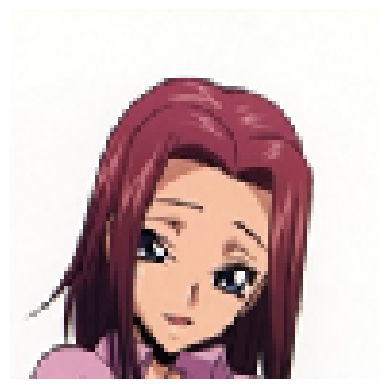

Label verdadera: Kallen Stadtfeld-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Kallen Stadtfeld-Code Geass : 83.52 % confianza.
> Ritsu Tainaka-K ON! : 2.80 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 2.35 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.68 % confianza.
> Kirito-Sword Art Online : 0.60 % confianza.


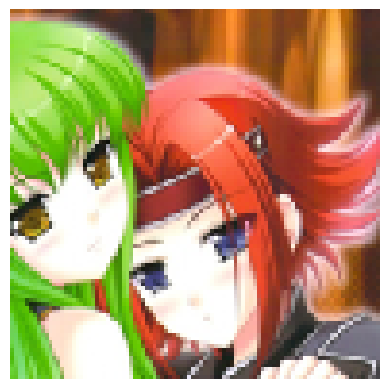

Label verdadera: Kallen Stadtfeld-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Kallen Stadtfeld-Code Geass : 17.93 % confianza.
> Ritsu Tainaka-K ON! : 10.32 % confianza.
> C.C-Code Geass : 7.41 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 7.30 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 6.97 % confianza.


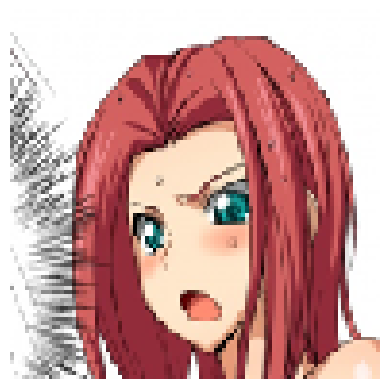

Label verdadera: Kallen Stadtfeld-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Kallen Stadtfeld-Code Geass : 97.36 % confianza.
> Ritsu Tainaka-K ON! : 0.22 % confianza.
> Rin Tohsakaka-Fate : 0.20 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.18 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.16 % confianza.


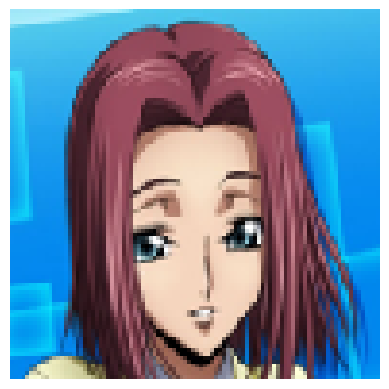

Label verdadera: Kallen Stadtfeld-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Kallen Stadtfeld-Code Geass : 93.84 % confianza.
> Ritsu Tainaka-K ON! : 2.07 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.62 % confianza.
> Rin Tohsakaka-Fate : 0.32 % confianza.
> Shirley Fenette-Code Geass : 0.12 % confianza.


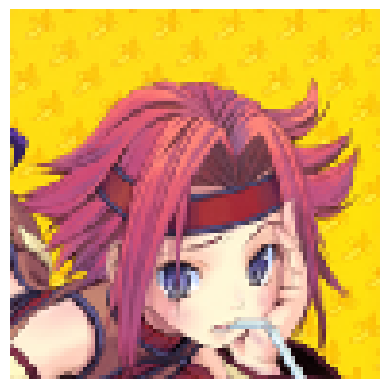

Label verdadera: Kallen Stadtfeld-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 22ms/step
> Kallen Stadtfeld-Code Geass : 63.03 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 12.98 % confianza.
> Saber-Fate : 2.51 % confianza.
> Kagami Hiiragi-Lucky Star : 2.33 % confianza.
> Flandre Scarlet-Touhou : 1.22 % confianza.


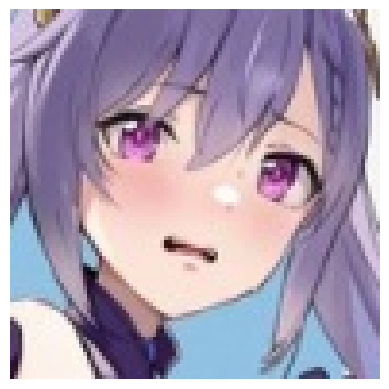

Label verdadera: Keqing-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Keqing-Genshin Impact : 93.79 % confianza.
> Nozomi Tojo-Love Live : 0.49 % confianza.
> Megumin-Konosuba : 0.48 % confianza.
> Nezuko Kamado-Demon Slayer : 0.29 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.28 % confianza.


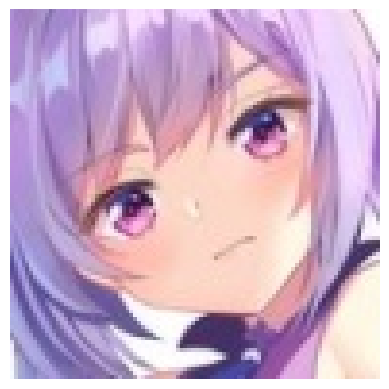

Label verdadera: Keqing-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Keqing-Genshin Impact : 86.59 % confianza.
> Emilia-Re Zero : 2.73 % confianza.
> Rem-Re Zero : 0.82 % confianza.
> Aqua-Konosuba : 0.77 % confianza.
> Aisaka Taiga-Toradora : 0.66 % confianza.


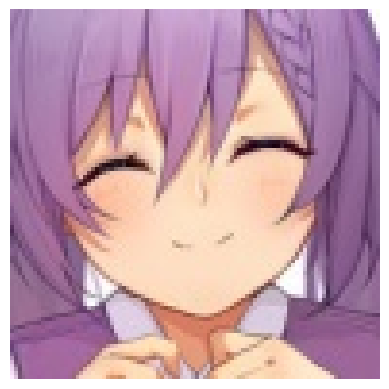

Label verdadera: Keqing-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 32.72 % confianza.
> Hinata Hyuuga-Naruto : 17.48 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 8.67 % confianza.
> Maki Nishikino-Love Live : 7.16 % confianza.
> Nozomi Tojo-Love Live : 5.67 % confianza.


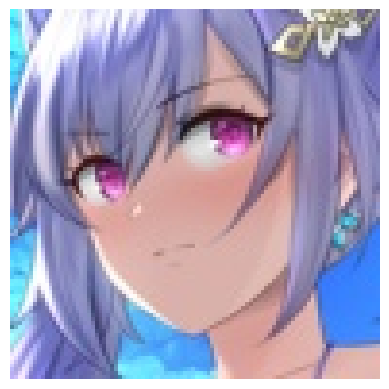

Label verdadera: Keqing-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 41ms/step
> Keqing-Genshin Impact : 81.65 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 3.04 % confianza.
> Rem-Re Zero : 1.53 % confianza.
> Lelouch Lamperouge-Code Geass : 0.97 % confianza.
> Sakura Matou-Fate : 0.75 % confianza.


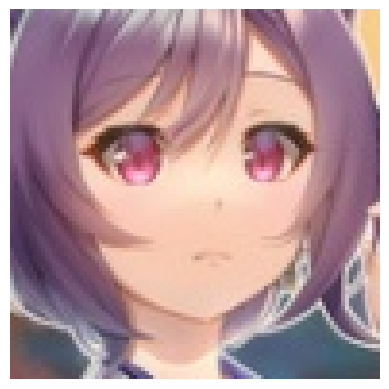

Label verdadera: Keqing-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Keqing-Genshin Impact : 97.73 % confianza.
> Megumin-Konosuba : 0.37 % confianza.
> Nozomi Tojo-Love Live : 0.19 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.09 % confianza.
> Lelouch Lamperouge-Code Geass : 0.09 % confianza.


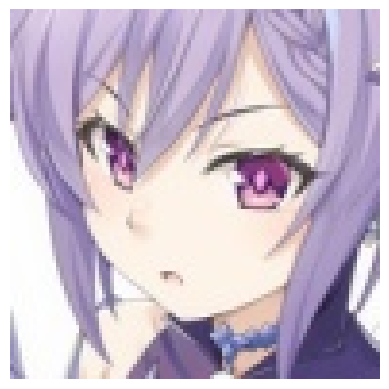

Label verdadera: Keqing-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Keqing-Genshin Impact : 87.83 % confianza.
> Emilia-Re Zero : 2.02 % confianza.
> Megumin-Konosuba : 0.83 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.77 % confianza.
> Nozomi Tojo-Love Live : 0.46 % confianza.


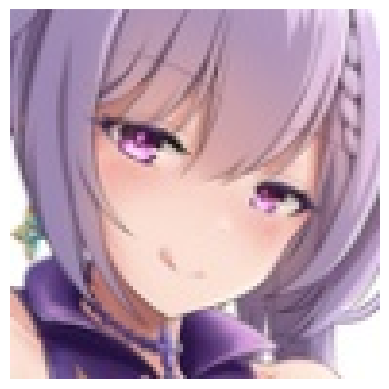

Label verdadera: Keqing-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 35ms/step
> Keqing-Genshin Impact : 95.82 % confianza.
> Emilia-Re Zero : 0.34 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.29 % confianza.
> Ram-Re Zero : 0.26 % confianza.
> Illyasviel Von Einzbern-Fate : 0.20 % confianza.


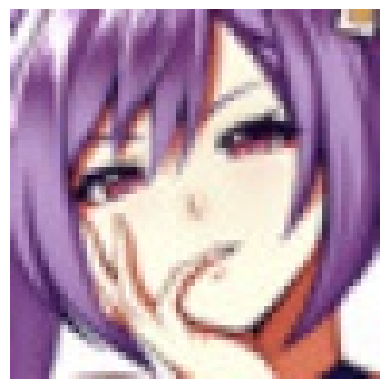

Label verdadera: Keqing-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 22ms/step
> Sakura Matou-Fate : 53.86 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 10.66 % confianza.
> Scarlet Remilia-Touhou : 7.60 % confianza.
> Keqing-Genshin Impact : 4.77 % confianza.
> Albedo-Overlord : 3.10 % confianza.


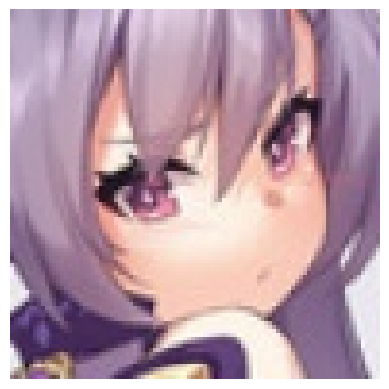

Label verdadera: Keqing-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Keqing-Genshin Impact : 95.50 % confianza.
> Megumin-Konosuba : 0.57 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.25 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.19 % confianza.
> Scarlet Remilia-Touhou : 0.19 % confianza.


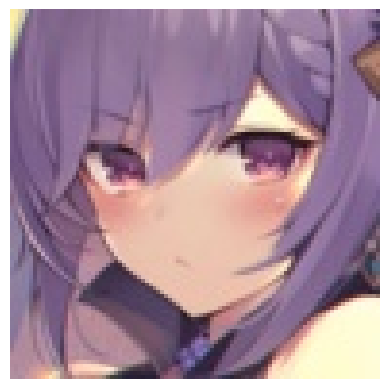

Label verdadera: Keqing-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Keqing-Genshin Impact : 90.55 % confianza.
> Megumin-Konosuba : 0.95 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.88 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.80 % confianza.
> Shinobu Kochou-Demon Slayer : 0.72 % confianza.


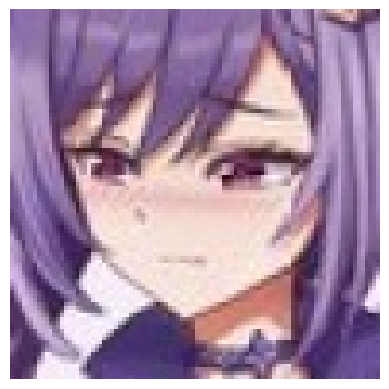

Label verdadera: Keqing-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 34ms/step
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 69.64 % confianza.
> Keqing-Genshin Impact : 12.56 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 6.60 % confianza.
> Hinata Hyuuga-Naruto : 1.48 % confianza.
> Nozomi Tojo-Love Live : 1.00 % confianza.


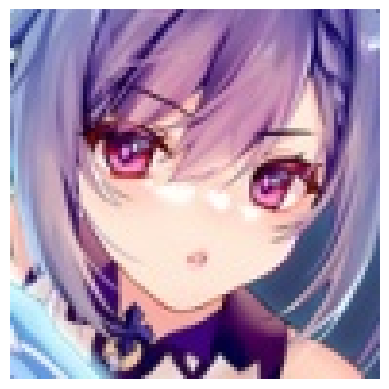

Label verdadera: Keqing-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 37ms/step
> Keqing-Genshin Impact : 94.67 % confianza.
> Megumin-Konosuba : 0.48 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.29 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.27 % confianza.
> Illyasviel Von Einzbern-Fate : 0.22 % confianza.


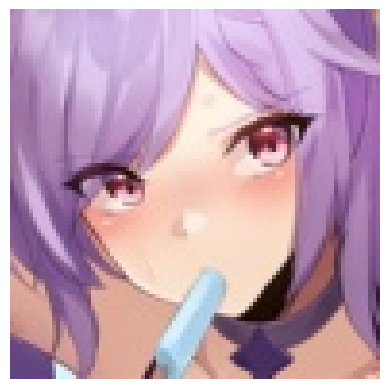

Label verdadera: Keqing-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Keqing-Genshin Impact : 84.03 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 3.20 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 1.24 % confianza.
> Megumin-Konosuba : 0.95 % confianza.
> Ram-Re Zero : 0.90 % confianza.


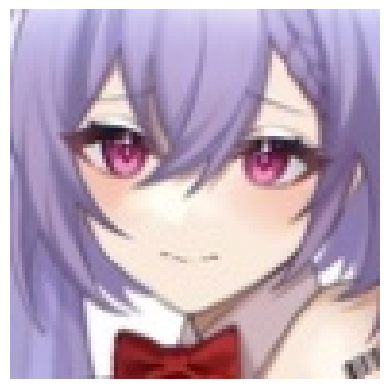

Label verdadera: Keqing-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Keqing-Genshin Impact : 82.49 % confianza.
> Albedo-Overlord : 2.07 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 1.98 % confianza.
> Megumin-Konosuba : 1.06 % confianza.
> Nozomi Tojo-Love Live : 0.74 % confianza.


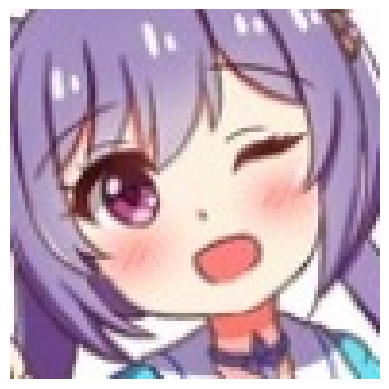

Label verdadera: Keqing-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Keqing-Genshin Impact : 54.44 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 8.63 % confianza.
> Aqua-Konosuba : 5.62 % confianza.
> Illyasviel Von Einzbern-Fate : 2.64 % confianza.
> Paimon-Genshin Impact : 2.59 % confianza.


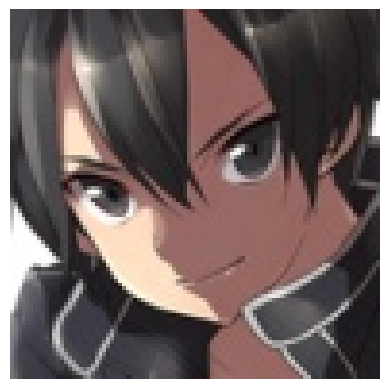

Label verdadera: Kirito-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Kirito-Sword Art Online : 51.89 % confianza.
> Nico Robin-One Piece : 8.33 % confianza.
> Albedo-Overlord : 7.28 % confianza.
> Fubuki-One Punch Man : 7.12 % confianza.
> Sinon-Sword Art Online : 3.69 % confianza.


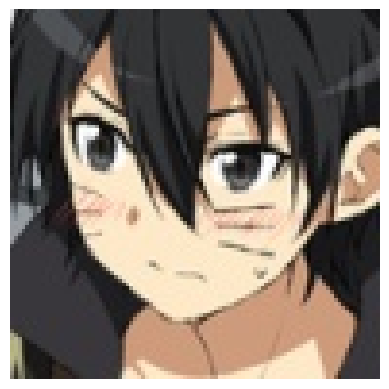

Label verdadera: Kirito-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Kirito-Sword Art Online : 99.07 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.32 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.14 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.05 % confianza.
> Paimon-Genshin Impact : 0.04 % confianza.


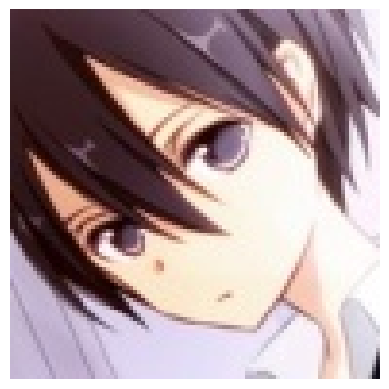

Label verdadera: Kirito-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Kirito-Sword Art Online : 97.71 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.60 % confianza.
> Paimon-Genshin Impact : 0.30 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.22 % confianza.
> Aqua-Konosuba : 0.16 % confianza.


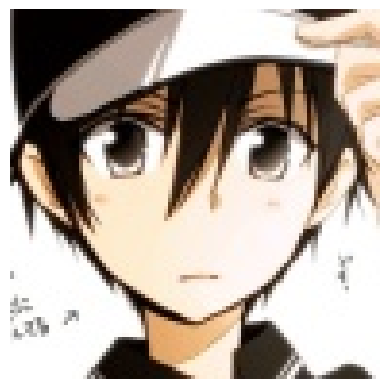

Label verdadera: Kirito-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Kirito-Sword Art Online : 95.66 % confianza.
> Paimon-Genshin Impact : 1.30 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 0.34 % confianza.
> Ritsu Tainaka-K ON! : 0.29 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.23 % confianza.


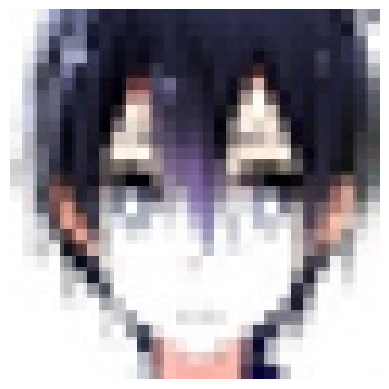

Label verdadera: Kirito-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Kirito-Sword Art Online : 35.31 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 29.05 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 18.66 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 2.08 % confianza.
> Shinobu Kochou-Demon Slayer : 1.97 % confianza.


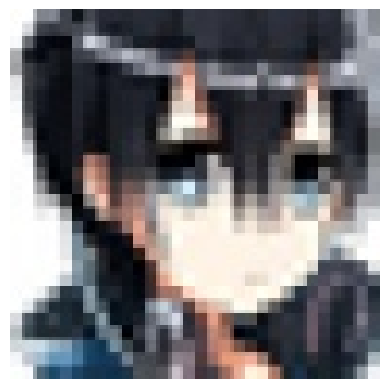

Label verdadera: Kirito-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Jonathan Joestar-Jojos Bizarre Adventure : 50.93 % confianza.
> Ouro Kronii-Hololive : 29.86 % confianza.
> Kirito-Sword Art Online : 7.16 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 2.00 % confianza.
> Rin Tohsakaka-Fate : 1.59 % confianza.


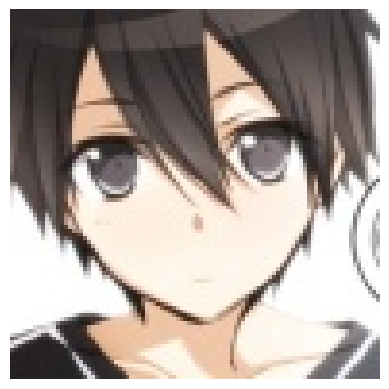

Label verdadera: Kirito-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Kirito-Sword Art Online : 99.22 % confianza.
> Paimon-Genshin Impact : 0.19 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.09 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.08 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.07 % confianza.


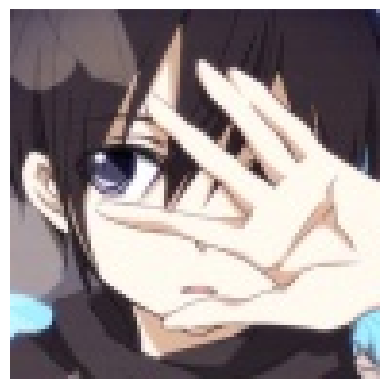

Label verdadera: Kirito-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Nico Robin-One Piece : 60.30 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 12.23 % confianza.
> Kirito-Sword Art Online : 8.82 % confianza.
> Shinobu Kochou-Demon Slayer : 2.42 % confianza.
> Sakuya Izayoi-Touhou : 2.10 % confianza.


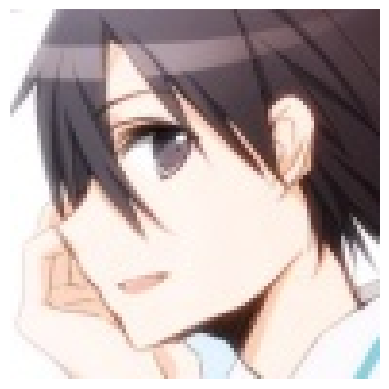

Label verdadera: Kirito-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Kirito-Sword Art Online : 94.97 % confianza.
> Paimon-Genshin Impact : 2.15 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.48 % confianza.
> Sinon-Sword Art Online : 0.21 % confianza.
> Shouko Komi-Komi Cant Communicate : 0.17 % confianza.


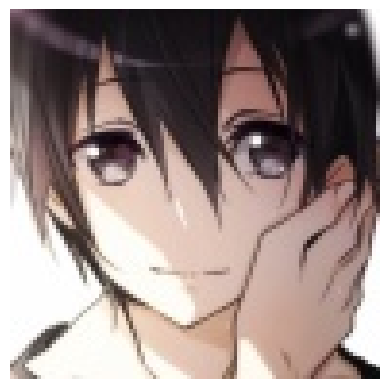

Label verdadera: Kirito-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Kirito-Sword Art Online : 99.08 % confianza.
> Paimon-Genshin Impact : 0.23 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.13 % confianza.
> Nico Robin-One Piece : 0.06 % confianza.
> Shouko Komi-Komi Cant Communicate : 0.04 % confianza.


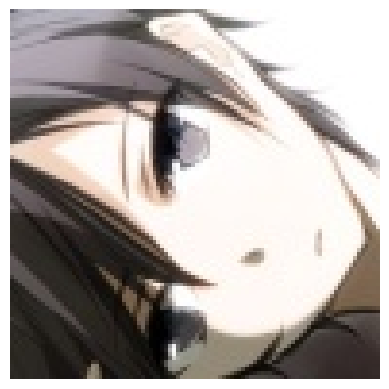

Label verdadera: Kirito-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Shouko Komi-Komi Cant Communicate : 74.04 % confianza.
> Kirito-Sword Art Online : 3.73 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 2.40 % confianza.
> Fubuki-One Punch Man : 2.20 % confianza.
> Asuna Yuuki-Sword Art Online : 1.91 % confianza.


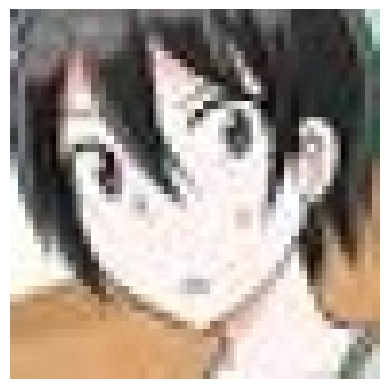

Label verdadera: Kirito-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Kirito-Sword Art Online : 41.43 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 31.91 % confianza.
> Nico Robin-One Piece : 9.85 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 1.85 % confianza.
> Sinon-Sword Art Online : 1.49 % confianza.


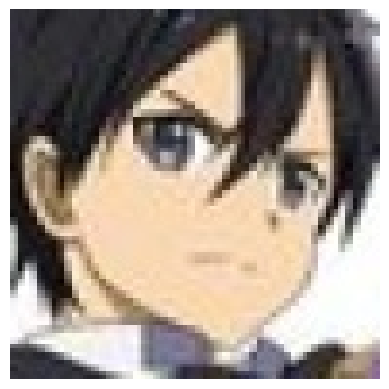

Label verdadera: Kirito-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Kirito-Sword Art Online : 98.74 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.57 % confianza.
> Paimon-Genshin Impact : 0.13 % confianza.
> Sinon-Sword Art Online : 0.10 % confianza.
> Nico Robin-One Piece : 0.06 % confianza.


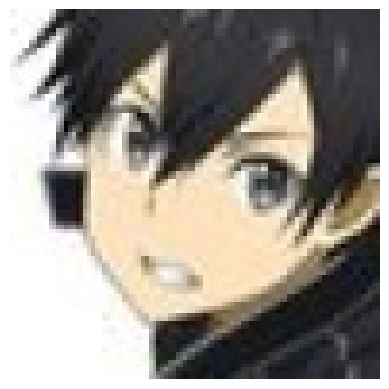

Label verdadera: Kirito-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Kirito-Sword Art Online : 98.54 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.33 % confianza.
> Nico Robin-One Piece : 0.24 % confianza.
> Shinobu Kochou-Demon Slayer : 0.14 % confianza.
> Paimon-Genshin Impact : 0.13 % confianza.


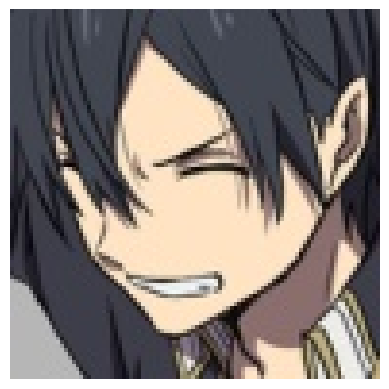

Label verdadera: Kirito-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Hinata Hyuuga-Naruto : 42.63 % confianza.
> Kirito-Sword Art Online : 23.13 % confianza.
> Shinobu Kochou-Demon Slayer : 10.71 % confianza.
> Shiki Ryougi-Garden of Sinners : 5.22 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 4.34 % confianza.


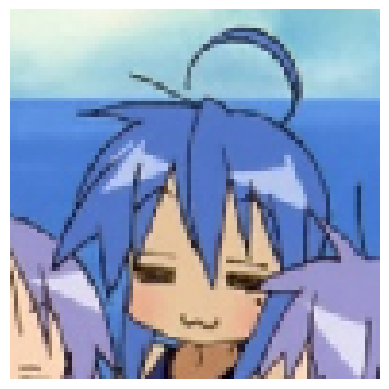

Label verdadera: Konata Izumi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 22ms/step
> Konata Izumi-Lucky Star : 98.29 % confianza.
> Cirno-Touhou : 0.43 % confianza.
> Kagami Hiiragi-Lucky Star : 0.16 % confianza.
> Maka Albarn-Soul Eater : 0.14 % confianza.
> Sakura Matou-Fate : 0.05 % confianza.


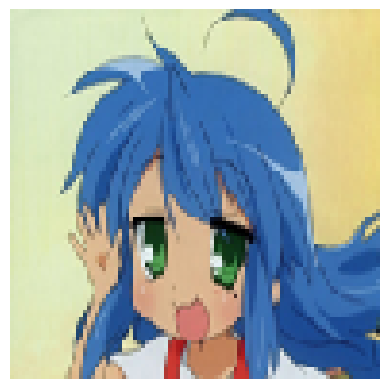

Label verdadera: Konata Izumi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Konata Izumi-Lucky Star : 95.62 % confianza.
> Cirno-Touhou : 0.55 % confianza.
> Suzaku Kururugi-Code Geass : 0.53 % confianza.
> Maka Albarn-Soul Eater : 0.42 % confianza.
> Ouro Kronii-Hololive : 0.29 % confianza.


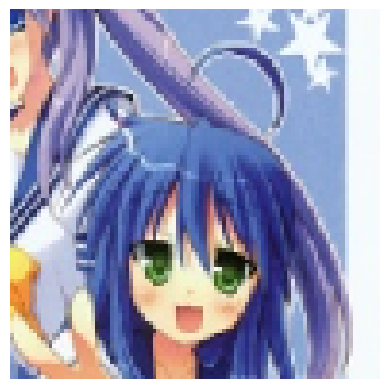

Label verdadera: Konata Izumi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 38ms/step
> Konata Izumi-Lucky Star : 90.94 % confianza.
> Cirno-Touhou : 0.93 % confianza.
> Sakuya Izayoi-Touhou : 0.83 % confianza.
> Sakura Matou-Fate : 0.72 % confianza.
> Maka Albarn-Soul Eater : 0.57 % confianza.


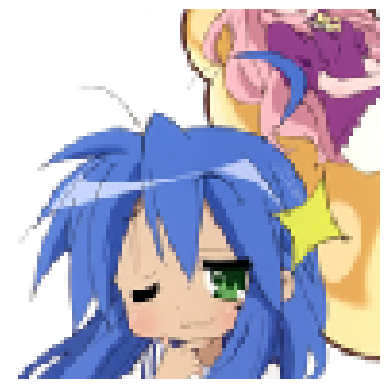

Label verdadera: Konata Izumi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 38ms/step
> Konata Izumi-Lucky Star : 98.89 % confianza.
> Maka Albarn-Soul Eater : 0.08 % confianza.
> Kagami Hiiragi-Lucky Star : 0.06 % confianza.
> Cirno-Touhou : 0.06 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.05 % confianza.


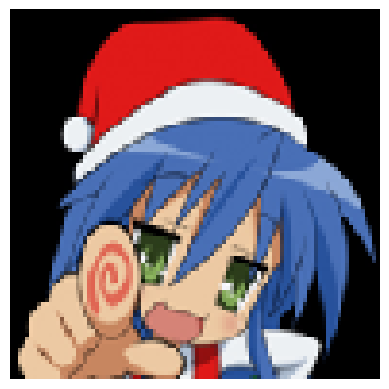

Label verdadera: Konata Izumi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Konata Izumi-Lucky Star : 82.18 % confianza.
> Cirno-Touhou : 1.37 % confianza.
> Sakuya Izayoi-Touhou : 1.08 % confianza.
> Sakura Matou-Fate : 0.92 % confianza.
> Maka Albarn-Soul Eater : 0.60 % confianza.


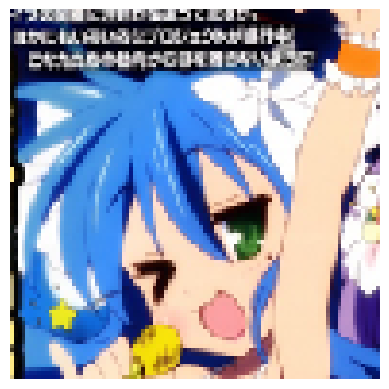

Label verdadera: Konata Izumi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Konata Izumi-Lucky Star : 91.44 % confianza.
> Maka Albarn-Soul Eater : 1.06 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.43 % confianza.
> Ouro Kronii-Hololive : 0.35 % confianza.
> Nia Teppelin-Gurrenn Lagann : 0.34 % confianza.


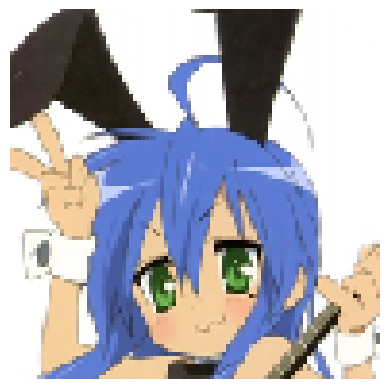

Label verdadera: Konata Izumi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Konata Izumi-Lucky Star : 99.10 % confianza.
> Sakura Matou-Fate : 0.07 % confianza.
> Maka Albarn-Soul Eater : 0.06 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.05 % confianza.
> Kagami Hiiragi-Lucky Star : 0.03 % confianza.


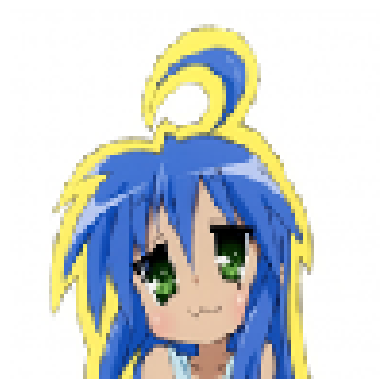

Label verdadera: Konata Izumi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Konata Izumi-Lucky Star : 97.32 % confianza.
> Nia Teppelin-Gurrenn Lagann : 0.24 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.17 % confianza.
> Kagami Hiiragi-Lucky Star : 0.14 % confianza.
> Maka Albarn-Soul Eater : 0.12 % confianza.


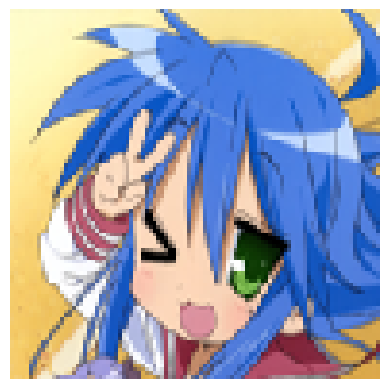

Label verdadera: Konata Izumi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Konata Izumi-Lucky Star : 93.49 % confianza.
> Nia Teppelin-Gurrenn Lagann : 1.63 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.37 % confianza.
> Aegis-Persona : 0.33 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 0.30 % confianza.


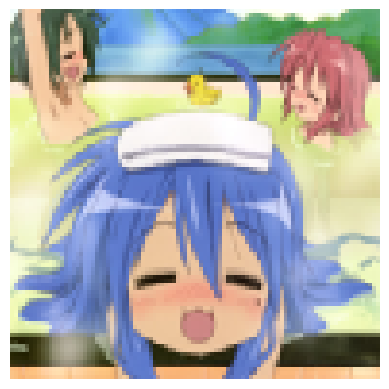

Label verdadera: Konata Izumi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 34ms/step
> Konata Izumi-Lucky Star : 98.42 % confianza.
> Cirno-Touhou : 0.20 % confianza.
> Nia Teppelin-Gurrenn Lagann : 0.15 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 0.06 % confianza.
> Kagami Hiiragi-Lucky Star : 0.06 % confianza.


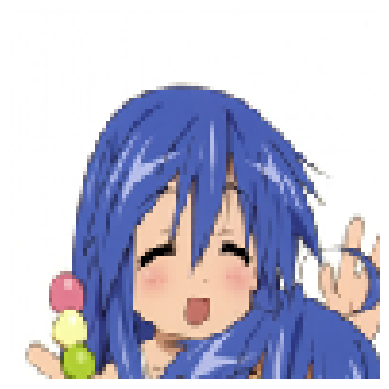

Label verdadera: Konata Izumi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 41ms/step
> Konata Izumi-Lucky Star : 90.89 % confianza.
> Sakura Matou-Fate : 0.84 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.65 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.51 % confianza.
> Suzaku Kururugi-Code Geass : 0.48 % confianza.


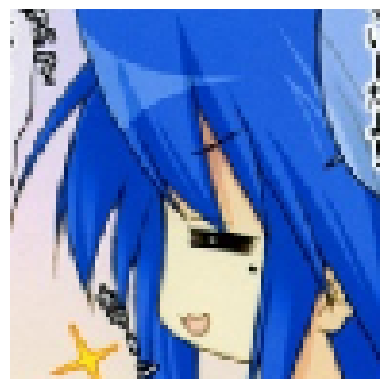

Label verdadera: Konata Izumi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 39ms/step
> Konata Izumi-Lucky Star : 97.44 % confianza.
> Cirno-Touhou : 0.35 % confianza.
> Ouro Kronii-Hololive : 0.19 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.13 % confianza.
> Reimu Hakurei-Touhou : 0.11 % confianza.


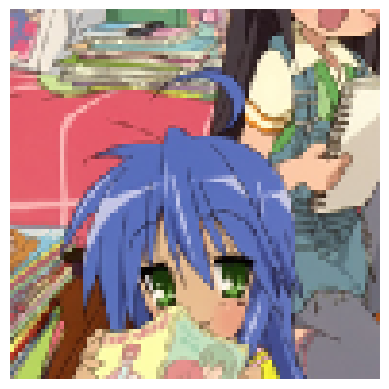

Label verdadera: Konata Izumi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Konata Izumi-Lucky Star : 92.78 % confianza.
> Reimu Hakurei-Touhou : 1.19 % confianza.
> Cirno-Touhou : 1.15 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 0.44 % confianza.
> Sakuya Izayoi-Touhou : 0.33 % confianza.


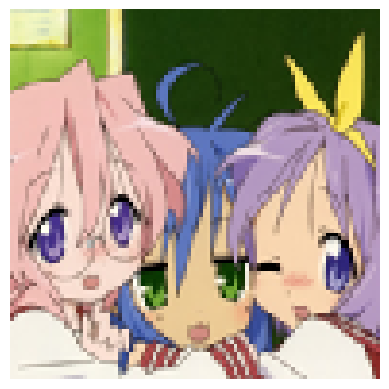

Label verdadera: Konata Izumi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Kagami Hiiragi-Lucky Star : 98.22 % confianza.
> Kotobuki Tsumugi-K ON! : 0.32 % confianza.
> Nia Teppelin-Gurrenn Lagann : 0.11 % confianza.
> Aisaka Taiga-Toradora : 0.10 % confianza.
> Konata Izumi-Lucky Star : 0.08 % confianza.


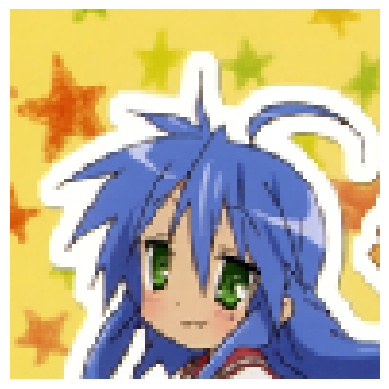

Label verdadera: Konata Izumi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Konata Izumi-Lucky Star : 98.80 % confianza.
> Aegis-Persona : 0.08 % confianza.
> Nia Teppelin-Gurrenn Lagann : 0.08 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.07 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 0.06 % confianza.


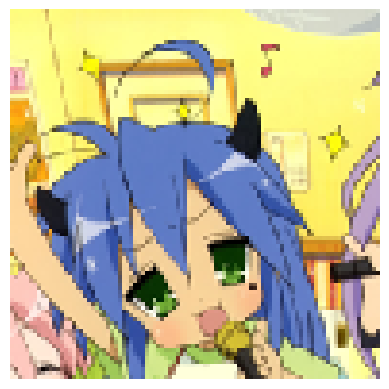

Label verdadera: Konata Izumi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Konata Izumi-Lucky Star : 98.95 % confianza.
> Kagami Hiiragi-Lucky Star : 0.10 % confianza.
> Nia Teppelin-Gurrenn Lagann : 0.07 % confianza.
> Maka Albarn-Soul Eater : 0.06 % confianza.
> Sakura Matou-Fate : 0.05 % confianza.


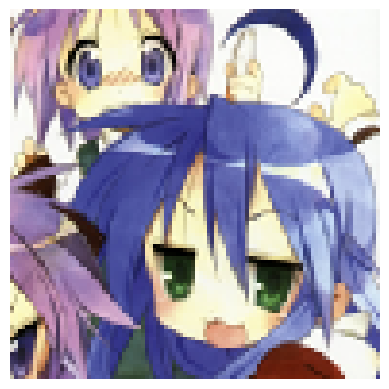

Label verdadera: Konata Izumi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Konata Izumi-Lucky Star : 95.12 % confianza.
> Kagami Hiiragi-Lucky Star : 0.66 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.35 % confianza.
> Cirno-Touhou : 0.34 % confianza.
> Sakura Matou-Fate : 0.29 % confianza.


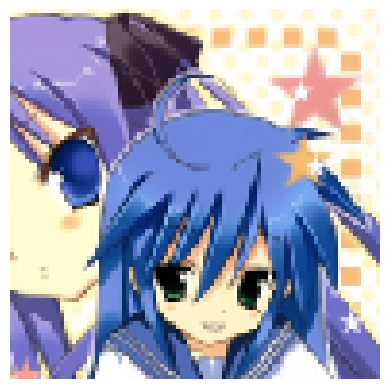

Label verdadera: Konata Izumi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Konata Izumi-Lucky Star : 96.89 % confianza.
> Sakuya Izayoi-Touhou : 0.73 % confianza.
> Cirno-Touhou : 0.46 % confianza.
> Kagami Hiiragi-Lucky Star : 0.29 % confianza.
> Sakura Matou-Fate : 0.17 % confianza.


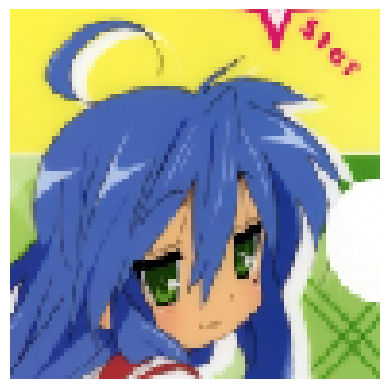

Label verdadera: Konata Izumi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Konata Izumi-Lucky Star : 98.42 % confianza.
> Reimu Hakurei-Touhou : 0.09 % confianza.
> Suzaku Kururugi-Code Geass : 0.09 % confianza.
> Maka Albarn-Soul Eater : 0.07 % confianza.
> Aegis-Persona : 0.07 % confianza.


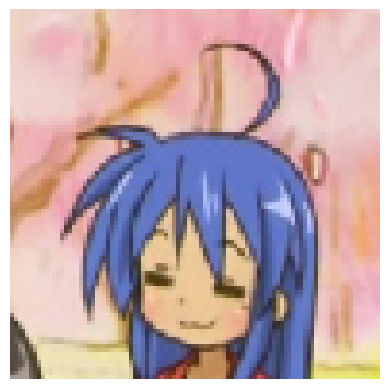

Label verdadera: Konata Izumi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Konata Izumi-Lucky Star : 98.70 % confianza.
> Sakura Matou-Fate : 0.27 % confianza.
> Kagami Hiiragi-Lucky Star : 0.14 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.04 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.04 % confianza.


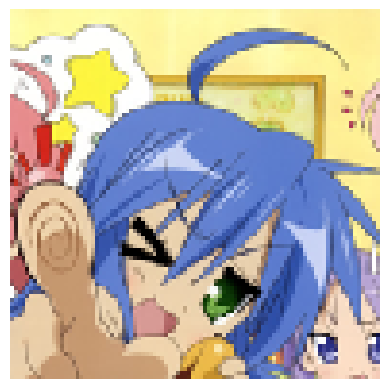

Label verdadera: Konata Izumi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Konata Izumi-Lucky Star : 97.94 % confianza.
> Nia Teppelin-Gurrenn Lagann : 0.16 % confianza.
> Aegis-Persona : 0.12 % confianza.
> Maka Albarn-Soul Eater : 0.10 % confianza.
> Suzaku Kururugi-Code Geass : 0.10 % confianza.


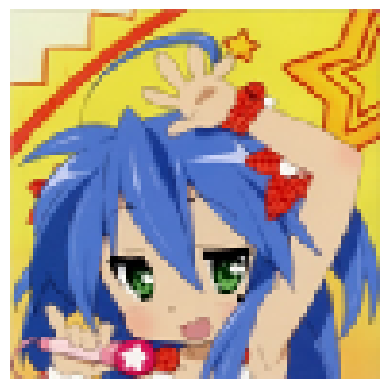

Label verdadera: Konata Izumi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Konata Izumi-Lucky Star : 93.28 % confianza.
> Nia Teppelin-Gurrenn Lagann : 0.79 % confianza.
> Aegis-Persona : 0.27 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.23 % confianza.
> Maka Albarn-Soul Eater : 0.23 % confianza.


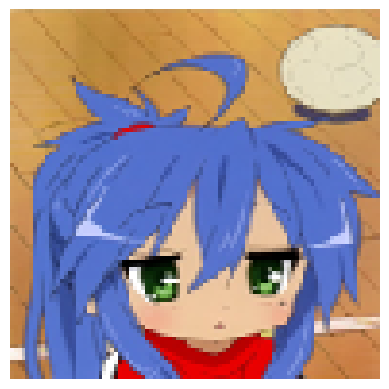

Label verdadera: Konata Izumi-Lucky Star
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Konata Izumi-Lucky Star : 99.61 % confianza.
> Cirno-Touhou : 0.05 % confianza.
> Maka Albarn-Soul Eater : 0.03 % confianza.
> Suzaku Kururugi-Code Geass : 0.02 % confianza.
> Sakura Matou-Fate : 0.02 % confianza.


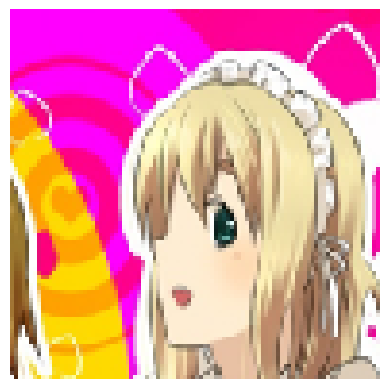

Label verdadera: Kotobuki Tsumugi-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Saber-Fate : 38.62 % confianza.
> Kotobuki Tsumugi-K ON! : 38.32 % confianza.
> Maka Albarn-Soul Eater : 3.25 % confianza.
> C.C-Code Geass : 1.84 % confianza.
> Flandre Scarlet-Touhou : 1.62 % confianza.


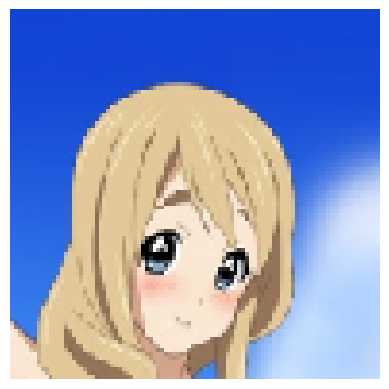

Label verdadera: Kotobuki Tsumugi-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 35ms/step
> Kotobuki Tsumugi-K ON! : 98.37 % confianza.
> Ritsu Tainaka-K ON! : 0.44 % confianza.
> Saber-Fate : 0.17 % confianza.
> C.C-Code Geass : 0.07 % confianza.
> Illyasviel Von Einzbern-Fate : 0.06 % confianza.


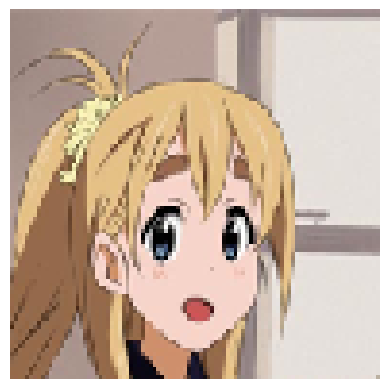

Label verdadera: Kotobuki Tsumugi-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Kotobuki Tsumugi-K ON! : 97.97 % confianza.
> Aisaka Taiga-Toradora : 0.48 % confianza.
> Saber-Fate : 0.28 % confianza.
> Ritsu Tainaka-K ON! : 0.17 % confianza.
> Flandre Scarlet-Touhou : 0.09 % confianza.


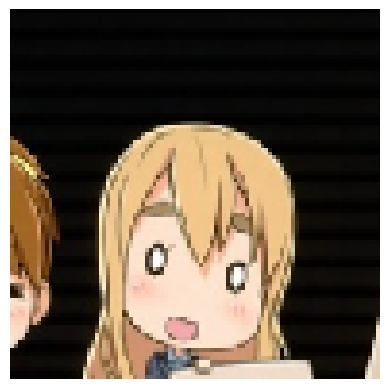

Label verdadera: Kotobuki Tsumugi-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Kotobuki Tsumugi-K ON! : 98.01 % confianza.
> Nezuko Kamado-Demon Slayer : 0.23 % confianza.
> Shinobu Kochou-Demon Slayer : 0.16 % confianza.
> Hinata Hyuuga-Naruto : 0.15 % confianza.
> Maki Nishikino-Love Live : 0.14 % confianza.


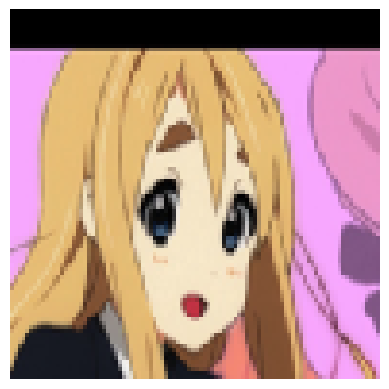

Label verdadera: Kotobuki Tsumugi-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Kotobuki Tsumugi-K ON! : 99.39 % confianza.
> Ritsu Tainaka-K ON! : 0.31 % confianza.
> Aisaka Taiga-Toradora : 0.03 % confianza.
> Asuna Yuuki-Sword Art Online : 0.02 % confianza.
> Yui Hirasawa-K ON! : 0.02 % confianza.


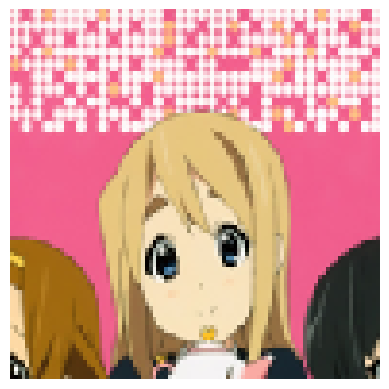

Label verdadera: Kotobuki Tsumugi-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Kotobuki Tsumugi-K ON! : 93.30 % confianza.
> Maka Albarn-Soul Eater : 1.17 % confianza.
> C.C-Code Geass : 0.92 % confianza.
> Ritsu Tainaka-K ON! : 0.74 % confianza.
> Shinobu Kochou-Demon Slayer : 0.39 % confianza.


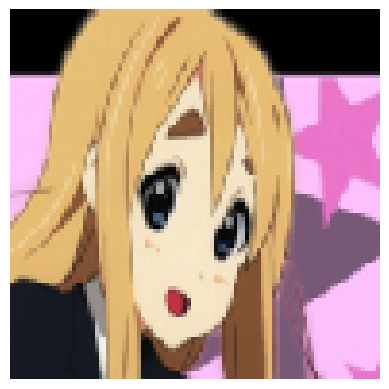

Label verdadera: Kotobuki Tsumugi-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Kotobuki Tsumugi-K ON! : 99.22 % confianza.
> Ritsu Tainaka-K ON! : 0.33 % confianza.
> Aisaka Taiga-Toradora : 0.08 % confianza.
> Yui Hirasawa-K ON! : 0.04 % confianza.
> Asuna Yuuki-Sword Art Online : 0.03 % confianza.


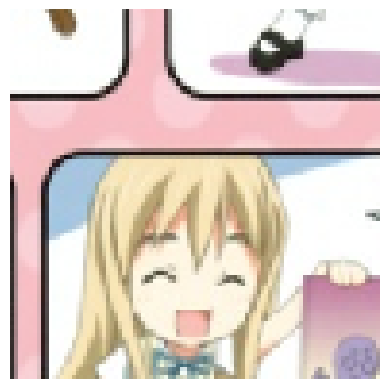

Label verdadera: Kotobuki Tsumugi-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Kotobuki Tsumugi-K ON! : 79.94 % confianza.
> Illyasviel Von Einzbern-Fate : 4.47 % confianza.
> Arcueid Brunestud-Tsukihime : 3.81 % confianza.
> Flandre Scarlet-Touhou : 2.26 % confianza.
> Saber-Fate : 1.52 % confianza.


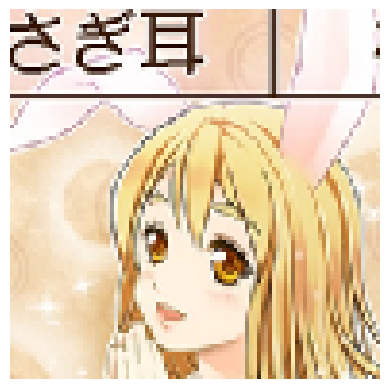

Label verdadera: Kotobuki Tsumugi-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Arcueid Brunestud-Tsukihime : 73.34 % confianza.
> Illyasviel Von Einzbern-Fate : 8.86 % confianza.
> Flandre Scarlet-Touhou : 3.89 % confianza.
> Asuna Yuuki-Sword Art Online : 2.32 % confianza.
> Kotobuki Tsumugi-K ON! : 1.21 % confianza.


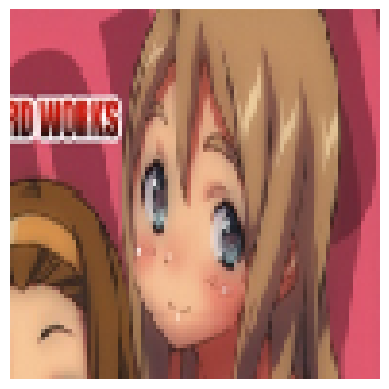

Label verdadera: Kotobuki Tsumugi-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Saber-Fate : 43.50 % confianza.
> Kotobuki Tsumugi-K ON! : 19.51 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 9.18 % confianza.
> Flandre Scarlet-Touhou : 5.26 % confianza.
> Aegis-Persona : 4.90 % confianza.


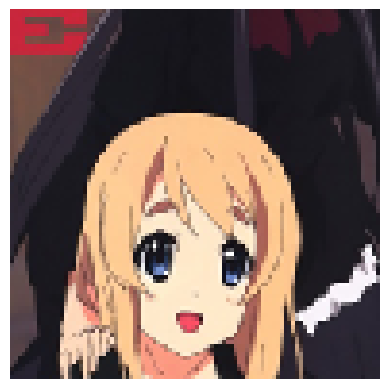

Label verdadera: Kotobuki Tsumugi-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Kotobuki Tsumugi-K ON! : 98.48 % confianza.
> Maka Albarn-Soul Eater : 0.16 % confianza.
> Shinobu Kochou-Demon Slayer : 0.09 % confianza.
> Ritsu Tainaka-K ON! : 0.08 % confianza.
> Aisaka Taiga-Toradora : 0.08 % confianza.


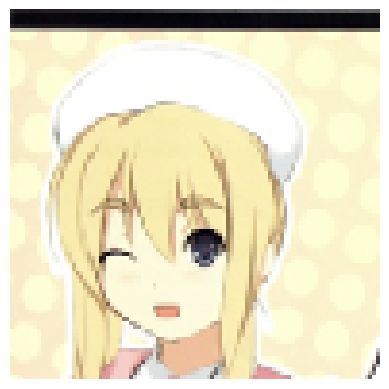

Label verdadera: Kotobuki Tsumugi-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Kotobuki Tsumugi-K ON! : 94.16 % confianza.
> Maka Albarn-Soul Eater : 0.60 % confianza.
> Aisaka Taiga-Toradora : 0.50 % confianza.
> Sakuya Izayoi-Touhou : 0.45 % confianza.
> C.C-Code Geass : 0.43 % confianza.


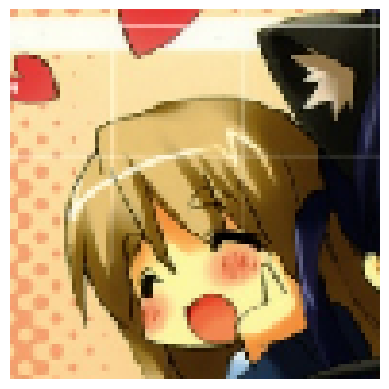

Label verdadera: Kotobuki Tsumugi-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Saber-Fate : 68.99 % confianza.
> Suzaku Kururugi-Code Geass : 7.59 % confianza.
> Arcueid Brunestud-Tsukihime : 4.59 % confianza.
> Flandre Scarlet-Touhou : 2.52 % confianza.
> Maka Albarn-Soul Eater : 1.42 % confianza.


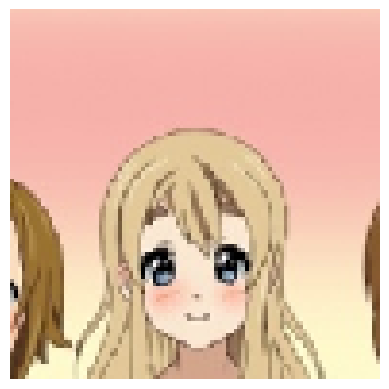

Label verdadera: Kotobuki Tsumugi-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Kotobuki Tsumugi-K ON! : 98.68 % confianza.
> Aisaka Taiga-Toradora : 0.11 % confianza.
> C.C-Code Geass : 0.08 % confianza.
> Ritsu Tainaka-K ON! : 0.07 % confianza.
> Asuna Yuuki-Sword Art Online : 0.07 % confianza.


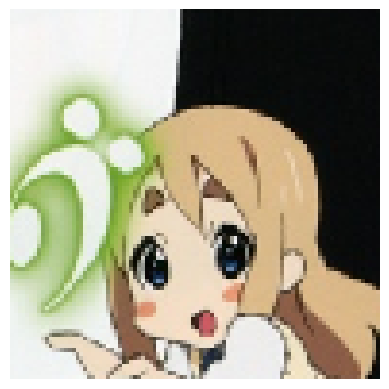

Label verdadera: Kotobuki Tsumugi-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Kotobuki Tsumugi-K ON! : 98.43 % confianza.
> Ritsu Tainaka-K ON! : 0.63 % confianza.
> Maka Albarn-Soul Eater : 0.16 % confianza.
> Paimon-Genshin Impact : 0.10 % confianza.
> Illyasviel Von Einzbern-Fate : 0.08 % confianza.


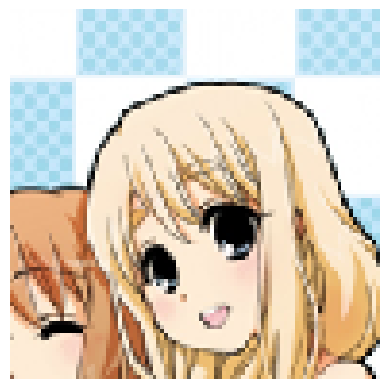

Label verdadera: Kotobuki Tsumugi-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Kotobuki Tsumugi-K ON! : 93.72 % confianza.
> Saber-Fate : 2.02 % confianza.
> Arcueid Brunestud-Tsukihime : 0.80 % confianza.
> Ritsu Tainaka-K ON! : 0.44 % confianza.
> Sakuya Izayoi-Touhou : 0.31 % confianza.


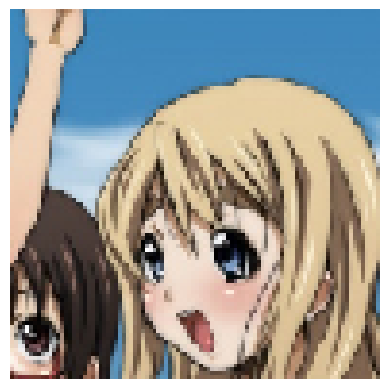

Label verdadera: Kotobuki Tsumugi-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Kotobuki Tsumugi-K ON! : 71.55 % confianza.
> Aisaka Taiga-Toradora : 6.65 % confianza.
> Arcueid Brunestud-Tsukihime : 3.95 % confianza.
> Saber-Fate : 2.84 % confianza.
> Flandre Scarlet-Touhou : 1.56 % confianza.


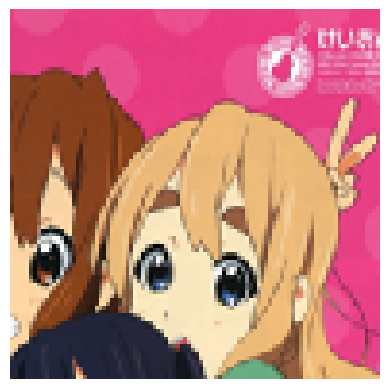

Label verdadera: Kotobuki Tsumugi-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Kotobuki Tsumugi-K ON! : 96.77 % confianza.
> Aisaka Taiga-Toradora : 0.39 % confianza.
> Yui Hirasawa-K ON! : 0.36 % confianza.
> Ritsu Tainaka-K ON! : 0.28 % confianza.
> Maka Albarn-Soul Eater : 0.19 % confianza.


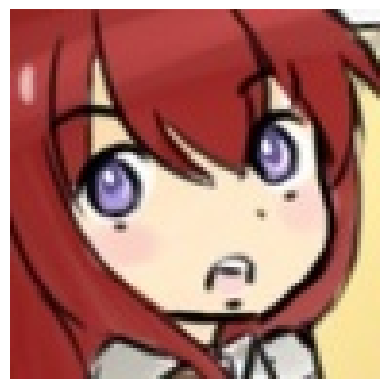

Label verdadera: Kurisu Makise-Steins Gate
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Maki Nishikino-Love Live : 77.53 % confianza.
> Kallen Stadtfeld-Code Geass : 4.83 % confianza.
> Shinobu Kochou-Demon Slayer : 2.44 % confianza.
> Kurisu Makise-Steins Gate : 1.89 % confianza.
> Nezuko Kamado-Demon Slayer : 1.14 % confianza.


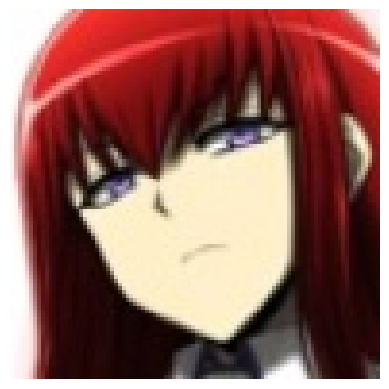

Label verdadera: Kurisu Makise-Steins Gate
Este personaje posiblemente es:
1/1 [==============================] - 0s 33ms/step
> Kurisu Makise-Steins Gate : 58.14 % confianza.
> Maki Nishikino-Love Live : 18.31 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 3.81 % confianza.
> Megumin-Konosuba : 1.96 % confianza.
> Ram-Re Zero : 1.59 % confianza.


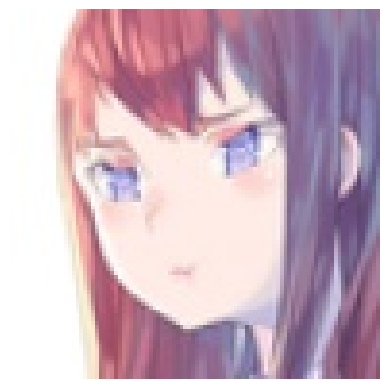

Label verdadera: Kurisu Makise-Steins Gate
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Nino Nakano-Quintessential Quintuplets : 53.30 % confianza.
> Hifumi Takimoto-New Game! : 13.01 % confianza.
> Miku Nakano-Quintessential Quintuplets : 8.36 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 5.24 % confianza.
> Maki Nishikino-Love Live : 2.03 % confianza.


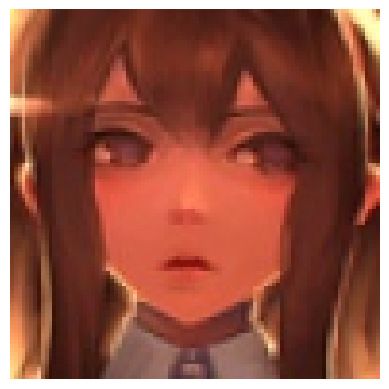

Label verdadera: Kurisu Makise-Steins Gate
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Fubuki-One Punch Man : 43.94 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 12.35 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 9.80 % confianza.
> Megumin-Konosuba : 5.12 % confianza.
> Kurisu Makise-Steins Gate : 4.45 % confianza.


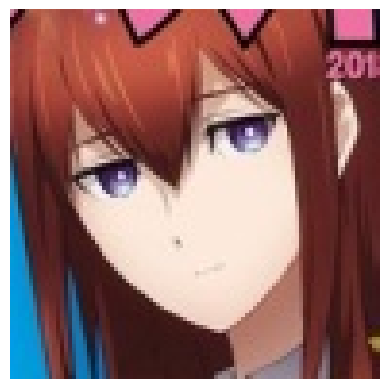

Label verdadera: Kurisu Makise-Steins Gate
Este personaje posiblemente es:
1/1 [==============================] - 0s 38ms/step
> Kurisu Makise-Steins Gate : 71.91 % confianza.
> Maki Nishikino-Love Live : 23.93 % confianza.
> Miku Nakano-Quintessential Quintuplets : 0.37 % confianza.
> Shinobu Kochou-Demon Slayer : 0.20 % confianza.
> Kallen Stadtfeld-Code Geass : 0.20 % confianza.


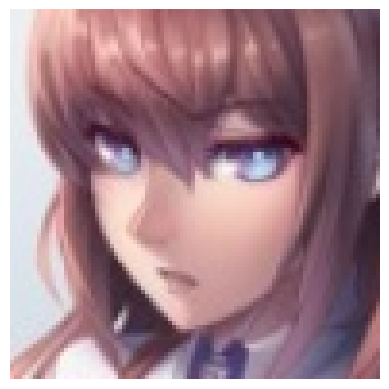

Label verdadera: Kurisu Makise-Steins Gate
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 36.77 % confianza.
> Kurisu Makise-Steins Gate : 28.89 % confianza.
> Miku Nakano-Quintessential Quintuplets : 22.75 % confianza.
> Astolfo-Fate : 2.96 % confianza.
> Emilia-Re Zero : 1.65 % confianza.


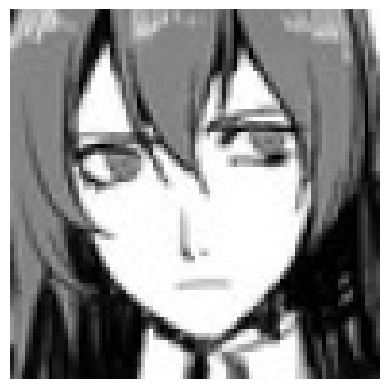

Label verdadera: Kurisu Makise-Steins Gate
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Kirito-Sword Art Online : 38.24 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 5.43 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 5.23 % confianza.
> Shouko Komi-Komi Cant Communicate : 4.16 % confianza.
> Megumin-Konosuba : 3.83 % confianza.


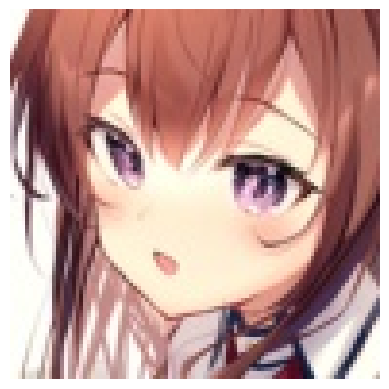

Label verdadera: Kurisu Makise-Steins Gate
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Maki Nishikino-Love Live : 54.09 % confianza.
> Kurisu Makise-Steins Gate : 24.01 % confianza.
> Astolfo-Fate : 3.12 % confianza.
> Shirley Fenette-Code Geass : 2.59 % confianza.
> Asuna Yuuki-Sword Art Online : 1.59 % confianza.


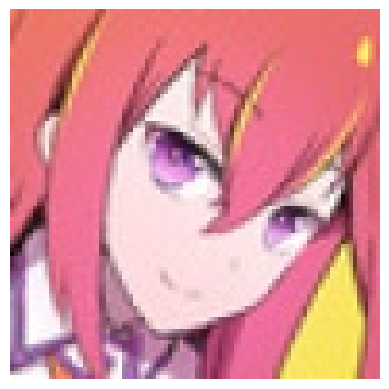

Label verdadera: Kurisu Makise-Steins Gate
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Maki Nishikino-Love Live : 91.13 % confianza.
> Kallen Stadtfeld-Code Geass : 1.96 % confianza.
> Kurisu Makise-Steins Gate : 0.71 % confianza.
> Asuna Yuuki-Sword Art Online : 0.57 % confianza.
> Ram-Re Zero : 0.56 % confianza.


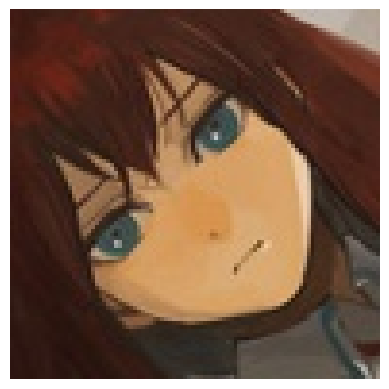

Label verdadera: Kurisu Makise-Steins Gate
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Kurisu Makise-Steins Gate : 88.45 % confianza.
> Hifumi Takimoto-New Game! : 3.60 % confianza.
> Hinata Hyuuga-Naruto : 0.98 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.54 % confianza.
> Aegis-Persona : 0.54 % confianza.


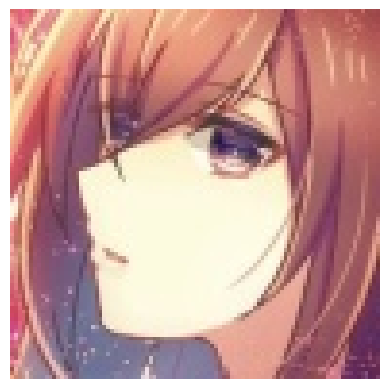

Label verdadera: Kurisu Makise-Steins Gate
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Maki Nishikino-Love Live : 82.79 % confianza.
> Kurisu Makise-Steins Gate : 5.07 % confianza.
> Asuna Yuuki-Sword Art Online : 3.04 % confianza.
> Raphtalia-Rising of the Shield Hero : 1.63 % confianza.
> Astolfo-Fate : 0.75 % confianza.


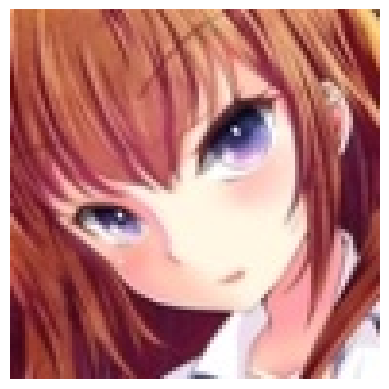

Label verdadera: Kurisu Makise-Steins Gate
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Kurisu Makise-Steins Gate : 38.93 % confianza.
> Aegis-Persona : 11.29 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 11.26 % confianza.
> Maki Nishikino-Love Live : 10.43 % confianza.
> Amelia Watson-Hololive : 3.30 % confianza.


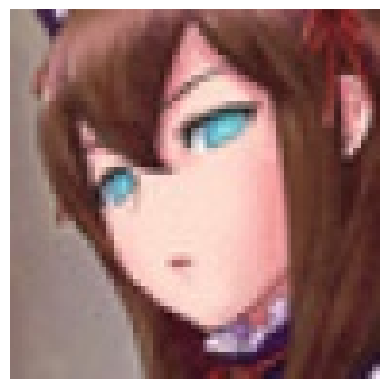

Label verdadera: Kurisu Makise-Steins Gate
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Kurisu Makise-Steins Gate : 94.20 % confianza.
> Miku Nakano-Quintessential Quintuplets : 1.94 % confianza.
> Hifumi Takimoto-New Game! : 0.79 % confianza.
> Megumin-Konosuba : 0.73 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.50 % confianza.


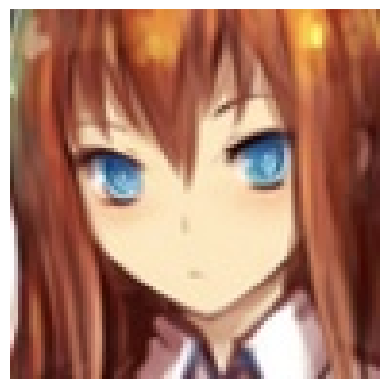

Label verdadera: Kurisu Makise-Steins Gate
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Kurisu Makise-Steins Gate : 88.57 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 1.99 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 1.77 % confianza.
> Miku Nakano-Quintessential Quintuplets : 1.52 % confianza.
> Hifumi Takimoto-New Game! : 1.29 % confianza.


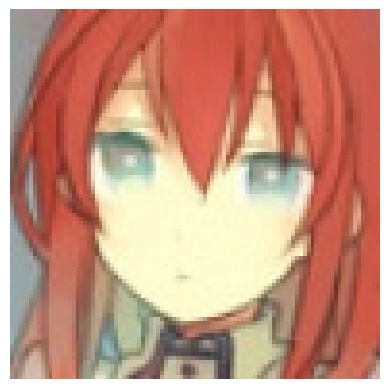

Label verdadera: Kurisu Makise-Steins Gate
Este personaje posiblemente es:
1/1 [==============================] - 0s 35ms/step
> Kurisu Makise-Steins Gate : 90.63 % confianza.
> Maki Nishikino-Love Live : 5.31 % confianza.
> Miku Nakano-Quintessential Quintuplets : 1.60 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 0.40 % confianza.
> Kallen Stadtfeld-Code Geass : 0.21 % confianza.


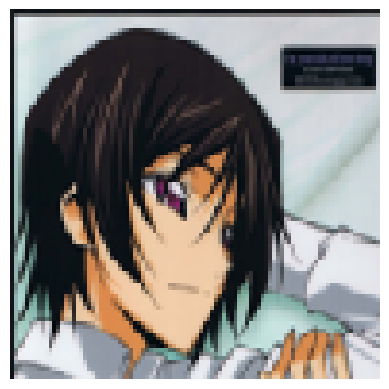

Label verdadera: Lelouch Lamperouge-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Lelouch Lamperouge-Code Geass : 97.47 % confianza.
> Albedo-Overlord : 0.38 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.15 % confianza.
> Suzaku Kururugi-Code Geass : 0.15 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.13 % confianza.


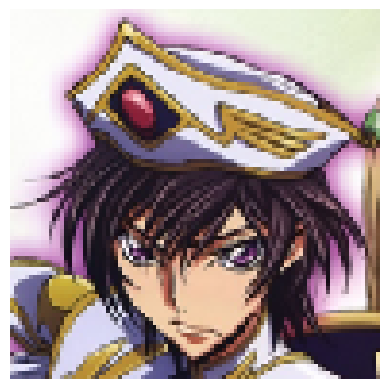

Label verdadera: Lelouch Lamperouge-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Lelouch Lamperouge-Code Geass : 91.78 % confianza.
> Suzaku Kururugi-Code Geass : 0.73 % confianza.
> C.C-Code Geass : 0.73 % confianza.
> Sakura Matou-Fate : 0.34 % confianza.
> Fubuki-One Punch Man : 0.29 % confianza.


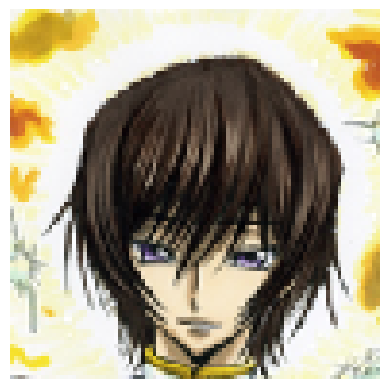

Label verdadera: Lelouch Lamperouge-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Lelouch Lamperouge-Code Geass : 71.91 % confianza.
> Suzaku Kururugi-Code Geass : 19.41 % confianza.
> Shirley Fenette-Code Geass : 0.48 % confianza.
> Gawr Gura-Hololive : 0.34 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.33 % confianza.


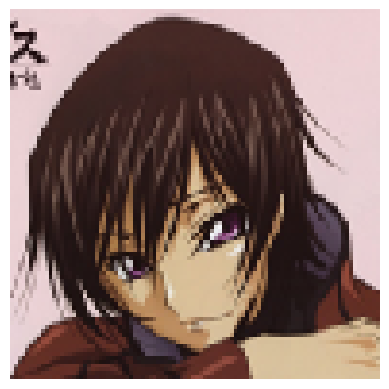

Label verdadera: Lelouch Lamperouge-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Lelouch Lamperouge-Code Geass : 98.08 % confianza.
> Suzaku Kururugi-Code Geass : 0.82 % confianza.
> Shinobu Kochou-Demon Slayer : 0.09 % confianza.
> Keqing-Genshin Impact : 0.05 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.05 % confianza.


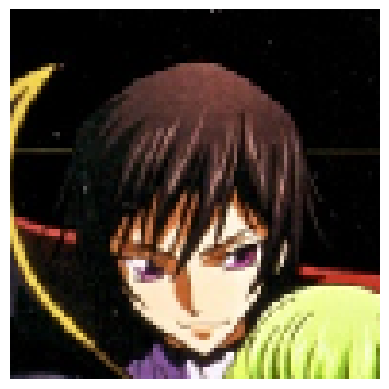

Label verdadera: Lelouch Lamperouge-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Lelouch Lamperouge-Code Geass : 74.63 % confianza.
> Reimu Hakurei-Touhou : 6.98 % confianza.
> Suzaku Kururugi-Code Geass : 3.02 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 1.33 % confianza.
> Fubuki-One Punch Man : 0.67 % confianza.


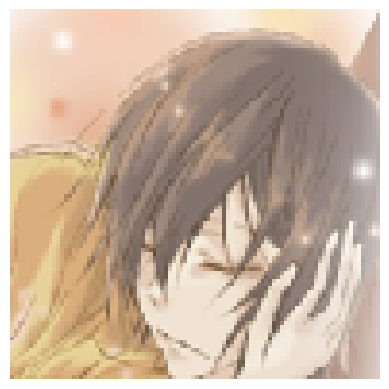

Label verdadera: Lelouch Lamperouge-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Reimu Hakurei-Touhou : 60.77 % confianza.
> Lelouch Lamperouge-Code Geass : 10.98 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 7.32 % confianza.
> Sakuya Izayoi-Touhou : 1.92 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 1.85 % confianza.


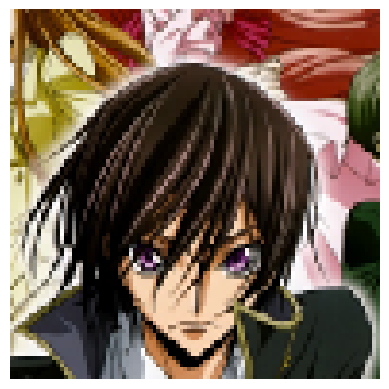

Label verdadera: Lelouch Lamperouge-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Lelouch Lamperouge-Code Geass : 79.04 % confianza.
> Suzaku Kururugi-Code Geass : 14.20 % confianza.
> Reimu Hakurei-Touhou : 1.30 % confianza.
> Fubuki-One Punch Man : 0.48 % confianza.
> Emilia-Re Zero : 0.30 % confianza.


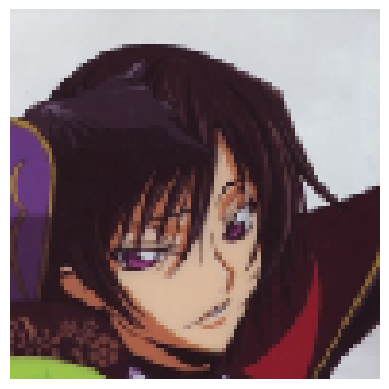

Label verdadera: Lelouch Lamperouge-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Lelouch Lamperouge-Code Geass : 97.94 % confianza.
> Illyasviel Von Einzbern-Fate : 0.13 % confianza.
> Nezuko Kamado-Demon Slayer : 0.13 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.11 % confianza.
> Fubuki-One Punch Man : 0.09 % confianza.


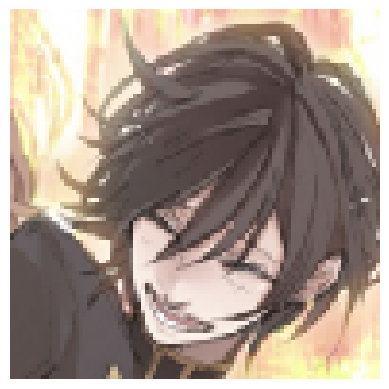

Label verdadera: Lelouch Lamperouge-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Lelouch Lamperouge-Code Geass : 91.85 % confianza.
> Suzaku Kururugi-Code Geass : 2.28 % confianza.
> Reimu Hakurei-Touhou : 1.59 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.54 % confianza.
> Shinobu Kochou-Demon Slayer : 0.40 % confianza.


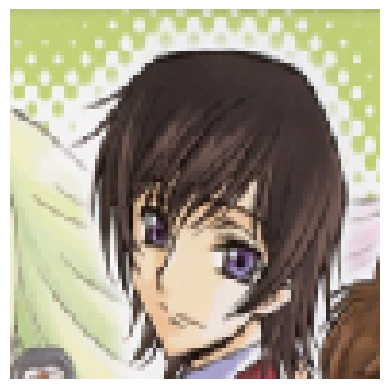

Label verdadera: Lelouch Lamperouge-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Lelouch Lamperouge-Code Geass : 98.65 % confianza.
> Suzaku Kururugi-Code Geass : 0.16 % confianza.
> Sakuya Izayoi-Touhou : 0.09 % confianza.
> Illyasviel Von Einzbern-Fate : 0.08 % confianza.
> Emilia-Re Zero : 0.07 % confianza.


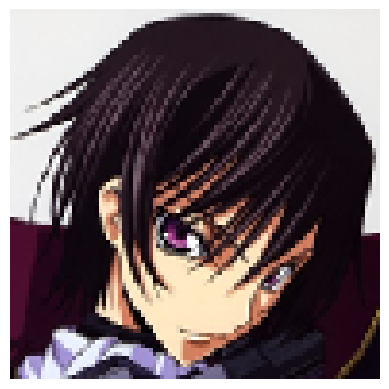

Label verdadera: Lelouch Lamperouge-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Lelouch Lamperouge-Code Geass : 96.60 % confianza.
> Suzaku Kururugi-Code Geass : 0.30 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.21 % confianza.
> Illyasviel Von Einzbern-Fate : 0.14 % confianza.
> C.C-Code Geass : 0.12 % confianza.


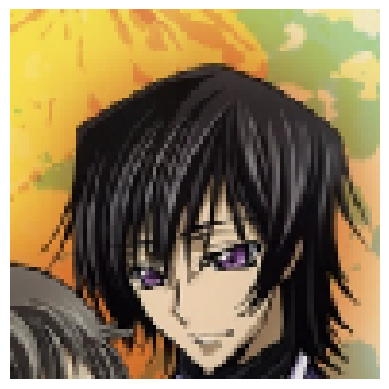

Label verdadera: Lelouch Lamperouge-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Lelouch Lamperouge-Code Geass : 98.59 % confianza.
> Suzaku Kururugi-Code Geass : 0.39 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.05 % confianza.
> Emilia-Re Zero : 0.04 % confianza.
> Keqing-Genshin Impact : 0.04 % confianza.


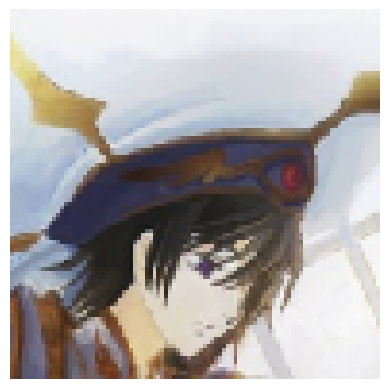

Label verdadera: Lelouch Lamperouge-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Lelouch Lamperouge-Code Geass : 79.82 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 5.53 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 2.82 % confianza.
> Suzaku Kururugi-Code Geass : 2.09 % confianza.
> Shiki Ryougi-Garden of Sinners : 1.33 % confianza.


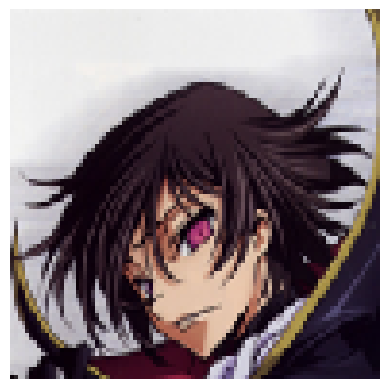

Label verdadera: Lelouch Lamperouge-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Lelouch Lamperouge-Code Geass : 97.03 % confianza.
> Illyasviel Von Einzbern-Fate : 0.32 % confianza.
> Albedo-Overlord : 0.15 % confianza.
> Fubuki-One Punch Man : 0.15 % confianza.
> Keqing-Genshin Impact : 0.14 % confianza.


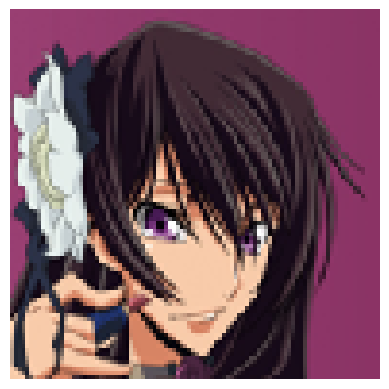

Label verdadera: Lelouch Lamperouge-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 22ms/step
> Lelouch Lamperouge-Code Geass : 99.43 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.04 % confianza.
> Suzaku Kururugi-Code Geass : 0.04 % confianza.
> Illyasviel Von Einzbern-Fate : 0.03 % confianza.
> C.C-Code Geass : 0.03 % confianza.


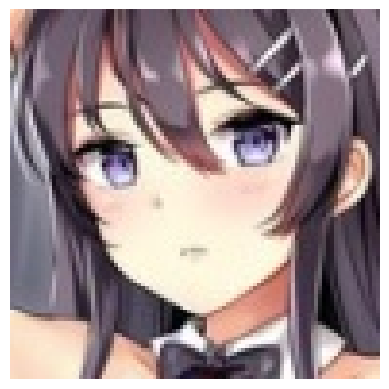

Label verdadera: Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 97.38 % confianza.
> Kirito-Sword Art Online : 1.15 % confianza.
> Megumin-Konosuba : 0.38 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.17 % confianza.
> Astolfo-Fate : 0.16 % confianza.


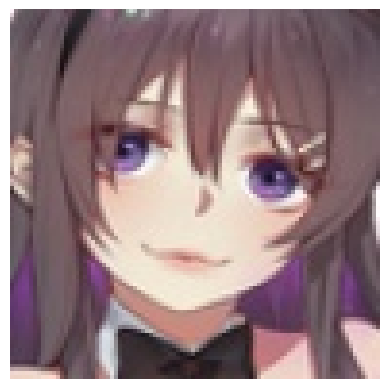

Label verdadera: Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 97.00 % confianza.
> Megumin-Konosuba : 1.06 % confianza.
> Keqing-Genshin Impact : 0.19 % confianza.
> Kirito-Sword Art Online : 0.17 % confianza.
> Hifumi Takimoto-New Game! : 0.16 % confianza.


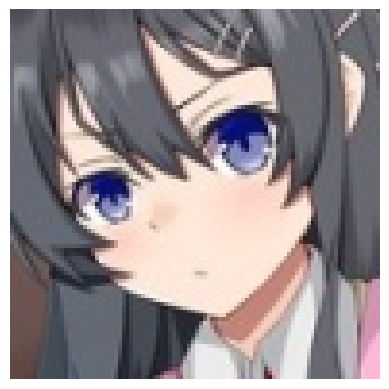

Label verdadera: Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 97.47 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.67 % confianza.
> Kirito-Sword Art Online : 0.30 % confianza.
> Kurisu Makise-Steins Gate : 0.19 % confianza.
> Megumin-Konosuba : 0.15 % confianza.


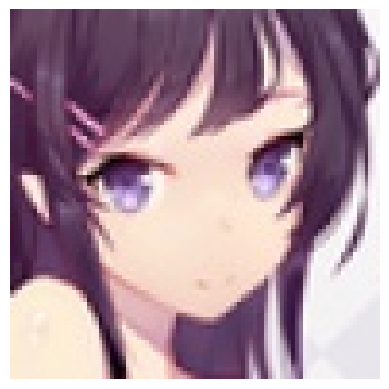

Label verdadera: Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Shinobu Kochou-Demon Slayer : 50.46 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 28.52 % confianza.
> Hifumi Takimoto-New Game! : 3.40 % confianza.
> Kirito-Sword Art Online : 1.53 % confianza.
> Keqing-Genshin Impact : 1.36 % confianza.


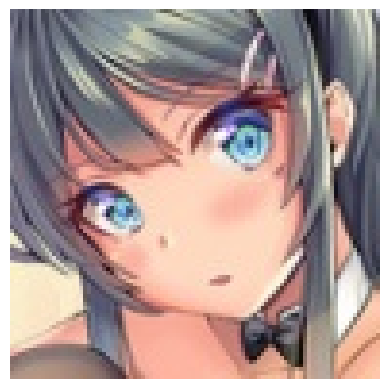

Label verdadera: Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Sinon-Sword Art Online : 50.21 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 27.61 % confianza.
> Aegis-Persona : 4.46 % confianza.
> Ouro Kronii-Hololive : 4.11 % confianza.
> Fubuki-One Punch Man : 2.06 % confianza.


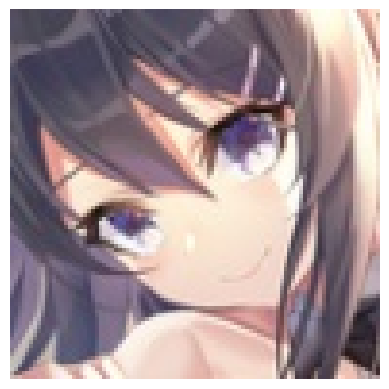

Label verdadera: Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai
Este personaje posiblemente es:
1/1 [==============================] - 0s 22ms/step
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 88.95 % confianza.
> Kirito-Sword Art Online : 2.65 % confianza.
> Megumin-Konosuba : 1.57 % confianza.
> Keqing-Genshin Impact : 1.34 % confianza.
> Lelouch Lamperouge-Code Geass : 1.31 % confianza.


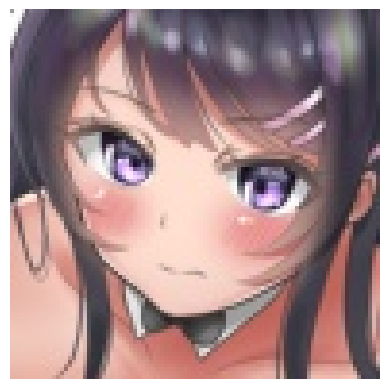

Label verdadera: Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 74.43 % confianza.
> Megumin-Konosuba : 3.53 % confianza.
> Shinobu Kochou-Demon Slayer : 2.55 % confianza.
> Kirito-Sword Art Online : 1.96 % confianza.
> Lelouch Lamperouge-Code Geass : 1.90 % confianza.


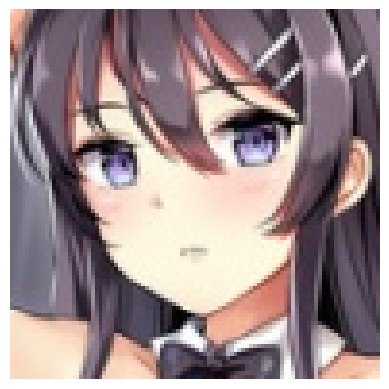

Label verdadera: Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai
Este personaje posiblemente es:
1/1 [==============================] - 0s 39ms/step
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 97.56 % confianza.
> Kirito-Sword Art Online : 0.74 % confianza.
> Megumin-Konosuba : 0.59 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.19 % confianza.
> Astolfo-Fate : 0.15 % confianza.


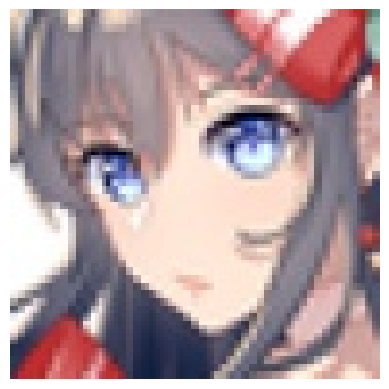

Label verdadera: Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai
Este personaje posiblemente es:
1/1 [==============================] - 0s 42ms/step
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 96.11 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.69 % confianza.
> Miku Nakano-Quintessential Quintuplets : 0.56 % confianza.
> Kurisu Makise-Steins Gate : 0.41 % confianza.
> Hifumi Takimoto-New Game! : 0.37 % confianza.


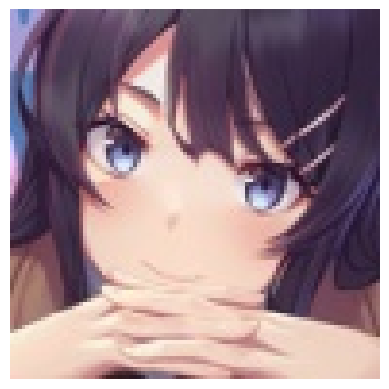

Label verdadera: Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 78.77 % confianza.
> Shinobu Kochou-Demon Slayer : 4.35 % confianza.
> Shouko Komi-Komi Cant Communicate : 4.08 % confianza.
> Hifumi Takimoto-New Game! : 2.40 % confianza.
> Kirito-Sword Art Online : 1.49 % confianza.


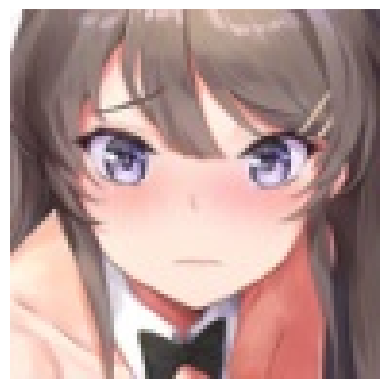

Label verdadera: Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai
Este personaje posiblemente es:
1/1 [==============================] - 0s 41ms/step
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 98.10 % confianza.
> Kurisu Makise-Steins Gate : 0.28 % confianza.
> Megumin-Konosuba : 0.21 % confianza.
> Shouko Komi-Komi Cant Communicate : 0.18 % confianza.
> Hifumi Takimoto-New Game! : 0.17 % confianza.


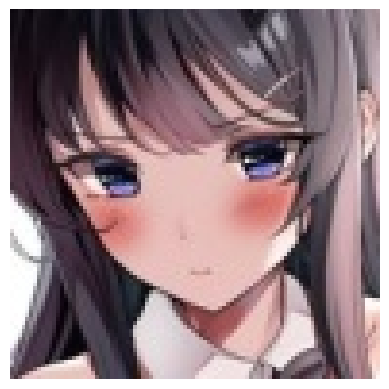

Label verdadera: Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai
Este personaje posiblemente es:
1/1 [==============================] - 0s 33ms/step
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 18.65 % confianza.
> Ouro Kronii-Hololive : 11.29 % confianza.
> Hifumi Takimoto-New Game! : 10.95 % confianza.
> Shouko Komi-Komi Cant Communicate : 7.97 % confianza.
> Fubuki-One Punch Man : 6.30 % confianza.


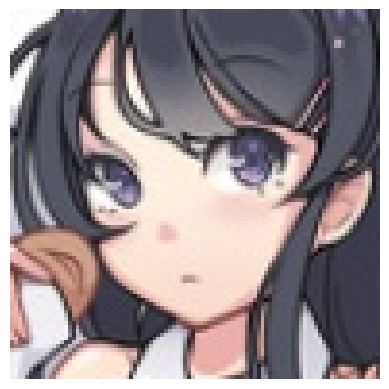

Label verdadera: Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 75.99 % confianza.
> Kirito-Sword Art Online : 15.38 % confianza.
> Shinobu Kochou-Demon Slayer : 2.80 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 1.90 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.70 % confianza.


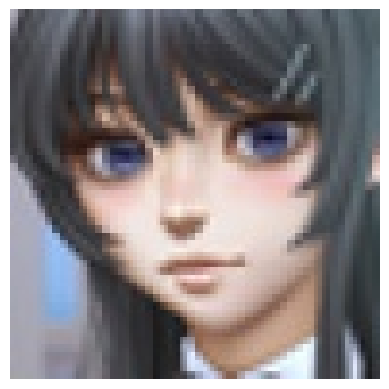

Label verdadera: Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai
Este personaje posiblemente es:
1/1 [==============================] - 0s 48ms/step
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 64.28 % confianza.
> Ouro Kronii-Hololive : 6.49 % confianza.
> Hinata Hyuuga-Naruto : 3.58 % confianza.
> Fubuki-One Punch Man : 3.43 % confianza.
> Lelouch Lamperouge-Code Geass : 2.52 % confianza.


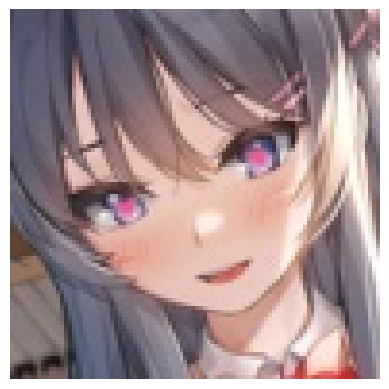

Label verdadera: Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Keqing-Genshin Impact : 66.60 % confianza.
> Ouro Kronii-Hololive : 7.93 % confianza.
> Megumin-Konosuba : 3.08 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 2.36 % confianza.
> Raphtalia-Rising of the Shield Hero : 2.00 % confianza.


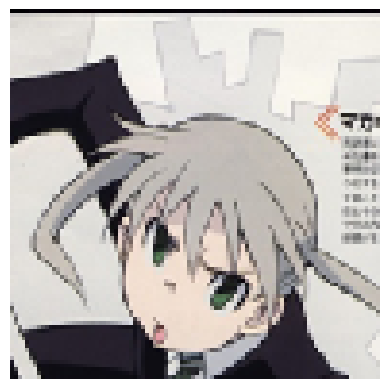

Label verdadera: Maka Albarn-Soul Eater
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Maka Albarn-Soul Eater : 99.52 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.12 % confianza.
> Fubuki-One Punch Man : 0.05 % confianza.
> Cirno-Touhou : 0.04 % confianza.
> Illyasviel Von Einzbern-Fate : 0.02 % confianza.


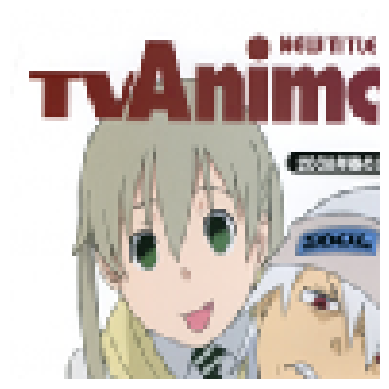

Label verdadera: Maka Albarn-Soul Eater
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Maka Albarn-Soul Eater : 95.67 % confianza.
> Konata Izumi-Lucky Star : 0.60 % confianza.
> Cirno-Touhou : 0.35 % confianza.
> Hatsune Miku-Vocaloid : 0.21 % confianza.
> Shirley Fenette-Code Geass : 0.19 % confianza.


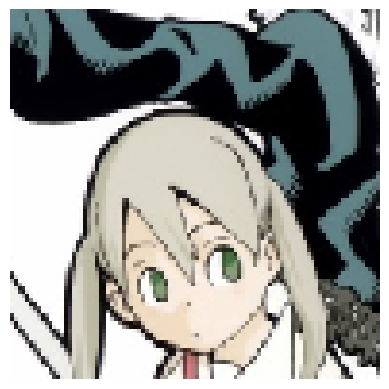

Label verdadera: Maka Albarn-Soul Eater
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Maka Albarn-Soul Eater : 99.18 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.25 % confianza.
> Cirno-Touhou : 0.10 % confianza.
> Nico Robin-One Piece : 0.08 % confianza.
> Fubuki-One Punch Man : 0.05 % confianza.


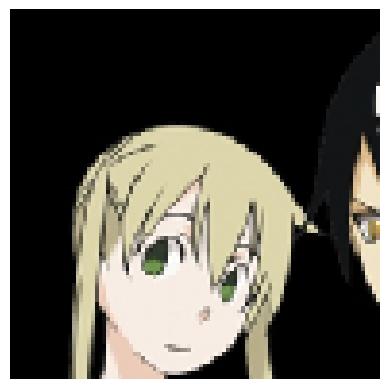

Label verdadera: Maka Albarn-Soul Eater
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Maka Albarn-Soul Eater : 90.20 % confianza.
> Kotobuki Tsumugi-K ON! : 1.94 % confianza.
> Illyasviel Von Einzbern-Fate : 0.83 % confianza.
> C.C-Code Geass : 0.55 % confianza.
> Maki Nishikino-Love Live : 0.43 % confianza.


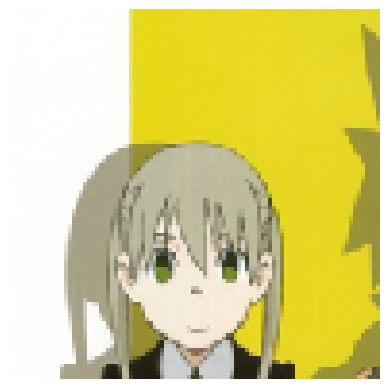

Label verdadera: Maka Albarn-Soul Eater
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Maka Albarn-Soul Eater : 90.21 % confianza.
> Ritsu Tainaka-K ON! : 1.30 % confianza.
> C.C-Code Geass : 0.90 % confianza.
> Illyasviel Von Einzbern-Fate : 0.88 % confianza.
> Kotobuki Tsumugi-K ON! : 0.87 % confianza.


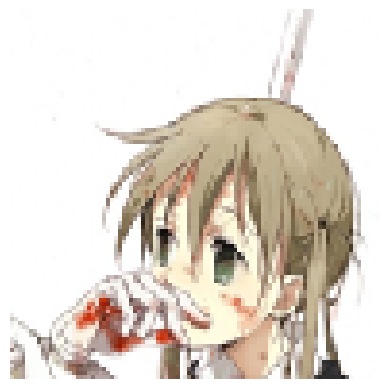

Label verdadera: Maka Albarn-Soul Eater
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Arcueid Brunestud-Tsukihime : 12.34 % confianza.
> Flandre Scarlet-Touhou : 7.61 % confianza.
> Sakuya Izayoi-Touhou : 6.93 % confianza.
> Aisaka Taiga-Toradora : 6.78 % confianza.
> Reimu Hakurei-Touhou : 6.17 % confianza.


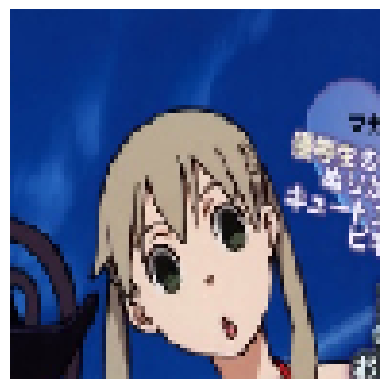

Label verdadera: Maka Albarn-Soul Eater
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Maka Albarn-Soul Eater : 89.69 % confianza.
> Kotobuki Tsumugi-K ON! : 1.99 % confianza.
> Illyasviel Von Einzbern-Fate : 1.15 % confianza.
> Saber-Fate : 0.90 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.52 % confianza.


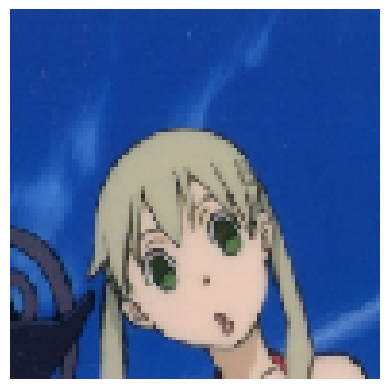

Label verdadera: Maka Albarn-Soul Eater
Este personaje posiblemente es:
1/1 [==============================] - 0s 44ms/step
> Maka Albarn-Soul Eater : 90.67 % confianza.
> Saber-Fate : 0.88 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.83 % confianza.
> Nozomi Tojo-Love Live : 0.45 % confianza.
> Kotobuki Tsumugi-K ON! : 0.43 % confianza.


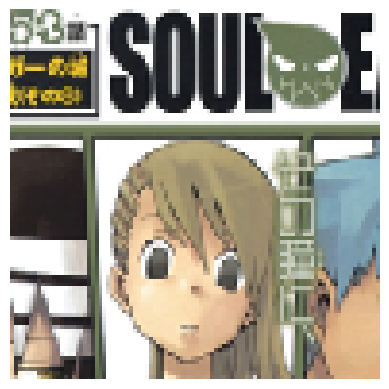

Label verdadera: Maka Albarn-Soul Eater
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Maka Albarn-Soul Eater : 94.66 % confianza.
> Suzaku Kururugi-Code Geass : 0.51 % confianza.
> Aisaka Taiga-Toradora : 0.49 % confianza.
> Yui Hirasawa-K ON! : 0.42 % confianza.
> Kotobuki Tsumugi-K ON! : 0.31 % confianza.


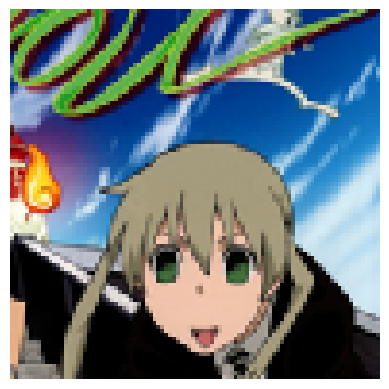

Label verdadera: Maka Albarn-Soul Eater
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Maka Albarn-Soul Eater : 98.22 % confianza.
> Konata Izumi-Lucky Star : 0.17 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.15 % confianza.
> Saber-Fate : 0.09 % confianza.
> Fubuki-One Punch Man : 0.09 % confianza.


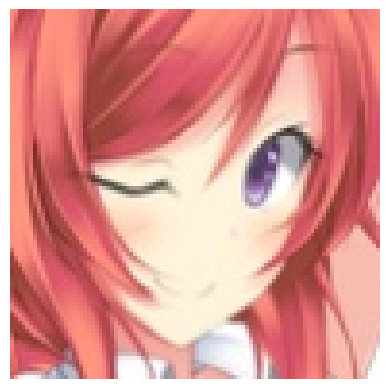

Label verdadera: Maki Nishikino-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Maki Nishikino-Love Live : 99.05 % confianza.
> Kurisu Makise-Steins Gate : 0.18 % confianza.
> Asuna Yuuki-Sword Art Online : 0.13 % confianza.
> Miku Nakano-Quintessential Quintuplets : 0.08 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 0.07 % confianza.


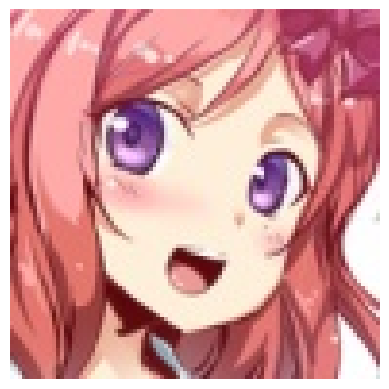

Label verdadera: Maki Nishikino-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Maki Nishikino-Love Live : 92.15 % confianza.
> Astolfo-Fate : 3.58 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 1.50 % confianza.
> Nami-One Piece : 0.45 % confianza.
> Shinobu Kochou-Demon Slayer : 0.27 % confianza.


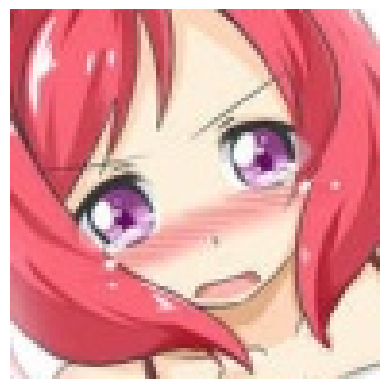

Label verdadera: Maki Nishikino-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Maki Nishikino-Love Live : 77.03 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 4.42 % confianza.
> Kallen Stadtfeld-Code Geass : 2.54 % confianza.
> Yoko Littner-Gurrenn Lagann : 2.02 % confianza.
> Paimon-Genshin Impact : 0.80 % confianza.


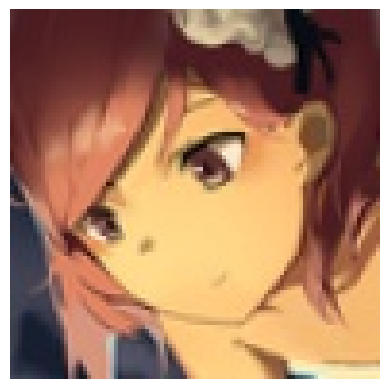

Label verdadera: Maki Nishikino-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 33ms/step
> Misato Katsuragi-Neon Genesis Evangelion : 55.68 % confianza.
> Maki Nishikino-Love Live : 10.63 % confianza.
> Nozomi Tojo-Love Live : 8.09 % confianza.
> Nami-One Piece : 1.97 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 1.70 % confianza.


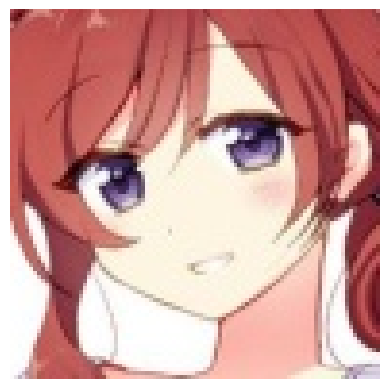

Label verdadera: Maki Nishikino-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Maki Nishikino-Love Live : 95.42 % confianza.
> Kurisu Makise-Steins Gate : 1.97 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 0.30 % confianza.
> Miku Nakano-Quintessential Quintuplets : 0.27 % confianza.
> Asuna Yuuki-Sword Art Online : 0.20 % confianza.


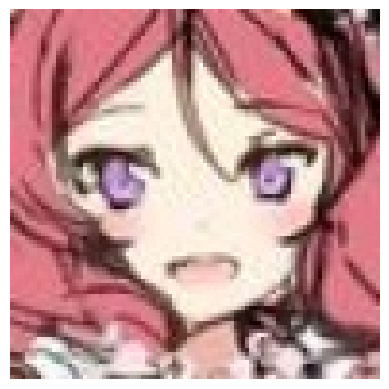

Label verdadera: Maki Nishikino-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Maki Nishikino-Love Live : 81.43 % confianza.
> Astolfo-Fate : 15.94 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.53 % confianza.
> Kurisu Makise-Steins Gate : 0.36 % confianza.
> Shinobu Kochou-Demon Slayer : 0.32 % confianza.


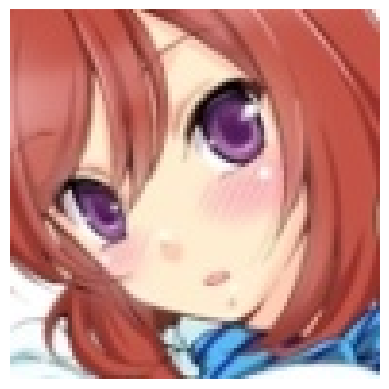

Label verdadera: Maki Nishikino-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Maki Nishikino-Love Live : 96.61 % confianza.
> Kurisu Makise-Steins Gate : 1.25 % confianza.
> Shirley Fenette-Code Geass : 0.24 % confianza.
> Asuna Yuuki-Sword Art Online : 0.21 % confianza.
> C.C-Code Geass : 0.14 % confianza.


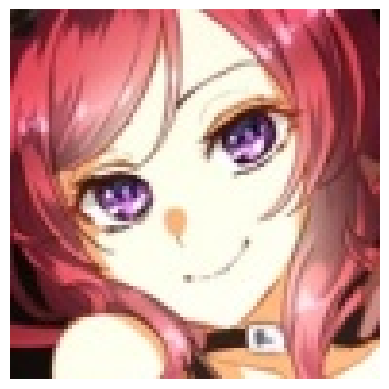

Label verdadera: Maki Nishikino-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Maki Nishikino-Love Live : 90.87 % confianza.
> C.C-Code Geass : 3.22 % confianza.
> Shinobu Kochou-Demon Slayer : 1.15 % confianza.
> Nezuko Kamado-Demon Slayer : 0.87 % confianza.
> Nozomi Tojo-Love Live : 0.41 % confianza.


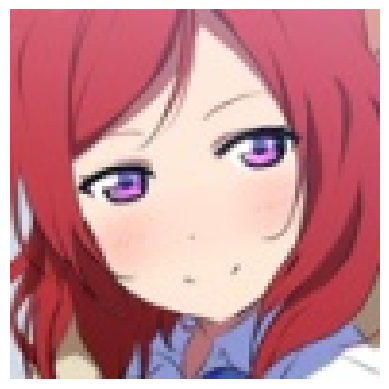

Label verdadera: Maki Nishikino-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Maki Nishikino-Love Live : 84.90 % confianza.
> Kallen Stadtfeld-Code Geass : 1.29 % confianza.
> C.C-Code Geass : 1.11 % confianza.
> Asuna Yuuki-Sword Art Online : 0.94 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.66 % confianza.


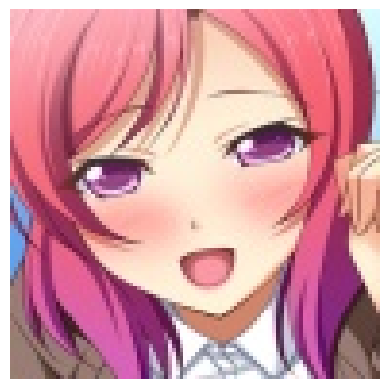

Label verdadera: Maki Nishikino-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Maki Nishikino-Love Live : 74.53 % confianza.
> Astolfo-Fate : 9.04 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 2.75 % confianza.
> Shinobu Kochou-Demon Slayer : 1.22 % confianza.
> Asuna Yuuki-Sword Art Online : 1.11 % confianza.


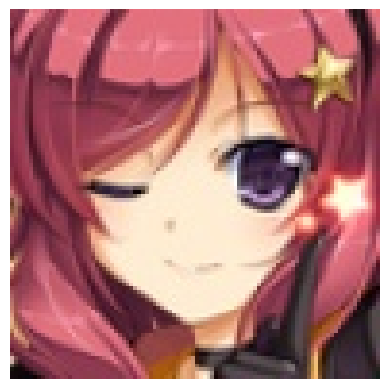

Label verdadera: Maki Nishikino-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Maki Nishikino-Love Live : 81.48 % confianza.
> Nino Nakano-Quintessential Quintuplets : 3.42 % confianza.
> Kurisu Makise-Steins Gate : 1.75 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 1.67 % confianza.
> Kallen Stadtfeld-Code Geass : 1.31 % confianza.


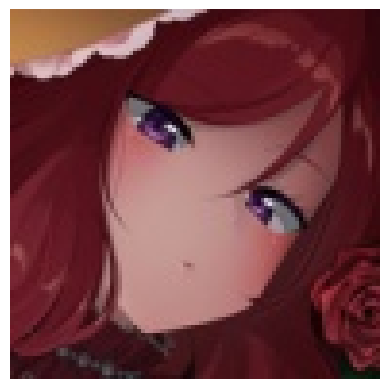

Label verdadera: Maki Nishikino-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 32ms/step
> Kurisu Makise-Steins Gate : 65.16 % confianza.
> Nino Nakano-Quintessential Quintuplets : 19.49 % confianza.
> Hifumi Takimoto-New Game! : 3.70 % confianza.
> Maki Nishikino-Love Live : 2.92 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 0.61 % confianza.


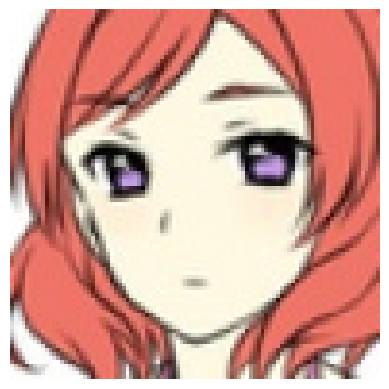

Label verdadera: Maki Nishikino-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Maki Nishikino-Love Live : 98.56 % confianza.
> Asuna Yuuki-Sword Art Online : 0.23 % confianza.
> Kurisu Makise-Steins Gate : 0.11 % confianza.
> Nami-One Piece : 0.10 % confianza.
> C.C-Code Geass : 0.09 % confianza.


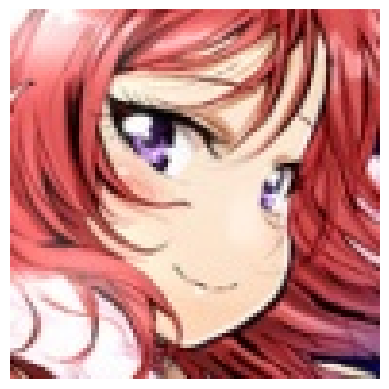

Label verdadera: Maki Nishikino-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 34ms/step
> Maki Nishikino-Love Live : 99.17 % confianza.
> Kurisu Makise-Steins Gate : 0.16 % confianza.
> Asuna Yuuki-Sword Art Online : 0.09 % confianza.
> Astolfo-Fate : 0.09 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.05 % confianza.


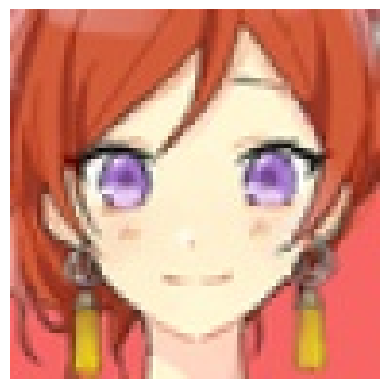

Label verdadera: Maki Nishikino-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Maki Nishikino-Love Live : 98.27 % confianza.
> Nami-One Piece : 0.40 % confianza.
> Asuna Yuuki-Sword Art Online : 0.19 % confianza.
> Kurisu Makise-Steins Gate : 0.13 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 0.11 % confianza.


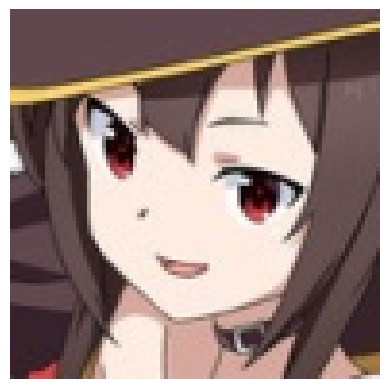

Label verdadera: Megumin-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Megumin-Konosuba : 89.10 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 8.39 % confianza.
> Hifumi Takimoto-New Game! : 0.17 % confianza.
> Albedo-Overlord : 0.17 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.16 % confianza.


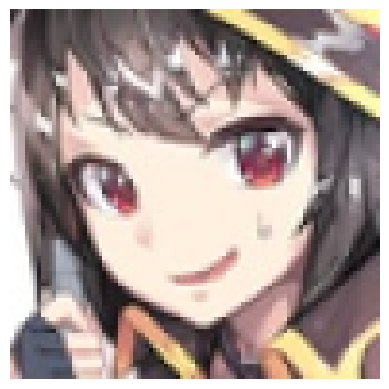

Label verdadera: Megumin-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Megumin-Konosuba : 93.53 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 3.22 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.83 % confianza.
> Raphtalia-Rising of the Shield Hero : 0.38 % confianza.
> Keqing-Genshin Impact : 0.21 % confianza.


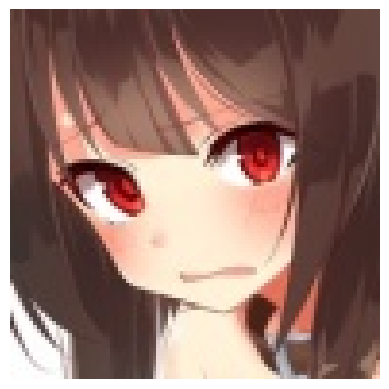

Label verdadera: Megumin-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 36ms/step
> Megumin-Konosuba : 93.34 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 1.19 % confianza.
> Raphtalia-Rising of the Shield Hero : 1.07 % confianza.
> Lelouch Lamperouge-Code Geass : 0.39 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.33 % confianza.


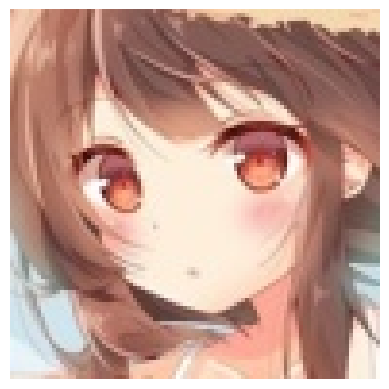

Label verdadera: Megumin-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Megumin-Konosuba : 85.83 % confianza.
> Raphtalia-Rising of the Shield Hero : 4.72 % confianza.
> Asuna Yuuki-Sword Art Online : 2.45 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 1.84 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.50 % confianza.


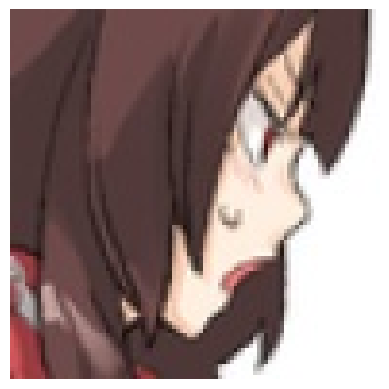

Label verdadera: Megumin-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Albedo-Overlord : 54.90 % confianza.
> Shiki Ryougi-Garden of Sinners : 22.89 % confianza.
> Kirito-Sword Art Online : 5.69 % confianza.
> Kurisu Makise-Steins Gate : 2.01 % confianza.
> Shouko Komi-Komi Cant Communicate : 1.06 % confianza.


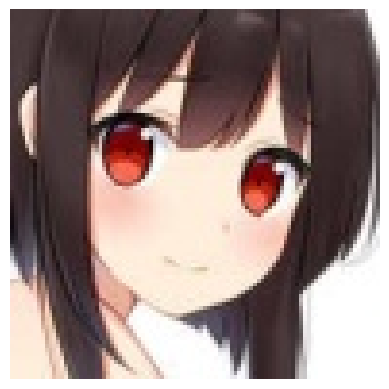

Label verdadera: Megumin-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Megumin-Konosuba : 90.40 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 2.77 % confianza.
> Raphtalia-Rising of the Shield Hero : 0.59 % confianza.
> Albedo-Overlord : 0.53 % confianza.
> Miku Nakano-Quintessential Quintuplets : 0.45 % confianza.


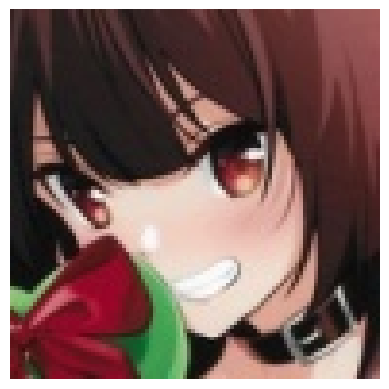

Label verdadera: Megumin-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Megumin-Konosuba : 63.11 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 11.25 % confianza.
> Nezuko Kamado-Demon Slayer : 2.84 % confianza.
> Fubuki-One Punch Man : 2.40 % confianza.
> Shouko Komi-Komi Cant Communicate : 1.71 % confianza.


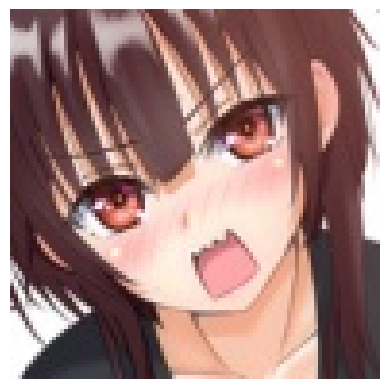

Label verdadera: Megumin-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 35ms/step
> Megumin-Konosuba : 96.25 % confianza.
> Raphtalia-Rising of the Shield Hero : 0.76 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.53 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.29 % confianza.
> Lelouch Lamperouge-Code Geass : 0.21 % confianza.


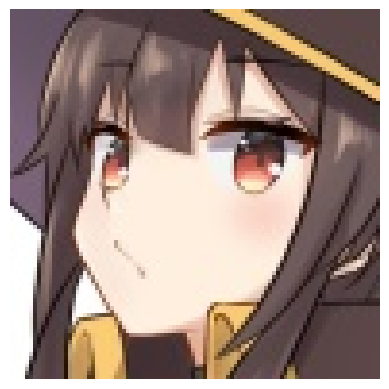

Label verdadera: Megumin-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Megumin-Konosuba : 97.78 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.36 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.32 % confianza.
> Raphtalia-Rising of the Shield Hero : 0.12 % confianza.
> Albedo-Overlord : 0.12 % confianza.


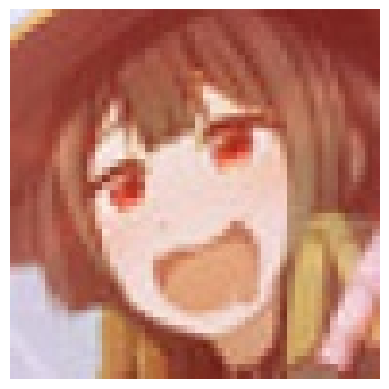

Label verdadera: Megumin-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 41ms/step
> Megumin-Konosuba : 59.52 % confianza.
> Raphtalia-Rising of the Shield Hero : 19.57 % confianza.
> Asuna Yuuki-Sword Art Online : 3.51 % confianza.
> Nami-One Piece : 1.74 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 1.66 % confianza.


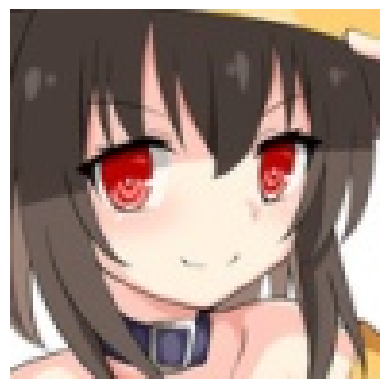

Label verdadera: Megumin-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Megumin-Konosuba : 91.03 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 2.22 % confianza.
> Raphtalia-Rising of the Shield Hero : 0.78 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.68 % confianza.
> Miku Nakano-Quintessential Quintuplets : 0.32 % confianza.


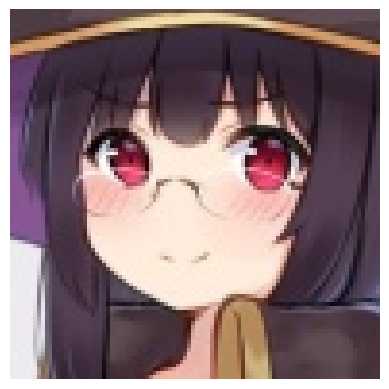

Label verdadera: Megumin-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Megumin-Konosuba : 78.31 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 3.46 % confianza.
> Keqing-Genshin Impact : 1.62 % confianza.
> Raphtalia-Rising of the Shield Hero : 1.46 % confianza.
> Lelouch Lamperouge-Code Geass : 1.44 % confianza.


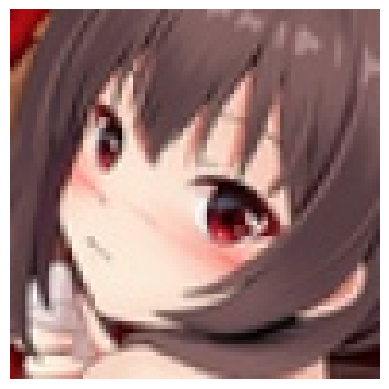

Label verdadera: Megumin-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Megumin-Konosuba : 96.78 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 1.41 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.33 % confianza.
> Keqing-Genshin Impact : 0.22 % confianza.
> Raphtalia-Rising of the Shield Hero : 0.16 % confianza.


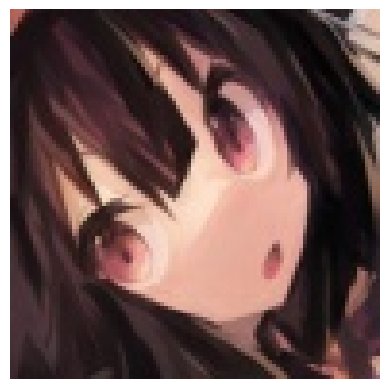

Label verdadera: Megumin-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Megumin-Konosuba : 95.17 % confianza.
> Lelouch Lamperouge-Code Geass : 1.46 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.73 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.55 % confianza.
> Kurisu Makise-Steins Gate : 0.23 % confianza.


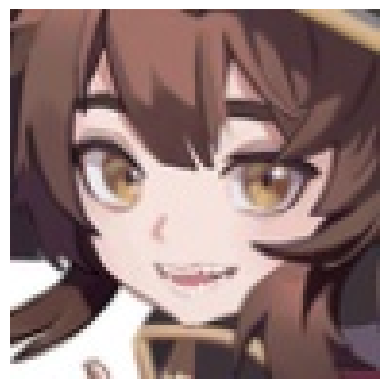

Label verdadera: Megumin-Konosuba
Este personaje posiblemente es:
1/1 [==============================] - 0s 36ms/step
> Megumin-Konosuba : 93.39 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 1.09 % confianza.
> Kirito-Sword Art Online : 0.81 % confianza.
> Raphtalia-Rising of the Shield Hero : 0.80 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.42 % confianza.


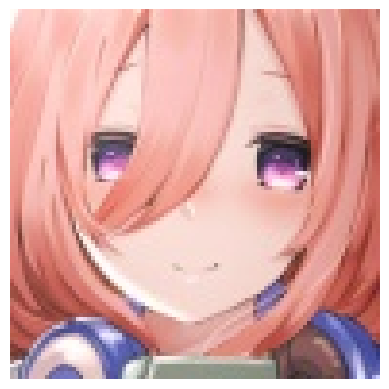

Label verdadera: Miku Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 33ms/step
> Astolfo-Fate : 41.70 % confianza.
> Miku Nakano-Quintessential Quintuplets : 38.27 % confianza.
> Maki Nishikino-Love Live : 5.66 % confianza.
> Zero Two-Darling In the Franxx : 4.21 % confianza.
> Kurisu Makise-Steins Gate : 2.27 % confianza.


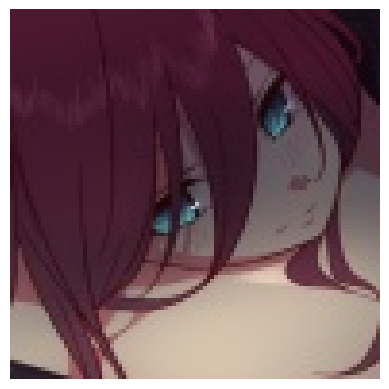

Label verdadera: Miku Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Fubuki-One Punch Man : 57.44 % confianza.
> Kurisu Makise-Steins Gate : 14.37 % confianza.
> Zero Two-Darling In the Franxx : 4.89 % confianza.
> Miku Nakano-Quintessential Quintuplets : 4.74 % confianza.
> Nico Robin-One Piece : 2.47 % confianza.


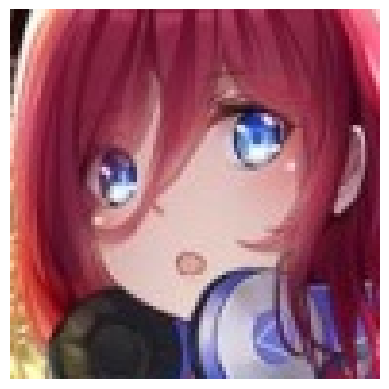

Label verdadera: Miku Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 35ms/step
> Miku Nakano-Quintessential Quintuplets : 51.92 % confianza.
> Kurisu Makise-Steins Gate : 11.57 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 8.86 % confianza.
> Hifumi Takimoto-New Game! : 6.74 % confianza.
> Kallen Stadtfeld-Code Geass : 3.81 % confianza.


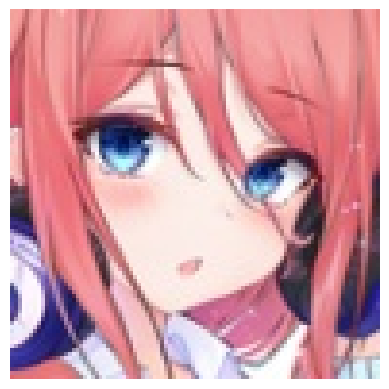

Label verdadera: Miku Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Miku Nakano-Quintessential Quintuplets : 98.61 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.39 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 0.17 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.12 % confianza.
> Kurisu Makise-Steins Gate : 0.12 % confianza.


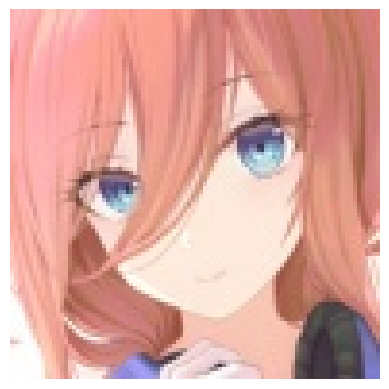

Label verdadera: Miku Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Miku Nakano-Quintessential Quintuplets : 97.61 % confianza.
> Kurisu Makise-Steins Gate : 0.55 % confianza.
> Zero Two-Darling In the Franxx : 0.24 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 0.23 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.18 % confianza.


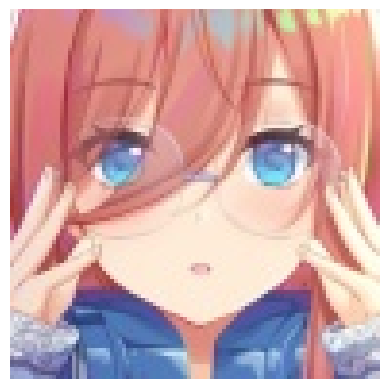

Label verdadera: Miku Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 33ms/step
> Miku Nakano-Quintessential Quintuplets : 93.47 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 3.26 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.76 % confianza.
> Rem-Re Zero : 0.49 % confianza.
> Sinon-Sword Art Online : 0.43 % confianza.


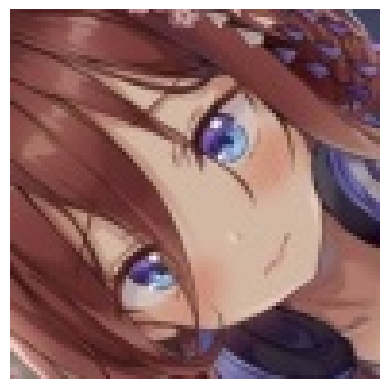

Label verdadera: Miku Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Kurisu Makise-Steins Gate : 59.00 % confianza.
> Miku Nakano-Quintessential Quintuplets : 30.92 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 8.09 % confianza.
> Hifumi Takimoto-New Game! : 0.30 % confianza.
> Megumin-Konosuba : 0.28 % confianza.


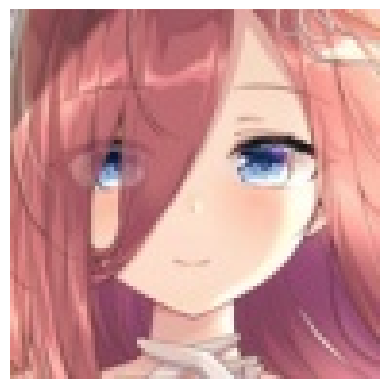

Label verdadera: Miku Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Miku Nakano-Quintessential Quintuplets : 92.33 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 1.90 % confianza.
> Nino Nakano-Quintessential Quintuplets : 1.45 % confianza.
> Kurisu Makise-Steins Gate : 0.70 % confianza.
> Hifumi Takimoto-New Game! : 0.57 % confianza.


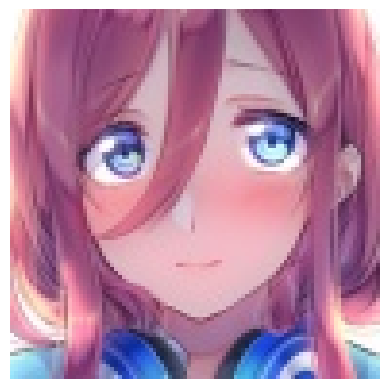

Label verdadera: Miku Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Miku Nakano-Quintessential Quintuplets : 97.19 % confianza.
> Kallen Stadtfeld-Code Geass : 0.46 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.30 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.24 % confianza.
> Kurisu Makise-Steins Gate : 0.24 % confianza.


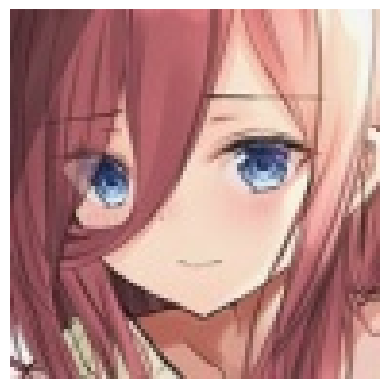

Label verdadera: Miku Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 34ms/step
> Miku Nakano-Quintessential Quintuplets : 87.97 % confianza.
> Kurisu Makise-Steins Gate : 3.91 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 1.29 % confianza.
> Hifumi Takimoto-New Game! : 1.15 % confianza.
> Kallen Stadtfeld-Code Geass : 1.04 % confianza.


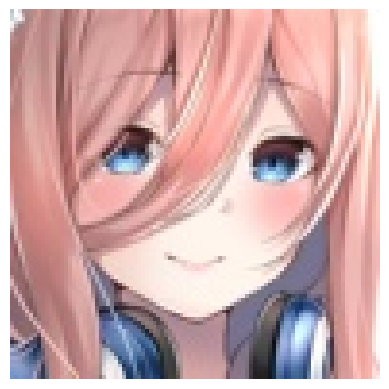

Label verdadera: Miku Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Miku Nakano-Quintessential Quintuplets : 97.90 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.32 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 0.30 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.21 % confianza.
> Astolfo-Fate : 0.15 % confianza.


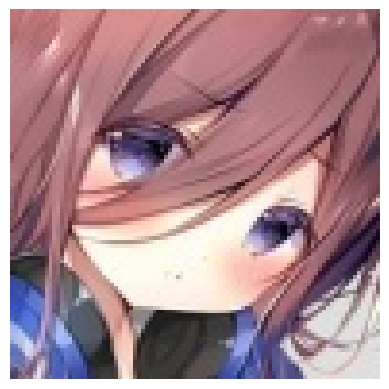

Label verdadera: Miku Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Miku Nakano-Quintessential Quintuplets : 93.87 % confianza.
> Sinon-Sword Art Online : 1.57 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 1.28 % confianza.
> Kurisu Makise-Steins Gate : 1.06 % confianza.
> Astolfo-Fate : 0.91 % confianza.


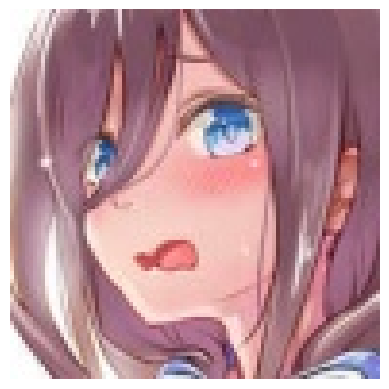

Label verdadera: Miku Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 43ms/step
> Miku Nakano-Quintessential Quintuplets : 89.19 % confianza.
> Hifumi Takimoto-New Game! : 5.75 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 1.26 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.90 % confianza.
> Kurisu Makise-Steins Gate : 0.50 % confianza.


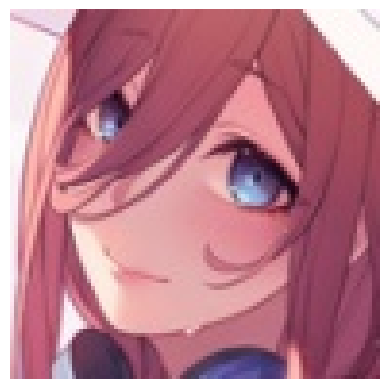

Label verdadera: Miku Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Miku Nakano-Quintessential Quintuplets : 92.39 % confianza.
> Kallen Stadtfeld-Code Geass : 2.58 % confianza.
> Kurisu Makise-Steins Gate : 0.82 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.66 % confianza.
> Hifumi Takimoto-New Game! : 0.42 % confianza.


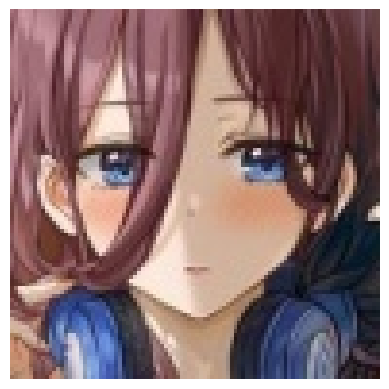

Label verdadera: Miku Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Miku Nakano-Quintessential Quintuplets : 86.42 % confianza.
> Kurisu Makise-Steins Gate : 6.31 % confianza.
> Hifumi Takimoto-New Game! : 0.96 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.74 % confianza.
> Sinon-Sword Art Online : 0.69 % confianza.


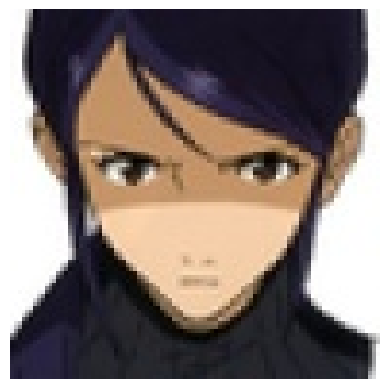

Label verdadera: Misato Katsuragi-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 39ms/step
> Jonathan Joestar-Jojos Bizarre Adventure : 35.71 % confianza.
> Nico Robin-One Piece : 29.45 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 23.30 % confianza.
> Kirito-Sword Art Online : 5.17 % confianza.
> Maka Albarn-Soul Eater : 1.61 % confianza.


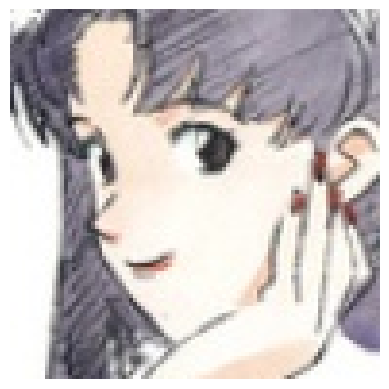

Label verdadera: Misato Katsuragi-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Misato Katsuragi-Neon Genesis Evangelion : 46.96 % confianza.
> Shouko Komi-Komi Cant Communicate : 19.90 % confianza.
> Reimu Hakurei-Touhou : 4.48 % confianza.
> Shinobu Kochou-Demon Slayer : 3.94 % confianza.
> Hifumi Takimoto-New Game! : 2.26 % confianza.


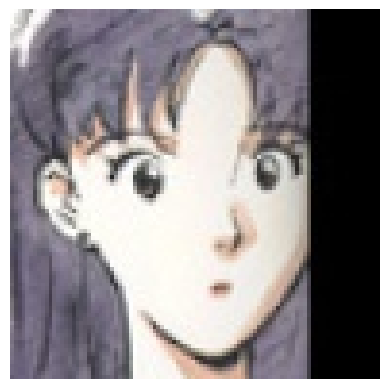

Label verdadera: Misato Katsuragi-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 36ms/step
> Misato Katsuragi-Neon Genesis Evangelion : 79.72 % confianza.
> Shinobu Kochou-Demon Slayer : 2.72 % confianza.
> Maka Albarn-Soul Eater : 2.50 % confianza.
> Sakuya Izayoi-Touhou : 1.79 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 1.71 % confianza.


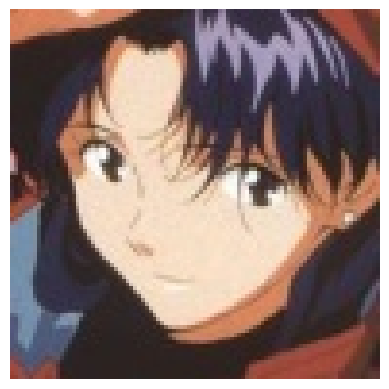

Label verdadera: Misato Katsuragi-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Misato Katsuragi-Neon Genesis Evangelion : 60.33 % confianza.
> Hinata Hyuuga-Naruto : 6.82 % confianza.
> Nico Robin-One Piece : 3.65 % confianza.
> Fubuki-One Punch Man : 2.40 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 2.06 % confianza.


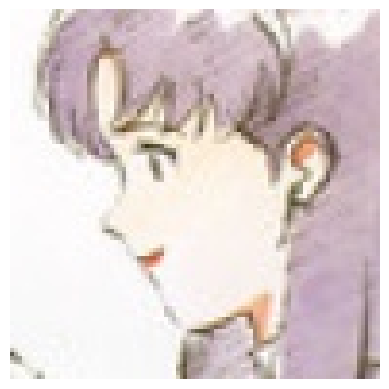

Label verdadera: Misato Katsuragi-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Misato Katsuragi-Neon Genesis Evangelion : 27.51 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 13.99 % confianza.
> Ram-Re Zero : 13.07 % confianza.
> Keqing-Genshin Impact : 6.91 % confianza.
> Shouko Komi-Komi Cant Communicate : 6.68 % confianza.


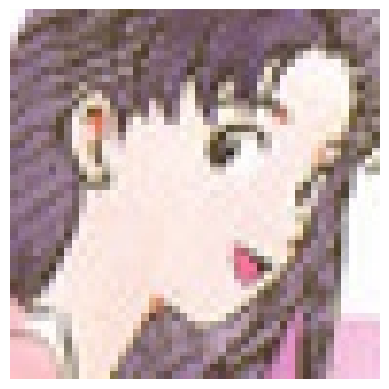

Label verdadera: Misato Katsuragi-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Misato Katsuragi-Neon Genesis Evangelion : 72.39 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 17.52 % confianza.
> Reimu Hakurei-Touhou : 1.46 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 1.15 % confianza.
> Shouko Komi-Komi Cant Communicate : 0.82 % confianza.


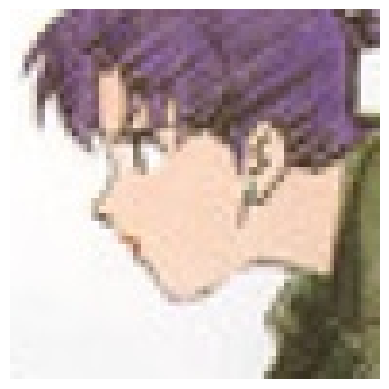

Label verdadera: Misato Katsuragi-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Misato Katsuragi-Neon Genesis Evangelion : 53.28 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 29.13 % confianza.
> Sakura Matou-Fate : 2.19 % confianza.
> Nozomi Tojo-Love Live : 1.80 % confianza.
> Saber-Fate : 1.15 % confianza.


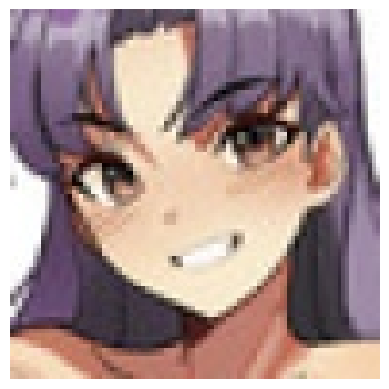

Label verdadera: Misato Katsuragi-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Misato Katsuragi-Neon Genesis Evangelion : 68.30 % confianza.
> Sakura Matou-Fate : 9.43 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 2.15 % confianza.
> Illyasviel Von Einzbern-Fate : 1.97 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 1.86 % confianza.


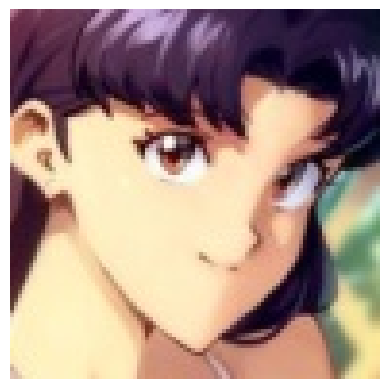

Label verdadera: Misato Katsuragi-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Misato Katsuragi-Neon Genesis Evangelion : 96.36 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 1.12 % confianza.
> Nezuko Kamado-Demon Slayer : 0.39 % confianza.
> Nozomi Tojo-Love Live : 0.24 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.23 % confianza.


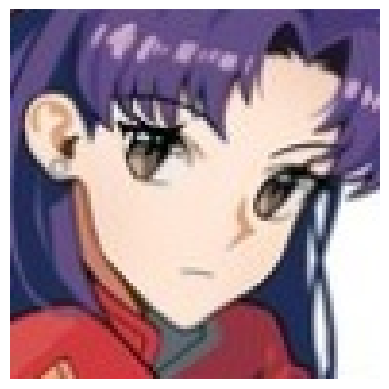

Label verdadera: Misato Katsuragi-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Misato Katsuragi-Neon Genesis Evangelion : 92.40 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 2.90 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 1.48 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.48 % confianza.
> Sakura Matou-Fate : 0.46 % confianza.


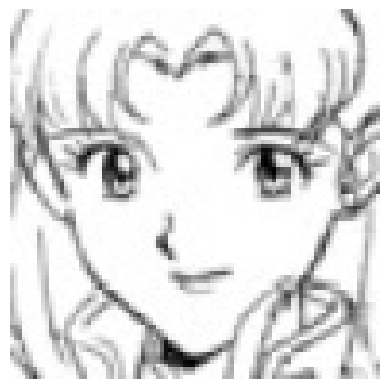

Label verdadera: Misato Katsuragi-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Misato Katsuragi-Neon Genesis Evangelion : 90.25 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 3.90 % confianza.
> Fubuki-One Punch Man : 2.10 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 1.11 % confianza.
> Nozomi Tojo-Love Live : 0.43 % confianza.


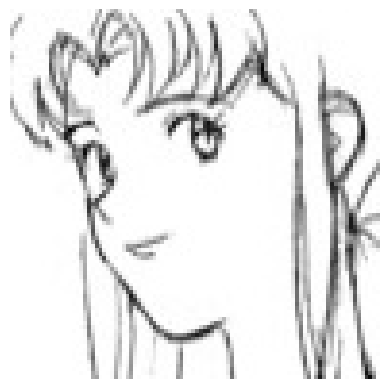

Label verdadera: Misato Katsuragi-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Misato Katsuragi-Neon Genesis Evangelion : 36.33 % confianza.
> Fubuki-One Punch Man : 24.41 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 9.91 % confianza.
> Nozomi Tojo-Love Live : 9.31 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 4.16 % confianza.


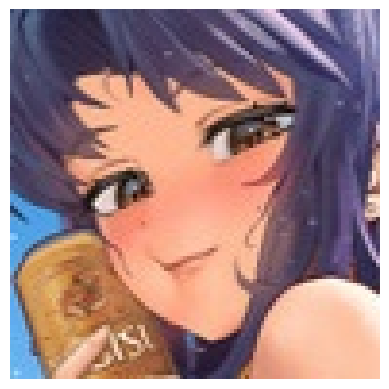

Label verdadera: Misato Katsuragi-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Jonathan Joestar-Jojos Bizarre Adventure : 52.19 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 27.90 % confianza.
> Nozomi Tojo-Love Live : 8.54 % confianza.
> Ouro Kronii-Hololive : 1.65 % confianza.
> Suzaku Kururugi-Code Geass : 1.18 % confianza.


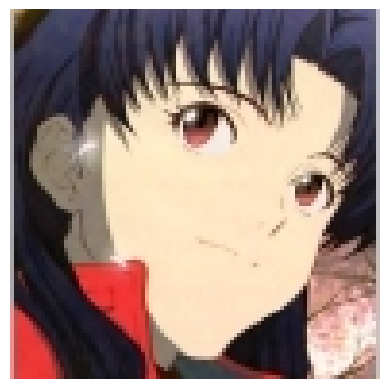

Label verdadera: Misato Katsuragi-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Kaguya Shinomiya-Kaguya Sama Love Is War : 53.72 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 26.09 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 4.02 % confianza.
> Megumin-Konosuba : 1.62 % confianza.
> Shouko Komi-Komi Cant Communicate : 1.58 % confianza.


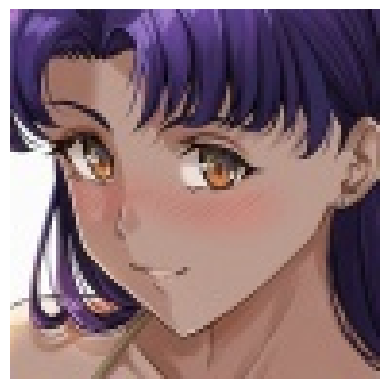

Label verdadera: Misato Katsuragi-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Misato Katsuragi-Neon Genesis Evangelion : 82.08 % confianza.
> Sakura Matou-Fate : 6.40 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 3.79 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 1.34 % confianza.
> Nozomi Tojo-Love Live : 1.02 % confianza.


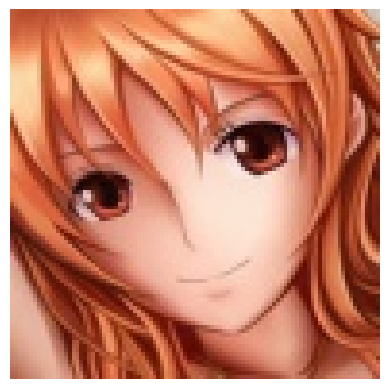

Label verdadera: Nami-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Asuna Yuuki-Sword Art Online : 62.41 % confianza.
> Nami-One Piece : 31.19 % confianza.
> Astolfo-Fate : 2.02 % confianza.
> Raphtalia-Rising of the Shield Hero : 0.76 % confianza.
> Arcueid Brunestud-Tsukihime : 0.68 % confianza.


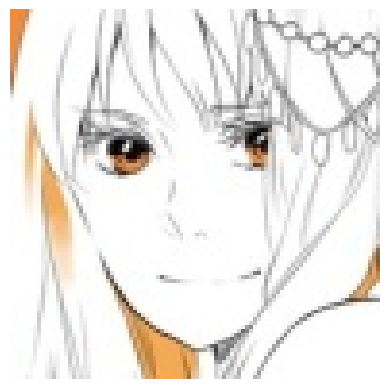

Label verdadera: Nami-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Rei Ayanami-Neon Genesis Evangelion : 36.40 % confianza.
> Gawr Gura-Hololive : 11.30 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 7.21 % confianza.
> Paimon-Genshin Impact : 4.45 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 3.69 % confianza.


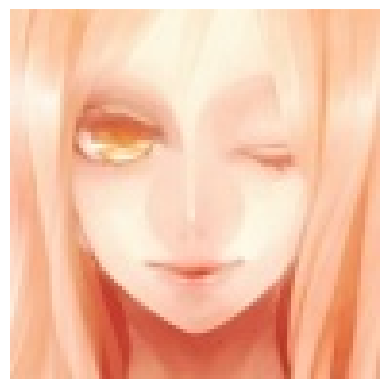

Label verdadera: Nami-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Jonathan Joestar-Jojos Bizarre Adventure : 26.01 % confianza.
> Nami-One Piece : 18.65 % confianza.
> Nico Robin-One Piece : 10.97 % confianza.
> Amelia Watson-Hololive : 8.69 % confianza.
> Hinata Hyuuga-Naruto : 4.71 % confianza.


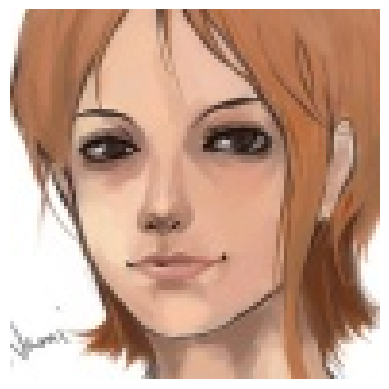

Label verdadera: Nami-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Nami-One Piece : 91.74 % confianza.
> Asuna Yuuki-Sword Art Online : 3.58 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 0.52 % confianza.
> Maki Nishikino-Love Live : 0.39 % confianza.
> Raphtalia-Rising of the Shield Hero : 0.31 % confianza.


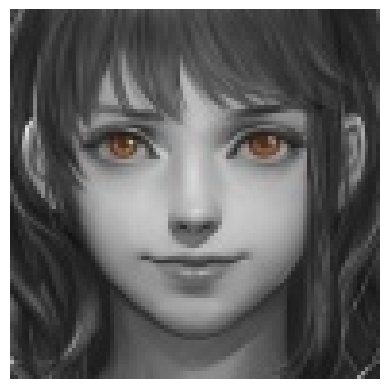

Label verdadera: Nami-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 34ms/step
> Scarlet Remilia-Touhou : 52.70 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 7.40 % confianza.
> Fubuki-One Punch Man : 6.06 % confianza.
> Albedo-Overlord : 5.40 % confianza.
> Nico Robin-One Piece : 5.10 % confianza.


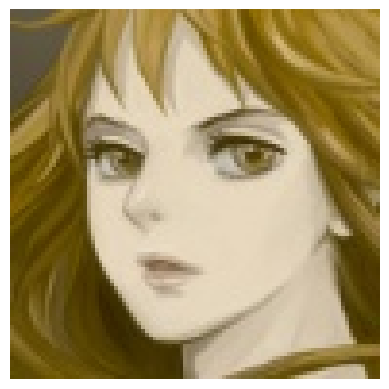

Label verdadera: Nami-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Giorno Giovanna-JoJos Bizarre Adventure : 47.38 % confianza.
> Nami-One Piece : 26.64 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 5.72 % confianza.
> Nico Robin-One Piece : 2.00 % confianza.
> Maki Nishikino-Love Live : 1.89 % confianza.


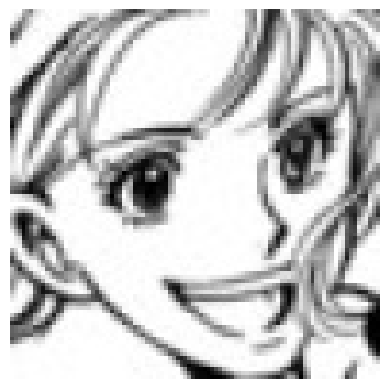

Label verdadera: Nami-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Asuna Yuuki-Sword Art Online : 40.85 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 18.16 % confianza.
> Paimon-Genshin Impact : 5.31 % confianza.
> Maki Nishikino-Love Live : 5.12 % confianza.
> Gawr Gura-Hololive : 3.35 % confianza.


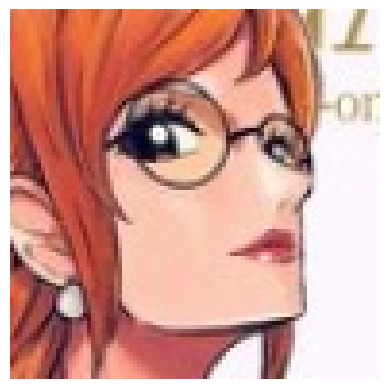

Label verdadera: Nami-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 22ms/step
> Nami-One Piece : 71.12 % confianza.
> Maki Nishikino-Love Live : 7.74 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 3.71 % confianza.
> Shirley Fenette-Code Geass : 1.55 % confianza.
> Raphtalia-Rising of the Shield Hero : 1.41 % confianza.


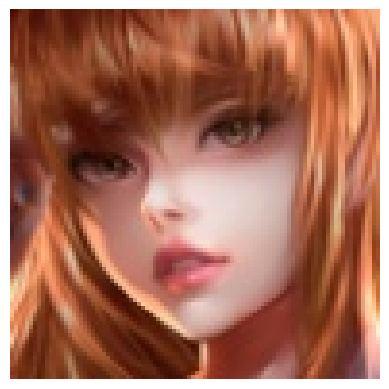

Label verdadera: Nami-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 37ms/step
> Nami-One Piece : 77.70 % confianza.
> Megumin-Konosuba : 6.19 % confianza.
> Kurisu Makise-Steins Gate : 4.94 % confianza.
> Raphtalia-Rising of the Shield Hero : 4.70 % confianza.
> Asuna Yuuki-Sword Art Online : 1.60 % confianza.


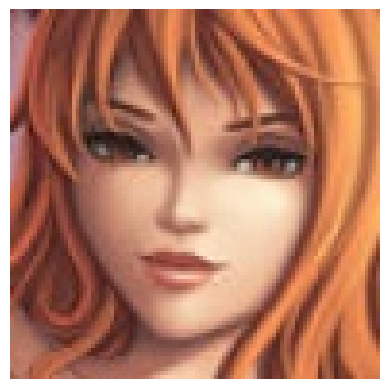

Label verdadera: Nami-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 22ms/step
> Nami-One Piece : 90.74 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 5.54 % confianza.
> Asuna Yuuki-Sword Art Online : 0.99 % confianza.
> Raphtalia-Rising of the Shield Hero : 0.39 % confianza.
> Aegis-Persona : 0.34 % confianza.


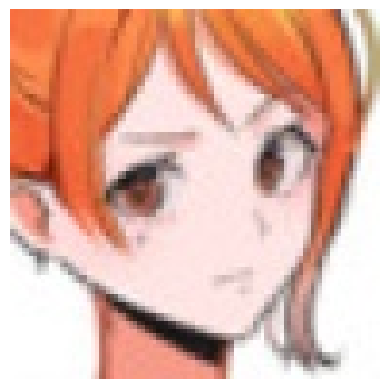

Label verdadera: Nami-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Nami-One Piece : 99.51 % confianza.
> Asuna Yuuki-Sword Art Online : 0.12 % confianza.
> Ritsu Tainaka-K ON! : 0.04 % confianza.
> Maki Nishikino-Love Live : 0.03 % confianza.
> Nico Robin-One Piece : 0.02 % confianza.


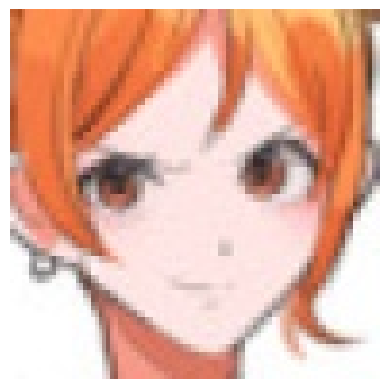

Label verdadera: Nami-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Nami-One Piece : 99.49 % confianza.
> Asuna Yuuki-Sword Art Online : 0.23 % confianza.
> Ritsu Tainaka-K ON! : 0.04 % confianza.
> Maki Nishikino-Love Live : 0.03 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.02 % confianza.


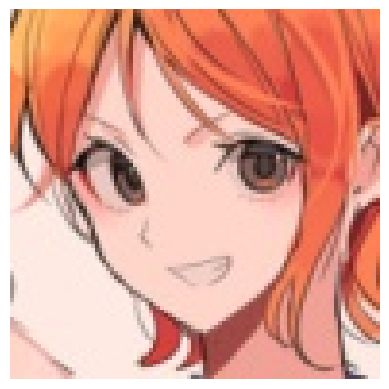

Label verdadera: Nami-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Nami-One Piece : 75.07 % confianza.
> Maki Nishikino-Love Live : 14.31 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 1.66 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 0.96 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 0.89 % confianza.


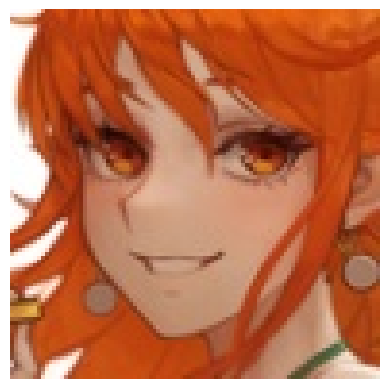

Label verdadera: Nami-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Nami-One Piece : 98.78 % confianza.
> Asuna Yuuki-Sword Art Online : 0.36 % confianza.
> Maki Nishikino-Love Live : 0.17 % confianza.
> Scarlet Remilia-Touhou : 0.06 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.06 % confianza.


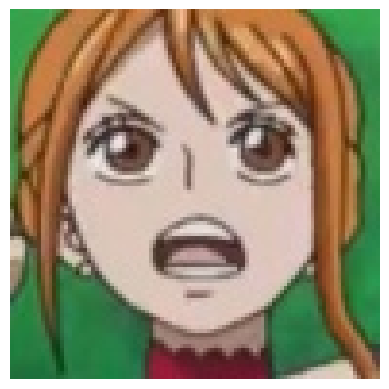

Label verdadera: Nami-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Nami-One Piece : 87.34 % confianza.
> Asuna Yuuki-Sword Art Online : 4.00 % confianza.
> Ritsu Tainaka-K ON! : 2.71 % confianza.
> Nezuko Kamado-Demon Slayer : 1.24 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 0.88 % confianza.


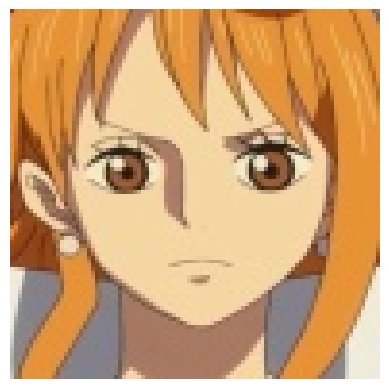

Label verdadera: Nami-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Asuna Yuuki-Sword Art Online : 53.34 % confianza.
> Nami-One Piece : 40.48 % confianza.
> Yui Hirasawa-K ON! : 0.85 % confianza.
> Ritsu Tainaka-K ON! : 0.83 % confianza.
> Raphtalia-Rising of the Shield Hero : 0.60 % confianza.


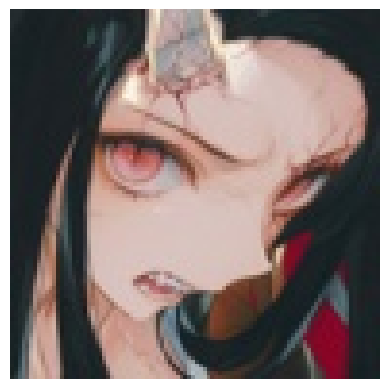

Label verdadera: Nezuko Kamado-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 36ms/step
> Nezuko Kamado-Demon Slayer : 39.71 % confianza.
> Nico Robin-One Piece : 20.10 % confianza.
> Fubuki-One Punch Man : 15.12 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 4.23 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 3.91 % confianza.


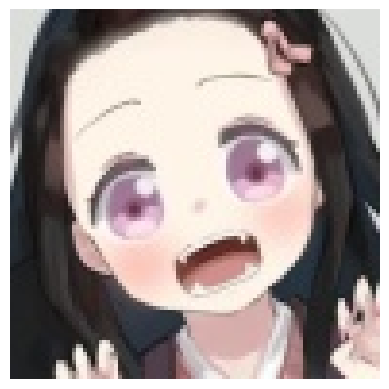

Label verdadera: Nezuko Kamado-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 40ms/step
> Nezuko Kamado-Demon Slayer : 97.37 % confianza.
> Hinata Hyuuga-Naruto : 0.93 % confianza.
> Shinobu Kochou-Demon Slayer : 0.43 % confianza.
> Nico Robin-One Piece : 0.24 % confianza.
> Kirito-Sword Art Online : 0.11 % confianza.


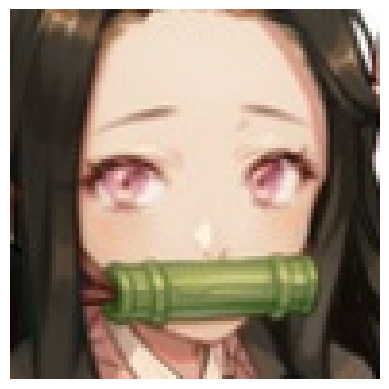

Label verdadera: Nezuko Kamado-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Nezuko Kamado-Demon Slayer : 99.50 % confianza.
> Fubuki-One Punch Man : 0.10 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.05 % confianza.
> Hinata Hyuuga-Naruto : 0.04 % confianza.
> Nami-One Piece : 0.03 % confianza.


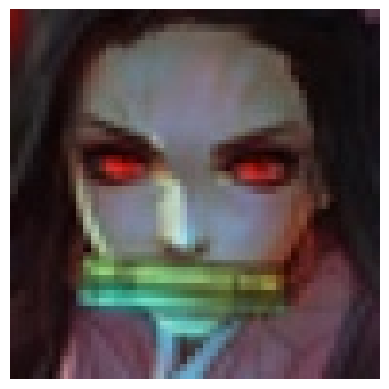

Label verdadera: Nezuko Kamado-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Scarlet Remilia-Touhou : 43.76 % confianza.
> Megumin-Konosuba : 21.56 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 9.06 % confianza.
> Albedo-Overlord : 4.00 % confianza.
> Nia Teppelin-Gurrenn Lagann : 3.18 % confianza.


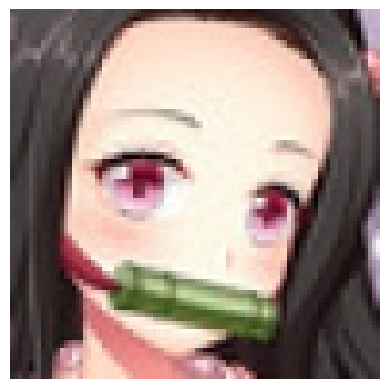

Label verdadera: Nezuko Kamado-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Nezuko Kamado-Demon Slayer : 93.55 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 1.81 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 0.29 % confianza.
> Fubuki-One Punch Man : 0.28 % confianza.
> C.C-Code Geass : 0.23 % confianza.


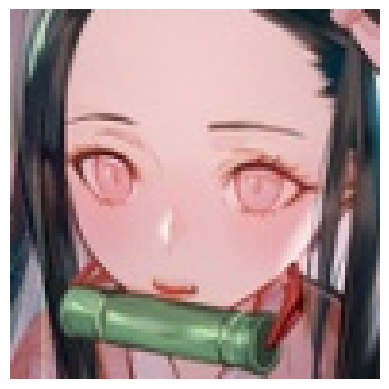

Label verdadera: Nezuko Kamado-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Nezuko Kamado-Demon Slayer : 99.83 % confianza.
> Fubuki-One Punch Man : 0.03 % confianza.
> Hinata Hyuuga-Naruto : 0.03 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.02 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.01 % confianza.


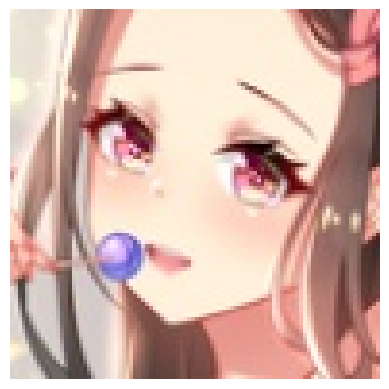

Label verdadera: Nezuko Kamado-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Nezuko Kamado-Demon Slayer : 82.87 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 9.98 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 1.10 % confianza.
> Emilia-Re Zero : 0.66 % confianza.
> Gawr Gura-Hololive : 0.40 % confianza.


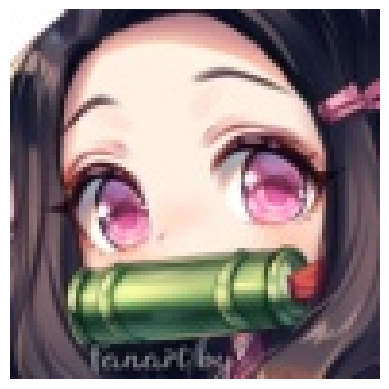

Label verdadera: Nezuko Kamado-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Nezuko Kamado-Demon Slayer : 97.70 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.21 % confianza.
> C.C-Code Geass : 0.20 % confianza.
> Fubuki-One Punch Man : 0.15 % confianza.
> Shinobu Kochou-Demon Slayer : 0.13 % confianza.


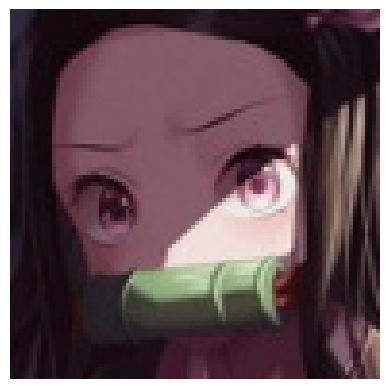

Label verdadera: Nezuko Kamado-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Nezuko Kamado-Demon Slayer : 80.54 % confianza.
> Megumin-Konosuba : 6.24 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 3.12 % confianza.
> Hinata Hyuuga-Naruto : 2.16 % confianza.
> Shinobu Kochou-Demon Slayer : 0.90 % confianza.


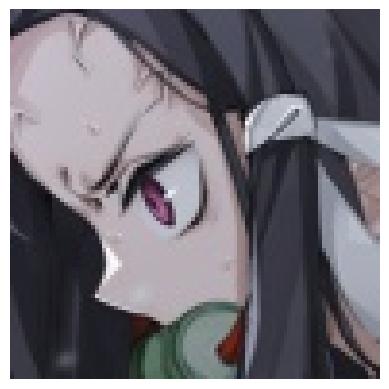

Label verdadera: Nezuko Kamado-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Nezuko Kamado-Demon Slayer : 22.86 % confianza.
> Kirito-Sword Art Online : 18.89 % confianza.
> Shinobu Kochou-Demon Slayer : 11.08 % confianza.
> Hinata Hyuuga-Naruto : 8.13 % confianza.
> Albedo-Overlord : 7.94 % confianza.


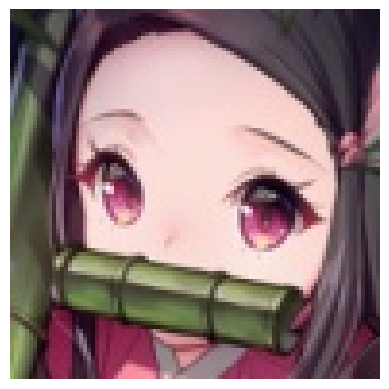

Label verdadera: Nezuko Kamado-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Nezuko Kamado-Demon Slayer : 90.94 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 1.19 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 0.79 % confianza.
> Emilia-Re Zero : 0.72 % confianza.
> C.C-Code Geass : 0.71 % confianza.


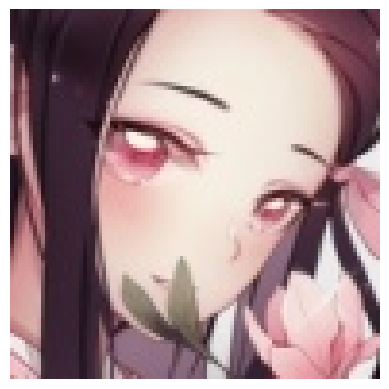

Label verdadera: Nezuko Kamado-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Nezuko Kamado-Demon Slayer : 98.07 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.72 % confianza.
> Shinobu Kochou-Demon Slayer : 0.17 % confianza.
> Hinata Hyuuga-Naruto : 0.10 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.10 % confianza.


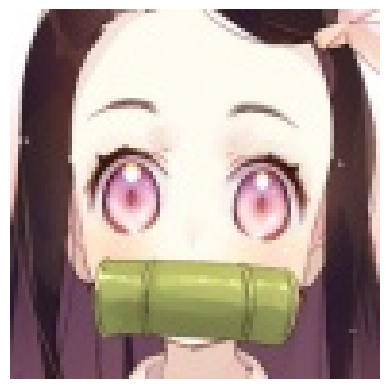

Label verdadera: Nezuko Kamado-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Nezuko Kamado-Demon Slayer : 99.76 % confianza.
> Hinata Hyuuga-Naruto : 0.02 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.02 % confianza.
> Shinobu Kochou-Demon Slayer : 0.01 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 0.01 % confianza.


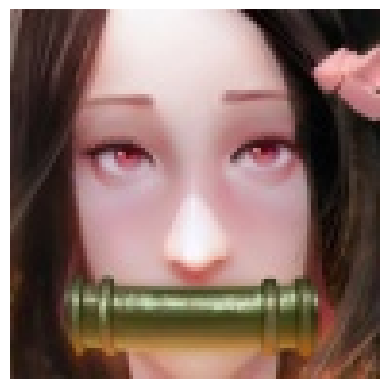

Label verdadera: Nezuko Kamado-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Nezuko Kamado-Demon Slayer : 61.85 % confianza.
> Fubuki-One Punch Man : 16.13 % confianza.
> Nico Robin-One Piece : 13.81 % confianza.
> Hinata Hyuuga-Naruto : 1.19 % confianza.
> Megumin-Konosuba : 1.09 % confianza.


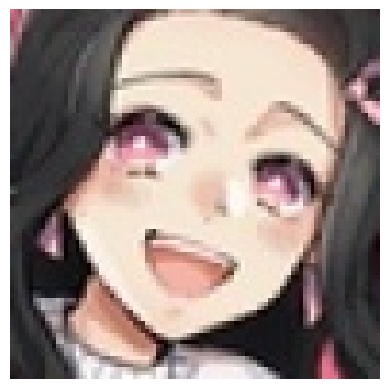

Label verdadera: Nezuko Kamado-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Nezuko Kamado-Demon Slayer : 78.53 % confianza.
> Nico Robin-One Piece : 14.41 % confianza.
> Hinata Hyuuga-Naruto : 3.94 % confianza.
> Shinobu Kochou-Demon Slayer : 0.58 % confianza.
> Paimon-Genshin Impact : 0.26 % confianza.


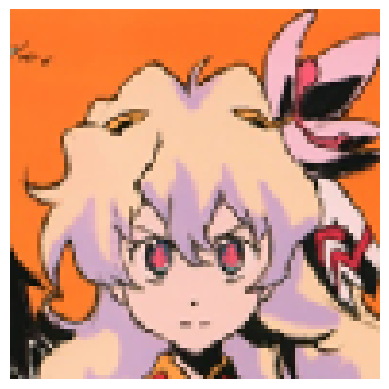

Label verdadera: Nia Teppelin-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Nia Teppelin-Gurrenn Lagann : 96.01 % confianza.
> Scarlet Remilia-Touhou : 1.32 % confianza.
> Nezuko Kamado-Demon Slayer : 0.19 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.18 % confianza.
> Sakuya Izayoi-Touhou : 0.14 % confianza.


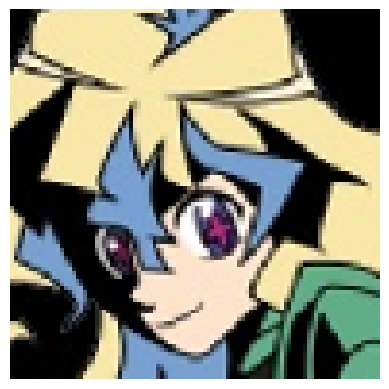

Label verdadera: Nia Teppelin-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Nia Teppelin-Gurrenn Lagann : 81.42 % confianza.
> Scarlet Remilia-Touhou : 7.23 % confianza.
> Illyasviel Von Einzbern-Fate : 0.94 % confianza.
> Nezuko Kamado-Demon Slayer : 0.93 % confianza.
> Shinobu Kochou-Demon Slayer : 0.87 % confianza.


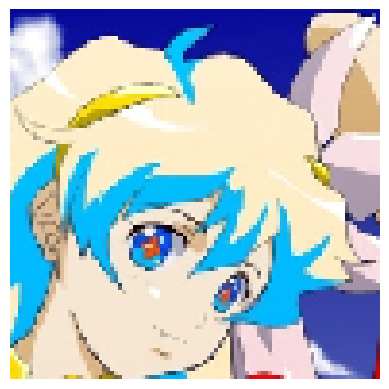

Label verdadera: Nia Teppelin-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Nia Teppelin-Gurrenn Lagann : 53.59 % confianza.
> Cirno-Touhou : 24.32 % confianza.
> Hatsune Miku-Vocaloid : 2.98 % confianza.
> Maka Albarn-Soul Eater : 2.96 % confianza.
> Konata Izumi-Lucky Star : 2.02 % confianza.


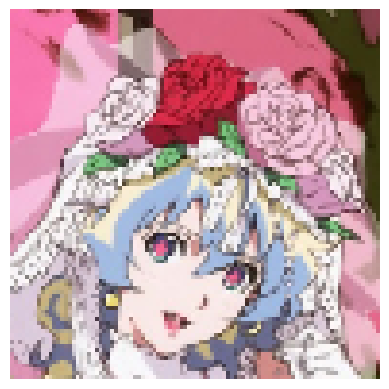

Label verdadera: Nia Teppelin-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Scarlet Remilia-Touhou : 46.44 % confianza.
> Sakuya Izayoi-Touhou : 29.26 % confianza.
> Flandre Scarlet-Touhou : 3.91 % confianza.
> Arcueid Brunestud-Tsukihime : 2.26 % confianza.
> Reimu Hakurei-Touhou : 1.94 % confianza.


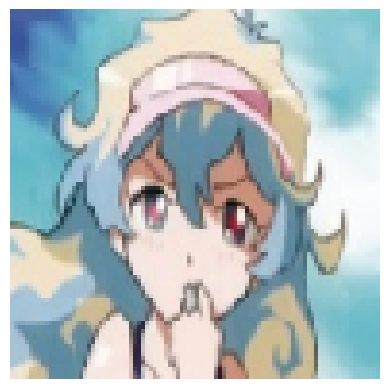

Label verdadera: Nia Teppelin-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Rei Ayanami-Neon Genesis Evangelion : 66.00 % confianza.
> Illyasviel Von Einzbern-Fate : 9.57 % confianza.
> Aqua-Konosuba : 3.64 % confianza.
> Cirno-Touhou : 2.75 % confianza.
> Hatsune Miku-Vocaloid : 2.39 % confianza.


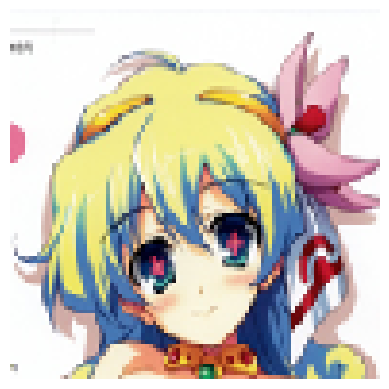

Label verdadera: Nia Teppelin-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Nia Teppelin-Gurrenn Lagann : 92.51 % confianza.
> Aisaka Taiga-Toradora : 1.10 % confianza.
> Maka Albarn-Soul Eater : 0.53 % confianza.
> Konata Izumi-Lucky Star : 0.43 % confianza.
> Yui Hirasawa-K ON! : 0.40 % confianza.


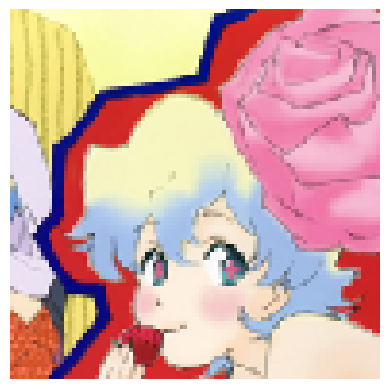

Label verdadera: Nia Teppelin-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Nia Teppelin-Gurrenn Lagann : 67.32 % confianza.
> Cirno-Touhou : 11.71 % confianza.
> Scarlet Remilia-Touhou : 4.86 % confianza.
> Konata Izumi-Lucky Star : 3.00 % confianza.
> Sakuya Izayoi-Touhou : 1.58 % confianza.


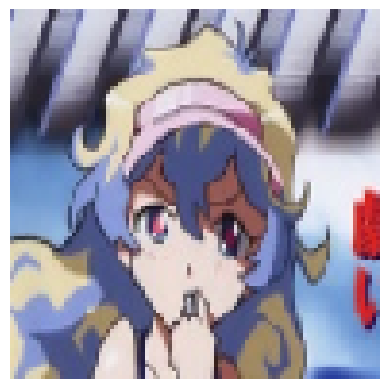

Label verdadera: Nia Teppelin-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Nia Teppelin-Gurrenn Lagann : 28.88 % confianza.
> Konata Izumi-Lucky Star : 12.16 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 6.11 % confianza.
> Sakura Matou-Fate : 5.12 % confianza.
> Illyasviel Von Einzbern-Fate : 5.03 % confianza.


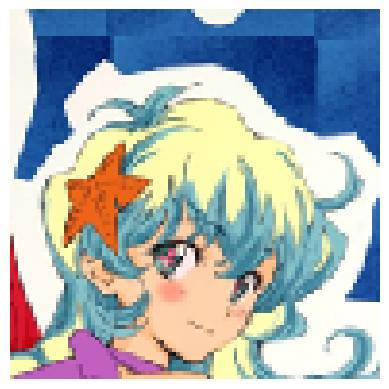

Label verdadera: Nia Teppelin-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 22ms/step
> Nia Teppelin-Gurrenn Lagann : 22.49 % confianza.
> Konata Izumi-Lucky Star : 12.29 % confianza.
> Maka Albarn-Soul Eater : 11.23 % confianza.
> Cirno-Touhou : 8.17 % confianza.
> Hatsune Miku-Vocaloid : 3.30 % confianza.


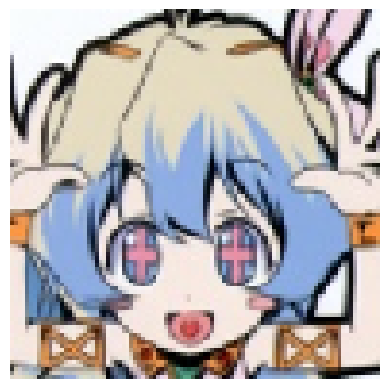

Label verdadera: Nia Teppelin-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Nia Teppelin-Gurrenn Lagann : 65.52 % confianza.
> Scarlet Remilia-Touhou : 9.41 % confianza.
> Cirno-Touhou : 5.91 % confianza.
> Konata Izumi-Lucky Star : 5.09 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 4.53 % confianza.


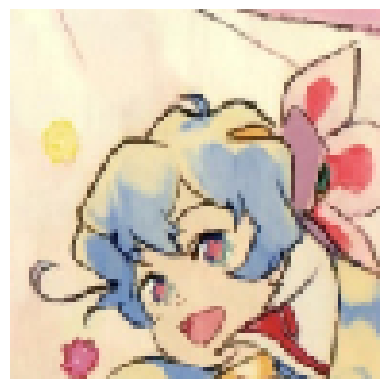

Label verdadera: Nia Teppelin-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Nia Teppelin-Gurrenn Lagann : 99.37 % confianza.
> Konata Izumi-Lucky Star : 0.23 % confianza.
> Scarlet Remilia-Touhou : 0.11 % confianza.
> Cirno-Touhou : 0.06 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.02 % confianza.


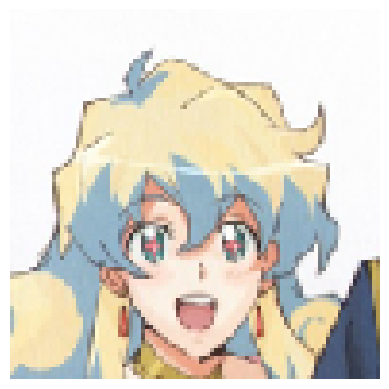

Label verdadera: Nia Teppelin-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Nia Teppelin-Gurrenn Lagann : 97.88 % confianza.
> Aisaka Taiga-Toradora : 0.23 % confianza.
> Konata Izumi-Lucky Star : 0.15 % confianza.
> Kotobuki Tsumugi-K ON! : 0.15 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.10 % confianza.


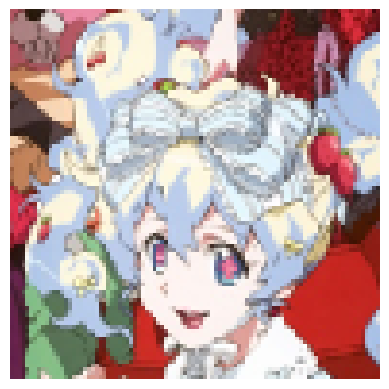

Label verdadera: Nia Teppelin-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Scarlet Remilia-Touhou : 53.57 % confianza.
> Nia Teppelin-Gurrenn Lagann : 16.43 % confianza.
> Sakuya Izayoi-Touhou : 12.67 % confianza.
> Flandre Scarlet-Touhou : 3.77 % confianza.
> Arcueid Brunestud-Tsukihime : 2.31 % confianza.


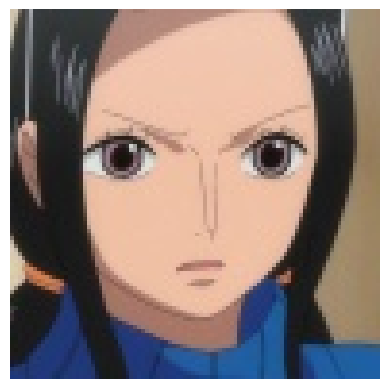

Label verdadera: Nico Robin-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Nico Robin-One Piece : 91.91 % confianza.
> Nezuko Kamado-Demon Slayer : 3.77 % confianza.
> Hinata Hyuuga-Naruto : 0.79 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.56 % confianza.
> Kirito-Sword Art Online : 0.54 % confianza.


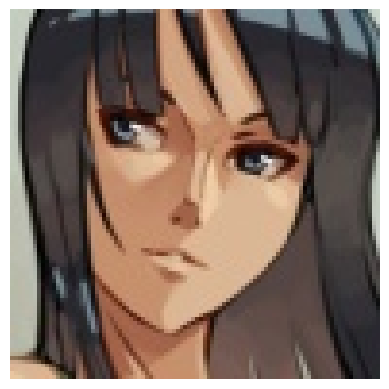

Label verdadera: Nico Robin-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Kirito-Sword Art Online : 24.74 % confianza.
> Nico Robin-One Piece : 23.20 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 15.07 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 3.21 % confianza.
> Aisaka Taiga-Toradora : 3.02 % confianza.


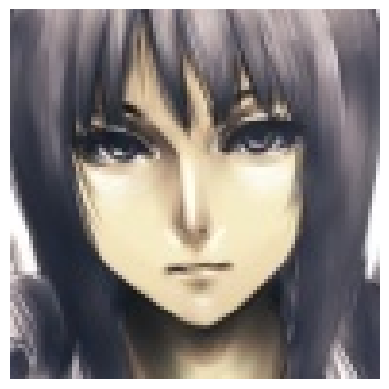

Label verdadera: Nico Robin-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Kirito-Sword Art Online : 27.23 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 18.24 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 8.93 % confianza.
> Hinata Hyuuga-Naruto : 6.85 % confianza.
> Ouro Kronii-Hololive : 5.66 % confianza.


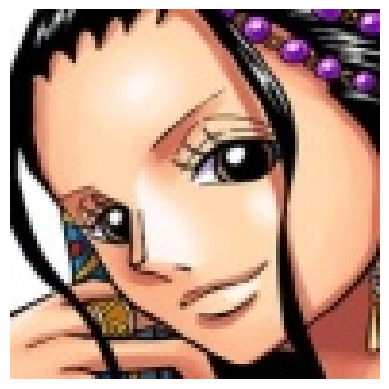

Label verdadera: Nico Robin-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Nico Robin-One Piece : 85.55 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 3.72 % confianza.
> Paimon-Genshin Impact : 1.52 % confianza.
> Ritsu Tainaka-K ON! : 1.46 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 1.20 % confianza.


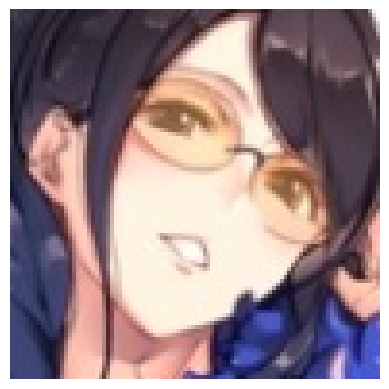

Label verdadera: Nico Robin-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Hinata Hyuuga-Naruto : 74.29 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 9.92 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 3.46 % confianza.
> Nico Robin-One Piece : 3.34 % confianza.
> Albedo-Overlord : 1.84 % confianza.


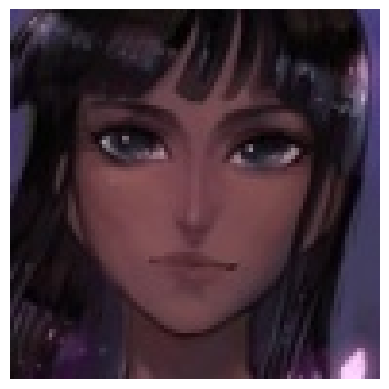

Label verdadera: Nico Robin-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Fubuki-One Punch Man : 59.41 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 10.17 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 4.09 % confianza.
> Albedo-Overlord : 3.08 % confianza.
> Nico Robin-One Piece : 2.41 % confianza.


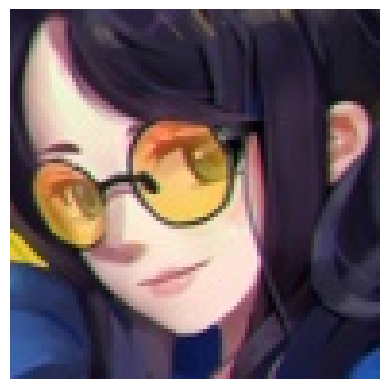

Label verdadera: Nico Robin-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 32ms/step
> Flandre Scarlet-Touhou : 17.96 % confianza.
> Saber-Fate : 13.90 % confianza.
> Fubuki-One Punch Man : 11.33 % confianza.
> Albedo-Overlord : 10.23 % confianza.
> Hinata Hyuuga-Naruto : 8.78 % confianza.


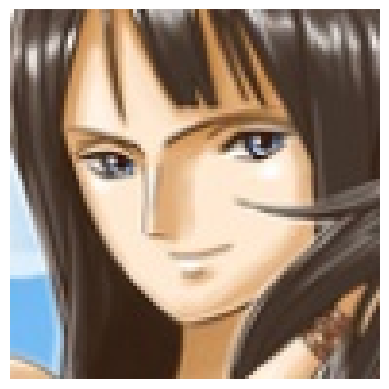

Label verdadera: Nico Robin-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Nico Robin-One Piece : 77.32 % confianza.
> Hinata Hyuuga-Naruto : 9.53 % confianza.
> Kirito-Sword Art Online : 4.94 % confianza.
> Albedo-Overlord : 3.11 % confianza.
> Fubuki-One Punch Man : 0.56 % confianza.


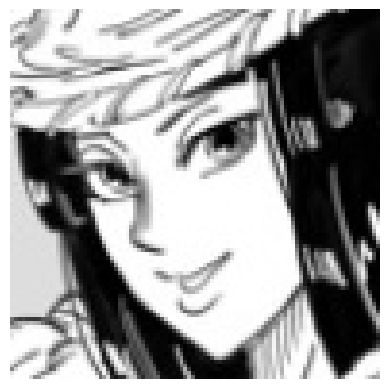

Label verdadera: Nico Robin-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Fubuki-One Punch Man : 55.67 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 26.88 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 5.96 % confianza.
> C.C-Code Geass : 2.06 % confianza.
> Maka Albarn-Soul Eater : 2.00 % confianza.


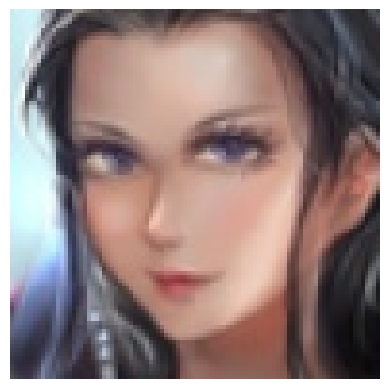

Label verdadera: Nico Robin-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Nico Robin-One Piece : 82.42 % confianza.
> Paimon-Genshin Impact : 5.99 % confianza.
> Shinobu Kochou-Demon Slayer : 3.75 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 1.26 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 1.05 % confianza.


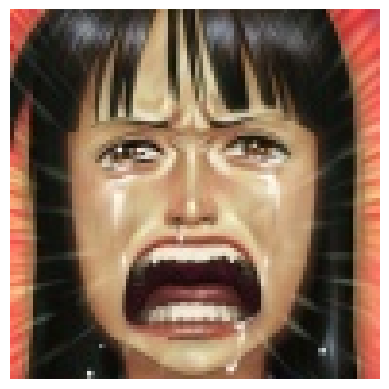

Label verdadera: Nico Robin-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Giorno Giovanna-JoJos Bizarre Adventure : 67.80 % confianza.
> Flandre Scarlet-Touhou : 7.61 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 5.36 % confianza.
> Nico Robin-One Piece : 3.01 % confianza.
> Lelouch Lamperouge-Code Geass : 1.65 % confianza.


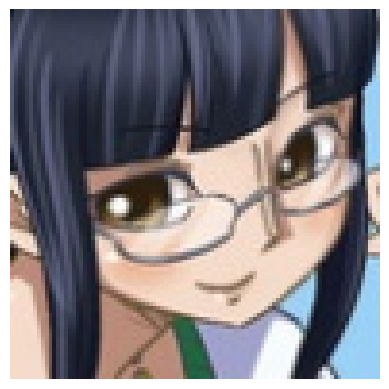

Label verdadera: Nico Robin-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Jonathan Joestar-Jojos Bizarre Adventure : 23.50 % confianza.
> Nico Robin-One Piece : 22.31 % confianza.
> Kirito-Sword Art Online : 18.96 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 8.55 % confianza.
> Albedo-Overlord : 2.29 % confianza.


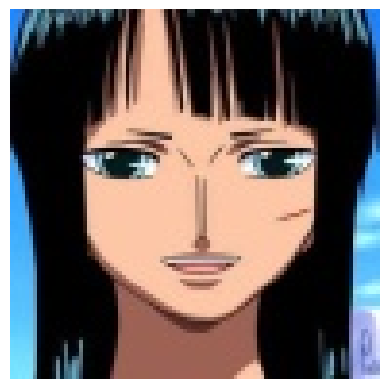

Label verdadera: Nico Robin-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 34ms/step
> Nico Robin-One Piece : 88.22 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 6.96 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.94 % confianza.
> Hinata Hyuuga-Naruto : 0.63 % confianza.
> Fubuki-One Punch Man : 0.53 % confianza.


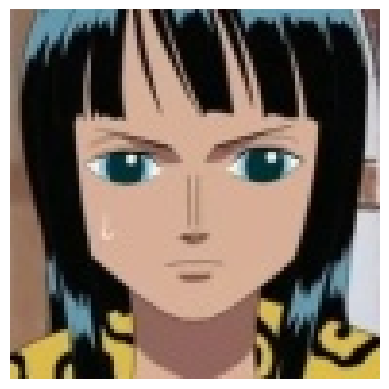

Label verdadera: Nico Robin-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Nico Robin-One Piece : 96.81 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 1.33 % confianza.
> Ouro Kronii-Hololive : 0.32 % confianza.
> Saber-Fate : 0.24 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.18 % confianza.


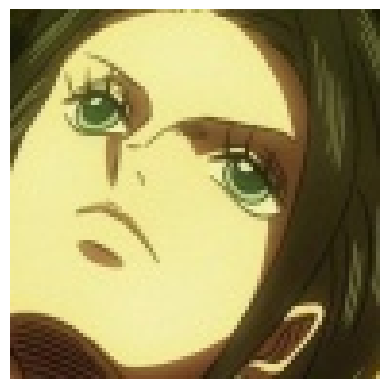

Label verdadera: Nico Robin-One Piece
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Fubuki-One Punch Man : 69.24 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 5.50 % confianza.
> Nico Robin-One Piece : 3.99 % confianza.
> Kirito-Sword Art Online : 2.26 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 2.13 % confianza.


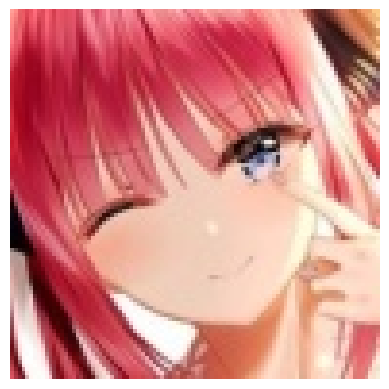

Label verdadera: Nino Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Nino Nakano-Quintessential Quintuplets : 94.40 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 1.69 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.62 % confianza.
> Hifumi Takimoto-New Game! : 0.36 % confianza.
> Shouko Komi-Komi Cant Communicate : 0.20 % confianza.


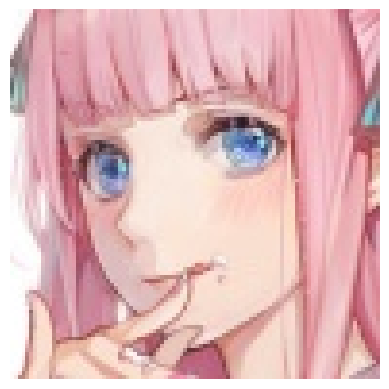

Label verdadera: Nino Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Chika Fujiwara-Kaguya Sama Love Is War : 98.68 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.77 % confianza.
> Zero Two-Darling In the Franxx : 0.19 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 0.08 % confianza.
> Amelia Watson-Hololive : 0.06 % confianza.


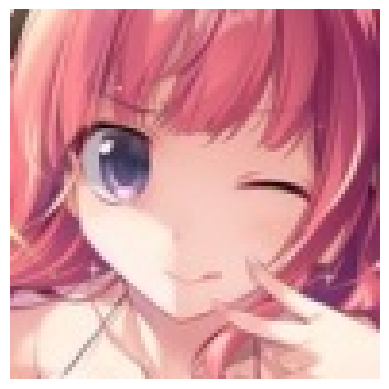

Label verdadera: Nino Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Nino Nakano-Quintessential Quintuplets : 61.48 % confianza.
> Maki Nishikino-Love Live : 12.15 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 8.62 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 3.45 % confianza.
> Asuna Yuuki-Sword Art Online : 1.65 % confianza.


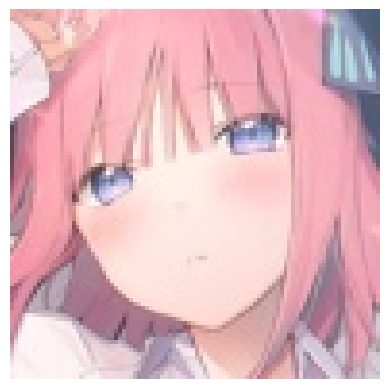

Label verdadera: Nino Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Nino Nakano-Quintessential Quintuplets : 97.95 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.72 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 0.17 % confianza.
> Zero Two-Darling In the Franxx : 0.15 % confianza.
> Hifumi Takimoto-New Game! : 0.11 % confianza.


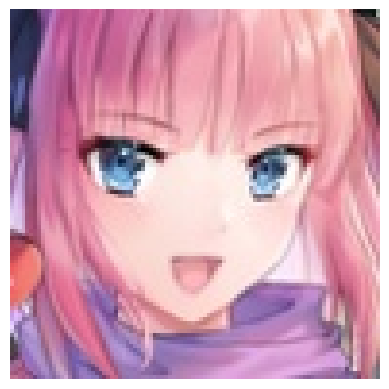

Label verdadera: Nino Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 22ms/step
> Nino Nakano-Quintessential Quintuplets : 68.22 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 26.95 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 0.62 % confianza.
> Zero Two-Darling In the Franxx : 0.58 % confianza.
> Miku Nakano-Quintessential Quintuplets : 0.57 % confianza.


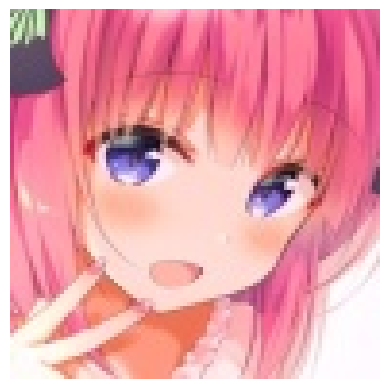

Label verdadera: Nino Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Nino Nakano-Quintessential Quintuplets : 83.08 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 4.24 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 3.35 % confianza.
> Maki Nishikino-Love Live : 2.26 % confianza.
> Ram-Re Zero : 0.36 % confianza.


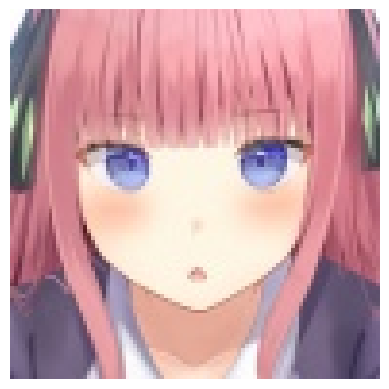

Label verdadera: Nino Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Nino Nakano-Quintessential Quintuplets : 87.21 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 2.52 % confianza.
> Hifumi Takimoto-New Game! : 2.04 % confianza.
> Maki Nishikino-Love Live : 1.09 % confianza.
> Shinobu Kochou-Demon Slayer : 0.62 % confianza.


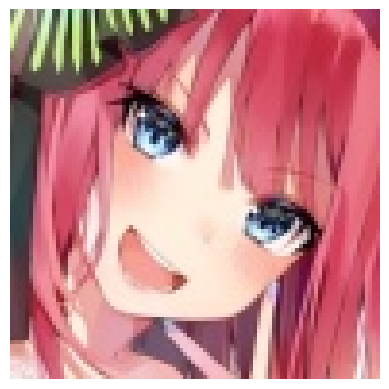

Label verdadera: Nino Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Nino Nakano-Quintessential Quintuplets : 93.24 % confianza.
> Hifumi Takimoto-New Game! : 1.84 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 1.65 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 1.06 % confianza.
> Zero Two-Darling In the Franxx : 0.19 % confianza.


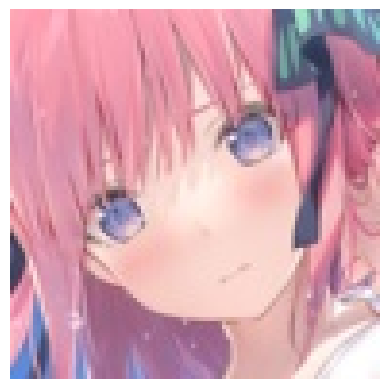

Label verdadera: Nino Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Nino Nakano-Quintessential Quintuplets : 93.05 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 2.35 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.52 % confianza.
> Ram-Re Zero : 0.28 % confianza.
> Rem-Re Zero : 0.27 % confianza.


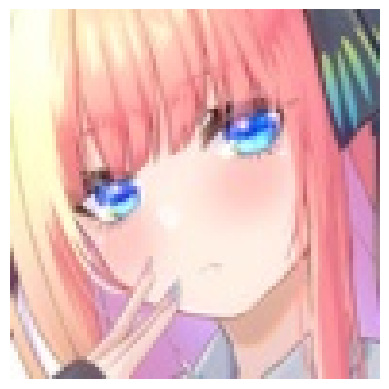

Label verdadera: Nino Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Nino Nakano-Quintessential Quintuplets : 93.05 % confianza.
> Zero Two-Darling In the Franxx : 2.09 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 0.75 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.71 % confianza.
> Saber-Fate : 0.46 % confianza.


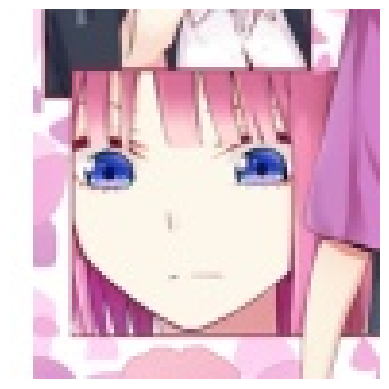

Label verdadera: Nino Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Nino Nakano-Quintessential Quintuplets : 48.30 % confianza.
> Hifumi Takimoto-New Game! : 28.45 % confianza.
> Shinobu Kochou-Demon Slayer : 10.41 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 3.12 % confianza.
> Nozomi Tojo-Love Live : 1.14 % confianza.


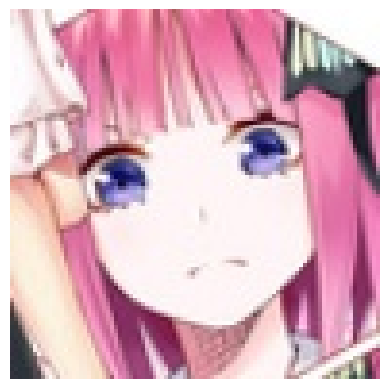

Label verdadera: Nino Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 35ms/step
> Nino Nakano-Quintessential Quintuplets : 66.38 % confianza.
> Shinobu Kochou-Demon Slayer : 12.50 % confianza.
> Hifumi Takimoto-New Game! : 4.81 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 2.98 % confianza.
> Maki Nishikino-Love Live : 1.44 % confianza.


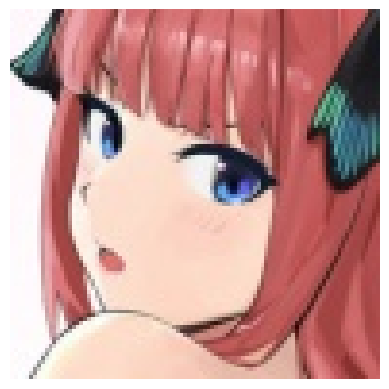

Label verdadera: Nino Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Nino Nakano-Quintessential Quintuplets : 77.93 % confianza.
> Hifumi Takimoto-New Game! : 12.87 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 2.77 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.62 % confianza.
> Maki Nishikino-Love Live : 0.38 % confianza.


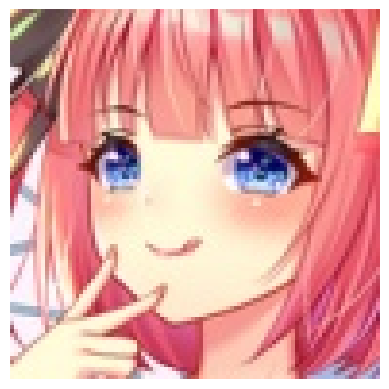

Label verdadera: Nino Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Nino Nakano-Quintessential Quintuplets : 83.29 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 13.86 % confianza.
> Hifumi Takimoto-New Game! : 0.38 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.32 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.20 % confianza.


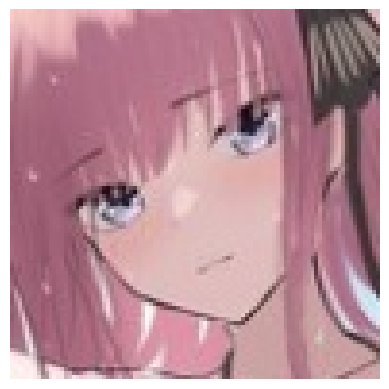

Label verdadera: Nino Nakano-Quintessential Quintuplets
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Nino Nakano-Quintessential Quintuplets : 87.06 % confianza.
> Hifumi Takimoto-New Game! : 3.25 % confianza.
> Zero Two-Darling In the Franxx : 2.34 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 1.21 % confianza.
> Ram-Re Zero : 1.01 % confianza.


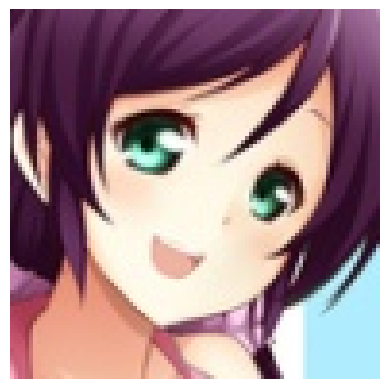

Label verdadera: Nozomi Tojo-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Nozomi Tojo-Love Live : 94.46 % confianza.
> Hifumi Takimoto-New Game! : 0.94 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.71 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.45 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.33 % confianza.


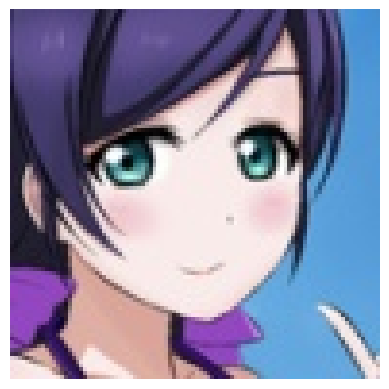

Label verdadera: Nozomi Tojo-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Nozomi Tojo-Love Live : 91.84 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.65 % confianza.
> Hifumi Takimoto-New Game! : 0.65 % confianza.
> Sinon-Sword Art Online : 0.49 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.44 % confianza.


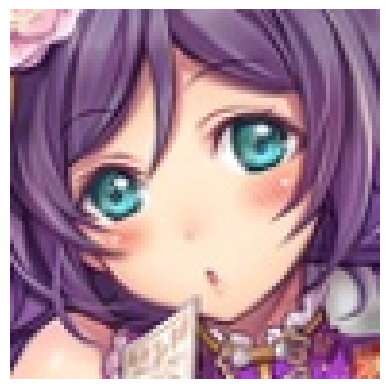

Label verdadera: Nozomi Tojo-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Nozomi Tojo-Love Live : 90.56 % confianza.
> Sinon-Sword Art Online : 1.18 % confianza.
> Zero Two-Darling In the Franxx : 1.04 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.61 % confianza.
> C.C-Code Geass : 0.50 % confianza.


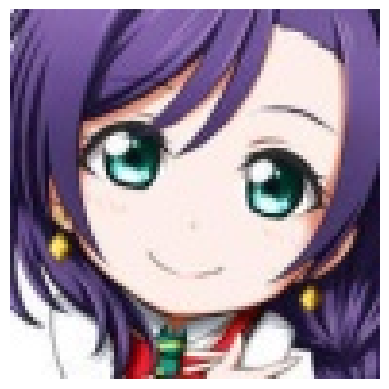

Label verdadera: Nozomi Tojo-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Nozomi Tojo-Love Live : 95.64 % confianza.
> Hifumi Takimoto-New Game! : 0.71 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.48 % confianza.
> Sakura Matou-Fate : 0.36 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.24 % confianza.


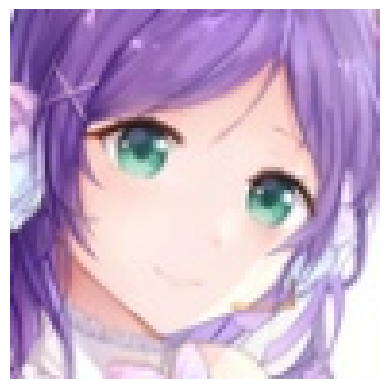

Label verdadera: Nozomi Tojo-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Nozomi Tojo-Love Live : 98.32 % confianza.
> Zero Two-Darling In the Franxx : 0.23 % confianza.
> Hifumi Takimoto-New Game! : 0.20 % confianza.
> Keqing-Genshin Impact : 0.17 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.09 % confianza.


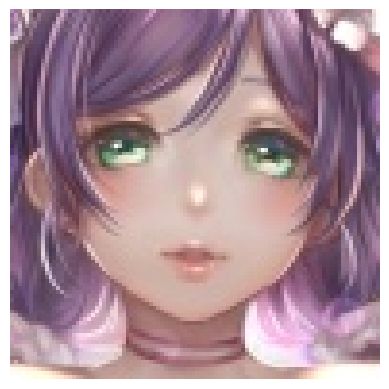

Label verdadera: Nozomi Tojo-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Nozomi Tojo-Love Live : 79.21 % confianza.
> Zero Two-Darling In the Franxx : 13.83 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.98 % confianza.
> Fubuki-One Punch Man : 0.93 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.45 % confianza.


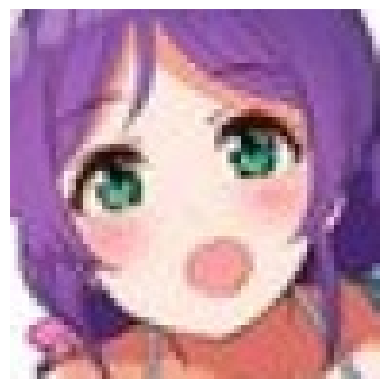

Label verdadera: Nozomi Tojo-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Nozomi Tojo-Love Live : 97.52 % confianza.
> Zero Two-Darling In the Franxx : 0.37 % confianza.
> Keqing-Genshin Impact : 0.18 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.17 % confianza.
> Hifumi Takimoto-New Game! : 0.14 % confianza.


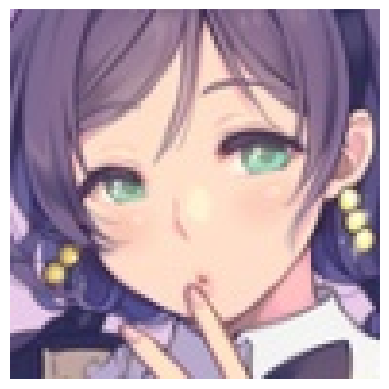

Label verdadera: Nozomi Tojo-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Nozomi Tojo-Love Live : 95.33 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 1.44 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.25 % confianza.
> Keqing-Genshin Impact : 0.25 % confianza.
> Konata Izumi-Lucky Star : 0.20 % confianza.


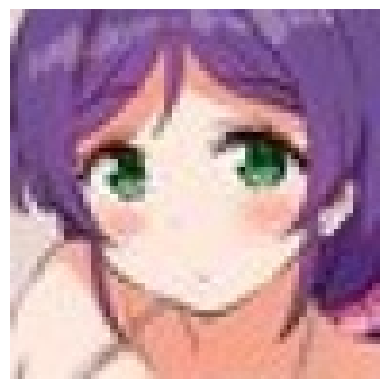

Label verdadera: Nozomi Tojo-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 35ms/step
> Nozomi Tojo-Love Live : 94.72 % confianza.
> Zero Two-Darling In the Franxx : 2.80 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.37 % confianza.
> Keqing-Genshin Impact : 0.15 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.14 % confianza.


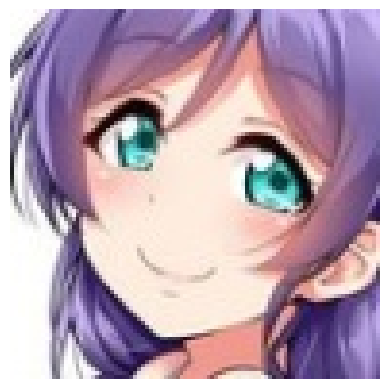

Label verdadera: Nozomi Tojo-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Nozomi Tojo-Love Live : 96.36 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.38 % confianza.
> Hifumi Takimoto-New Game! : 0.35 % confianza.
> Sinon-Sword Art Online : 0.32 % confianza.
> Keqing-Genshin Impact : 0.24 % confianza.


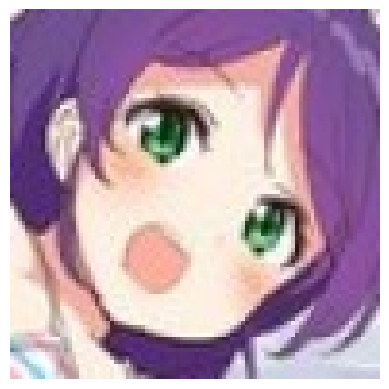

Label verdadera: Nozomi Tojo-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 44ms/step
> Nozomi Tojo-Love Live : 95.42 % confianza.
> Zero Two-Darling In the Franxx : 0.46 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.39 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.36 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.22 % confianza.


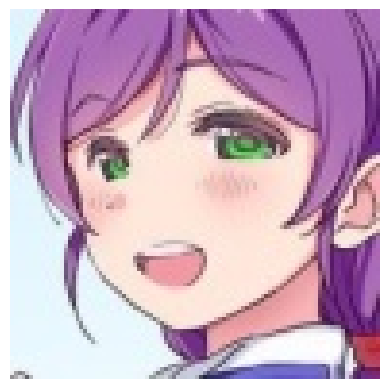

Label verdadera: Nozomi Tojo-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Nozomi Tojo-Love Live : 95.87 % confianza.
> Zero Two-Darling In the Franxx : 0.67 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.52 % confianza.
> Keqing-Genshin Impact : 0.38 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.16 % confianza.


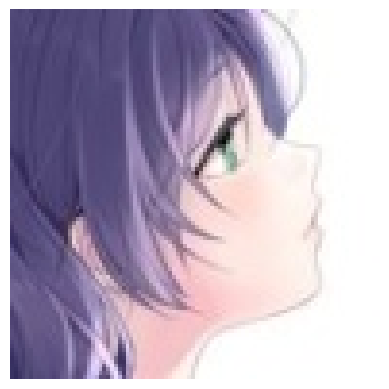

Label verdadera: Nozomi Tojo-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 30.04 % confianza.
> Sakuya Izayoi-Touhou : 10.27 % confianza.
> Ouro Kronii-Hololive : 10.06 % confianza.
> Nozomi Tojo-Love Live : 6.83 % confianza.
> Shiki Ryougi-Garden of Sinners : 6.21 % confianza.


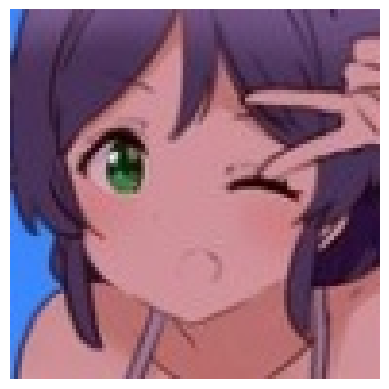

Label verdadera: Nozomi Tojo-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 22ms/step
> Nozomi Tojo-Love Live : 39.32 % confianza.
> Zero Two-Darling In the Franxx : 15.75 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 4.88 % confianza.
> Sinon-Sword Art Online : 4.00 % confianza.
> Keqing-Genshin Impact : 3.73 % confianza.


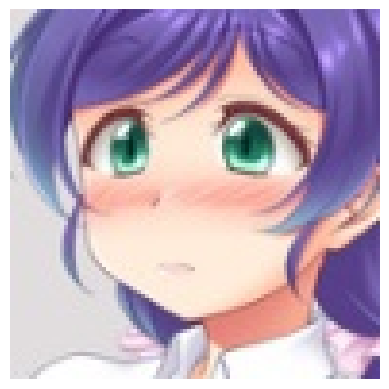

Label verdadera: Nozomi Tojo-Love Live
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Nozomi Tojo-Love Live : 94.96 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.74 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.45 % confianza.
> Sinon-Sword Art Online : 0.29 % confianza.
> Zero Two-Darling In the Franxx : 0.28 % confianza.


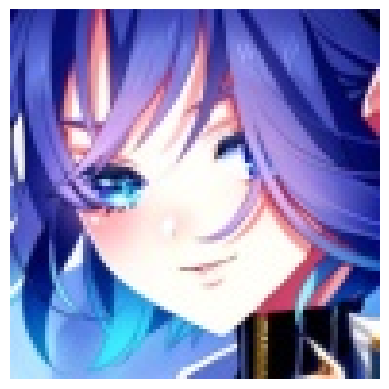

Label verdadera: Ouro Kronii-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 24.24 % confianza.
> Nozomi Tojo-Love Live : 11.54 % confianza.
> Ouro Kronii-Hololive : 10.54 % confianza.
> Shinobu Kochou-Demon Slayer : 4.33 % confianza.
> Keqing-Genshin Impact : 3.81 % confianza.


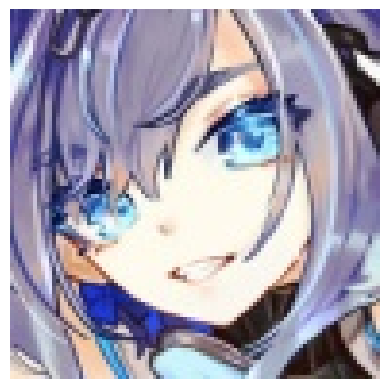

Label verdadera: Ouro Kronii-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Ouro Kronii-Hololive : 44.24 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 15.10 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 10.25 % confianza.
> Aegis-Persona : 3.54 % confianza.
> Gawr Gura-Hololive : 3.53 % confianza.


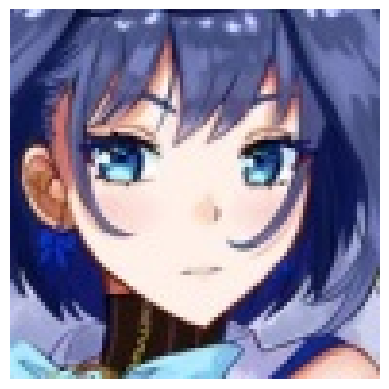

Label verdadera: Ouro Kronii-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Ouro Kronii-Hololive : 31.56 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 17.19 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 15.80 % confianza.
> Nozomi Tojo-Love Live : 11.00 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 2.54 % confianza.


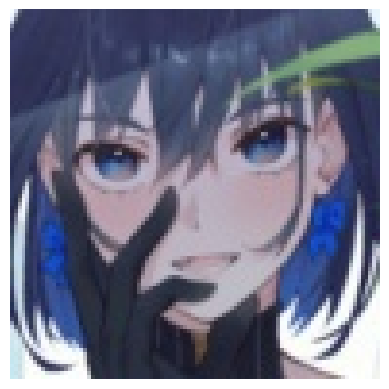

Label verdadera: Ouro Kronii-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Ouro Kronii-Hololive : 96.82 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.79 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.43 % confianza.
> Reimu Hakurei-Touhou : 0.24 % confianza.
> Sakuya Izayoi-Touhou : 0.23 % confianza.


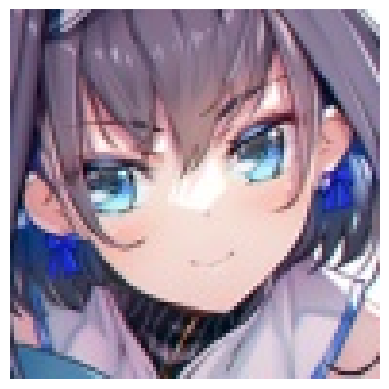

Label verdadera: Ouro Kronii-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Ouro Kronii-Hololive : 91.10 % confianza.
> Sinon-Sword Art Online : 1.24 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 1.11 % confianza.
> Reimu Hakurei-Touhou : 0.57 % confianza.
> Gawr Gura-Hololive : 0.50 % confianza.


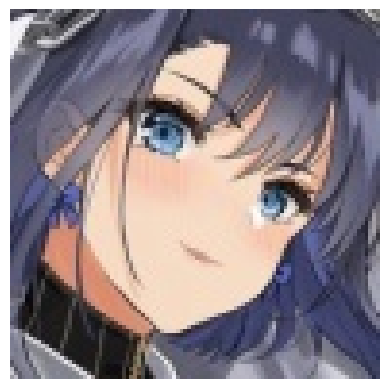

Label verdadera: Ouro Kronii-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 34ms/step
> Ouro Kronii-Hololive : 75.23 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 5.78 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 3.74 % confianza.
> Hifumi Takimoto-New Game! : 1.50 % confianza.
> Rin Tohsakaka-Fate : 1.06 % confianza.


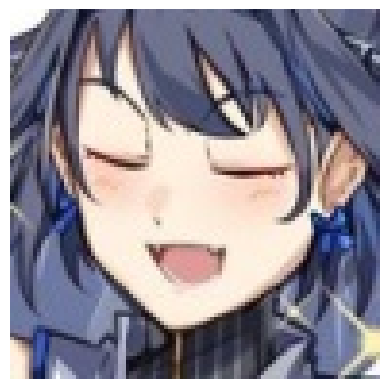

Label verdadera: Ouro Kronii-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 72.19 % confianza.
> Hinata Hyuuga-Naruto : 19.54 % confianza.
> Ouro Kronii-Hololive : 1.80 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 1.15 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.73 % confianza.


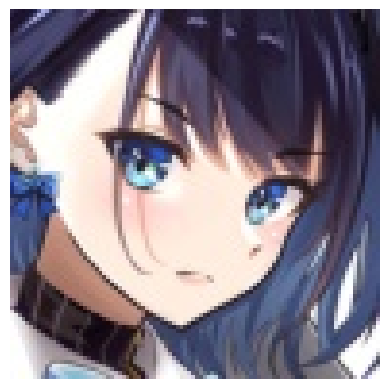

Label verdadera: Ouro Kronii-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Ouro Kronii-Hololive : 54.51 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 9.09 % confianza.
> Hifumi Takimoto-New Game! : 8.43 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 7.97 % confianza.
> Rin Tohsakaka-Fate : 2.36 % confianza.


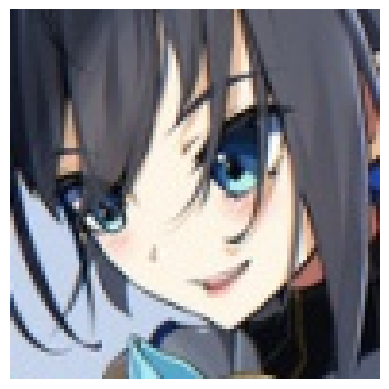

Label verdadera: Ouro Kronii-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Ouro Kronii-Hololive : 60.98 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 24.91 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 2.60 % confianza.
> Kirito-Sword Art Online : 2.37 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 1.55 % confianza.


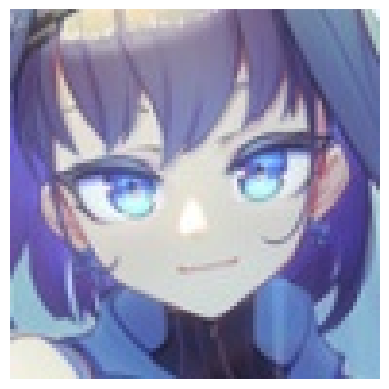

Label verdadera: Ouro Kronii-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Shinobu Kochou-Demon Slayer : 68.80 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 13.46 % confianza.
> Ouro Kronii-Hololive : 7.23 % confianza.
> Kirito-Sword Art Online : 1.22 % confianza.
> Hinata Hyuuga-Naruto : 0.83 % confianza.


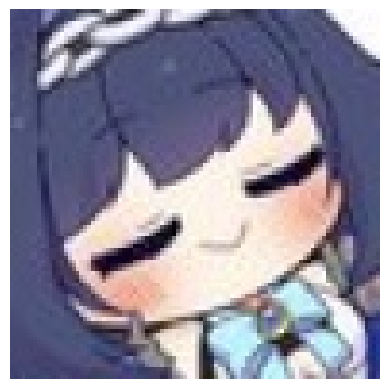

Label verdadera: Ouro Kronii-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 33ms/step
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 84.99 % confianza.
> Ouro Kronii-Hololive : 3.30 % confianza.
> Hinata Hyuuga-Naruto : 2.56 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 1.39 % confianza.
> Kirito-Sword Art Online : 1.20 % confianza.


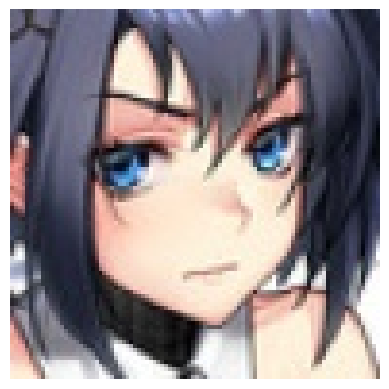

Label verdadera: Ouro Kronii-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 30.07 % confianza.
> Ouro Kronii-Hololive : 24.82 % confianza.
> Kirito-Sword Art Online : 5.71 % confianza.
> Aqua-Konosuba : 5.10 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 4.21 % confianza.


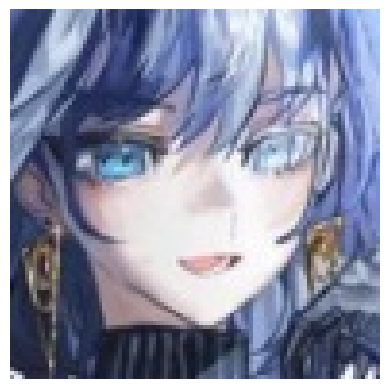

Label verdadera: Ouro Kronii-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Ouro Kronii-Hololive : 76.76 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 6.02 % confianza.
> Sakuya Izayoi-Touhou : 5.53 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 2.17 % confianza.
> Rem-Re Zero : 1.17 % confianza.


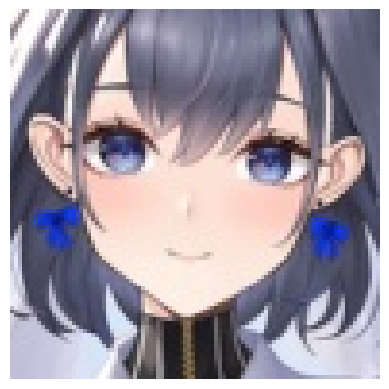

Label verdadera: Ouro Kronii-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 35ms/step
> Ouro Kronii-Hololive : 81.93 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 12.19 % confianza.
> Hifumi Takimoto-New Game! : 0.90 % confianza.
> Reimu Hakurei-Touhou : 0.47 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.42 % confianza.


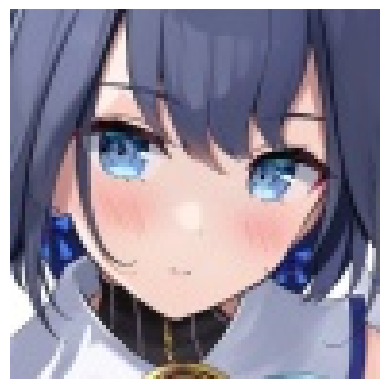

Label verdadera: Ouro Kronii-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Ouro Kronii-Hololive : 92.81 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 1.14 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.95 % confianza.
> Aqua-Konosuba : 0.52 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.34 % confianza.


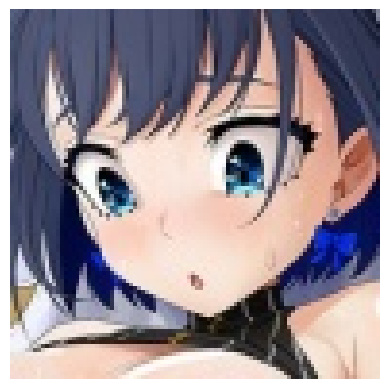

Label verdadera: Ouro Kronii-Hololive
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Ouro Kronii-Hololive : 52.63 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 26.42 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 5.44 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 2.60 % confianza.
> Nozomi Tojo-Love Live : 2.30 % confianza.


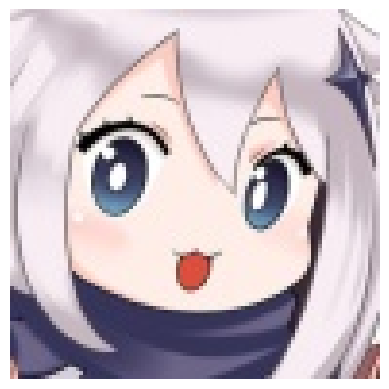

Label verdadera: Paimon-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Paimon-Genshin Impact : 94.77 % confianza.
> Gawr Gura-Hololive : 0.85 % confianza.
> Nico Robin-One Piece : 0.83 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.46 % confianza.
> Aqua-Konosuba : 0.34 % confianza.


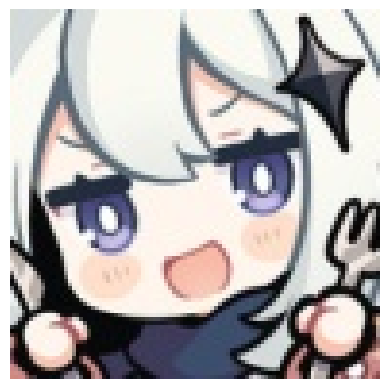

Label verdadera: Paimon-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Paimon-Genshin Impact : 98.01 % confianza.
> Nico Robin-One Piece : 0.46 % confianza.
> Shinobu Kochou-Demon Slayer : 0.39 % confianza.
> Kirito-Sword Art Online : 0.21 % confianza.
> Nezuko Kamado-Demon Slayer : 0.09 % confianza.


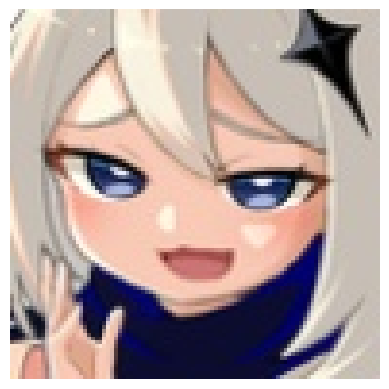

Label verdadera: Paimon-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Paimon-Genshin Impact : 98.47 % confianza.
> Nico Robin-One Piece : 0.74 % confianza.
> Kirito-Sword Art Online : 0.11 % confianza.
> Aqua-Konosuba : 0.11 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.06 % confianza.


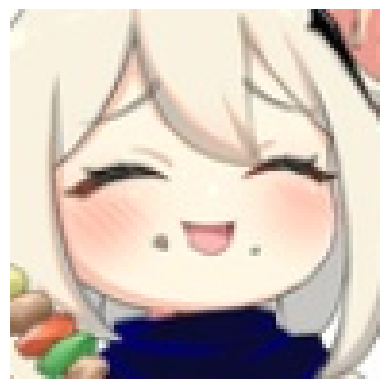

Label verdadera: Paimon-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Paimon-Genshin Impact : 86.49 % confianza.
> Nico Robin-One Piece : 3.42 % confianza.
> Illyasviel Von Einzbern-Fate : 2.96 % confianza.
> Nezuko Kamado-Demon Slayer : 2.68 % confianza.
> Gawr Gura-Hololive : 1.21 % confianza.


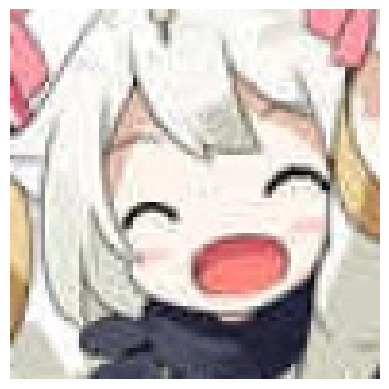

Label verdadera: Paimon-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Paimon-Genshin Impact : 86.18 % confianza.
> Illyasviel Von Einzbern-Fate : 3.96 % confianza.
> Gawr Gura-Hololive : 3.76 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.67 % confianza.
> Nico Robin-One Piece : 0.58 % confianza.


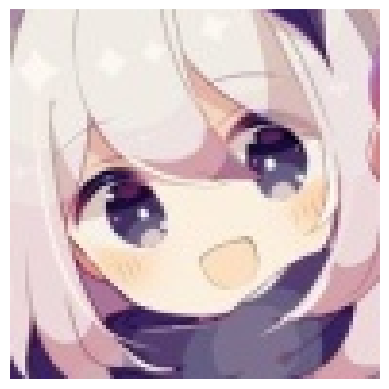

Label verdadera: Paimon-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Paimon-Genshin Impact : 97.40 % confianza.
> Emilia-Re Zero : 0.65 % confianza.
> Shinobu Kochou-Demon Slayer : 0.29 % confianza.
> Aqua-Konosuba : 0.24 % confianza.
> Kirito-Sword Art Online : 0.19 % confianza.


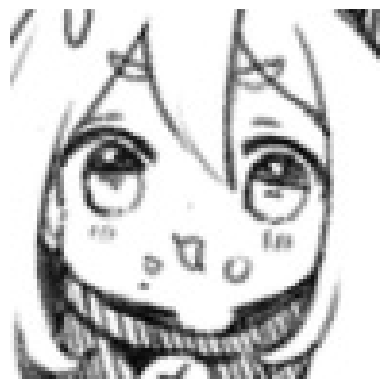

Label verdadera: Paimon-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 22ms/step
> Paimon-Genshin Impact : 39.77 % confianza.
> Gawr Gura-Hololive : 23.05 % confianza.
> Nico Robin-One Piece : 18.14 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 5.61 % confianza.
> Miku Nakano-Quintessential Quintuplets : 1.31 % confianza.


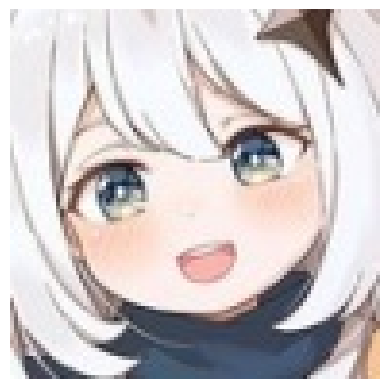

Label verdadera: Paimon-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Paimon-Genshin Impact : 97.90 % confianza.
> Nico Robin-One Piece : 1.24 % confianza.
> Gawr Gura-Hololive : 0.54 % confianza.
> Nezuko Kamado-Demon Slayer : 0.04 % confianza.
> Aqua-Konosuba : 0.03 % confianza.


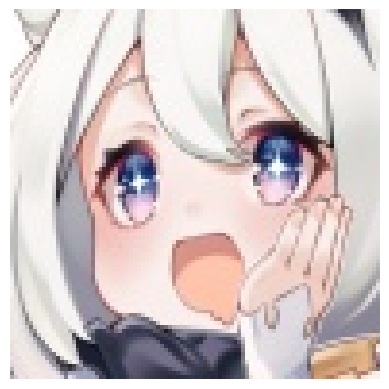

Label verdadera: Paimon-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Paimon-Genshin Impact : 99.21 % confianza.
> Gawr Gura-Hololive : 0.14 % confianza.
> Aqua-Konosuba : 0.13 % confianza.
> Nico Robin-One Piece : 0.12 % confianza.
> Sakuya Izayoi-Touhou : 0.06 % confianza.


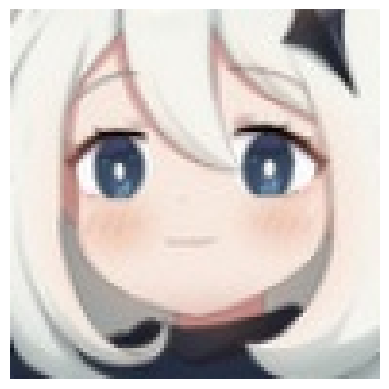

Label verdadera: Paimon-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 44ms/step
> Paimon-Genshin Impact : 99.17 % confianza.
> Nico Robin-One Piece : 0.16 % confianza.
> Kirito-Sword Art Online : 0.11 % confianza.
> Sinon-Sword Art Online : 0.09 % confianza.
> Aqua-Konosuba : 0.05 % confianza.


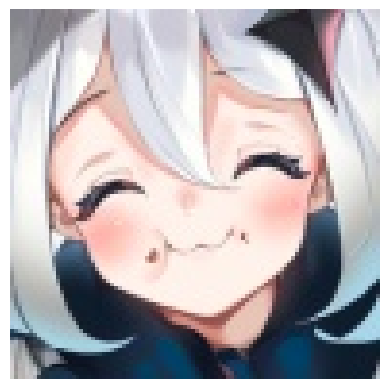

Label verdadera: Paimon-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Paimon-Genshin Impact : 92.93 % confianza.
> Nico Robin-One Piece : 3.54 % confianza.
> Gawr Gura-Hololive : 0.77 % confianza.
> Aqua-Konosuba : 0.47 % confianza.
> Kirito-Sword Art Online : 0.45 % confianza.


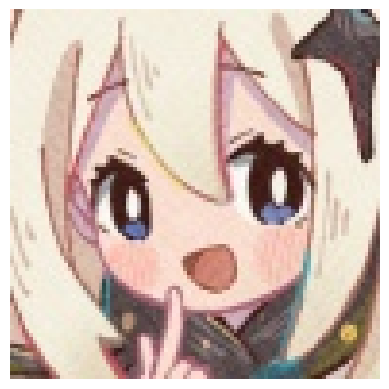

Label verdadera: Paimon-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Paimon-Genshin Impact : 93.73 % confianza.
> Nico Robin-One Piece : 3.62 % confianza.
> Sinon-Sword Art Online : 0.53 % confianza.
> Gawr Gura-Hololive : 0.22 % confianza.
> Sakuya Izayoi-Touhou : 0.21 % confianza.


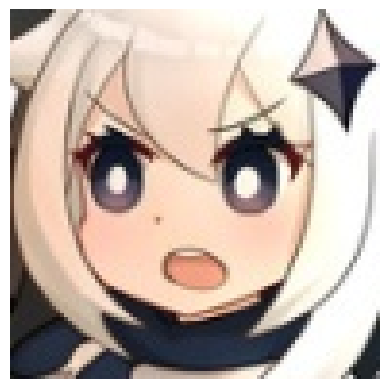

Label verdadera: Paimon-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Paimon-Genshin Impact : 97.96 % confianza.
> Nico Robin-One Piece : 0.49 % confianza.
> Aqua-Konosuba : 0.38 % confianza.
> Kirito-Sword Art Online : 0.16 % confianza.
> Ritsu Tainaka-K ON! : 0.12 % confianza.


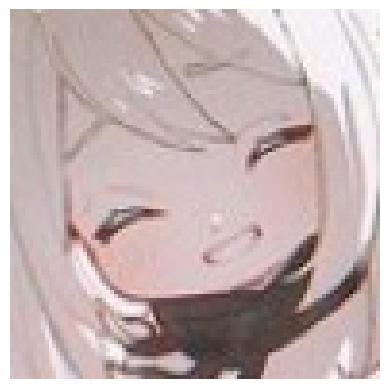

Label verdadera: Paimon-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Gawr Gura-Hololive : 38.50 % confianza.
> Paimon-Genshin Impact : 15.41 % confianza.
> Albedo-Overlord : 13.38 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 5.58 % confianza.
> Hinata Hyuuga-Naruto : 4.66 % confianza.


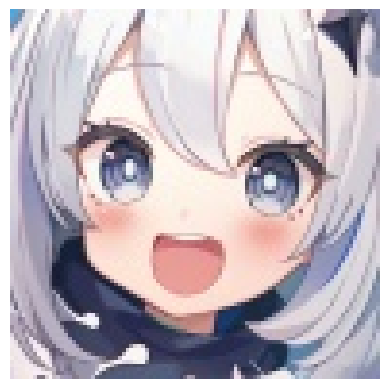

Label verdadera: Paimon-Genshin Impact
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Paimon-Genshin Impact : 97.18 % confianza.
> Gawr Gura-Hololive : 1.44 % confianza.
> Aqua-Konosuba : 0.27 % confianza.
> Nico Robin-One Piece : 0.22 % confianza.
> Sakuya Izayoi-Touhou : 0.14 % confianza.


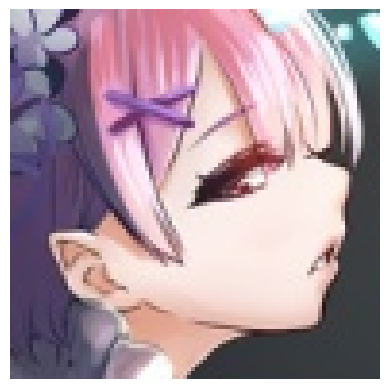

Label verdadera: Ram-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Illyasviel Von Einzbern-Fate : 19.52 % confianza.
> Ram-Re Zero : 18.87 % confianza.
> Nezuko Kamado-Demon Slayer : 5.42 % confianza.
> Paimon-Genshin Impact : 4.79 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 4.10 % confianza.


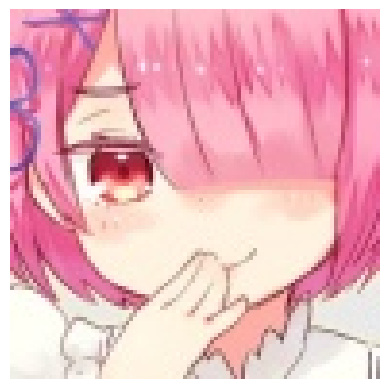

Label verdadera: Ram-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Ram-Re Zero : 90.82 % confianza.
> Flandre Scarlet-Touhou : 2.00 % confianza.
> Zero Two-Darling In the Franxx : 1.64 % confianza.
> Astolfo-Fate : 0.75 % confianza.
> Scarlet Remilia-Touhou : 0.41 % confianza.


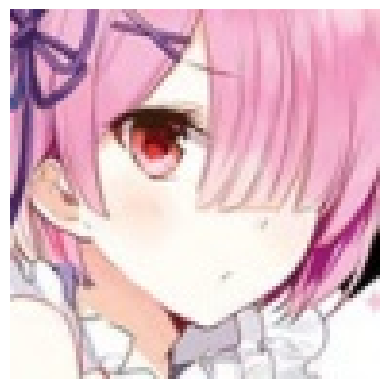

Label verdadera: Ram-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Ram-Re Zero : 97.09 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.67 % confianza.
> Scarlet Remilia-Touhou : 0.41 % confianza.
> Reimu Hakurei-Touhou : 0.22 % confianza.
> Illyasviel Von Einzbern-Fate : 0.20 % confianza.


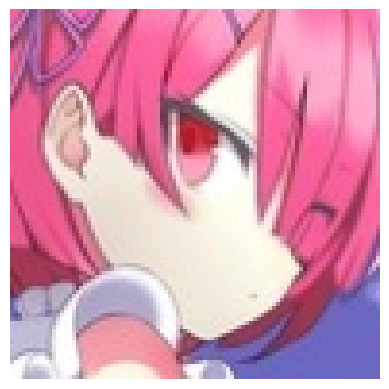

Label verdadera: Ram-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Ram-Re Zero : 86.85 % confianza.
> Nino Nakano-Quintessential Quintuplets : 7.07 % confianza.
> Reimu Hakurei-Touhou : 1.11 % confianza.
> Zero Two-Darling In the Franxx : 0.59 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.34 % confianza.


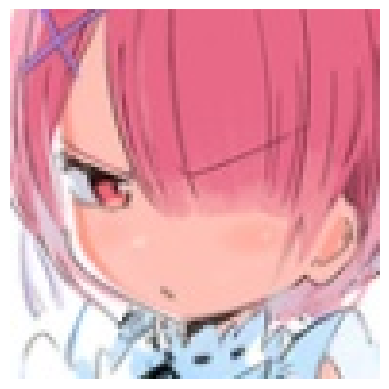

Label verdadera: Ram-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Ram-Re Zero : 98.52 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.35 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.33 % confianza.
> Emilia-Re Zero : 0.20 % confianza.
> Illyasviel Von Einzbern-Fate : 0.06 % confianza.


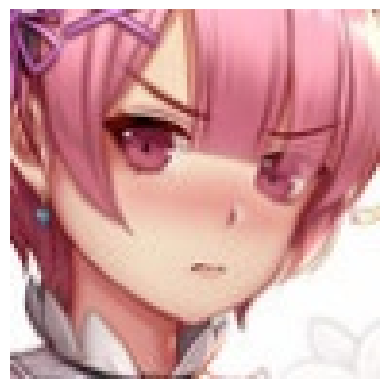

Label verdadera: Ram-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Astolfo-Fate : 34.85 % confianza.
> Ram-Re Zero : 18.81 % confianza.
> Keqing-Genshin Impact : 10.55 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 3.29 % confianza.
> Zero Two-Darling In the Franxx : 3.15 % confianza.


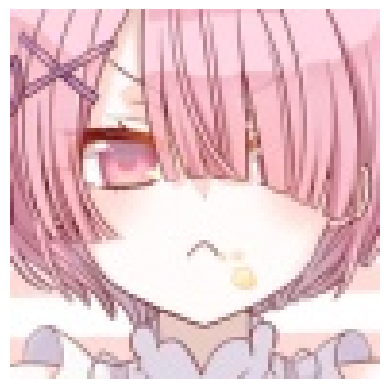

Label verdadera: Ram-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Astolfo-Fate : 18.37 % confianza.
> Miku Nakano-Quintessential Quintuplets : 14.51 % confianza.
> Zero Two-Darling In the Franxx : 13.81 % confianza.
> Nino Nakano-Quintessential Quintuplets : 9.13 % confianza.
> Kurisu Makise-Steins Gate : 8.31 % confianza.


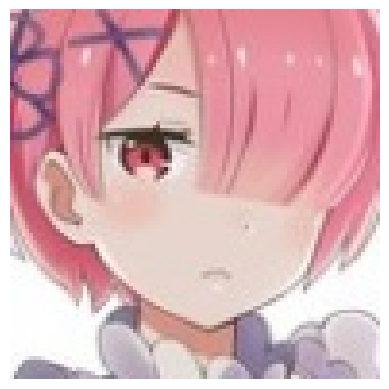

Label verdadera: Ram-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Ram-Re Zero : 99.43 % confianza.
> Keqing-Genshin Impact : 0.08 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.06 % confianza.
> Reimu Hakurei-Touhou : 0.05 % confianza.
> Astolfo-Fate : 0.04 % confianza.


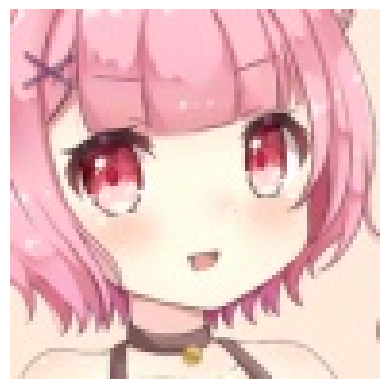

Label verdadera: Ram-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 39ms/step
> Ram-Re Zero : 38.64 % confianza.
> Astolfo-Fate : 14.70 % confianza.
> Zero Two-Darling In the Franxx : 3.57 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 3.41 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 2.94 % confianza.


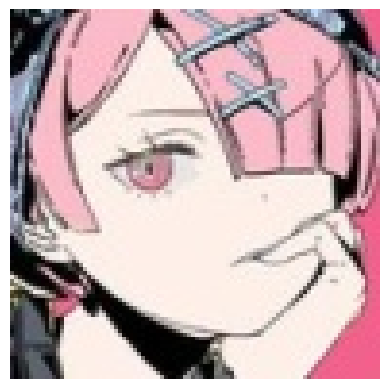

Label verdadera: Ram-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Nezuko Kamado-Demon Slayer : 53.28 % confianza.
> Zero Two-Darling In the Franxx : 8.17 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 7.30 % confianza.
> Nino Nakano-Quintessential Quintuplets : 4.35 % confianza.
> Hatsune Miku-Vocaloid : 3.84 % confianza.


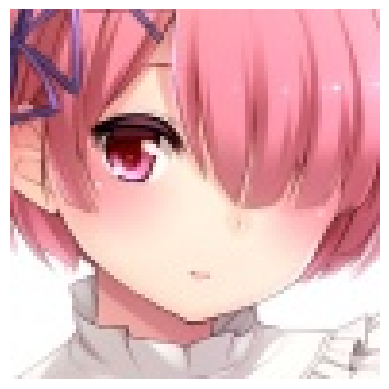

Label verdadera: Ram-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 50ms/step
> Ram-Re Zero : 96.97 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.67 % confianza.
> Asuna Yuuki-Sword Art Online : 0.36 % confianza.
> Reimu Hakurei-Touhou : 0.32 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.20 % confianza.


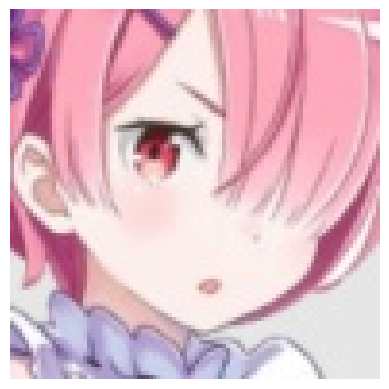

Label verdadera: Ram-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Ram-Re Zero : 95.48 % confianza.
> Scarlet Remilia-Touhou : 1.15 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.46 % confianza.
> Reimu Hakurei-Touhou : 0.42 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.29 % confianza.


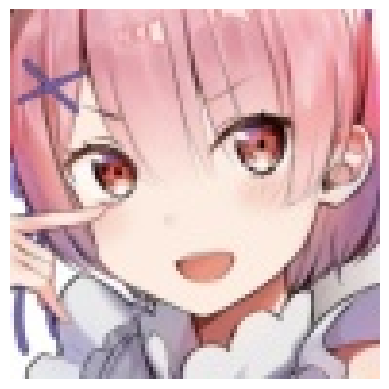

Label verdadera: Ram-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 32ms/step
> Ram-Re Zero : 71.18 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 22.98 % confianza.
> Nezuko Kamado-Demon Slayer : 0.89 % confianza.
> Illyasviel Von Einzbern-Fate : 0.49 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.48 % confianza.


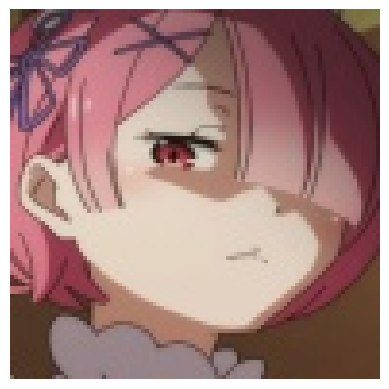

Label verdadera: Ram-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Ram-Re Zero : 39.62 % confianza.
> Megumin-Konosuba : 18.84 % confianza.
> Nezuko Kamado-Demon Slayer : 9.68 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 8.04 % confianza.
> Raphtalia-Rising of the Shield Hero : 4.41 % confianza.


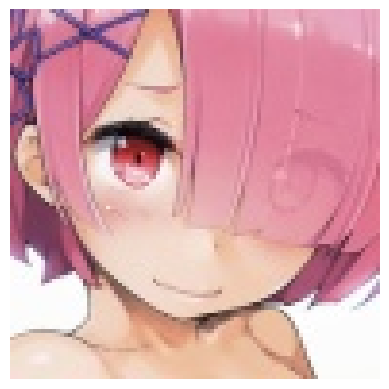

Label verdadera: Ram-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Ram-Re Zero : 98.32 % confianza.
> Illyasviel Von Einzbern-Fate : 0.23 % confianza.
> Keqing-Genshin Impact : 0.17 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.16 % confianza.
> Arcueid Brunestud-Tsukihime : 0.14 % confianza.


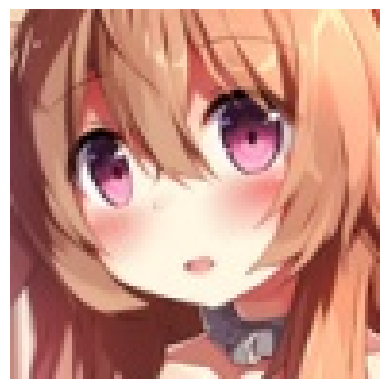

Label verdadera: Raphtalia-Rising of the Shield Hero
Este personaje posiblemente es:
1/1 [==============================] - 0s 33ms/step
> Raphtalia-Rising of the Shield Hero : 79.19 % confianza.
> Astolfo-Fate : 16.99 % confianza.
> Megumin-Konosuba : 0.53 % confianza.
> Asuna Yuuki-Sword Art Online : 0.34 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.30 % confianza.


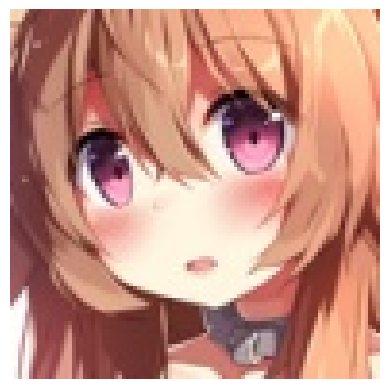

Label verdadera: Raphtalia-Rising of the Shield Hero
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Raphtalia-Rising of the Shield Hero : 82.66 % confianza.
> Astolfo-Fate : 13.51 % confianza.
> Megumin-Konosuba : 0.50 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.45 % confianza.
> Asuna Yuuki-Sword Art Online : 0.27 % confianza.


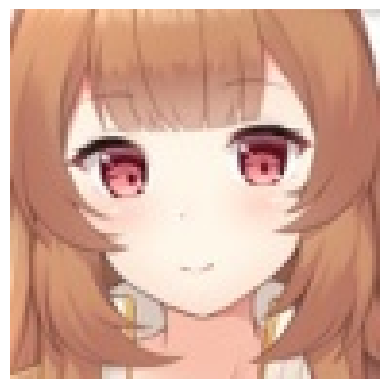

Label verdadera: Raphtalia-Rising of the Shield Hero
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Raphtalia-Rising of the Shield Hero : 98.03 % confianza.
> Asuna Yuuki-Sword Art Online : 0.41 % confianza.
> Megumin-Konosuba : 0.24 % confianza.
> Astolfo-Fate : 0.14 % confianza.
> Nami-One Piece : 0.12 % confianza.


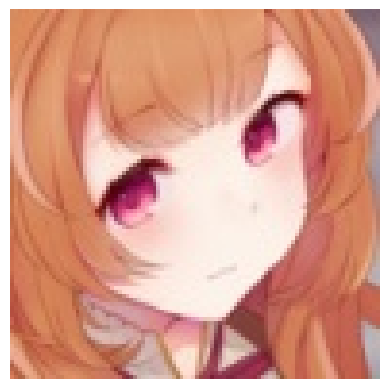

Label verdadera: Raphtalia-Rising of the Shield Hero
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Raphtalia-Rising of the Shield Hero : 98.47 % confianza.
> Asuna Yuuki-Sword Art Online : 0.33 % confianza.
> Megumin-Konosuba : 0.14 % confianza.
> Emilia-Re Zero : 0.11 % confianza.
> Nami-One Piece : 0.08 % confianza.


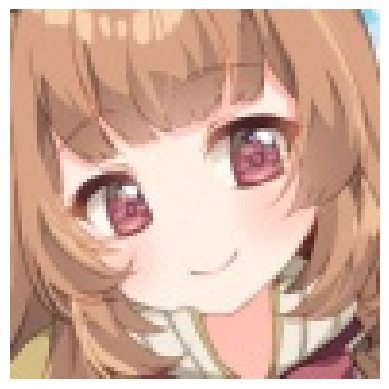

Label verdadera: Raphtalia-Rising of the Shield Hero
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Raphtalia-Rising of the Shield Hero : 91.14 % confianza.
> Megumin-Konosuba : 1.56 % confianza.
> Asuna Yuuki-Sword Art Online : 1.38 % confianza.
> Astolfo-Fate : 0.97 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.35 % confianza.


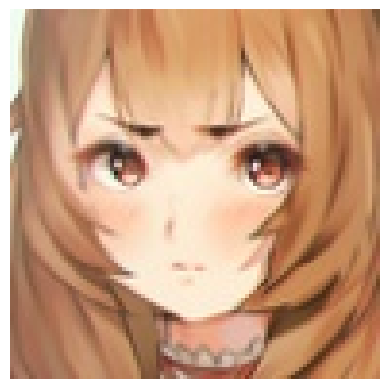

Label verdadera: Raphtalia-Rising of the Shield Hero
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Asuna Yuuki-Sword Art Online : 89.95 % confianza.
> Raphtalia-Rising of the Shield Hero : 7.23 % confianza.
> Nami-One Piece : 1.58 % confianza.
> Megumin-Konosuba : 0.36 % confianza.
> Aisaka Taiga-Toradora : 0.09 % confianza.


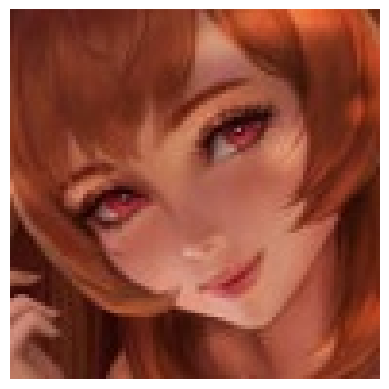

Label verdadera: Raphtalia-Rising of the Shield Hero
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Raphtalia-Rising of the Shield Hero : 86.78 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 2.25 % confianza.
> Emilia-Re Zero : 1.41 % confianza.
> Megumin-Konosuba : 1.30 % confianza.
> Aegis-Persona : 1.28 % confianza.


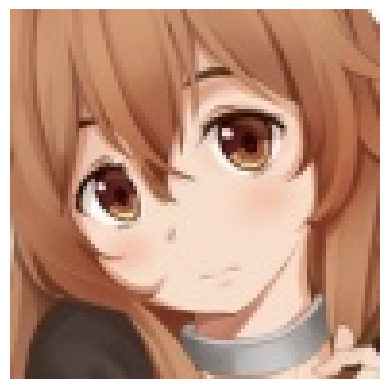

Label verdadera: Raphtalia-Rising of the Shield Hero
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Raphtalia-Rising of the Shield Hero : 60.07 % confianza.
> Asuna Yuuki-Sword Art Online : 25.34 % confianza.
> Megumin-Konosuba : 5.47 % confianza.
> Nami-One Piece : 1.06 % confianza.
> Aisaka Taiga-Toradora : 0.52 % confianza.


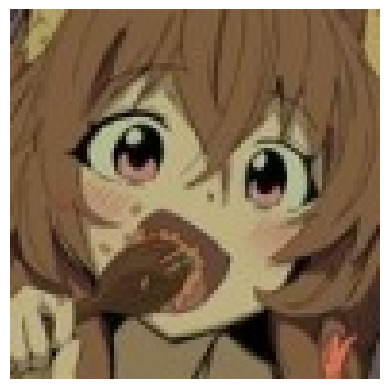

Label verdadera: Raphtalia-Rising of the Shield Hero
Este personaje posiblemente es:
1/1 [==============================] - 0s 33ms/step
> Raphtalia-Rising of the Shield Hero : 71.73 % confianza.
> Aisaka Taiga-Toradora : 6.30 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 4.56 % confianza.
> Shirley Fenette-Code Geass : 3.62 % confianza.
> Astolfo-Fate : 2.08 % confianza.


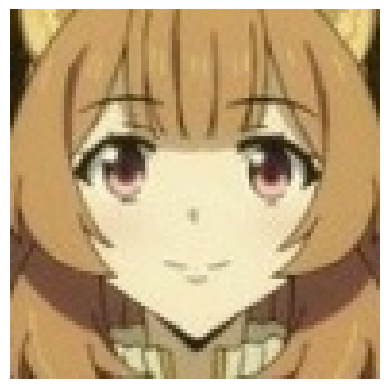

Label verdadera: Raphtalia-Rising of the Shield Hero
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Raphtalia-Rising of the Shield Hero : 53.28 % confianza.
> Asuna Yuuki-Sword Art Online : 36.09 % confianza.
> Maki Nishikino-Love Live : 1.31 % confianza.
> Nami-One Piece : 0.92 % confianza.
> Megumin-Konosuba : 0.79 % confianza.


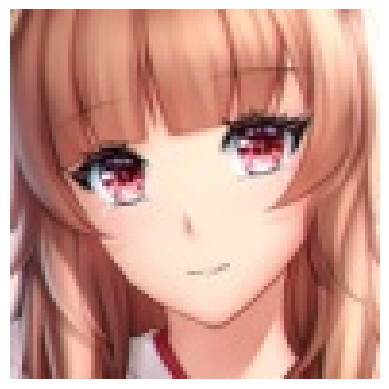

Label verdadera: Raphtalia-Rising of the Shield Hero
Este personaje posiblemente es:
1/1 [==============================] - 0s 34ms/step
> Raphtalia-Rising of the Shield Hero : 88.09 % confianza.
> Asuna Yuuki-Sword Art Online : 2.23 % confianza.
> Astolfo-Fate : 1.86 % confianza.
> Megumin-Konosuba : 0.82 % confianza.
> Amelia Watson-Hololive : 0.50 % confianza.


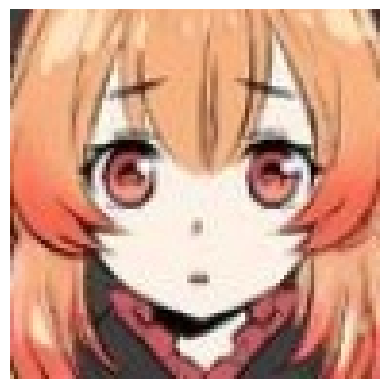

Label verdadera: Raphtalia-Rising of the Shield Hero
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Asuna Yuuki-Sword Art Online : 71.52 % confianza.
> Raphtalia-Rising of the Shield Hero : 24.50 % confianza.
> Nami-One Piece : 0.62 % confianza.
> Astolfo-Fate : 0.60 % confianza.
> Aegis-Persona : 0.31 % confianza.


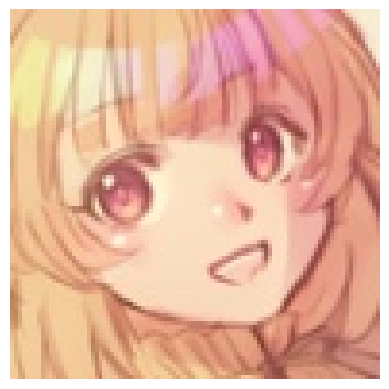

Label verdadera: Raphtalia-Rising of the Shield Hero
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Raphtalia-Rising of the Shield Hero : 55.77 % confianza.
> Astolfo-Fate : 22.14 % confianza.
> Asuna Yuuki-Sword Art Online : 8.77 % confianza.
> Amelia Watson-Hololive : 1.49 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 1.31 % confianza.


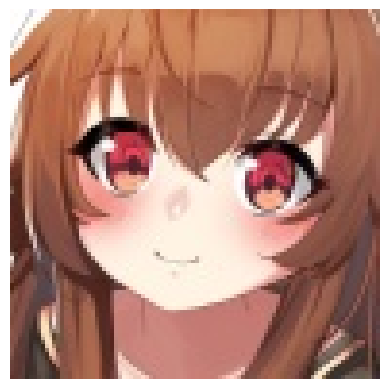

Label verdadera: Raphtalia-Rising of the Shield Hero
Este personaje posiblemente es:
1/1 [==============================] - 0s 32ms/step
> Raphtalia-Rising of the Shield Hero : 88.04 % confianza.
> Megumin-Konosuba : 10.51 % confianza.
> Kurisu Makise-Steins Gate : 0.33 % confianza.
> Keqing-Genshin Impact : 0.11 % confianza.
> Asuna Yuuki-Sword Art Online : 0.10 % confianza.


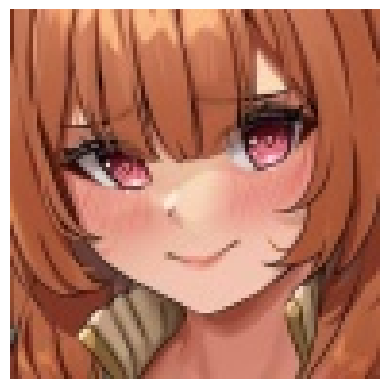

Label verdadera: Raphtalia-Rising of the Shield Hero
Este personaje posiblemente es:
1/1 [==============================] - 0s 32ms/step
> Raphtalia-Rising of the Shield Hero : 96.20 % confianza.
> Astolfo-Fate : 0.46 % confianza.
> Keqing-Genshin Impact : 0.33 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 0.29 % confianza.
> Aisaka Taiga-Toradora : 0.28 % confianza.


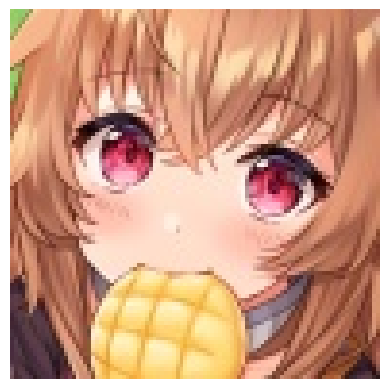

Label verdadera: Raphtalia-Rising of the Shield Hero
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Raphtalia-Rising of the Shield Hero : 73.47 % confianza.
> Megumin-Konosuba : 8.30 % confianza.
> Asuna Yuuki-Sword Art Online : 2.07 % confianza.
> Aisaka Taiga-Toradora : 1.09 % confianza.
> Aegis-Persona : 0.84 % confianza.


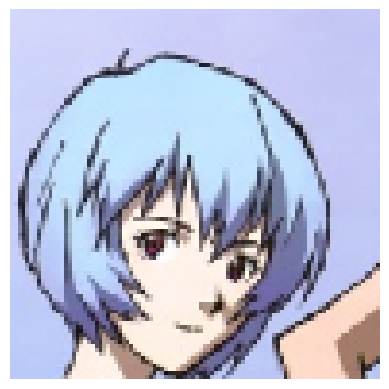

Label verdadera: Rei Ayanami-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Rei Ayanami-Neon Genesis Evangelion : 85.07 % confianza.
> Sakuya Izayoi-Touhou : 4.65 % confianza.
> Illyasviel Von Einzbern-Fate : 2.87 % confianza.
> Cirno-Touhou : 2.20 % confianza.
> Sakura Matou-Fate : 0.47 % confianza.


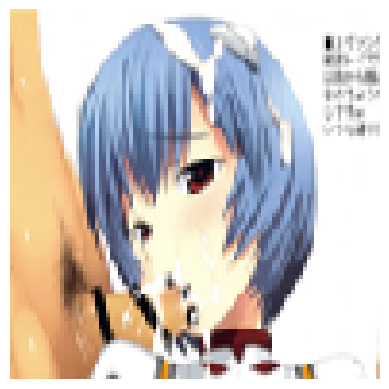

Label verdadera: Rei Ayanami-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Rei Ayanami-Neon Genesis Evangelion : 88.34 % confianza.
> Sakuya Izayoi-Touhou : 7.63 % confianza.
> Cirno-Touhou : 1.10 % confianza.
> Illyasviel Von Einzbern-Fate : 0.43 % confianza.
> Konata Izumi-Lucky Star : 0.37 % confianza.


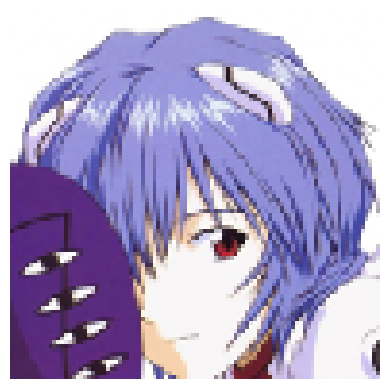

Label verdadera: Rei Ayanami-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Rei Ayanami-Neon Genesis Evangelion : 58.06 % confianza.
> Sakuya Izayoi-Touhou : 27.57 % confianza.
> Sakura Matou-Fate : 3.95 % confianza.
> Illyasviel Von Einzbern-Fate : 1.00 % confianza.
> Scarlet Remilia-Touhou : 0.74 % confianza.


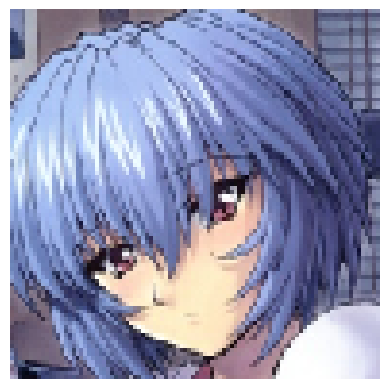

Label verdadera: Rei Ayanami-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Rei Ayanami-Neon Genesis Evangelion : 97.67 % confianza.
> Sakuya Izayoi-Touhou : 1.81 % confianza.
> Illyasviel Von Einzbern-Fate : 0.10 % confianza.
> Scarlet Remilia-Touhou : 0.08 % confianza.
> Lelouch Lamperouge-Code Geass : 0.03 % confianza.


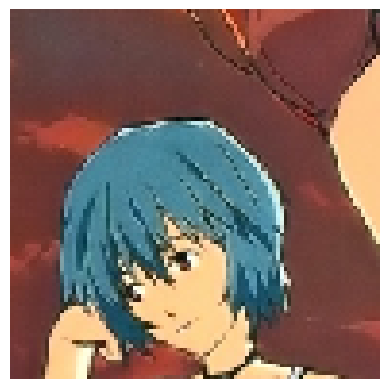

Label verdadera: Rei Ayanami-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Hatsune Miku-Vocaloid : 31.04 % confianza.
> Sakuya Izayoi-Touhou : 27.31 % confianza.
> Cirno-Touhou : 14.41 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 13.85 % confianza.
> Sakura Matou-Fate : 1.61 % confianza.


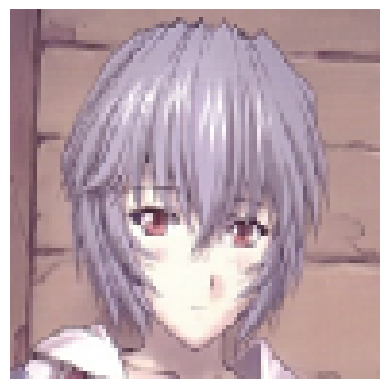

Label verdadera: Rei Ayanami-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Rei Ayanami-Neon Genesis Evangelion : 31.60 % confianza.
> Sakuya Izayoi-Touhou : 19.83 % confianza.
> Illyasviel Von Einzbern-Fate : 16.64 % confianza.
> Scarlet Remilia-Touhou : 8.14 % confianza.
> Arcueid Brunestud-Tsukihime : 3.28 % confianza.


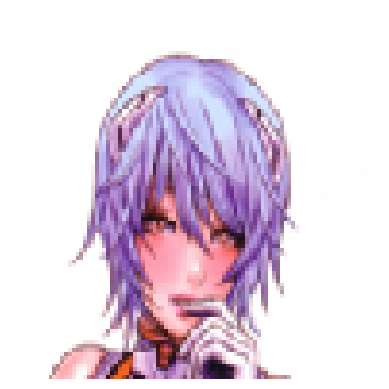

Label verdadera: Rei Ayanami-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Rei Ayanami-Neon Genesis Evangelion : 69.80 % confianza.
> Sakuya Izayoi-Touhou : 19.28 % confianza.
> Sakura Matou-Fate : 1.32 % confianza.
> Scarlet Remilia-Touhou : 0.85 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.73 % confianza.


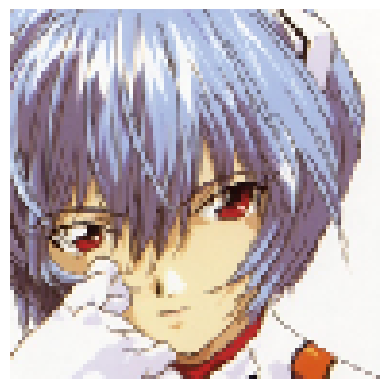

Label verdadera: Rei Ayanami-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Rei Ayanami-Neon Genesis Evangelion : 56.10 % confianza.
> Sakuya Izayoi-Touhou : 14.89 % confianza.
> Scarlet Remilia-Touhou : 8.52 % confianza.
> Illyasviel Von Einzbern-Fate : 2.14 % confianza.
> Lelouch Lamperouge-Code Geass : 2.11 % confianza.


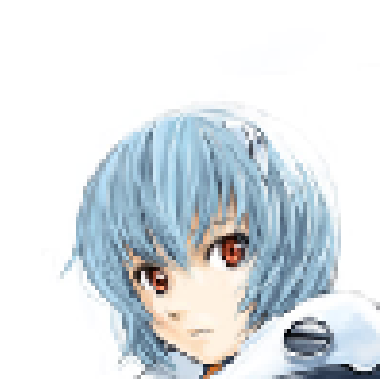

Label verdadera: Rei Ayanami-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 38ms/step
> Rei Ayanami-Neon Genesis Evangelion : 93.29 % confianza.
> Sakuya Izayoi-Touhou : 2.87 % confianza.
> Illyasviel Von Einzbern-Fate : 1.07 % confianza.
> Cirno-Touhou : 0.30 % confianza.
> Lelouch Lamperouge-Code Geass : 0.13 % confianza.


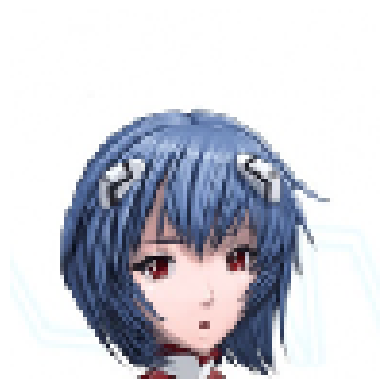

Label verdadera: Rei Ayanami-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Rei Ayanami-Neon Genesis Evangelion : 84.67 % confianza.
> Sakuya Izayoi-Touhou : 5.16 % confianza.
> Illyasviel Von Einzbern-Fate : 1.96 % confianza.
> Sakura Matou-Fate : 1.57 % confianza.
> Lelouch Lamperouge-Code Geass : 0.95 % confianza.


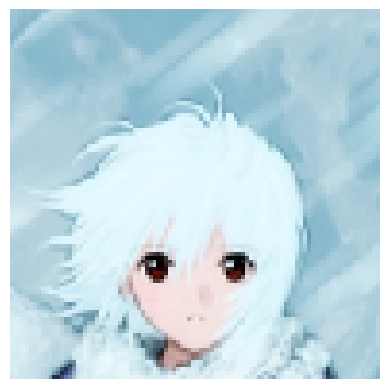

Label verdadera: Rei Ayanami-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Rei Ayanami-Neon Genesis Evangelion : 75.96 % confianza.
> Illyasviel Von Einzbern-Fate : 3.62 % confianza.
> Emilia-Re Zero : 3.38 % confianza.
> Rem-Re Zero : 1.88 % confianza.
> Asuna Yuuki-Sword Art Online : 1.18 % confianza.


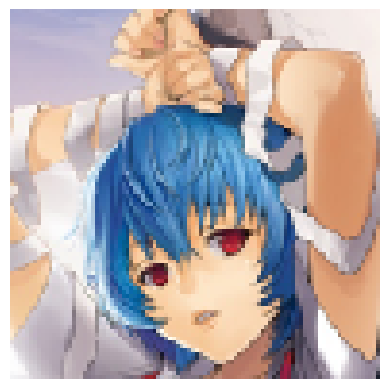

Label verdadera: Rei Ayanami-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Rei Ayanami-Neon Genesis Evangelion : 80.36 % confianza.
> Sakuya Izayoi-Touhou : 9.99 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 1.48 % confianza.
> Scarlet Remilia-Touhou : 1.18 % confianza.
> Konata Izumi-Lucky Star : 1.04 % confianza.


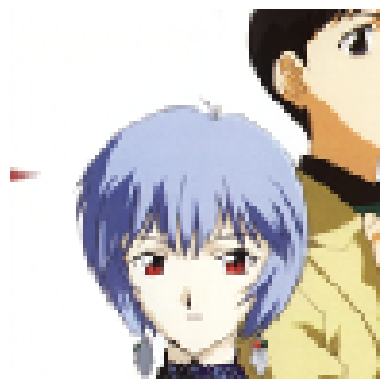

Label verdadera: Rei Ayanami-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 37ms/step
> Rei Ayanami-Neon Genesis Evangelion : 66.18 % confianza.
> Sakuya Izayoi-Touhou : 8.39 % confianza.
> Sakura Matou-Fate : 7.56 % confianza.
> Illyasviel Von Einzbern-Fate : 5.71 % confianza.
> Scarlet Remilia-Touhou : 2.08 % confianza.


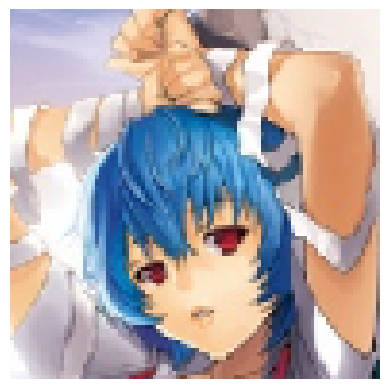

Label verdadera: Rei Ayanami-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Rei Ayanami-Neon Genesis Evangelion : 86.18 % confianza.
> Sakuya Izayoi-Touhou : 6.20 % confianza.
> Scarlet Remilia-Touhou : 1.58 % confianza.
> Cirno-Touhou : 0.80 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.69 % confianza.


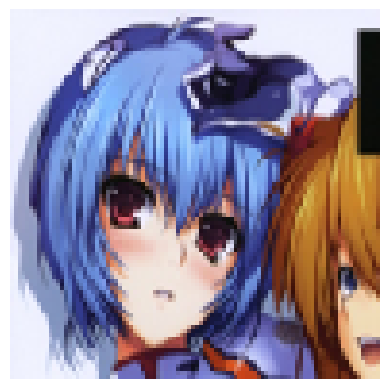

Label verdadera: Rei Ayanami-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 32ms/step
> Rei Ayanami-Neon Genesis Evangelion : 89.54 % confianza.
> Sakuya Izayoi-Touhou : 3.74 % confianza.
> Scarlet Remilia-Touhou : 2.18 % confianza.
> Illyasviel Von Einzbern-Fate : 0.47 % confianza.
> Albedo-Overlord : 0.30 % confianza.


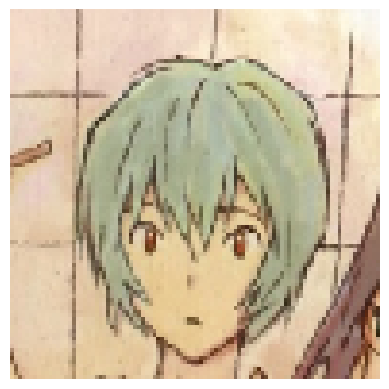

Label verdadera: Rei Ayanami-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 32ms/step
> C.C-Code Geass : 31.22 % confianza.
> Illyasviel Von Einzbern-Fate : 14.05 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 10.37 % confianza.
> Lelouch Lamperouge-Code Geass : 4.58 % confianza.
> Arcueid Brunestud-Tsukihime : 2.61 % confianza.


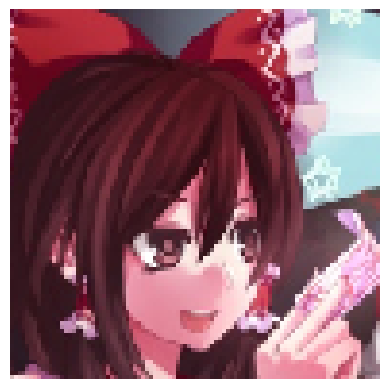

Label verdadera: Reimu Hakurei-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Reimu Hakurei-Touhou : 73.61 % confianza.
> Lelouch Lamperouge-Code Geass : 18.48 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.73 % confianza.
> Megumin-Konosuba : 0.62 % confianza.
> Suzaku Kururugi-Code Geass : 0.58 % confianza.


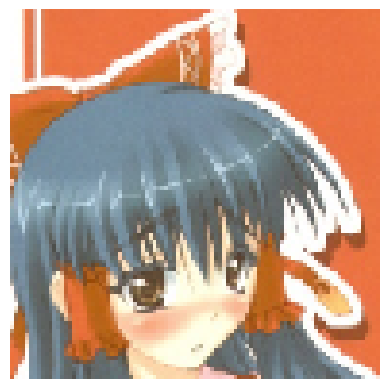

Label verdadera: Reimu Hakurei-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Sakuya Izayoi-Touhou : 50.95 % confianza.
> Reimu Hakurei-Touhou : 13.32 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 5.85 % confianza.
> Scarlet Remilia-Touhou : 4.98 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 1.97 % confianza.


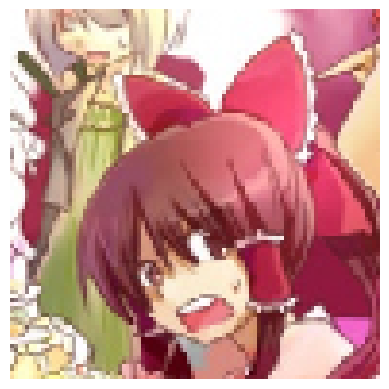

Label verdadera: Reimu Hakurei-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 38ms/step
> Reimu Hakurei-Touhou : 99.47 % confianza.
> Lelouch Lamperouge-Code Geass : 0.17 % confianza.
> Ram-Re Zero : 0.03 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.03 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 0.03 % confianza.


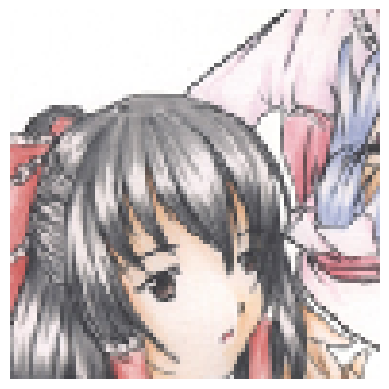

Label verdadera: Reimu Hakurei-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Reimu Hakurei-Touhou : 59.27 % confianza.
> Sakuya Izayoi-Touhou : 13.31 % confianza.
> Lelouch Lamperouge-Code Geass : 11.97 % confianza.
> Rin Tohsakaka-Fate : 3.20 % confianza.
> Shiki Ryougi-Garden of Sinners : 1.79 % confianza.


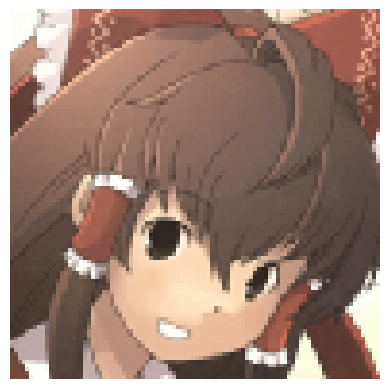

Label verdadera: Reimu Hakurei-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Reimu Hakurei-Touhou : 36.49 % confianza.
> Shouko Komi-Komi Cant Communicate : 36.10 % confianza.
> Aisaka Taiga-Toradora : 3.91 % confianza.
> Yui Hirasawa-K ON! : 2.96 % confianza.
> Megumin-Konosuba : 2.01 % confianza.


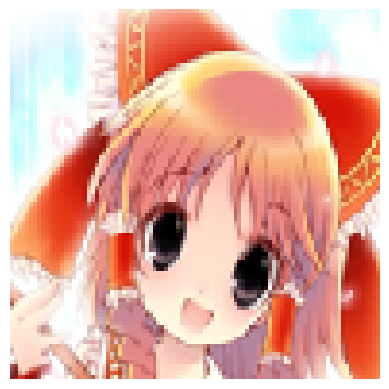

Label verdadera: Reimu Hakurei-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 40ms/step
> Reimu Hakurei-Touhou : 15.90 % confianza.
> Aisaka Taiga-Toradora : 11.68 % confianza.
> Sakuya Izayoi-Touhou : 8.28 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 8.09 % confianza.
> Flandre Scarlet-Touhou : 4.22 % confianza.


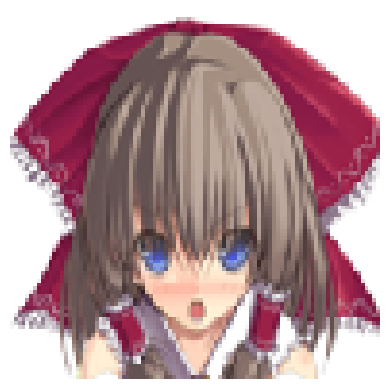

Label verdadera: Reimu Hakurei-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Reimu Hakurei-Touhou : 41.42 % confianza.
> Nino Nakano-Quintessential Quintuplets : 6.94 % confianza.
> Lelouch Lamperouge-Code Geass : 5.83 % confianza.
> Suzaku Kururugi-Code Geass : 3.80 % confianza.
> Rin Tohsakaka-Fate : 3.72 % confianza.


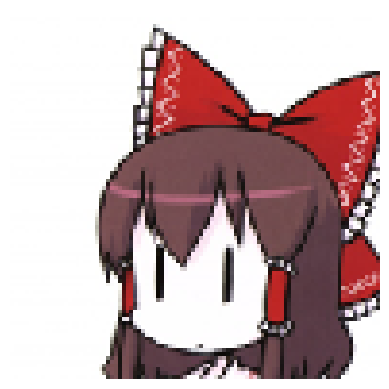

Label verdadera: Reimu Hakurei-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Reimu Hakurei-Touhou : 93.11 % confianza.
> Shiki Ryougi-Garden of Sinners : 1.65 % confianza.
> Rin Tohsakaka-Fate : 0.87 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.52 % confianza.
> Kallen Stadtfeld-Code Geass : 0.38 % confianza.


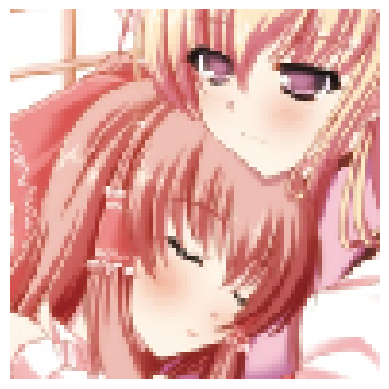

Label verdadera: Reimu Hakurei-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Scarlet Remilia-Touhou : 21.43 % confianza.
> Arcueid Brunestud-Tsukihime : 13.29 % confianza.
> Reimu Hakurei-Touhou : 11.26 % confianza.
> Hatsune Miku-Vocaloid : 7.02 % confianza.
> Rin Tohsakaka-Fate : 6.03 % confianza.


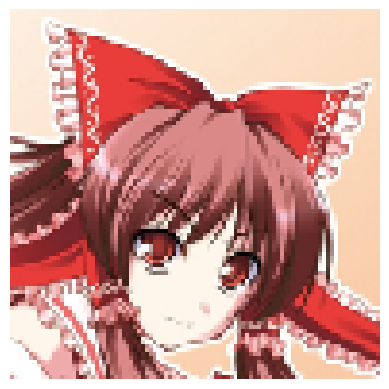

Label verdadera: Reimu Hakurei-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 32ms/step
> Reimu Hakurei-Touhou : 95.70 % confianza.
> Lelouch Lamperouge-Code Geass : 0.68 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.28 % confianza.
> Aisaka Taiga-Toradora : 0.22 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.20 % confianza.


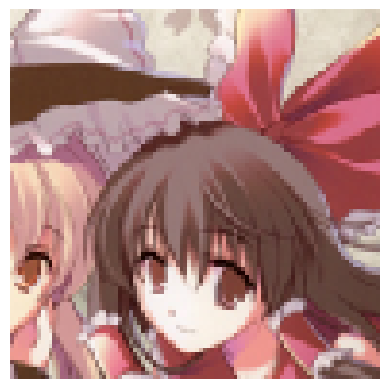

Label verdadera: Reimu Hakurei-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Reimu Hakurei-Touhou : 55.05 % confianza.
> Lelouch Lamperouge-Code Geass : 34.00 % confianza.
> Scarlet Remilia-Touhou : 0.71 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.62 % confianza.
> Ram-Re Zero : 0.60 % confianza.


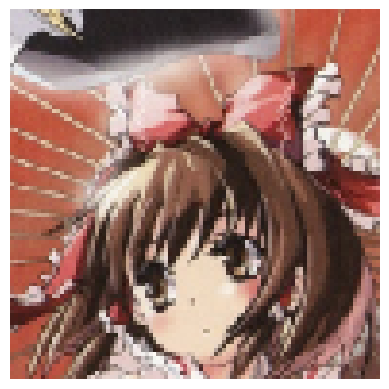

Label verdadera: Reimu Hakurei-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Reimu Hakurei-Touhou : 80.36 % confianza.
> Lelouch Lamperouge-Code Geass : 5.68 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 2.36 % confianza.
> Suzaku Kururugi-Code Geass : 1.99 % confianza.
> Aisaka Taiga-Toradora : 1.83 % confianza.


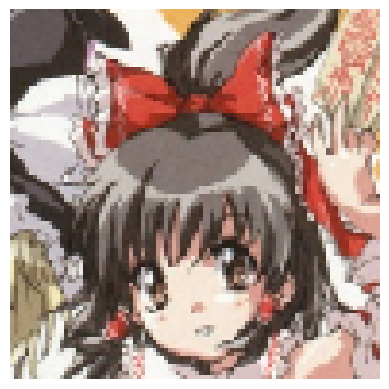

Label verdadera: Reimu Hakurei-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Reimu Hakurei-Touhou : 93.54 % confianza.
> Lelouch Lamperouge-Code Geass : 4.17 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.48 % confianza.
> Scarlet Remilia-Touhou : 0.17 % confianza.
> Rin Tohsakaka-Fate : 0.16 % confianza.


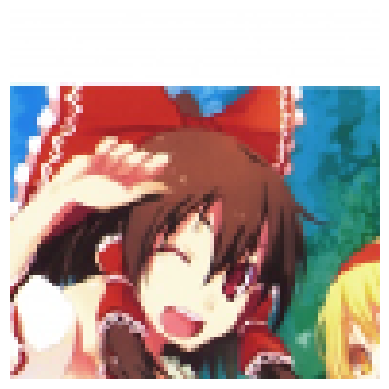

Label verdadera: Reimu Hakurei-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Reimu Hakurei-Touhou : 54.21 % confianza.
> Yoko Littner-Gurrenn Lagann : 23.56 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 3.68 % confianza.
> Lelouch Lamperouge-Code Geass : 2.32 % confianza.
> Rin Tohsakaka-Fate : 2.03 % confianza.


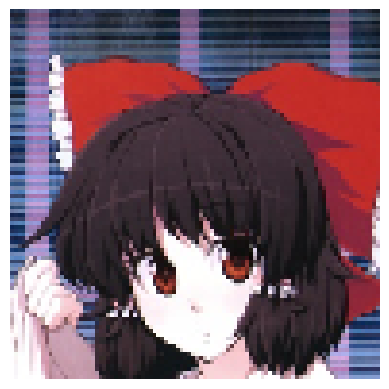

Label verdadera: Reimu Hakurei-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Reimu Hakurei-Touhou : 79.28 % confianza.
> Lelouch Lamperouge-Code Geass : 9.96 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 1.58 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.59 % confianza.
> Suzaku Kururugi-Code Geass : 0.52 % confianza.


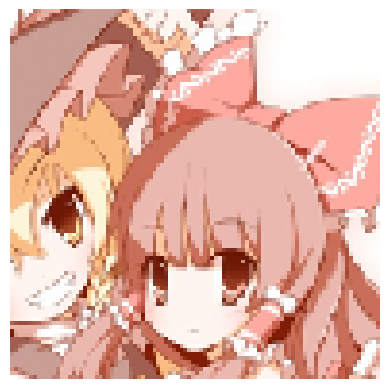

Label verdadera: Reimu Hakurei-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Reimu Hakurei-Touhou : 51.27 % confianza.
> Flandre Scarlet-Touhou : 18.85 % confianza.
> Scarlet Remilia-Touhou : 4.66 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 3.46 % confianza.
> Asuna Yuuki-Sword Art Online : 1.93 % confianza.


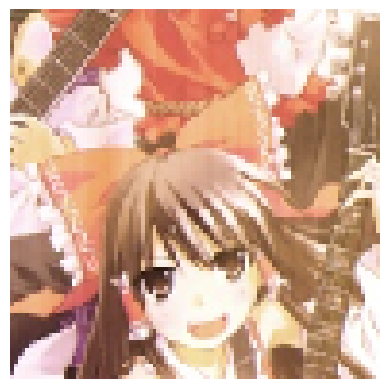

Label verdadera: Reimu Hakurei-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Reimu Hakurei-Touhou : 75.80 % confianza.
> Arcueid Brunestud-Tsukihime : 4.12 % confianza.
> Aisaka Taiga-Toradora : 2.03 % confianza.
> Scarlet Remilia-Touhou : 1.77 % confianza.
> Flandre Scarlet-Touhou : 1.74 % confianza.


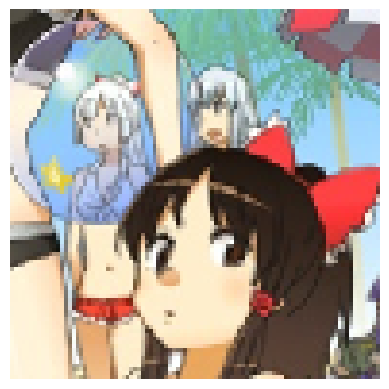

Label verdadera: Reimu Hakurei-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Rin Tohsakaka-Fate : 28.20 % confianza.
> Reimu Hakurei-Touhou : 20.63 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 17.70 % confianza.
> Shiki Ryougi-Garden of Sinners : 6.93 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 5.97 % confianza.


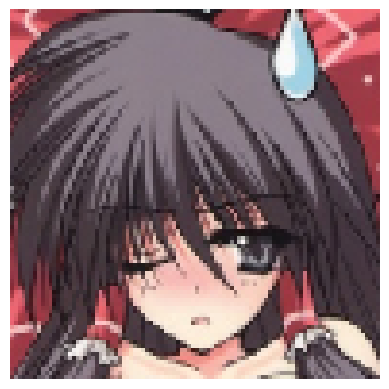

Label verdadera: Reimu Hakurei-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 37ms/step
> Reimu Hakurei-Touhou : 50.95 % confianza.
> Lelouch Lamperouge-Code Geass : 34.73 % confianza.
> Scarlet Remilia-Touhou : 1.55 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.80 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.78 % confianza.


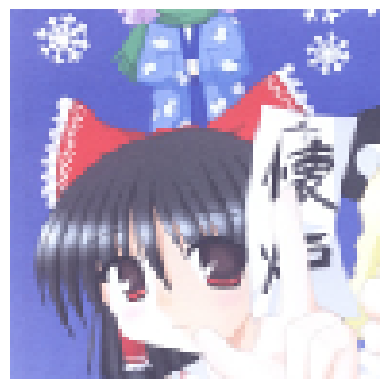

Label verdadera: Reimu Hakurei-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Reimu Hakurei-Touhou : 97.58 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.38 % confianza.
> Scarlet Remilia-Touhou : 0.22 % confianza.
> Lelouch Lamperouge-Code Geass : 0.17 % confianza.
> Ouro Kronii-Hololive : 0.16 % confianza.


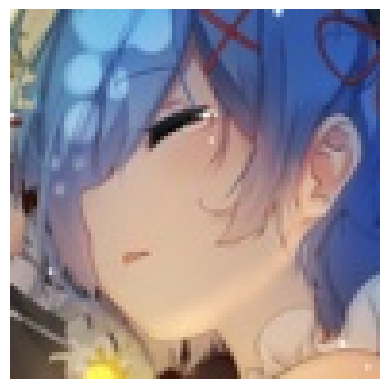

Label verdadera: Rem-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Rem-Re Zero : 25.15 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 15.68 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 11.67 % confianza.
> Emilia-Re Zero : 4.87 % confianza.
> Aqua-Konosuba : 4.54 % confianza.


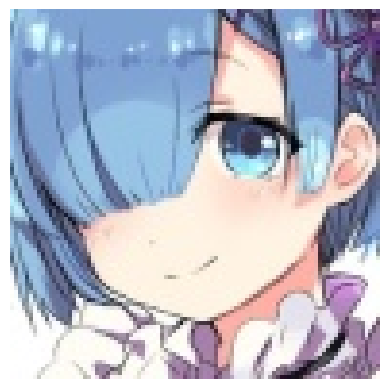

Label verdadera: Rem-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Rem-Re Zero : 82.97 % confianza.
> Sinon-Sword Art Online : 7.43 % confianza.
> Cirno-Touhou : 3.20 % confianza.
> Aqua-Konosuba : 1.57 % confianza.
> Ouro Kronii-Hololive : 1.17 % confianza.


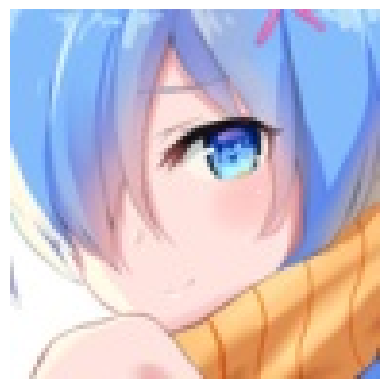

Label verdadera: Rem-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Rem-Re Zero : 55.79 % confianza.
> Aqua-Konosuba : 34.55 % confianza.
> Sinon-Sword Art Online : 2.05 % confianza.
> Nami-One Piece : 0.89 % confianza.
> Emilia-Re Zero : 0.65 % confianza.


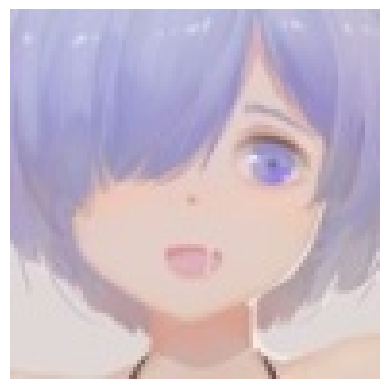

Label verdadera: Rem-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Emilia-Re Zero : 20.68 % confianza.
> Rem-Re Zero : 16.80 % confianza.
> Keqing-Genshin Impact : 12.31 % confianza.
> Hinata Hyuuga-Naruto : 5.41 % confianza.
> Aqua-Konosuba : 3.88 % confianza.


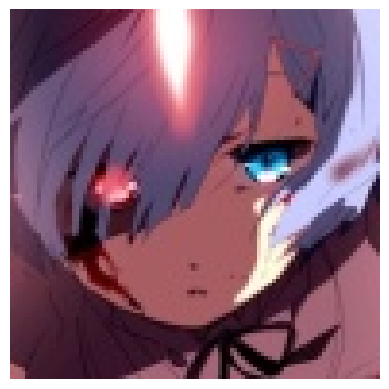

Label verdadera: Rem-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Scarlet Remilia-Touhou : 27.13 % confianza.
> Miku Nakano-Quintessential Quintuplets : 12.92 % confianza.
> Megumin-Konosuba : 11.24 % confianza.
> Albedo-Overlord : 4.52 % confianza.
> Zero Two-Darling In the Franxx : 4.36 % confianza.


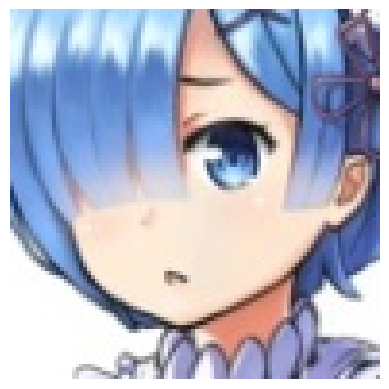

Label verdadera: Rem-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Aqua-Konosuba : 50.01 % confianza.
> Rem-Re Zero : 32.13 % confianza.
> Sinon-Sword Art Online : 6.87 % confianza.
> Cirno-Touhou : 2.16 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 1.26 % confianza.


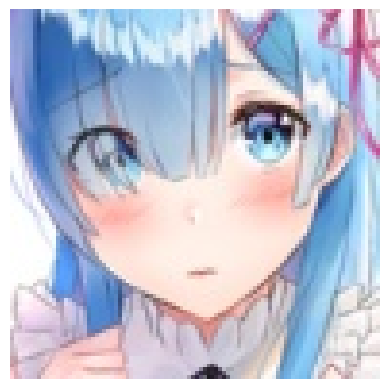

Label verdadera: Rem-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Rem-Re Zero : 54.99 % confianza.
> Aqua-Konosuba : 32.68 % confianza.
> Sinon-Sword Art Online : 6.69 % confianza.
> Gawr Gura-Hololive : 1.38 % confianza.
> Aegis-Persona : 0.31 % confianza.


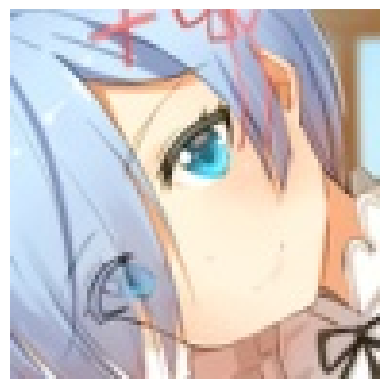

Label verdadera: Rem-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Sinon-Sword Art Online : 45.27 % confianza.
> Aqua-Konosuba : 31.81 % confianza.
> Rem-Re Zero : 18.08 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 1.04 % confianza.
> Miku Nakano-Quintessential Quintuplets : 0.72 % confianza.


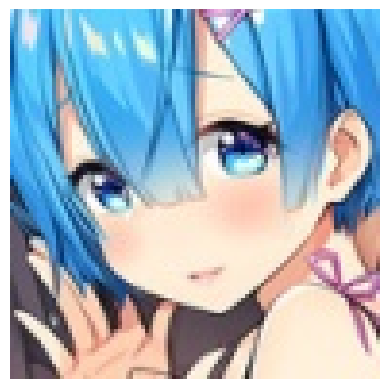

Label verdadera: Rem-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Rem-Re Zero : 38.70 % confianza.
> Aqua-Konosuba : 35.56 % confianza.
> Sinon-Sword Art Online : 8.09 % confianza.
> Cirno-Touhou : 4.62 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 1.36 % confianza.


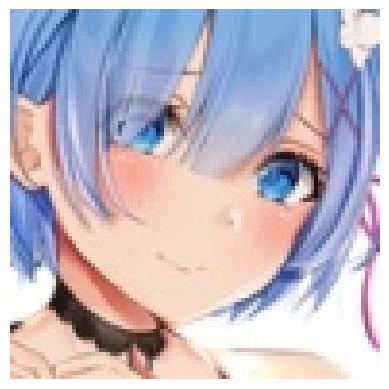

Label verdadera: Rem-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 40ms/step
> Rem-Re Zero : 56.07 % confianza.
> Aqua-Konosuba : 25.18 % confianza.
> Sinon-Sword Art Online : 8.02 % confianza.
> Cirno-Touhou : 1.36 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 1.21 % confianza.


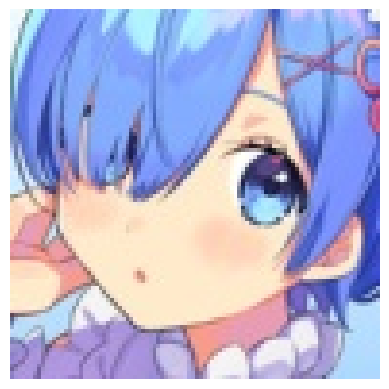

Label verdadera: Rem-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Rem-Re Zero : 84.45 % confianza.
> Aqua-Konosuba : 8.72 % confianza.
> Keqing-Genshin Impact : 2.16 % confianza.
> Sinon-Sword Art Online : 0.57 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.37 % confianza.


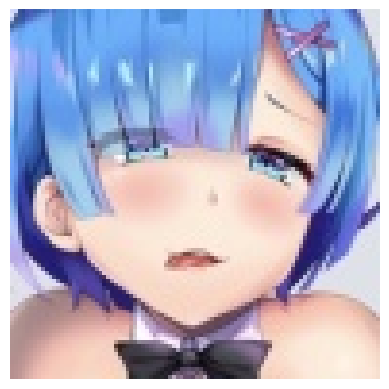

Label verdadera: Rem-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Rem-Re Zero : 91.71 % confianza.
> Keqing-Genshin Impact : 1.46 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 1.02 % confianza.
> Aqua-Konosuba : 0.53 % confianza.
> Ouro Kronii-Hololive : 0.44 % confianza.


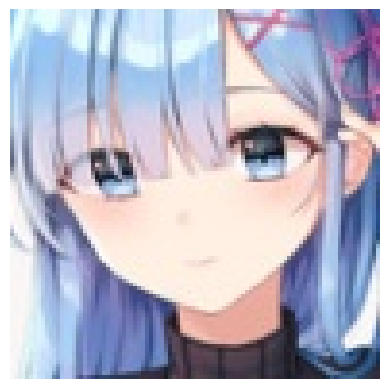

Label verdadera: Rem-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Aqua-Konosuba : 60.16 % confianza.
> Rem-Re Zero : 30.88 % confianza.
> Sinon-Sword Art Online : 4.39 % confianza.
> Paimon-Genshin Impact : 0.50 % confianza.
> Emilia-Re Zero : 0.46 % confianza.


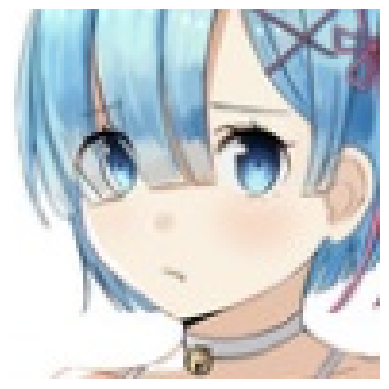

Label verdadera: Rem-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Sinon-Sword Art Online : 89.86 % confianza.
> Aqua-Konosuba : 4.96 % confianza.
> Rem-Re Zero : 1.62 % confianza.
> Gawr Gura-Hololive : 0.31 % confianza.
> Paimon-Genshin Impact : 0.29 % confianza.


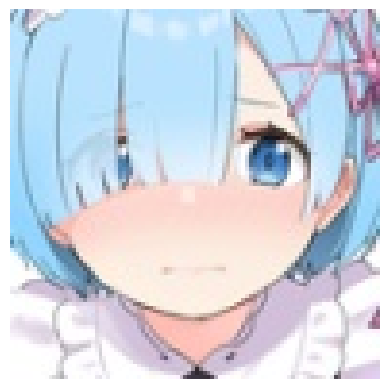

Label verdadera: Rem-Re Zero
Este personaje posiblemente es:
1/1 [==============================] - 0s 68ms/step
> Rem-Re Zero : 66.79 % confianza.
> Aqua-Konosuba : 16.47 % confianza.
> Sinon-Sword Art Online : 5.44 % confianza.
> Gawr Gura-Hololive : 2.22 % confianza.
> Paimon-Genshin Impact : 1.32 % confianza.


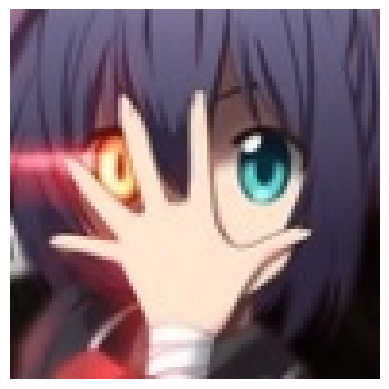

Label verdadera: Rikka Takanashi-Love, Chunibyo and Other Delusions!
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 98.29 % confianza.
> Nozomi Tojo-Love Live : 0.39 % confianza.
> Ouro Kronii-Hololive : 0.17 % confianza.
> Kirito-Sword Art Online : 0.11 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.07 % confianza.


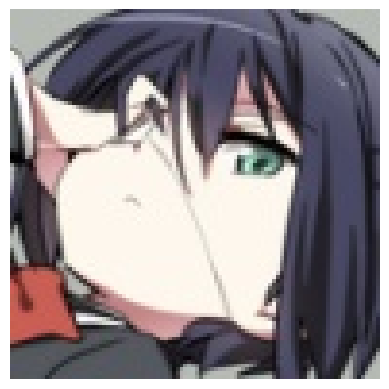

Label verdadera: Rikka Takanashi-Love, Chunibyo and Other Delusions!
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 24.37 % confianza.
> Nozomi Tojo-Love Live : 21.51 % confianza.
> Fubuki-One Punch Man : 7.19 % confianza.
> Shouko Komi-Komi Cant Communicate : 5.95 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 4.21 % confianza.


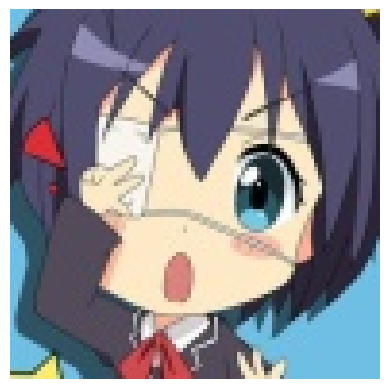

Label verdadera: Rikka Takanashi-Love, Chunibyo and Other Delusions!
Este personaje posiblemente es:
1/1 [==============================] - 0s 38ms/step
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 96.33 % confianza.
> Kirito-Sword Art Online : 0.96 % confianza.
> Ouro Kronii-Hololive : 0.72 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.14 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.14 % confianza.


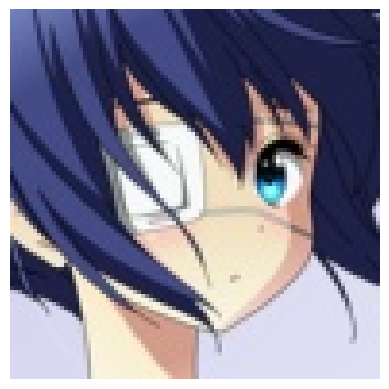

Label verdadera: Rikka Takanashi-Love, Chunibyo and Other Delusions!
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 67.45 % confianza.
> Ouro Kronii-Hololive : 5.71 % confianza.
> Nozomi Tojo-Love Live : 5.65 % confianza.
> Saber-Fate : 2.48 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 2.08 % confianza.


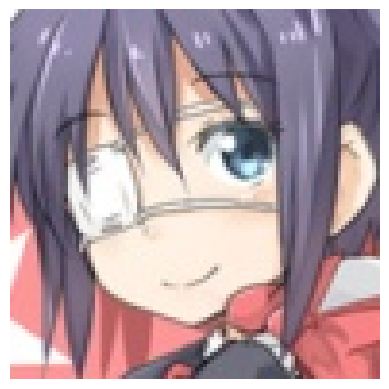

Label verdadera: Rikka Takanashi-Love, Chunibyo and Other Delusions!
Este personaje posiblemente es:
1/1 [==============================] - 0s 33ms/step
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 99.59 % confianza.
> Ouro Kronii-Hololive : 0.12 % confianza.
> Sakuya Izayoi-Touhou : 0.07 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.05 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.04 % confianza.


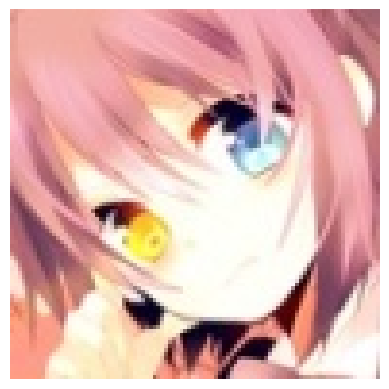

Label verdadera: Rikka Takanashi-Love, Chunibyo and Other Delusions!
Este personaje posiblemente es:
1/1 [==============================] - 0s 37ms/step
> Nino Nakano-Quintessential Quintuplets : 22.66 % confianza.
> Zero Two-Darling In the Franxx : 18.89 % confianza.
> Miku Nakano-Quintessential Quintuplets : 12.23 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 11.22 % confianza.
> Ram-Re Zero : 2.79 % confianza.


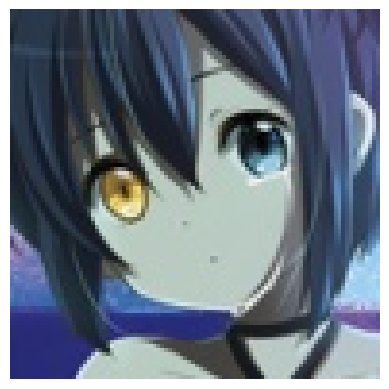

Label verdadera: Rikka Takanashi-Love, Chunibyo and Other Delusions!
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 29.09 % confianza.
> Lelouch Lamperouge-Code Geass : 17.27 % confianza.
> Aqua-Konosuba : 5.16 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 4.28 % confianza.
> C.C-Code Geass : 3.94 % confianza.


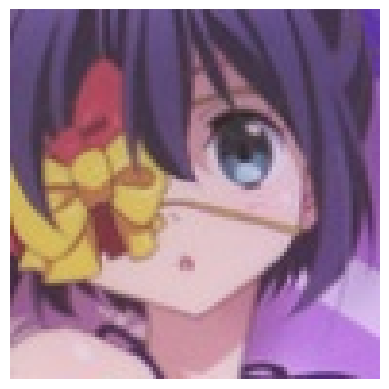

Label verdadera: Rikka Takanashi-Love, Chunibyo and Other Delusions!
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 72.37 % confianza.
> Sakura Matou-Fate : 3.36 % confianza.
> Nozomi Tojo-Love Live : 2.94 % confianza.
> Hinata Hyuuga-Naruto : 1.75 % confianza.
> Kagami Hiiragi-Lucky Star : 1.13 % confianza.


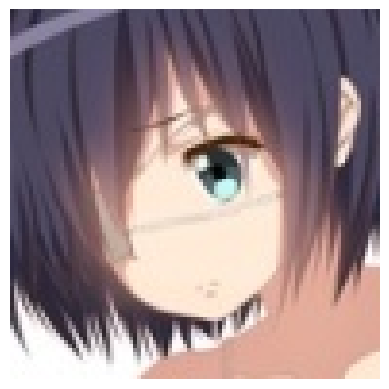

Label verdadera: Rikka Takanashi-Love, Chunibyo and Other Delusions!
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 83.15 % confianza.
> Saber-Fate : 2.08 % confianza.
> Ouro Kronii-Hololive : 2.03 % confianza.
> Shiki Ryougi-Garden of Sinners : 1.59 % confianza.
> Rin Tohsakaka-Fate : 1.45 % confianza.


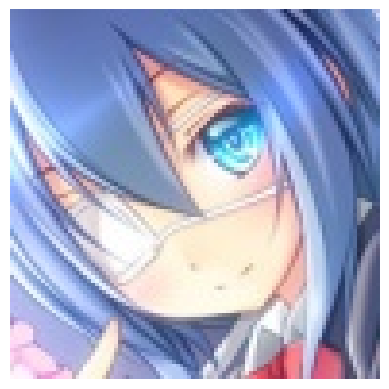

Label verdadera: Rikka Takanashi-Love, Chunibyo and Other Delusions!
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 86.78 % confianza.
> Aqua-Konosuba : 4.00 % confianza.
> Sinon-Sword Art Online : 1.68 % confianza.
> Rem-Re Zero : 1.42 % confianza.
> Nozomi Tojo-Love Live : 0.55 % confianza.


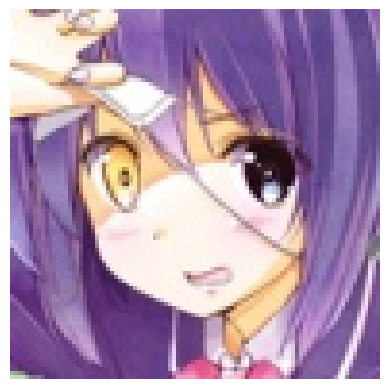

Label verdadera: Rikka Takanashi-Love, Chunibyo and Other Delusions!
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 74.74 % confianza.
> Hinata Hyuuga-Naruto : 6.32 % confianza.
> Nozomi Tojo-Love Live : 4.83 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 3.44 % confianza.
> Sakura Matou-Fate : 1.55 % confianza.


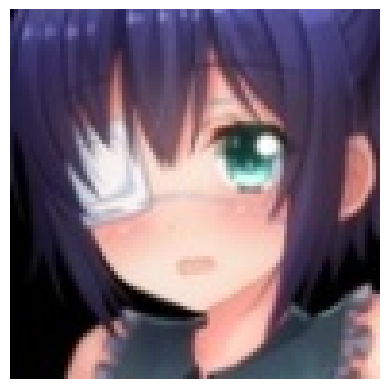

Label verdadera: Rikka Takanashi-Love, Chunibyo and Other Delusions!
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 98.12 % confianza.
> Ouro Kronii-Hololive : 0.76 % confianza.
> Nozomi Tojo-Love Live : 0.31 % confianza.
> Hinata Hyuuga-Naruto : 0.16 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.08 % confianza.


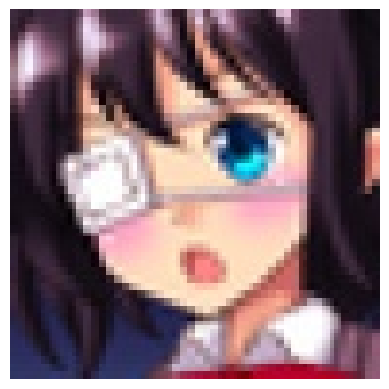

Label verdadera: Rikka Takanashi-Love, Chunibyo and Other Delusions!
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 82.69 % confianza.
> Ouro Kronii-Hololive : 10.13 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 1.03 % confianza.
> Hinata Hyuuga-Naruto : 0.73 % confianza.
> Rin Tohsakaka-Fate : 0.55 % confianza.


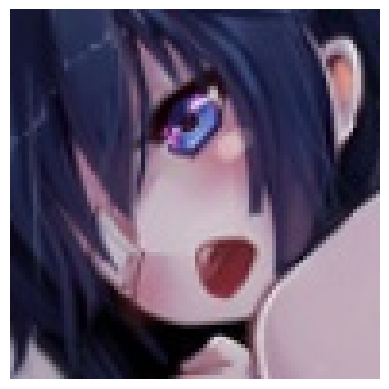

Label verdadera: Rikka Takanashi-Love, Chunibyo and Other Delusions!
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 36.10 % confianza.
> Keqing-Genshin Impact : 14.08 % confianza.
> Ouro Kronii-Hololive : 8.49 % confianza.
> Shinobu Kochou-Demon Slayer : 6.01 % confianza.
> Megumin-Konosuba : 5.19 % confianza.


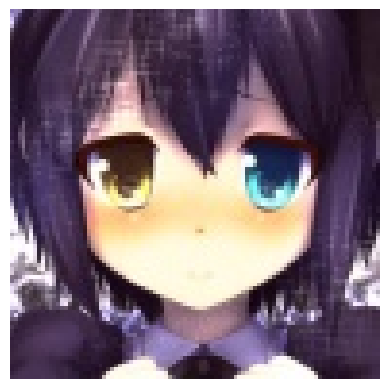

Label verdadera: Rikka Takanashi-Love, Chunibyo and Other Delusions!
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 32.16 % confianza.
> Nozomi Tojo-Love Live : 19.45 % confianza.
> Ouro Kronii-Hololive : 7.82 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 6.67 % confianza.
> Hifumi Takimoto-New Game! : 4.56 % confianza.


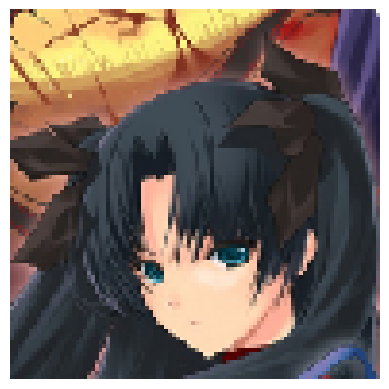

Label verdadera: Rin Tohsakaka-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Rin Tohsakaka-Fate : 93.26 % confianza.
> Saber-Fate : 1.10 % confianza.
> Hatsune Miku-Vocaloid : 0.84 % confianza.
> Reimu Hakurei-Touhou : 0.56 % confianza.
> Suzaku Kururugi-Code Geass : 0.49 % confianza.


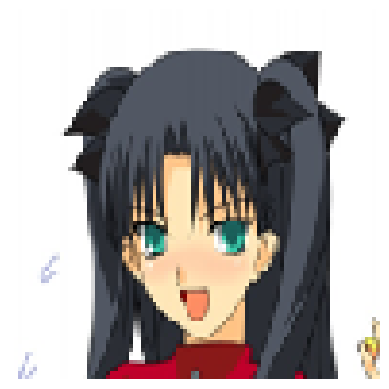

Label verdadera: Rin Tohsakaka-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Rin Tohsakaka-Fate : 51.77 % confianza.
> Shiki Ryougi-Garden of Sinners : 6.43 % confianza.
> Suzaku Kururugi-Code Geass : 5.24 % confianza.
> Konata Izumi-Lucky Star : 3.84 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 3.21 % confianza.


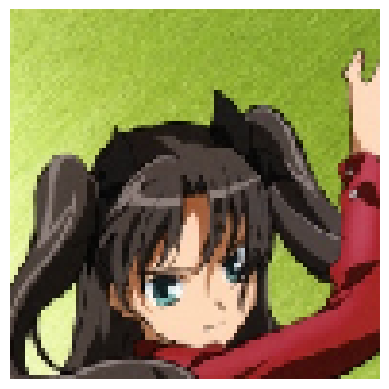

Label verdadera: Rin Tohsakaka-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Rin Tohsakaka-Fate : 82.32 % confianza.
> Shiki Ryougi-Garden of Sinners : 4.67 % confianza.
> Lelouch Lamperouge-Code Geass : 1.55 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.99 % confianza.
> Kallen Stadtfeld-Code Geass : 0.71 % confianza.


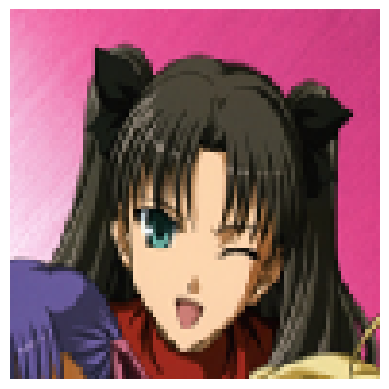

Label verdadera: Rin Tohsakaka-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Rin Tohsakaka-Fate : 67.49 % confianza.
> Shiki Ryougi-Garden of Sinners : 6.59 % confianza.
> Lelouch Lamperouge-Code Geass : 5.92 % confianza.
> Suzaku Kururugi-Code Geass : 2.79 % confianza.
> Saber-Fate : 2.27 % confianza.


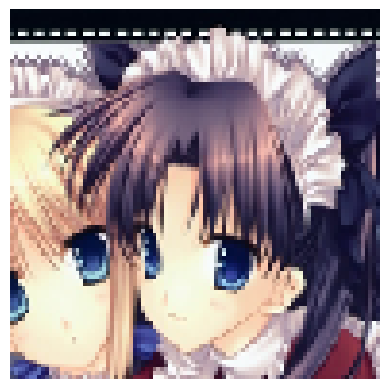

Label verdadera: Rin Tohsakaka-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Rin Tohsakaka-Fate : 67.77 % confianza.
> Sakuya Izayoi-Touhou : 6.33 % confianza.
> Saber-Fate : 5.20 % confianza.
> Kagami Hiiragi-Lucky Star : 2.97 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 2.01 % confianza.


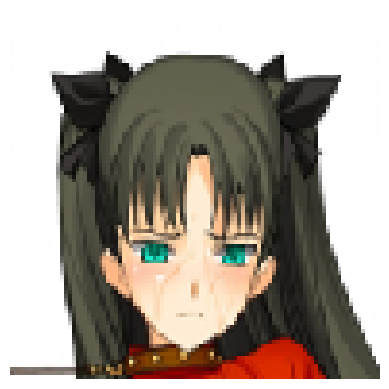

Label verdadera: Rin Tohsakaka-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Rin Tohsakaka-Fate : 83.72 % confianza.
> Shiki Ryougi-Garden of Sinners : 3.06 % confianza.
> Lelouch Lamperouge-Code Geass : 2.11 % confianza.
> Saber-Fate : 1.77 % confianza.
> Suzaku Kururugi-Code Geass : 1.31 % confianza.


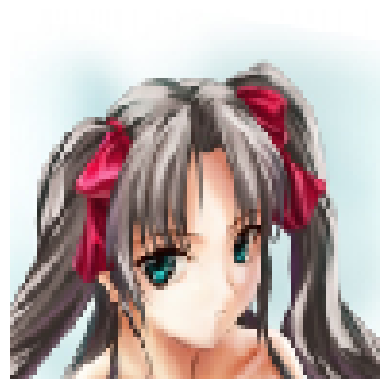

Label verdadera: Rin Tohsakaka-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 38ms/step
> Reimu Hakurei-Touhou : 49.29 % confianza.
> Rin Tohsakaka-Fate : 32.11 % confianza.
> Hatsune Miku-Vocaloid : 2.03 % confianza.
> Flandre Scarlet-Touhou : 1.53 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 1.26 % confianza.


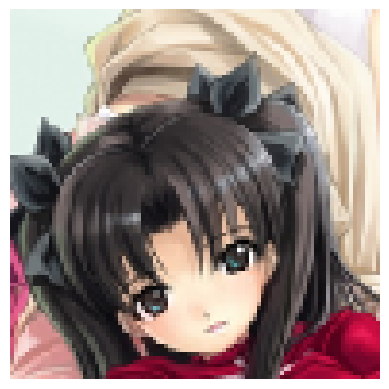

Label verdadera: Rin Tohsakaka-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 56ms/step
> Rin Tohsakaka-Fate : 28.53 % confianza.
> Suzaku Kururugi-Code Geass : 11.76 % confianza.
> Reimu Hakurei-Touhou : 10.94 % confianza.
> Lelouch Lamperouge-Code Geass : 8.16 % confianza.
> Shiki Ryougi-Garden of Sinners : 2.85 % confianza.


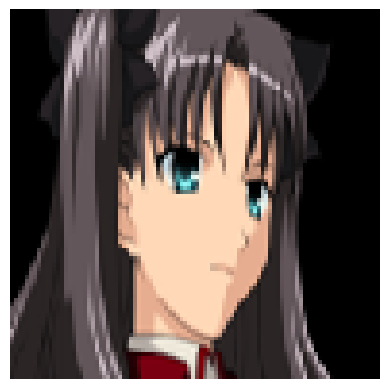

Label verdadera: Rin Tohsakaka-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Rin Tohsakaka-Fate : 86.97 % confianza.
> Saber-Fate : 3.54 % confianza.
> Shiki Ryougi-Garden of Sinners : 1.05 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.89 % confianza.
> Ouro Kronii-Hololive : 0.86 % confianza.


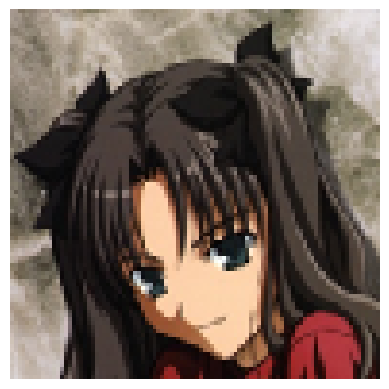

Label verdadera: Rin Tohsakaka-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Rin Tohsakaka-Fate : 94.93 % confianza.
> Kallen Stadtfeld-Code Geass : 0.74 % confianza.
> Suzaku Kururugi-Code Geass : 0.71 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.69 % confianza.
> Saber-Fate : 0.67 % confianza.


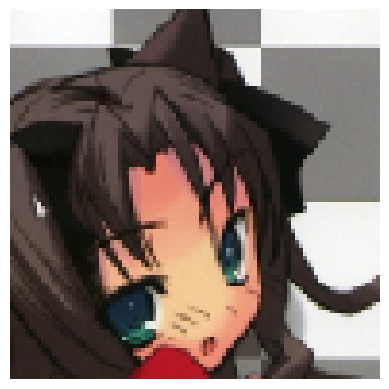

Label verdadera: Rin Tohsakaka-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Rin Tohsakaka-Fate : 98.81 % confianza.
> Hatsune Miku-Vocaloid : 0.27 % confianza.
> Saber-Fate : 0.17 % confianza.
> Kallen Stadtfeld-Code Geass : 0.17 % confianza.
> Fubuki-One Punch Man : 0.10 % confianza.


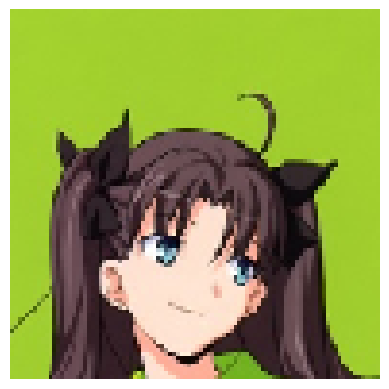

Label verdadera: Rin Tohsakaka-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Rin Tohsakaka-Fate : 81.63 % confianza.
> Kallen Stadtfeld-Code Geass : 4.27 % confianza.
> Shiki Ryougi-Garden of Sinners : 3.18 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 1.55 % confianza.
> Saber-Fate : 0.62 % confianza.


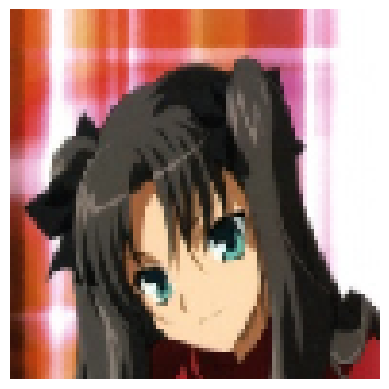

Label verdadera: Rin Tohsakaka-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Rin Tohsakaka-Fate : 95.08 % confianza.
> Shiki Ryougi-Garden of Sinners : 1.16 % confianza.
> Suzaku Kururugi-Code Geass : 0.64 % confianza.
> Saber-Fate : 0.35 % confianza.
> Reimu Hakurei-Touhou : 0.32 % confianza.


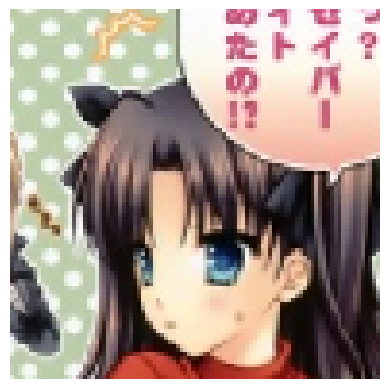

Label verdadera: Rin Tohsakaka-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Rin Tohsakaka-Fate : 99.08 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.18 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 0.11 % confianza.
> Saber-Fate : 0.08 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.08 % confianza.


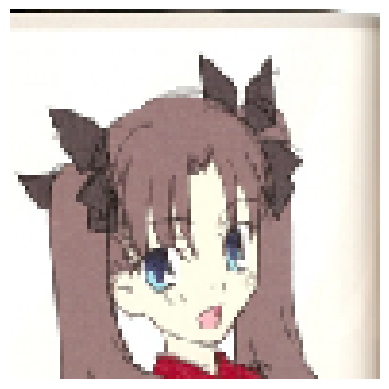

Label verdadera: Rin Tohsakaka-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Yui Hirasawa-K ON! : 30.98 % confianza.
> Aisaka Taiga-Toradora : 8.19 % confianza.
> Rin Tohsakaka-Fate : 7.02 % confianza.
> Reimu Hakurei-Touhou : 5.25 % confianza.
> Shirley Fenette-Code Geass : 4.55 % confianza.


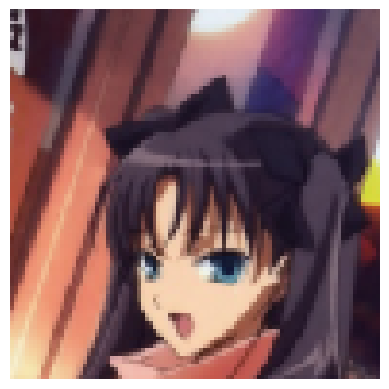

Label verdadera: Rin Tohsakaka-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Rin Tohsakaka-Fate : 96.82 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.48 % confianza.
> Sakuya Izayoi-Touhou : 0.30 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.26 % confianza.
> Reimu Hakurei-Touhou : 0.25 % confianza.


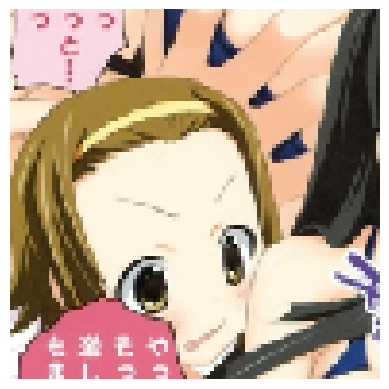

Label verdadera: Ritsu Tainaka-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 38ms/step
> Misato Katsuragi-Neon Genesis Evangelion : 20.92 % confianza.
> Ritsu Tainaka-K ON! : 12.58 % confianza.
> Kotobuki Tsumugi-K ON! : 10.58 % confianza.
> Nico Robin-One Piece : 9.80 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 6.71 % confianza.


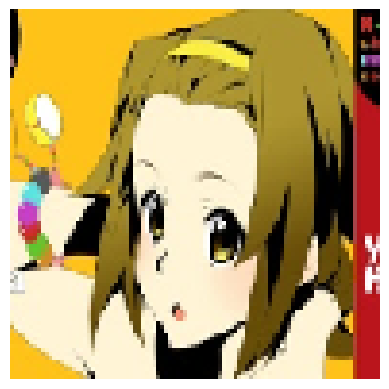

Label verdadera: Ritsu Tainaka-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Ritsu Tainaka-K ON! : 66.45 % confianza.
> Kotobuki Tsumugi-K ON! : 14.41 % confianza.
> Maka Albarn-Soul Eater : 5.26 % confianza.
> Yui Hirasawa-K ON! : 4.47 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 2.19 % confianza.


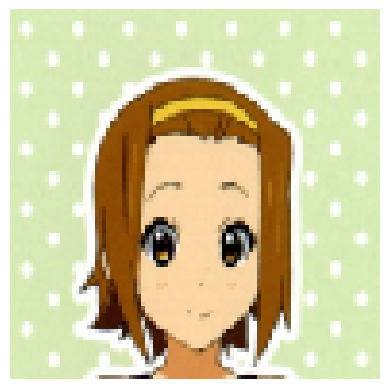

Label verdadera: Ritsu Tainaka-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Ritsu Tainaka-K ON! : 99.45 % confianza.
> Yui Hirasawa-K ON! : 0.15 % confianza.
> Kotobuki Tsumugi-K ON! : 0.07 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 0.05 % confianza.
> Kallen Stadtfeld-Code Geass : 0.03 % confianza.


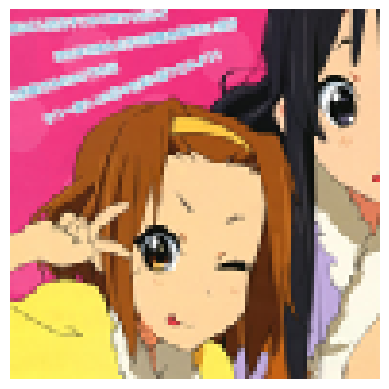

Label verdadera: Ritsu Tainaka-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Ritsu Tainaka-K ON! : 70.69 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 8.13 % confianza.
> Yui Hirasawa-K ON! : 6.82 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 4.88 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 2.05 % confianza.


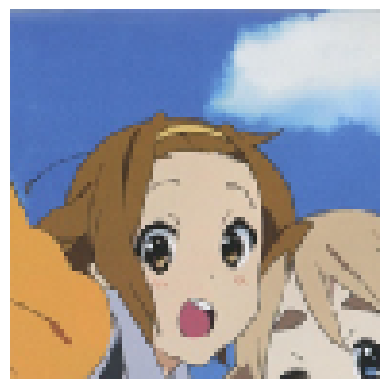

Label verdadera: Ritsu Tainaka-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Ritsu Tainaka-K ON! : 59.21 % confianza.
> Kotobuki Tsumugi-K ON! : 20.41 % confianza.
> Yui Hirasawa-K ON! : 9.22 % confianza.
> Aisaka Taiga-Toradora : 1.08 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 0.62 % confianza.


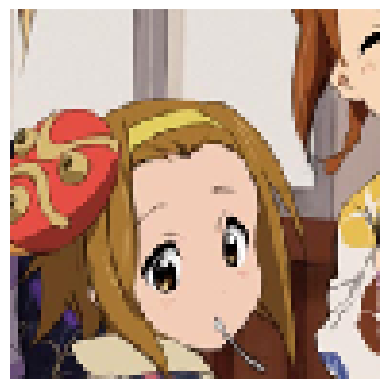

Label verdadera: Ritsu Tainaka-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Ritsu Tainaka-K ON! : 98.98 % confianza.
> Kotobuki Tsumugi-K ON! : 0.32 % confianza.
> Kallen Stadtfeld-Code Geass : 0.22 % confianza.
> Nami-One Piece : 0.05 % confianza.
> Nico Robin-One Piece : 0.05 % confianza.


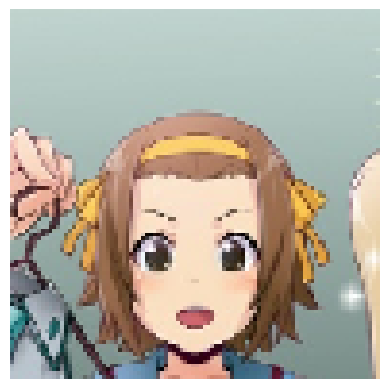

Label verdadera: Ritsu Tainaka-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Ritsu Tainaka-K ON! : 91.55 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 6.16 % confianza.
> Kallen Stadtfeld-Code Geass : 0.45 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 0.27 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.13 % confianza.


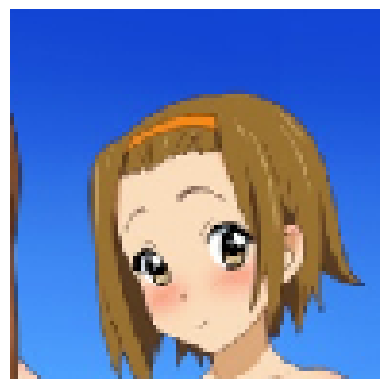

Label verdadera: Ritsu Tainaka-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Ritsu Tainaka-K ON! : 98.79 % confianza.
> Kotobuki Tsumugi-K ON! : 0.40 % confianza.
> Yui Hirasawa-K ON! : 0.16 % confianza.
> Saber-Fate : 0.09 % confianza.
> Nami-One Piece : 0.08 % confianza.


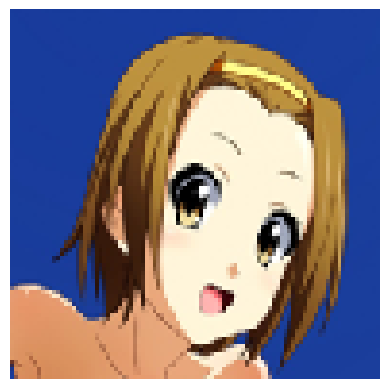

Label verdadera: Ritsu Tainaka-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Ritsu Tainaka-K ON! : 93.07 % confianza.
> Kotobuki Tsumugi-K ON! : 3.80 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 1.39 % confianza.
> C.C-Code Geass : 0.35 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.29 % confianza.


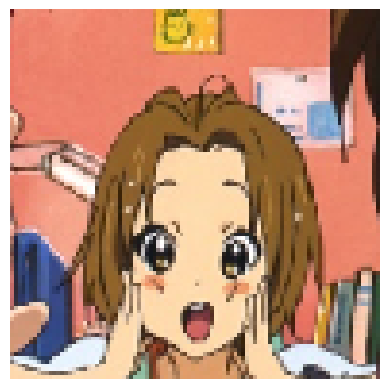

Label verdadera: Ritsu Tainaka-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 32ms/step
> Yui Hirasawa-K ON! : 41.73 % confianza.
> Ritsu Tainaka-K ON! : 40.69 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 2.74 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 2.35 % confianza.
> Kotobuki Tsumugi-K ON! : 2.29 % confianza.


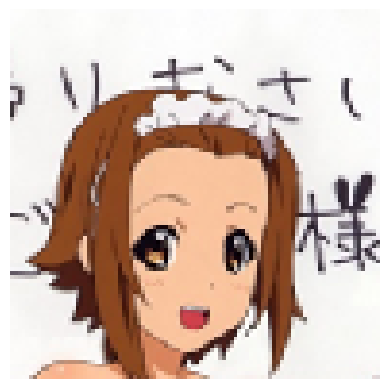

Label verdadera: Ritsu Tainaka-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Ritsu Tainaka-K ON! : 94.80 % confianza.
> Kotobuki Tsumugi-K ON! : 1.27 % confianza.
> Yui Hirasawa-K ON! : 1.07 % confianza.
> Paimon-Genshin Impact : 0.45 % confianza.
> Kallen Stadtfeld-Code Geass : 0.35 % confianza.


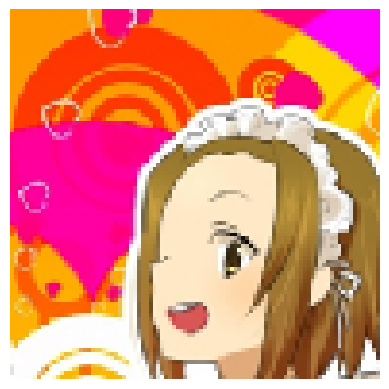

Label verdadera: Ritsu Tainaka-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Ritsu Tainaka-K ON! : 85.64 % confianza.
> Kotobuki Tsumugi-K ON! : 6.72 % confianza.
> C.C-Code Geass : 1.90 % confianza.
> Nami-One Piece : 1.46 % confianza.
> Maki Nishikino-Love Live : 0.60 % confianza.


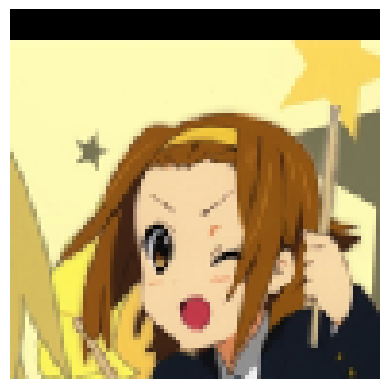

Label verdadera: Ritsu Tainaka-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Ritsu Tainaka-K ON! : 90.43 % confianza.
> Yui Hirasawa-K ON! : 4.53 % confianza.
> Kotobuki Tsumugi-K ON! : 2.01 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.32 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 0.20 % confianza.


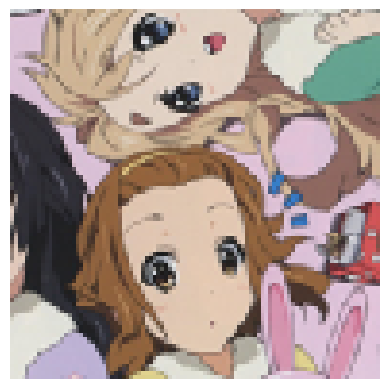

Label verdadera: Ritsu Tainaka-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Kotobuki Tsumugi-K ON! : 87.48 % confianza.
> Ritsu Tainaka-K ON! : 9.62 % confianza.
> Saber-Fate : 0.49 % confianza.
> Ai Hayasaka-Kaguya Sama Love Is War : 0.34 % confianza.
> Kagami Hiiragi-Lucky Star : 0.21 % confianza.


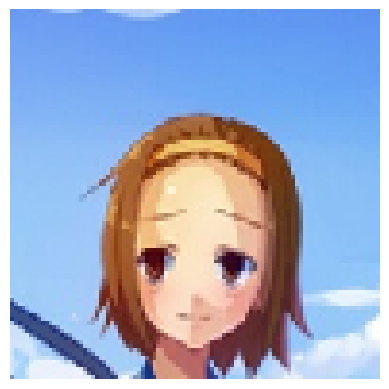

Label verdadera: Ritsu Tainaka-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Ritsu Tainaka-K ON! : 56.15 % confianza.
> Kotobuki Tsumugi-K ON! : 9.05 % confianza.
> Illyasviel Von Einzbern-Fate : 7.87 % confianza.
> Kallen Stadtfeld-Code Geass : 2.87 % confianza.
> Yui Hirasawa-K ON! : 2.25 % confianza.


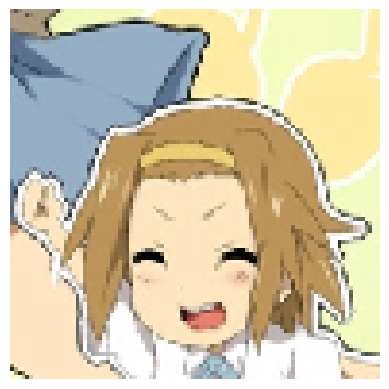

Label verdadera: Ritsu Tainaka-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Ritsu Tainaka-K ON! : 88.20 % confianza.
> Kotobuki Tsumugi-K ON! : 5.44 % confianza.
> Yui Hirasawa-K ON! : 3.04 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 0.26 % confianza.
> Kallen Stadtfeld-Code Geass : 0.20 % confianza.


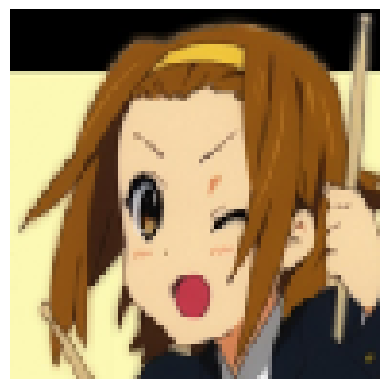

Label verdadera: Ritsu Tainaka-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Ritsu Tainaka-K ON! : 95.31 % confianza.
> Kotobuki Tsumugi-K ON! : 1.75 % confianza.
> Yui Hirasawa-K ON! : 0.92 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.26 % confianza.
> Nico Robin-One Piece : 0.17 % confianza.


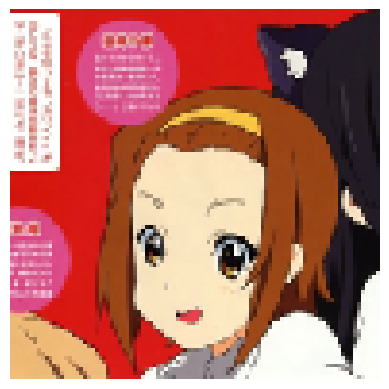

Label verdadera: Ritsu Tainaka-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Ritsu Tainaka-K ON! : 93.74 % confianza.
> Yui Hirasawa-K ON! : 1.74 % confianza.
> Kotobuki Tsumugi-K ON! : 1.59 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 0.52 % confianza.
> Kallen Stadtfeld-Code Geass : 0.29 % confianza.


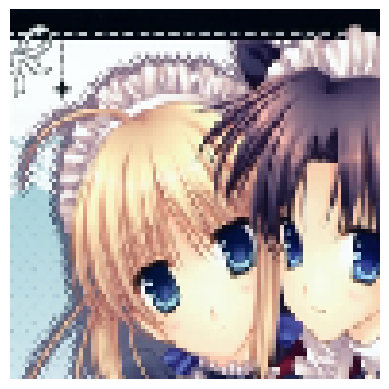

Label verdadera: Saber-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 37ms/step
> Saber-Fate : 95.00 % confianza.
> Arcueid Brunestud-Tsukihime : 0.58 % confianza.
> Sakuya Izayoi-Touhou : 0.45 % confianza.
> Kotobuki Tsumugi-K ON! : 0.35 % confianza.
> Ouro Kronii-Hololive : 0.29 % confianza.


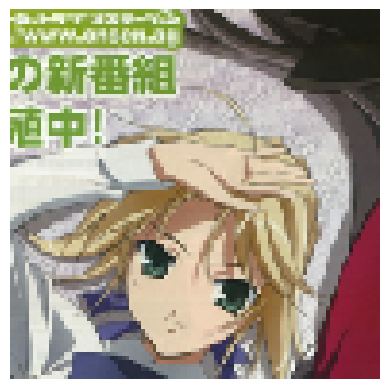

Label verdadera: Saber-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 33ms/step
> Saber-Fate : 86.92 % confianza.
> Maka Albarn-Soul Eater : 1.71 % confianza.
> Flandre Scarlet-Touhou : 1.24 % confianza.
> Hatsune Miku-Vocaloid : 1.06 % confianza.
> Sakuya Izayoi-Touhou : 0.97 % confianza.


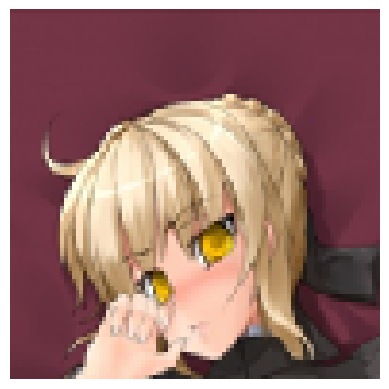

Label verdadera: Saber-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Saber-Fate : 30.04 % confianza.
> Illyasviel Von Einzbern-Fate : 13.38 % confianza.
> Arcueid Brunestud-Tsukihime : 8.18 % confianza.
> Sakuya Izayoi-Touhou : 6.33 % confianza.
> Hatsune Miku-Vocaloid : 3.33 % confianza.


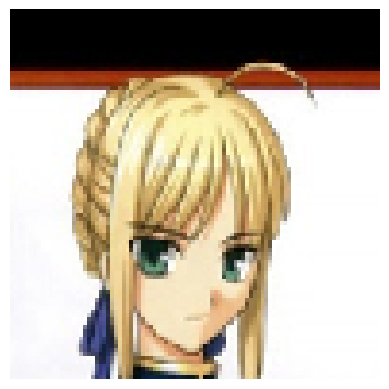

Label verdadera: Saber-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Saber-Fate : 84.73 % confianza.
> Arcueid Brunestud-Tsukihime : 2.07 % confianza.
> Suzaku Kururugi-Code Geass : 1.71 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 1.21 % confianza.
> Flandre Scarlet-Touhou : 0.50 % confianza.


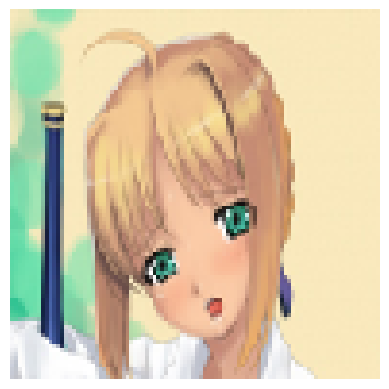

Label verdadera: Saber-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Saber-Fate : 96.56 % confianza.
> Suzaku Kururugi-Code Geass : 0.34 % confianza.
> Kotobuki Tsumugi-K ON! : 0.28 % confianza.
> Arcueid Brunestud-Tsukihime : 0.28 % confianza.
> Hatsune Miku-Vocaloid : 0.16 % confianza.


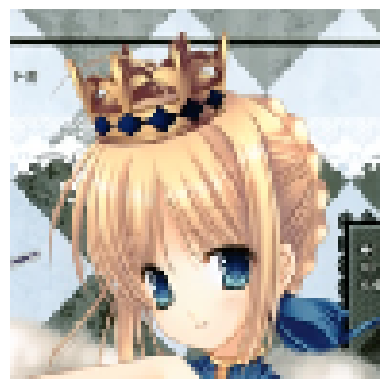

Label verdadera: Saber-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Saber-Fate : 77.71 % confianza.
> Arcueid Brunestud-Tsukihime : 2.66 % confianza.
> Flandre Scarlet-Touhou : 1.59 % confianza.
> Suzaku Kururugi-Code Geass : 1.32 % confianza.
> Kotobuki Tsumugi-K ON! : 0.97 % confianza.


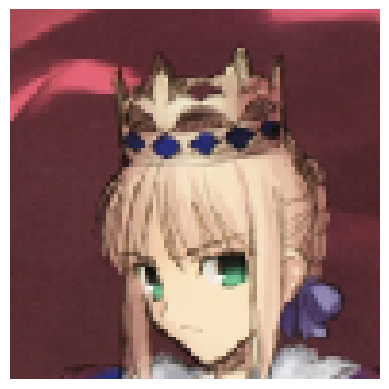

Label verdadera: Saber-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Saber-Fate : 75.79 % confianza.
> Suzaku Kururugi-Code Geass : 2.93 % confianza.
> Rin Tohsakaka-Fate : 2.39 % confianza.
> Maka Albarn-Soul Eater : 1.40 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 1.06 % confianza.


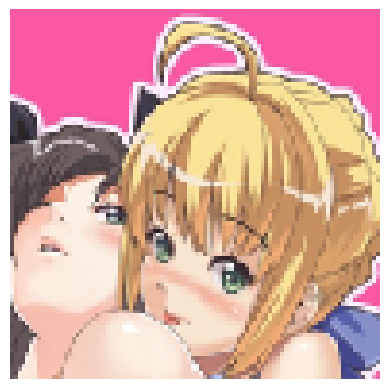

Label verdadera: Saber-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 34ms/step
> Saber-Fate : 51.88 % confianza.
> Arcueid Brunestud-Tsukihime : 14.14 % confianza.
> Flandre Scarlet-Touhou : 6.00 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 5.10 % confianza.
> Aisaka Taiga-Toradora : 2.01 % confianza.


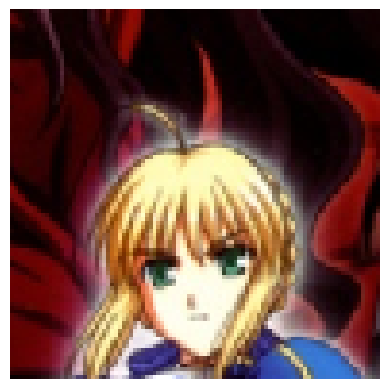

Label verdadera: Saber-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 33ms/step
> Saber-Fate : 70.71 % confianza.
> Flandre Scarlet-Touhou : 9.84 % confianza.
> Arcueid Brunestud-Tsukihime : 4.95 % confianza.
> Hatsune Miku-Vocaloid : 2.85 % confianza.
> Rin Tohsakaka-Fate : 1.04 % confianza.


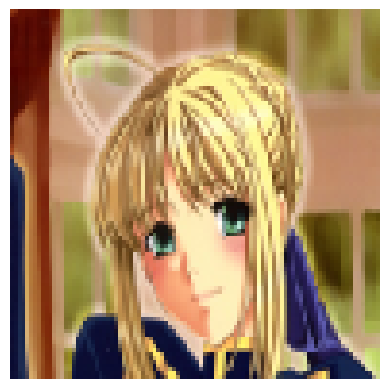

Label verdadera: Saber-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 39ms/step
> Saber-Fate : 74.82 % confianza.
> Arcueid Brunestud-Tsukihime : 4.10 % confianza.
> C.C-Code Geass : 2.59 % confianza.
> Flandre Scarlet-Touhou : 2.46 % confianza.
> Suzaku Kururugi-Code Geass : 1.49 % confianza.


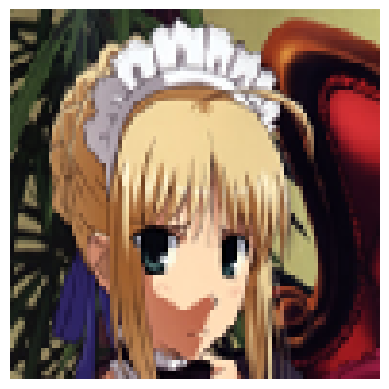

Label verdadera: Saber-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 34ms/step
> Saber-Fate : 87.30 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 2.16 % confianza.
> Flandre Scarlet-Touhou : 1.25 % confianza.
> Arcueid Brunestud-Tsukihime : 1.23 % confianza.
> Maka Albarn-Soul Eater : 1.02 % confianza.


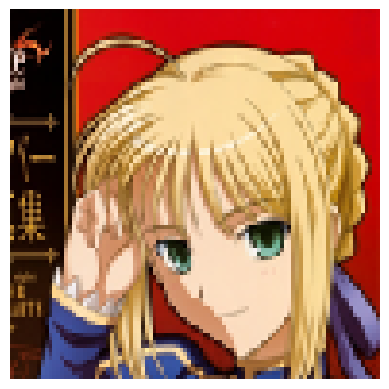

Label verdadera: Saber-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 37ms/step
> Saber-Fate : 88.77 % confianza.
> Suzaku Kururugi-Code Geass : 3.49 % confianza.
> Arcueid Brunestud-Tsukihime : 1.15 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.77 % confianza.
> Fubuki-One Punch Man : 0.62 % confianza.


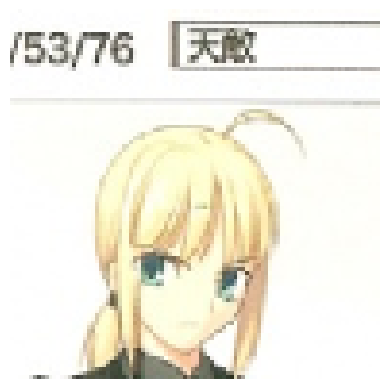

Label verdadera: Saber-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Saber-Fate : 86.75 % confianza.
> Maka Albarn-Soul Eater : 2.25 % confianza.
> Kotobuki Tsumugi-K ON! : 2.01 % confianza.
> Hatsune Miku-Vocaloid : 0.79 % confianza.
> Suzaku Kururugi-Code Geass : 0.58 % confianza.


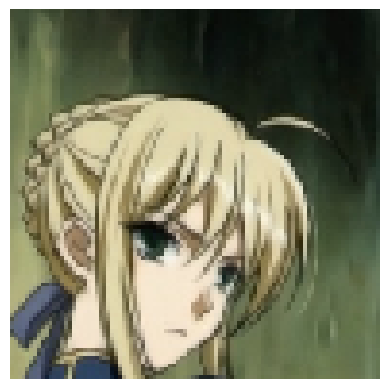

Label verdadera: Saber-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Saber-Fate : 45.21 % confianza.
> Maka Albarn-Soul Eater : 5.03 % confianza.
> Arcueid Brunestud-Tsukihime : 3.78 % confianza.
> Cirno-Touhou : 3.15 % confianza.
> Flandre Scarlet-Touhou : 2.93 % confianza.


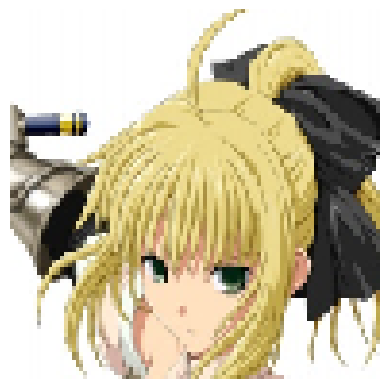

Label verdadera: Saber-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Saber-Fate : 67.19 % confianza.
> Suzaku Kururugi-Code Geass : 11.79 % confianza.
> Arcueid Brunestud-Tsukihime : 1.45 % confianza.
> Rin Tohsakaka-Fate : 1.29 % confianza.
> Flandre Scarlet-Touhou : 1.11 % confianza.


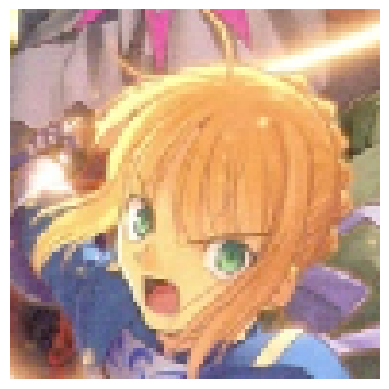

Label verdadera: Saber-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Suzaku Kururugi-Code Geass : 59.47 % confianza.
> Saber-Fate : 19.11 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 4.81 % confianza.
> Arcueid Brunestud-Tsukihime : 2.85 % confianza.
> Flandre Scarlet-Touhou : 1.59 % confianza.


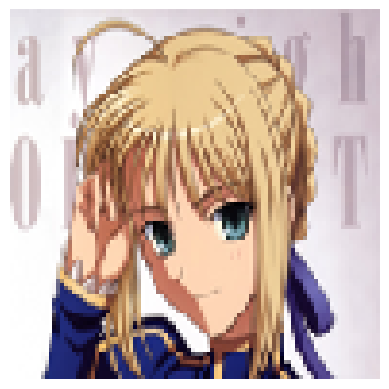

Label verdadera: Saber-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Saber-Fate : 96.99 % confianza.
> Suzaku Kururugi-Code Geass : 1.41 % confianza.
> Arcueid Brunestud-Tsukihime : 0.32 % confianza.
> Flandre Scarlet-Touhou : 0.11 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.10 % confianza.


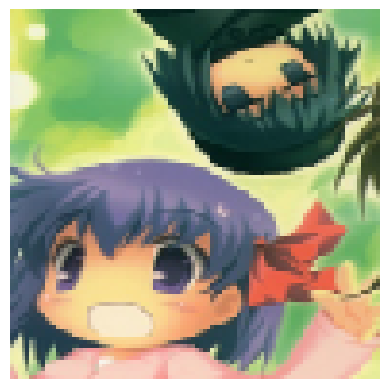

Label verdadera: Sakura Matou-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 47ms/step
> Rin Tohsakaka-Fate : 56.47 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 4.22 % confianza.
> Hatsune Miku-Vocaloid : 3.79 % confianza.
> Cirno-Touhou : 3.02 % confianza.
> Konata Izumi-Lucky Star : 2.52 % confianza.


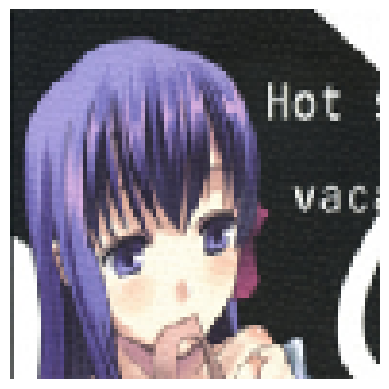

Label verdadera: Sakura Matou-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Sakura Matou-Fate : 78.93 % confianza.
> Sakuya Izayoi-Touhou : 6.67 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 3.45 % confianza.
> Shiki Ryougi-Garden of Sinners : 2.37 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.74 % confianza.


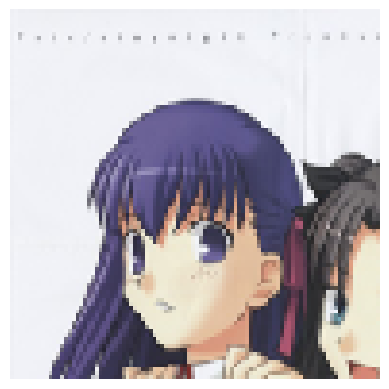

Label verdadera: Sakura Matou-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Sakura Matou-Fate : 97.77 % confianza.
> Hifumi Takimoto-New Game! : 0.23 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.23 % confianza.
> Konata Izumi-Lucky Star : 0.21 % confianza.
> Rin Tohsakaka-Fate : 0.19 % confianza.


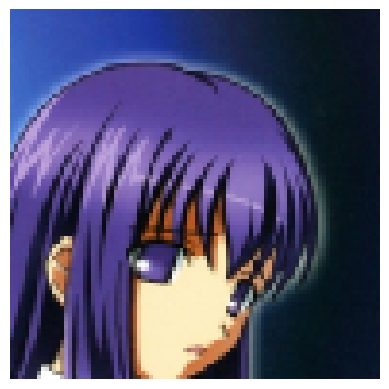

Label verdadera: Sakura Matou-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 39ms/step
> Sakura Matou-Fate : 86.95 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 5.20 % confianza.
> Sakuya Izayoi-Touhou : 0.81 % confianza.
> C.C-Code Geass : 0.61 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.59 % confianza.


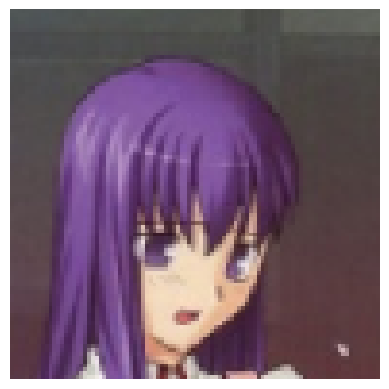

Label verdadera: Sakura Matou-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Sakura Matou-Fate : 94.84 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 2.23 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.47 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.22 % confianza.
> Hinata Hyuuga-Naruto : 0.16 % confianza.


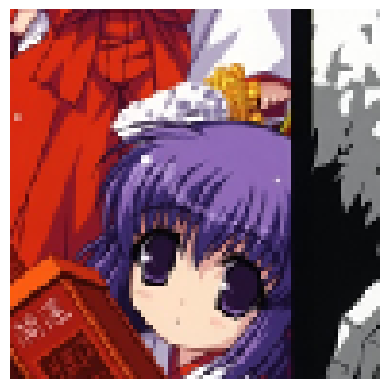

Label verdadera: Sakura Matou-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Sakura Matou-Fate : 91.42 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 2.00 % confianza.
> Sakuya Izayoi-Touhou : 1.21 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.54 % confianza.
> Scarlet Remilia-Touhou : 0.54 % confianza.


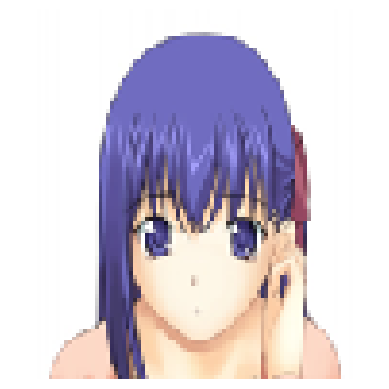

Label verdadera: Sakura Matou-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Sakura Matou-Fate : 95.90 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.97 % confianza.
> Konata Izumi-Lucky Star : 0.49 % confianza.
> Hifumi Takimoto-New Game! : 0.28 % confianza.
> Nozomi Tojo-Love Live : 0.28 % confianza.


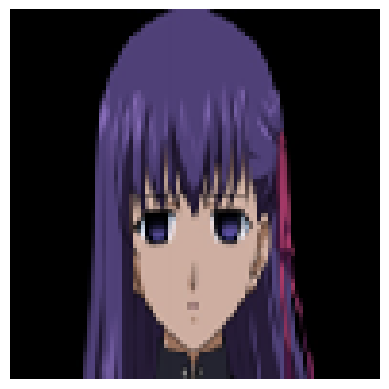

Label verdadera: Sakura Matou-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Sakura Matou-Fate : 97.05 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.24 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.20 % confianza.
> Nozomi Tojo-Love Live : 0.18 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.16 % confianza.


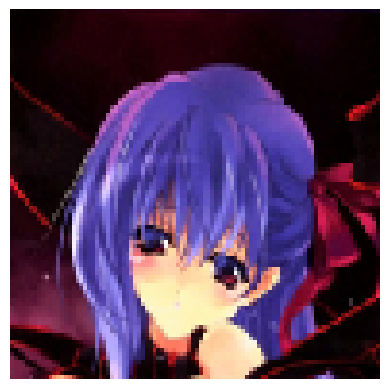

Label verdadera: Sakura Matou-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Rei Ayanami-Neon Genesis Evangelion : 69.52 % confianza.
> Sakura Matou-Fate : 24.72 % confianza.
> Scarlet Remilia-Touhou : 1.41 % confianza.
> Sakuya Izayoi-Touhou : 1.05 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.51 % confianza.


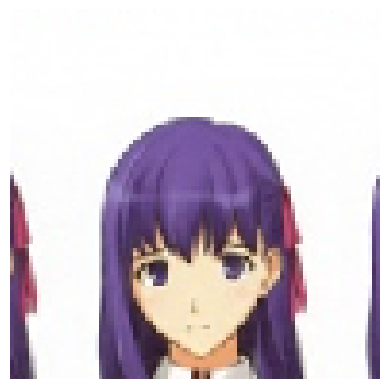

Label verdadera: Sakura Matou-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Sakura Matou-Fate : 91.37 % confianza.
> Shiki Ryougi-Garden of Sinners : 1.19 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.86 % confianza.
> Konata Izumi-Lucky Star : 0.75 % confianza.
> Hifumi Takimoto-New Game! : 0.43 % confianza.


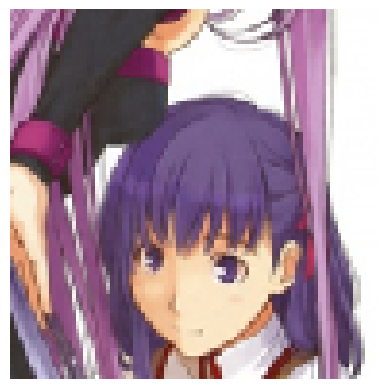

Label verdadera: Sakura Matou-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Sakura Matou-Fate : 90.02 % confianza.
> Kagami Hiiragi-Lucky Star : 0.84 % confianza.
> Nozomi Tojo-Love Live : 0.73 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.70 % confianza.
> Hifumi Takimoto-New Game! : 0.53 % confianza.


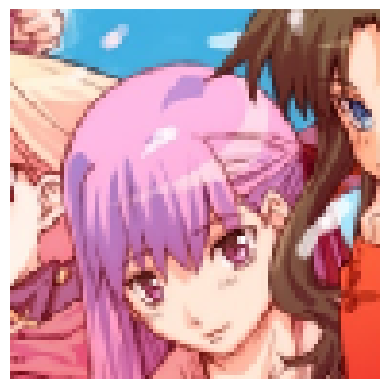

Label verdadera: Sakura Matou-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 40ms/step
> Scarlet Remilia-Touhou : 51.37 % confianza.
> Sakuya Izayoi-Touhou : 28.77 % confianza.
> Nino Nakano-Quintessential Quintuplets : 3.51 % confianza.
> Sakura Matou-Fate : 3.40 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 2.96 % confianza.


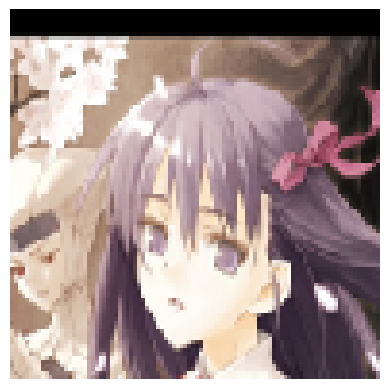

Label verdadera: Sakura Matou-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Scarlet Remilia-Touhou : 30.26 % confianza.
> Sakuya Izayoi-Touhou : 14.05 % confianza.
> Arcueid Brunestud-Tsukihime : 8.64 % confianza.
> Sakura Matou-Fate : 6.94 % confianza.
> Flandre Scarlet-Touhou : 6.51 % confianza.


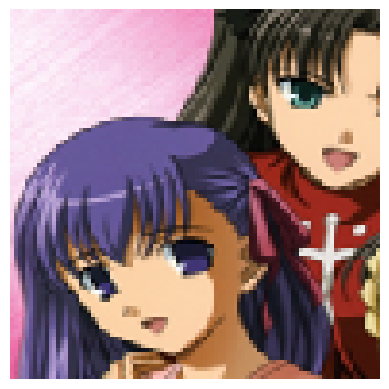

Label verdadera: Sakura Matou-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Sakura Matou-Fate : 87.75 % confianza.
> Rin Tohsakaka-Fate : 4.69 % confianza.
> Konata Izumi-Lucky Star : 0.94 % confianza.
> Kagami Hiiragi-Lucky Star : 0.64 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.63 % confianza.


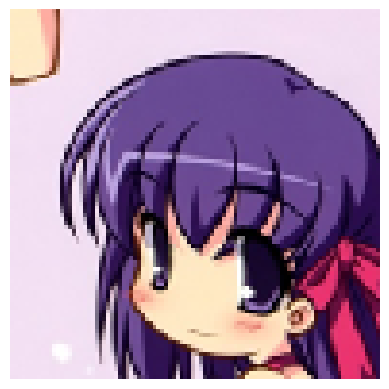

Label verdadera: Sakura Matou-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Sakura Matou-Fate : 98.48 % confianza.
> Kagami Hiiragi-Lucky Star : 0.16 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.15 % confianza.
> Scarlet Remilia-Touhou : 0.13 % confianza.
> Hifumi Takimoto-New Game! : 0.11 % confianza.


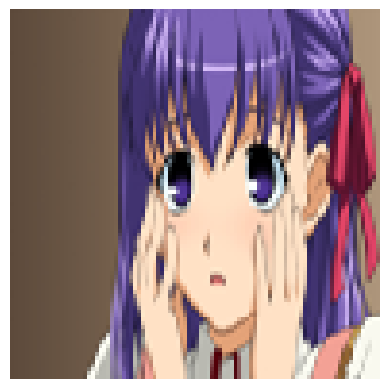

Label verdadera: Sakura Matou-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Sakura Matou-Fate : 89.14 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 2.11 % confianza.
> Nozomi Tojo-Love Live : 1.39 % confianza.
> Sakuya Izayoi-Touhou : 0.95 % confianza.
> Maka Albarn-Soul Eater : 0.88 % confianza.


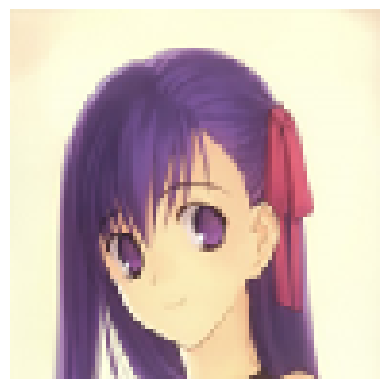

Label verdadera: Sakura Matou-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Sakura Matou-Fate : 92.72 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.51 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.45 % confianza.
> Shinobu Kochou-Demon Slayer : 0.43 % confianza.
> Maki Nishikino-Love Live : 0.41 % confianza.


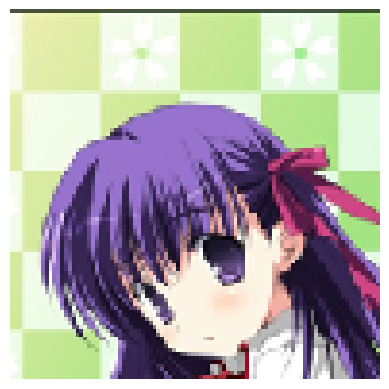

Label verdadera: Sakura Matou-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Sakura Matou-Fate : 89.78 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 1.93 % confianza.
> Lelouch Lamperouge-Code Geass : 0.78 % confianza.
> C.C-Code Geass : 0.59 % confianza.
> Reimu Hakurei-Touhou : 0.37 % confianza.


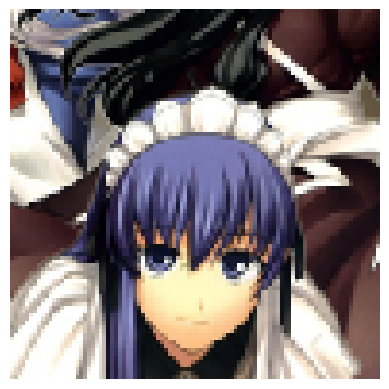

Label verdadera: Sakura Matou-Fate
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Sakura Matou-Fate : 97.17 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.58 % confianza.
> Sakuya Izayoi-Touhou : 0.34 % confianza.
> Konata Izumi-Lucky Star : 0.25 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.17 % confianza.


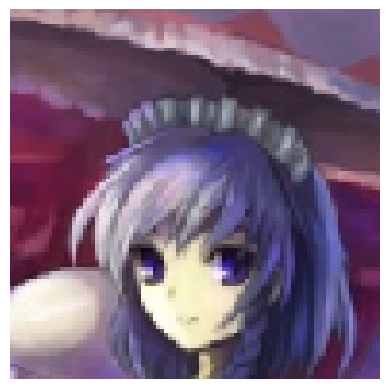

Label verdadera: Sakuya Izayoi-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Sakura Matou-Fate : 72.98 % confianza.
> Sakuya Izayoi-Touhou : 9.69 % confianza.
> Scarlet Remilia-Touhou : 3.05 % confianza.
> Kagami Hiiragi-Lucky Star : 1.80 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.88 % confianza.


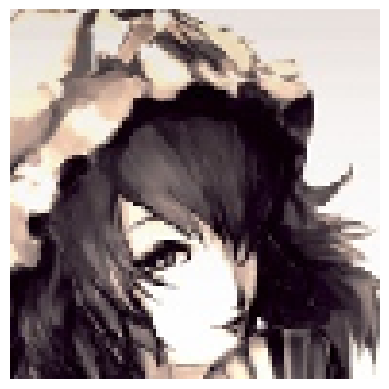

Label verdadera: Sakuya Izayoi-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Lelouch Lamperouge-Code Geass : 46.42 % confianza.
> Shiki Ryougi-Garden of Sinners : 28.67 % confianza.
> Rin Tohsakaka-Fate : 3.84 % confianza.
> Suzaku Kururugi-Code Geass : 3.36 % confianza.
> Kirito-Sword Art Online : 2.23 % confianza.


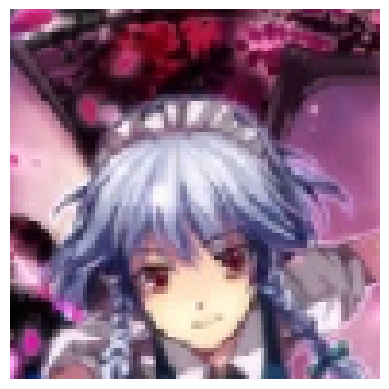

Label verdadera: Sakuya Izayoi-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Scarlet Remilia-Touhou : 93.43 % confianza.
> Sakuya Izayoi-Touhou : 5.59 % confianza.
> Sakura Matou-Fate : 0.14 % confianza.
> Reimu Hakurei-Touhou : 0.08 % confianza.
> Rem-Re Zero : 0.08 % confianza.


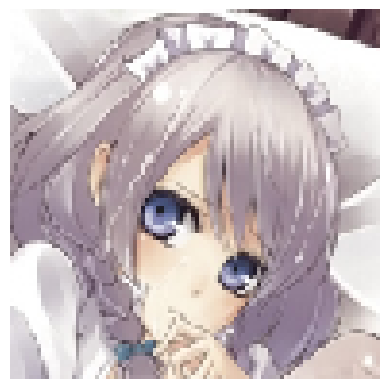

Label verdadera: Sakuya Izayoi-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 38ms/step
> Sakuya Izayoi-Touhou : 93.95 % confianza.
> Kagami Hiiragi-Lucky Star : 1.67 % confianza.
> Cirno-Touhou : 0.54 % confianza.
> Rin Tohsakaka-Fate : 0.52 % confianza.
> Reimu Hakurei-Touhou : 0.44 % confianza.


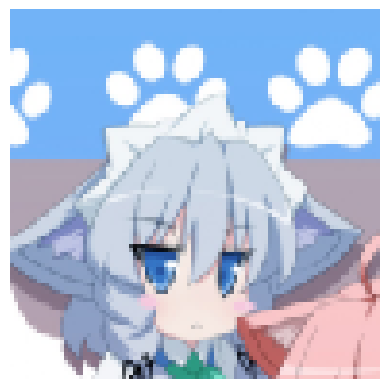

Label verdadera: Sakuya Izayoi-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 36ms/step
> Cirno-Touhou : 74.27 % confianza.
> Sakuya Izayoi-Touhou : 18.97 % confianza.
> Kagami Hiiragi-Lucky Star : 2.71 % confianza.
> Nia Teppelin-Gurrenn Lagann : 0.44 % confianza.
> Konata Izumi-Lucky Star : 0.32 % confianza.


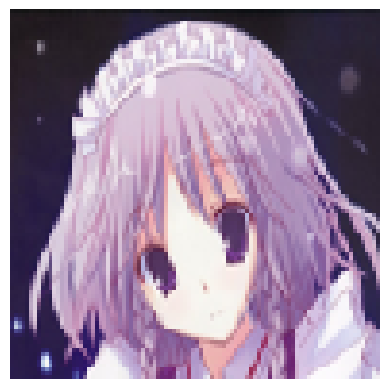

Label verdadera: Sakuya Izayoi-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 33ms/step
> Sakuya Izayoi-Touhou : 98.73 % confianza.
> Cirno-Touhou : 0.26 % confianza.
> Kagami Hiiragi-Lucky Star : 0.13 % confianza.
> Scarlet Remilia-Touhou : 0.13 % confianza.
> Illyasviel Von Einzbern-Fate : 0.10 % confianza.


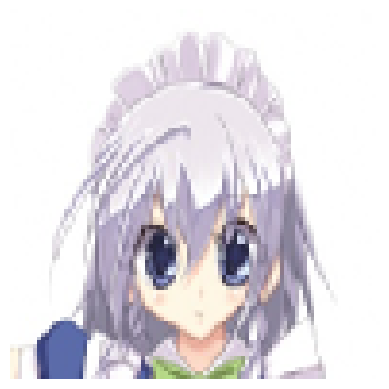

Label verdadera: Sakuya Izayoi-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 32ms/step
> Sakuya Izayoi-Touhou : 66.72 % confianza.
> Kagami Hiiragi-Lucky Star : 18.03 % confianza.
> Cirno-Touhou : 7.68 % confianza.
> Scarlet Remilia-Touhou : 1.48 % confianza.
> Maka Albarn-Soul Eater : 0.61 % confianza.


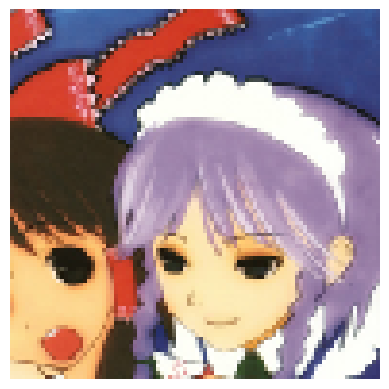

Label verdadera: Sakuya Izayoi-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 33ms/step
> Sakura Matou-Fate : 36.03 % confianza.
> Kagami Hiiragi-Lucky Star : 19.76 % confianza.
> Scarlet Remilia-Touhou : 9.83 % confianza.
> Sakuya Izayoi-Touhou : 2.75 % confianza.
> Rin Tohsakaka-Fate : 2.66 % confianza.


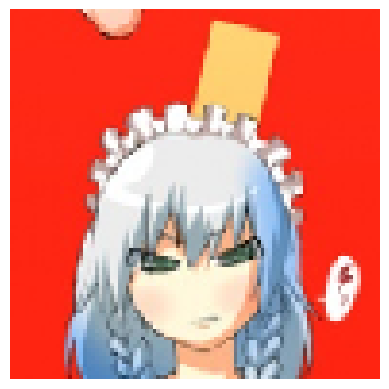

Label verdadera: Sakuya Izayoi-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Sakuya Izayoi-Touhou : 42.85 % confianza.
> Cirno-Touhou : 17.11 % confianza.
> Hatsune Miku-Vocaloid : 16.50 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 5.93 % confianza.
> Illyasviel Von Einzbern-Fate : 1.68 % confianza.


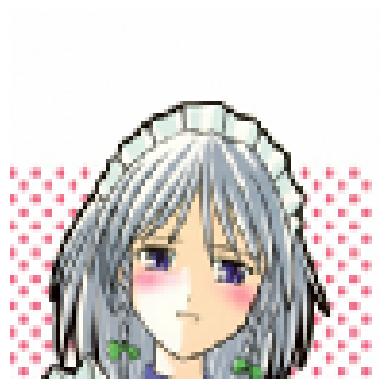

Label verdadera: Sakuya Izayoi-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Sakuya Izayoi-Touhou : 22.55 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 10.71 % confianza.
> Lelouch Lamperouge-Code Geass : 4.91 % confianza.
> Sakura Matou-Fate : 4.54 % confianza.
> Scarlet Remilia-Touhou : 4.43 % confianza.


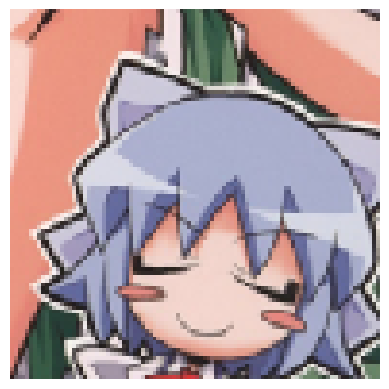

Label verdadera: Sakuya Izayoi-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Cirno-Touhou : 95.77 % confianza.
> Sakuya Izayoi-Touhou : 3.45 % confianza.
> Hatsune Miku-Vocaloid : 0.28 % confianza.
> Scarlet Remilia-Touhou : 0.17 % confianza.
> Konata Izumi-Lucky Star : 0.09 % confianza.


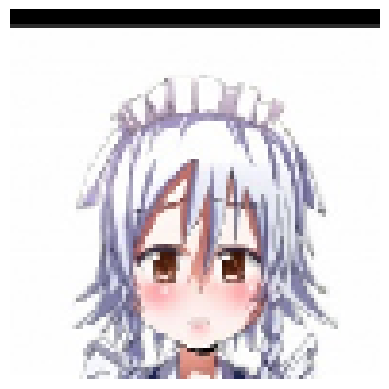

Label verdadera: Sakuya Izayoi-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Sakuya Izayoi-Touhou : 42.13 % confianza.
> Illyasviel Von Einzbern-Fate : 28.86 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 8.00 % confianza.
> Scarlet Remilia-Touhou : 6.52 % confianza.
> Cirno-Touhou : 6.26 % confianza.


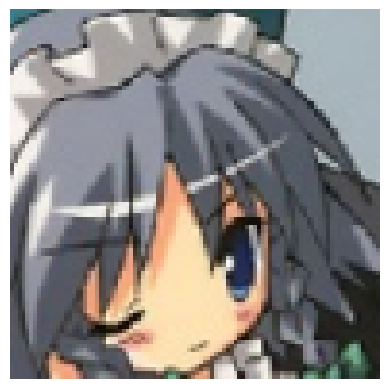

Label verdadera: Sakuya Izayoi-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Rin Tohsakaka-Fate : 35.52 % confianza.
> Sakuya Izayoi-Touhou : 25.65 % confianza.
> Ouro Kronii-Hololive : 13.53 % confianza.
> Reimu Hakurei-Touhou : 13.18 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 1.79 % confianza.


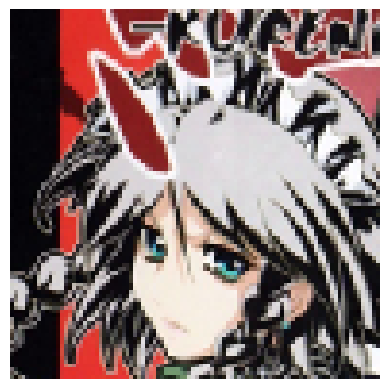

Label verdadera: Sakuya Izayoi-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Rin Tohsakaka-Fate : 45.66 % confianza.
> Reimu Hakurei-Touhou : 8.86 % confianza.
> Saber-Fate : 8.46 % confianza.
> Fubuki-One Punch Man : 6.85 % confianza.
> Flandre Scarlet-Touhou : 4.28 % confianza.


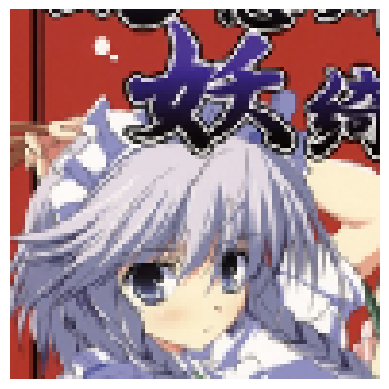

Label verdadera: Sakuya Izayoi-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Sakuya Izayoi-Touhou : 99.50 % confianza.
> Scarlet Remilia-Touhou : 0.23 % confianza.
> Cirno-Touhou : 0.15 % confianza.
> Illyasviel Von Einzbern-Fate : 0.01 % confianza.
> Arcueid Brunestud-Tsukihime : 0.01 % confianza.


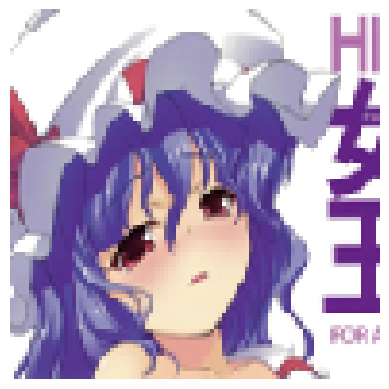

Label verdadera: Scarlet Remilia-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Sakura Matou-Fate : 51.47 % confianza.
> Kagami Hiiragi-Lucky Star : 28.07 % confianza.
> Scarlet Remilia-Touhou : 11.57 % confianza.
> Sakuya Izayoi-Touhou : 0.87 % confianza.
> Konata Izumi-Lucky Star : 0.59 % confianza.


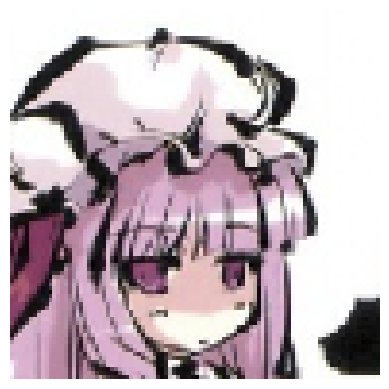

Label verdadera: Scarlet Remilia-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Scarlet Remilia-Touhou : 96.91 % confianza.
> Sakuya Izayoi-Touhou : 1.89 % confianza.
> Zero Two-Darling In the Franxx : 0.12 % confianza.
> Reimu Hakurei-Touhou : 0.10 % confianza.
> Hatsune Miku-Vocaloid : 0.07 % confianza.


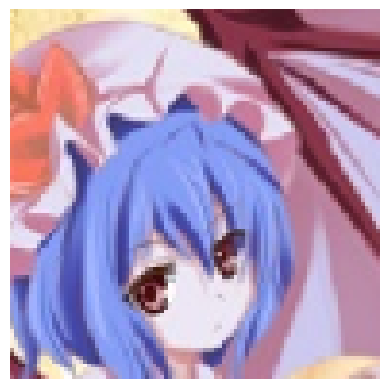

Label verdadera: Scarlet Remilia-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Sakuya Izayoi-Touhou : 33.59 % confianza.
> Scarlet Remilia-Touhou : 32.82 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 20.79 % confianza.
> Cirno-Touhou : 1.51 % confianza.
> Rem-Re Zero : 1.24 % confianza.


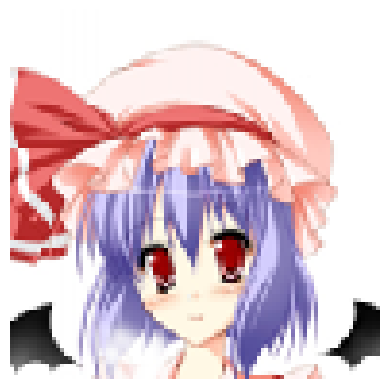

Label verdadera: Scarlet Remilia-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Scarlet Remilia-Touhou : 93.48 % confianza.
> Nia Teppelin-Gurrenn Lagann : 0.68 % confianza.
> Sakura Matou-Fate : 0.67 % confianza.
> Sakuya Izayoi-Touhou : 0.65 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.45 % confianza.


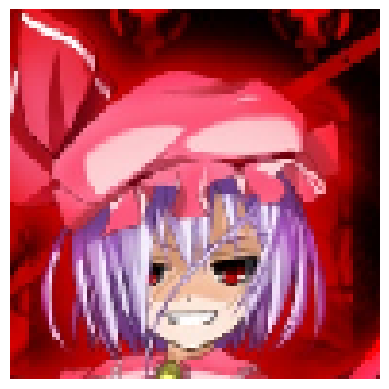

Label verdadera: Scarlet Remilia-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Scarlet Remilia-Touhou : 91.86 % confianza.
> Sakuya Izayoi-Touhou : 4.80 % confianza.
> Sakura Matou-Fate : 0.84 % confianza.
> Flandre Scarlet-Touhou : 0.18 % confianza.
> Illyasviel Von Einzbern-Fate : 0.13 % confianza.


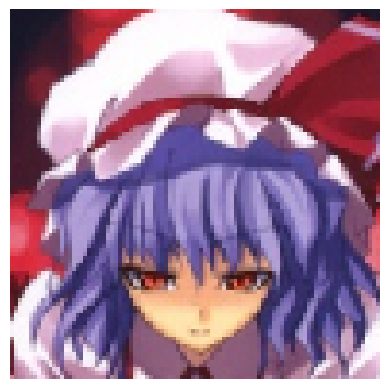

Label verdadera: Scarlet Remilia-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Scarlet Remilia-Touhou : 81.53 % confianza.
> Sakuya Izayoi-Touhou : 10.43 % confianza.
> Sakura Matou-Fate : 3.24 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 3.04 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.12 % confianza.


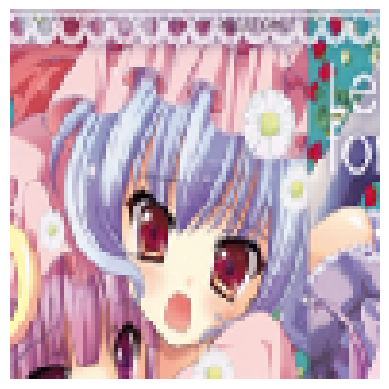

Label verdadera: Scarlet Remilia-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Scarlet Remilia-Touhou : 82.61 % confianza.
> Sakuya Izayoi-Touhou : 10.47 % confianza.
> Arcueid Brunestud-Tsukihime : 0.75 % confianza.
> Reimu Hakurei-Touhou : 0.42 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.35 % confianza.


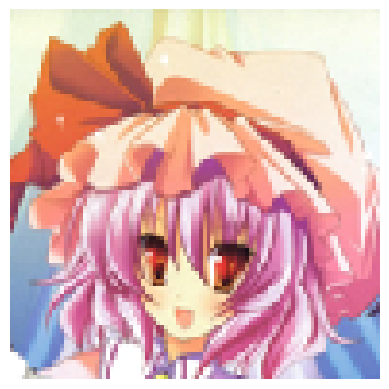

Label verdadera: Scarlet Remilia-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Scarlet Remilia-Touhou : 35.37 % confianza.
> Sakuya Izayoi-Touhou : 13.24 % confianza.
> Flandre Scarlet-Touhou : 12.20 % confianza.
> Arcueid Brunestud-Tsukihime : 8.25 % confianza.
> Hatsune Miku-Vocaloid : 4.38 % confianza.


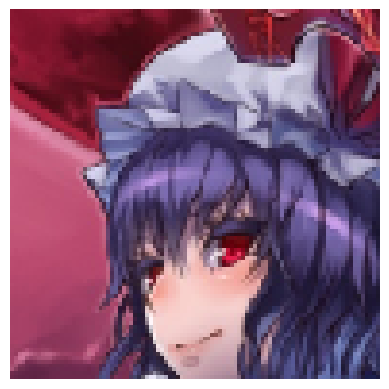

Label verdadera: Scarlet Remilia-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Scarlet Remilia-Touhou : 76.29 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 9.91 % confianza.
> Reimu Hakurei-Touhou : 2.94 % confianza.
> Sakura Matou-Fate : 1.37 % confianza.
> Sakuya Izayoi-Touhou : 1.37 % confianza.


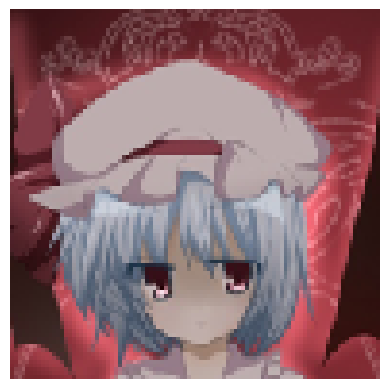

Label verdadera: Scarlet Remilia-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Sakuya Izayoi-Touhou : 70.91 % confianza.
> Scarlet Remilia-Touhou : 26.45 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.49 % confianza.
> Sakura Matou-Fate : 0.40 % confianza.
> Hatsune Miku-Vocaloid : 0.29 % confianza.


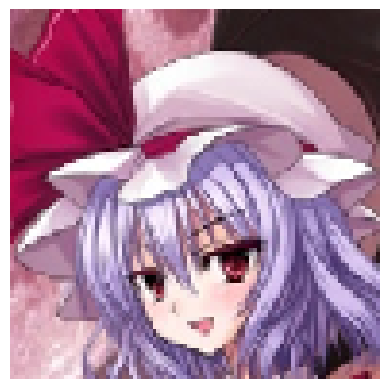

Label verdadera: Scarlet Remilia-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Scarlet Remilia-Touhou : 90.57 % confianza.
> Sakuya Izayoi-Touhou : 7.71 % confianza.
> Sakura Matou-Fate : 0.36 % confianza.
> Illyasviel Von Einzbern-Fate : 0.15 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 0.13 % confianza.


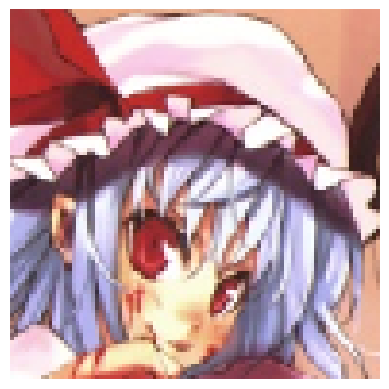

Label verdadera: Scarlet Remilia-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Scarlet Remilia-Touhou : 95.12 % confianza.
> Sakuya Izayoi-Touhou : 2.76 % confianza.
> Flandre Scarlet-Touhou : 0.18 % confianza.
> Arcueid Brunestud-Tsukihime : 0.18 % confianza.
> Reimu Hakurei-Touhou : 0.16 % confianza.


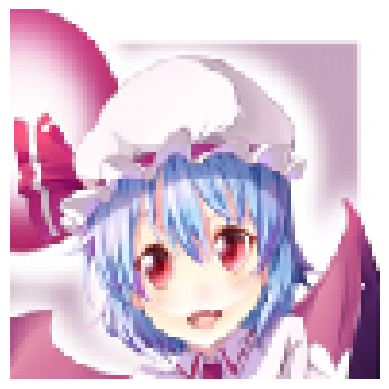

Label verdadera: Scarlet Remilia-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Scarlet Remilia-Touhou : 98.86 % confianza.
> Sakuya Izayoi-Touhou : 0.33 % confianza.
> Nia Teppelin-Gurrenn Lagann : 0.10 % confianza.
> Flandre Scarlet-Touhou : 0.05 % confianza.
> Sakura Matou-Fate : 0.05 % confianza.


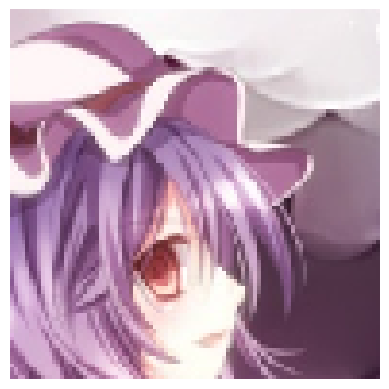

Label verdadera: Scarlet Remilia-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Scarlet Remilia-Touhou : 91.51 % confianza.
> Sakuya Izayoi-Touhou : 3.02 % confianza.
> Arcueid Brunestud-Tsukihime : 0.76 % confianza.
> Illyasviel Von Einzbern-Fate : 0.57 % confianza.
> Sakura Matou-Fate : 0.54 % confianza.


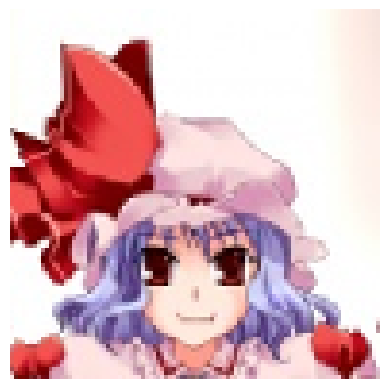

Label verdadera: Scarlet Remilia-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Scarlet Remilia-Touhou : 97.58 % confianza.
> Sakuya Izayoi-Touhou : 0.97 % confianza.
> Reimu Hakurei-Touhou : 0.75 % confianza.
> Sakura Matou-Fate : 0.14 % confianza.
> Rem-Re Zero : 0.09 % confianza.


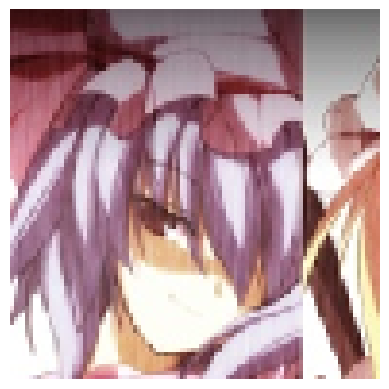

Label verdadera: Scarlet Remilia-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 38ms/step
> Scarlet Remilia-Touhou : 71.92 % confianza.
> Sakuya Izayoi-Touhou : 22.04 % confianza.
> Miku Nakano-Quintessential Quintuplets : 0.76 % confianza.
> Zero Two-Darling In the Franxx : 0.57 % confianza.
> Sakura Matou-Fate : 0.57 % confianza.


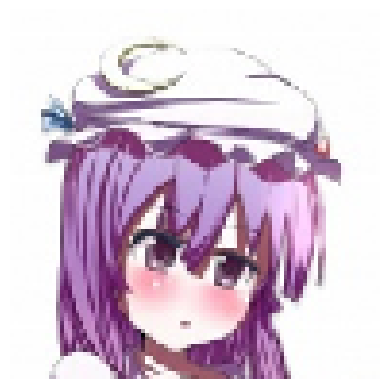

Label verdadera: Scarlet Remilia-Touhou
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Scarlet Remilia-Touhou : 29.94 % confianza.
> Sakura Matou-Fate : 28.53 % confianza.
> Reimu Hakurei-Touhou : 5.42 % confianza.
> Nino Nakano-Quintessential Quintuplets : 4.46 % confianza.
> Sakuya Izayoi-Touhou : 3.86 % confianza.


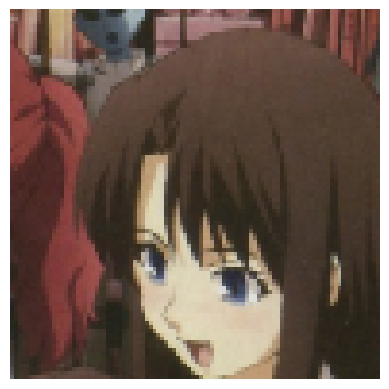

Label verdadera: Shiki Ryougi-Garden of Sinners
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Shiki Ryougi-Garden of Sinners : 87.45 % confianza.
> Rin Tohsakaka-Fate : 8.27 % confianza.
> Reimu Hakurei-Touhou : 1.85 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 0.53 % confianza.
> Kurisu Makise-Steins Gate : 0.33 % confianza.


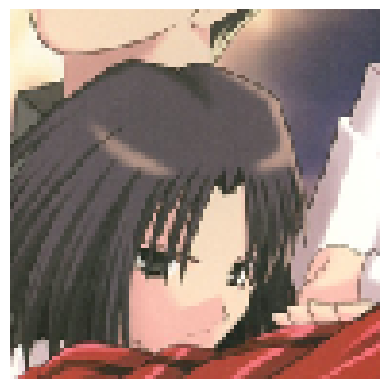

Label verdadera: Shiki Ryougi-Garden of Sinners
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Lelouch Lamperouge-Code Geass : 61.39 % confianza.
> Rin Tohsakaka-Fate : 12.75 % confianza.
> Shiki Ryougi-Garden of Sinners : 5.80 % confianza.
> Reimu Hakurei-Touhou : 1.95 % confianza.
> Sakuya Izayoi-Touhou : 1.72 % confianza.


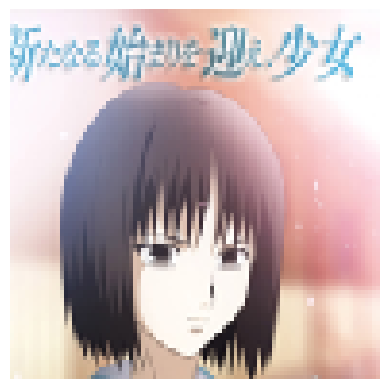

Label verdadera: Shiki Ryougi-Garden of Sinners
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Shiki Ryougi-Garden of Sinners : 95.20 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 1.13 % confianza.
> Lelouch Lamperouge-Code Geass : 0.66 % confianza.
> Rin Tohsakaka-Fate : 0.49 % confianza.
> Reimu Hakurei-Touhou : 0.43 % confianza.


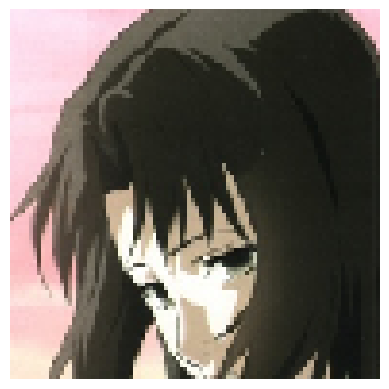

Label verdadera: Shiki Ryougi-Garden of Sinners
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Shiki Ryougi-Garden of Sinners : 98.20 % confianza.
> Lelouch Lamperouge-Code Geass : 1.42 % confianza.
> Rin Tohsakaka-Fate : 0.07 % confianza.
> Kirito-Sword Art Online : 0.06 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 0.02 % confianza.


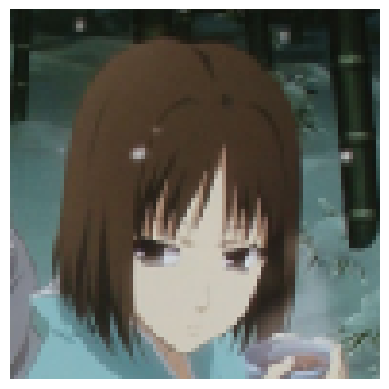

Label verdadera: Shiki Ryougi-Garden of Sinners
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Shiki Ryougi-Garden of Sinners : 97.44 % confianza.
> Yui Hirasawa-K ON! : 0.38 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 0.37 % confianza.
> Reimu Hakurei-Touhou : 0.26 % confianza.
> Aisaka Taiga-Toradora : 0.22 % confianza.


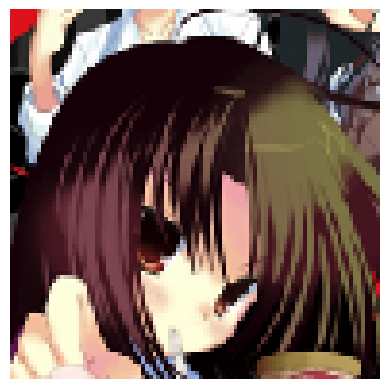

Label verdadera: Shiki Ryougi-Garden of Sinners
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Lelouch Lamperouge-Code Geass : 95.41 % confianza.
> Reimu Hakurei-Touhou : 1.11 % confianza.
> Suzaku Kururugi-Code Geass : 0.43 % confianza.
> Rin Tohsakaka-Fate : 0.30 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.23 % confianza.


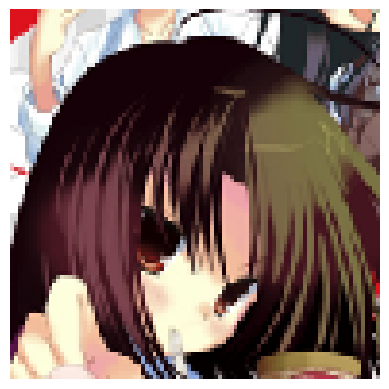

Label verdadera: Shiki Ryougi-Garden of Sinners
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Lelouch Lamperouge-Code Geass : 96.59 % confianza.
> Reimu Hakurei-Touhou : 0.52 % confianza.
> Suzaku Kururugi-Code Geass : 0.35 % confianza.
> Rin Tohsakaka-Fate : 0.26 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.21 % confianza.


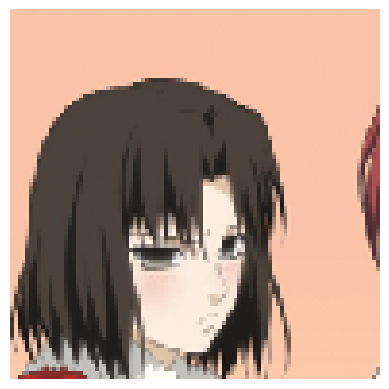

Label verdadera: Shiki Ryougi-Garden of Sinners
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Shiki Ryougi-Garden of Sinners : 98.01 % confianza.
> Rin Tohsakaka-Fate : 0.80 % confianza.
> Lelouch Lamperouge-Code Geass : 0.20 % confianza.
> Kirito-Sword Art Online : 0.19 % confianza.
> Shouko Komi-Komi Cant Communicate : 0.10 % confianza.


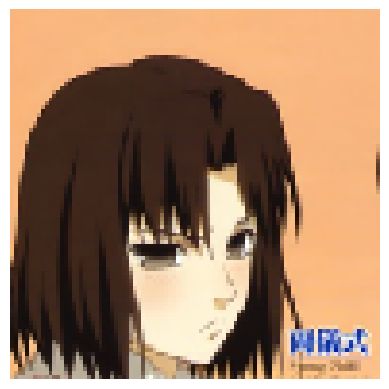

Label verdadera: Shiki Ryougi-Garden of Sinners
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Shiki Ryougi-Garden of Sinners : 90.35 % confianza.
> Yui Hirasawa-K ON! : 1.60 % confianza.
> Kirito-Sword Art Online : 1.13 % confianza.
> Lelouch Lamperouge-Code Geass : 1.09 % confianza.
> Rin Tohsakaka-Fate : 0.56 % confianza.


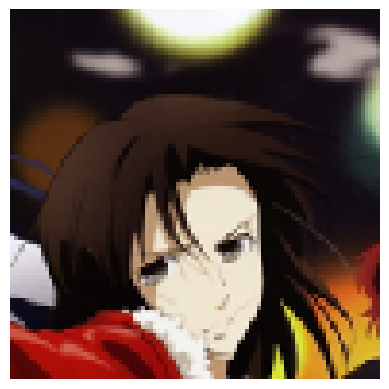

Label verdadera: Shiki Ryougi-Garden of Sinners
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Shiki Ryougi-Garden of Sinners : 88.18 % confianza.
> Lelouch Lamperouge-Code Geass : 3.22 % confianza.
> Rin Tohsakaka-Fate : 1.58 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 1.41 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.72 % confianza.


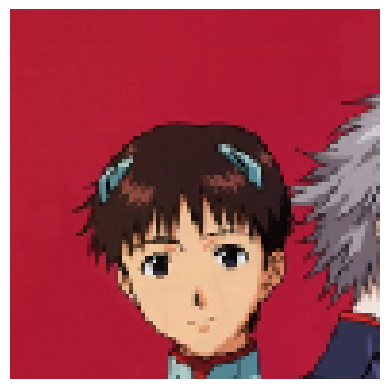

Label verdadera: Shinji Ikari-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Rin Tohsakaka-Fate : 21.22 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 18.38 % confianza.
> Maka Albarn-Soul Eater : 7.29 % confianza.
> Shiki Ryougi-Garden of Sinners : 7.24 % confianza.
> Reimu Hakurei-Touhou : 5.58 % confianza.


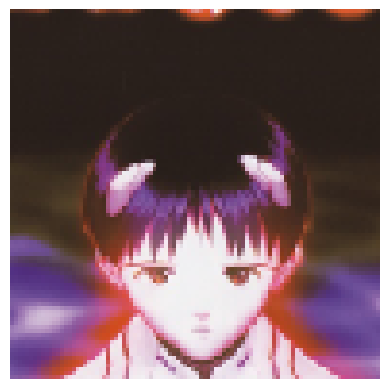

Label verdadera: Shinji Ikari-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Sakura Matou-Fate : 88.96 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 1.18 % confianza.
> Keqing-Genshin Impact : 0.92 % confianza.
> Megumin-Konosuba : 0.91 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.91 % confianza.


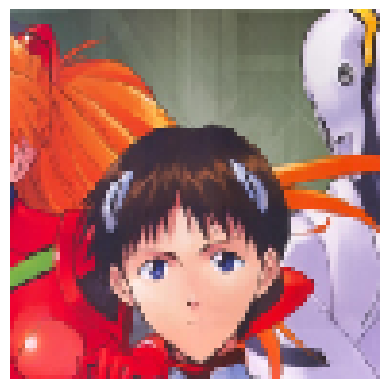

Label verdadera: Shinji Ikari-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Rin Tohsakaka-Fate : 23.97 % confianza.
> Reimu Hakurei-Touhou : 18.93 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 8.32 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 7.60 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 7.34 % confianza.


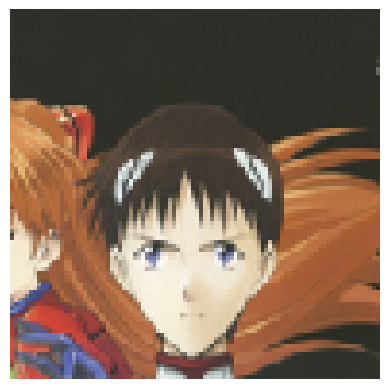

Label verdadera: Shinji Ikari-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Yui Hirasawa-K ON! : 77.56 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 5.77 % confianza.
> Kurisu Makise-Steins Gate : 4.77 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 3.46 % confianza.
> Ritsu Tainaka-K ON! : 1.93 % confianza.


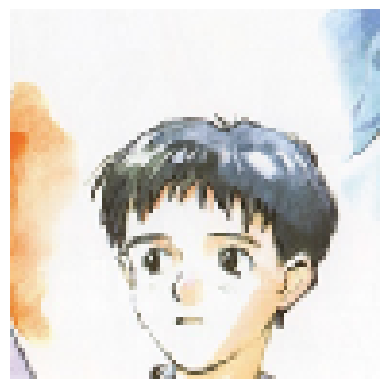

Label verdadera: Shinji Ikari-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Shinji Ikari-Neon Genesis Evangelion : 83.64 % confianza.
> Ritsu Tainaka-K ON! : 4.25 % confianza.
> Lelouch Lamperouge-Code Geass : 1.84 % confianza.
> Illyasviel Von Einzbern-Fate : 1.27 % confianza.
> Sakuya Izayoi-Touhou : 1.19 % confianza.


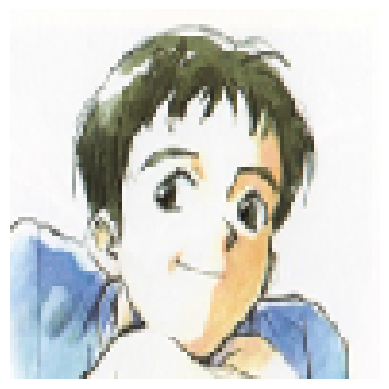

Label verdadera: Shinji Ikari-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 48ms/step
> Shinji Ikari-Neon Genesis Evangelion : 70.74 % confianza.
> Ritsu Tainaka-K ON! : 24.73 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.89 % confianza.
> Maka Albarn-Soul Eater : 0.72 % confianza.
> Rin Tohsakaka-Fate : 0.31 % confianza.


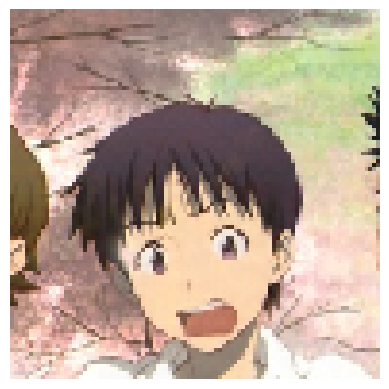

Label verdadera: Shinji Ikari-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Shinji Ikari-Neon Genesis Evangelion : 31.84 % confianza.
> Shiki Ryougi-Garden of Sinners : 30.67 % confianza.
> Rin Tohsakaka-Fate : 9.22 % confianza.
> Sakura Matou-Fate : 3.04 % confianza.
> Maka Albarn-Soul Eater : 3.04 % confianza.


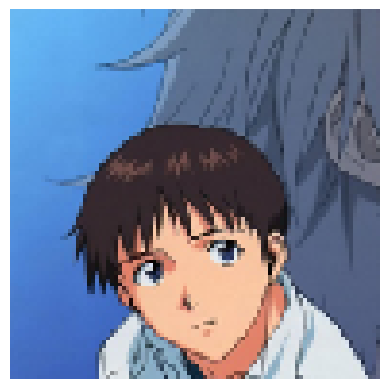

Label verdadera: Shinji Ikari-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 44ms/step
> Rin Tohsakaka-Fate : 24.98 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 24.17 % confianza.
> Shiki Ryougi-Garden of Sinners : 8.17 % confianza.
> Cirno-Touhou : 6.61 % confianza.
> Suzaku Kururugi-Code Geass : 3.58 % confianza.


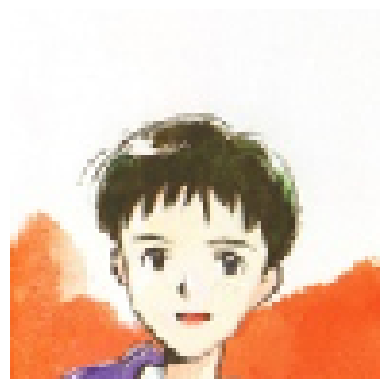

Label verdadera: Shinji Ikari-Neon Genesis Evangelion
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Shinji Ikari-Neon Genesis Evangelion : 35.21 % confianza.
> Shiki Ryougi-Garden of Sinners : 24.84 % confianza.
> Yui Hirasawa-K ON! : 7.53 % confianza.
> Ritsu Tainaka-K ON! : 5.41 % confianza.
> Suzaku Kururugi-Code Geass : 4.56 % confianza.


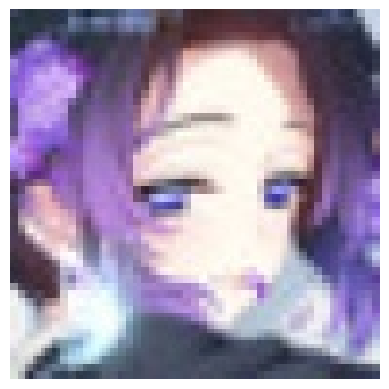

Label verdadera: Shinobu Kochou-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Shinobu Kochou-Demon Slayer : 97.71 % confianza.
> Nozomi Tojo-Love Live : 0.37 % confianza.
> Hinata Hyuuga-Naruto : 0.30 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.20 % confianza.
> Maki Nishikino-Love Live : 0.13 % confianza.


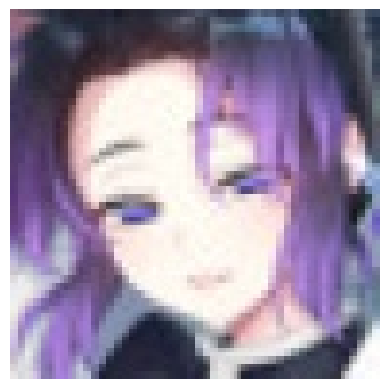

Label verdadera: Shinobu Kochou-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Shinobu Kochou-Demon Slayer : 99.38 % confianza.
> Hinata Hyuuga-Naruto : 0.16 % confianza.
> Maki Nishikino-Love Live : 0.10 % confianza.
> Nozomi Tojo-Love Live : 0.03 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.02 % confianza.


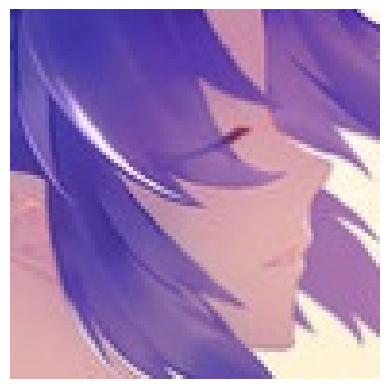

Label verdadera: Shinobu Kochou-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 36ms/step
> Shinobu Kochou-Demon Slayer : 74.09 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 5.14 % confianza.
> Hinata Hyuuga-Naruto : 5.05 % confianza.
> Shiki Ryougi-Garden of Sinners : 1.92 % confianza.
> Amelia Watson-Hololive : 1.54 % confianza.


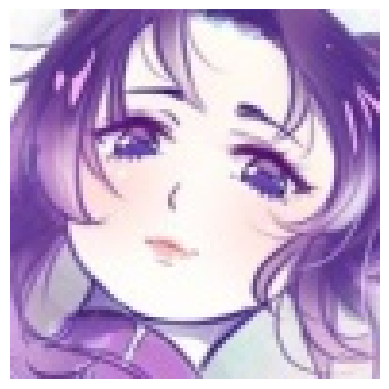

Label verdadera: Shinobu Kochou-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Shinobu Kochou-Demon Slayer : 90.84 % confianza.
> Maki Nishikino-Love Live : 1.68 % confianza.
> Nozomi Tojo-Love Live : 0.90 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.76 % confianza.
> Hifumi Takimoto-New Game! : 0.47 % confianza.


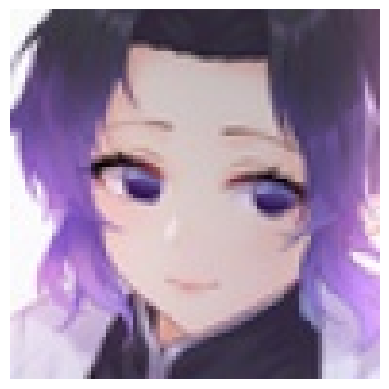

Label verdadera: Shinobu Kochou-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Shinobu Kochou-Demon Slayer : 99.69 % confianza.
> Hinata Hyuuga-Naruto : 0.09 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.03 % confianza.
> Emilia-Re Zero : 0.02 % confianza.
> Maki Nishikino-Love Live : 0.02 % confianza.


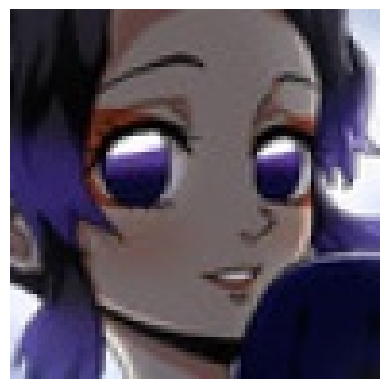

Label verdadera: Shinobu Kochou-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Shinobu Kochou-Demon Slayer : 81.12 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 15.68 % confianza.
> Kirito-Sword Art Online : 1.05 % confianza.
> Paimon-Genshin Impact : 0.53 % confianza.
> Keqing-Genshin Impact : 0.28 % confianza.


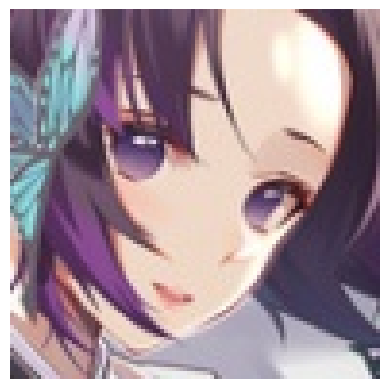

Label verdadera: Shinobu Kochou-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 34ms/step
> Shinobu Kochou-Demon Slayer : 99.04 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.29 % confianza.
> Hinata Hyuuga-Naruto : 0.11 % confianza.
> Paimon-Genshin Impact : 0.09 % confianza.
> Kirito-Sword Art Online : 0.07 % confianza.


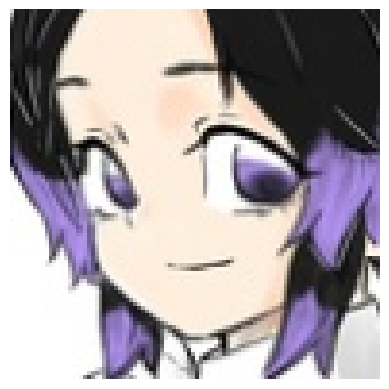

Label verdadera: Shinobu Kochou-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Shinobu Kochou-Demon Slayer : 99.90 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.01 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.01 % confianza.
> Hifumi Takimoto-New Game! : 0.01 % confianza.
> Hinata Hyuuga-Naruto : 0.01 % confianza.


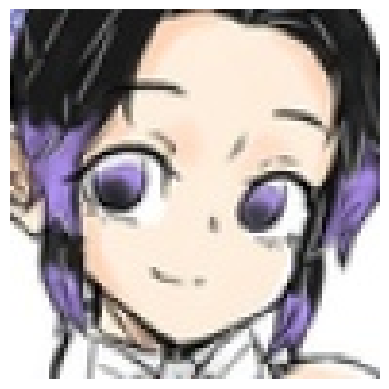

Label verdadera: Shinobu Kochou-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Shinobu Kochou-Demon Slayer : 99.77 % confianza.
> Paimon-Genshin Impact : 0.11 % confianza.
> Nezuko Kamado-Demon Slayer : 0.02 % confianza.
> Emilia-Re Zero : 0.01 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.01 % confianza.


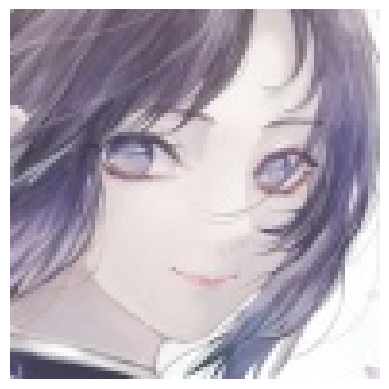

Label verdadera: Shinobu Kochou-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Shinobu Kochou-Demon Slayer : 71.43 % confianza.
> Hinata Hyuuga-Naruto : 9.97 % confianza.
> Emilia-Re Zero : 3.26 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 2.85 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 1.90 % confianza.


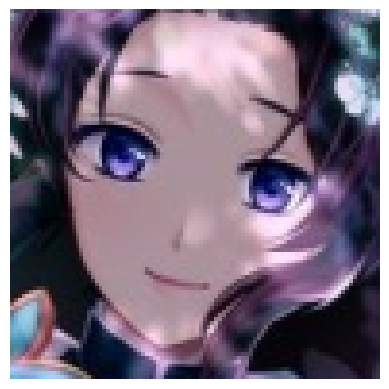

Label verdadera: Shinobu Kochou-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Shinobu Kochou-Demon Slayer : 99.75 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.12 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.03 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.02 % confianza.
> Paimon-Genshin Impact : 0.01 % confianza.


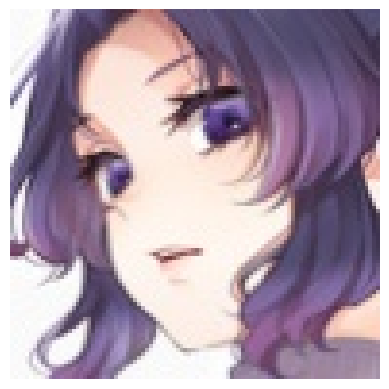

Label verdadera: Shinobu Kochou-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Shinobu Kochou-Demon Slayer : 87.12 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 2.66 % confianza.
> Keqing-Genshin Impact : 2.20 % confianza.
> Sakura Matou-Fate : 0.94 % confianza.
> Kagami Hiiragi-Lucky Star : 0.67 % confianza.


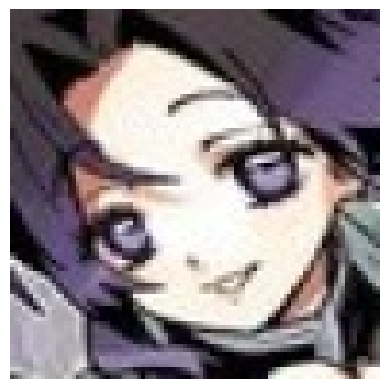

Label verdadera: Shinobu Kochou-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Shinobu Kochou-Demon Slayer : 44.98 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 23.17 % confianza.
> Paimon-Genshin Impact : 8.29 % confianza.
> Kirito-Sword Art Online : 6.45 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 3.69 % confianza.


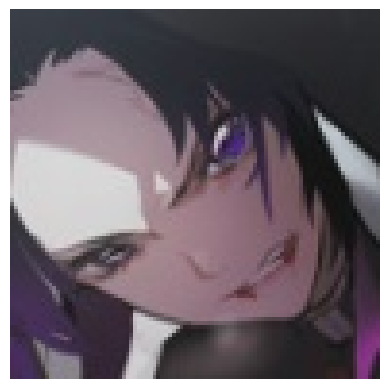

Label verdadera: Shinobu Kochou-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Shinobu Kochou-Demon Slayer : 64.88 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 17.73 % confianza.
> Kirito-Sword Art Online : 4.96 % confianza.
> Astolfo-Fate : 2.25 % confianza.
> Nico Robin-One Piece : 1.94 % confianza.


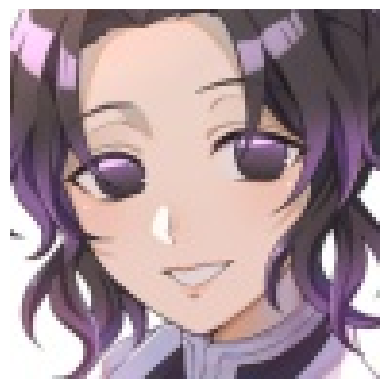

Label verdadera: Shinobu Kochou-Demon Slayer
Este personaje posiblemente es:
1/1 [==============================] - 0s 32ms/step
> Shinobu Kochou-Demon Slayer : 99.63 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.07 % confianza.
> Maki Nishikino-Love Live : 0.06 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.03 % confianza.
> Nezuko Kamado-Demon Slayer : 0.02 % confianza.


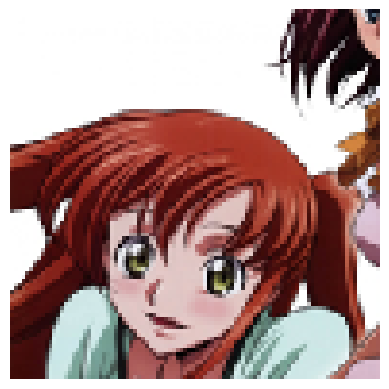

Label verdadera: Shirley Fenette-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Shirley Fenette-Code Geass : 85.24 % confianza.
> Suzaku Kururugi-Code Geass : 2.36 % confianza.
> Yoko Littner-Gurrenn Lagann : 2.10 % confianza.
> Kallen Stadtfeld-Code Geass : 0.95 % confianza.
> Maki Nishikino-Love Live : 0.66 % confianza.


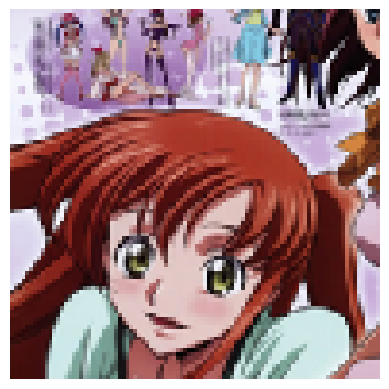

Label verdadera: Shirley Fenette-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Shirley Fenette-Code Geass : 80.14 % confianza.
> Suzaku Kururugi-Code Geass : 5.41 % confianza.
> Yoko Littner-Gurrenn Lagann : 2.26 % confianza.
> Kallen Stadtfeld-Code Geass : 1.16 % confianza.
> Maki Nishikino-Love Live : 0.97 % confianza.


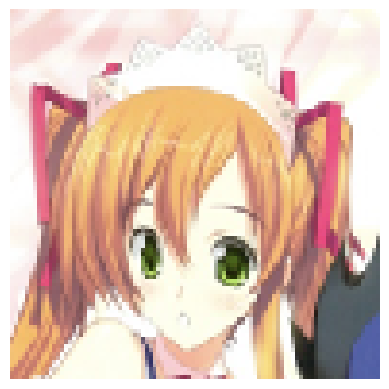

Label verdadera: Shirley Fenette-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Shirley Fenette-Code Geass : 68.93 % confianza.
> Aisaka Taiga-Toradora : 5.67 % confianza.
> Flandre Scarlet-Touhou : 3.56 % confianza.
> Maka Albarn-Soul Eater : 3.11 % confianza.
> Suzaku Kururugi-Code Geass : 2.03 % confianza.


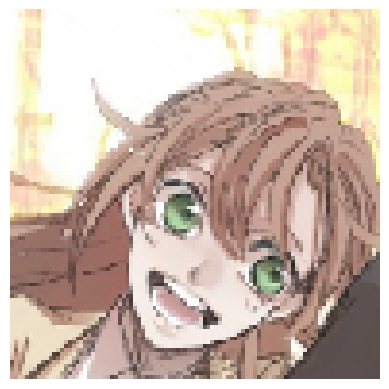

Label verdadera: Shirley Fenette-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Shirley Fenette-Code Geass : 74.08 % confianza.
> Suzaku Kururugi-Code Geass : 14.16 % confianza.
> Zero Two-Darling In the Franxx : 3.47 % confianza.
> Fubuki-One Punch Man : 1.32 % confianza.
> Saber-Fate : 1.01 % confianza.


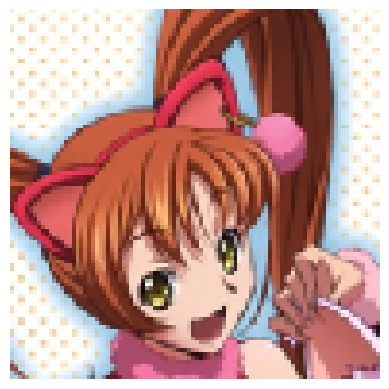

Label verdadera: Shirley Fenette-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Shirley Fenette-Code Geass : 86.16 % confianza.
> Aisaka Taiga-Toradora : 4.45 % confianza.
> Suzaku Kururugi-Code Geass : 1.71 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 1.44 % confianza.
> Yui Hirasawa-K ON! : 0.92 % confianza.


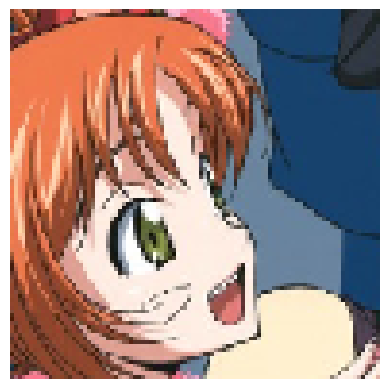

Label verdadera: Shirley Fenette-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Shirley Fenette-Code Geass : 81.10 % confianza.
> Sakuya Izayoi-Touhou : 2.57 % confianza.
> Arcueid Brunestud-Tsukihime : 1.78 % confianza.
> Flandre Scarlet-Touhou : 1.24 % confianza.
> Suzaku Kururugi-Code Geass : 0.91 % confianza.


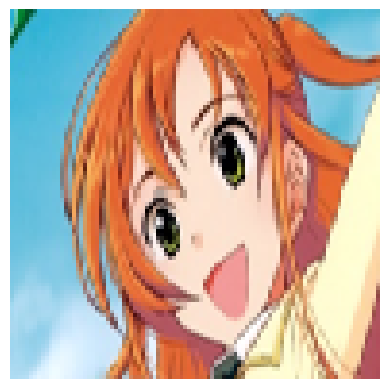

Label verdadera: Shirley Fenette-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Shirley Fenette-Code Geass : 43.93 % confianza.
> Kallen Stadtfeld-Code Geass : 8.44 % confianza.
> Nami-One Piece : 4.99 % confianza.
> Yui Hirasawa-K ON! : 3.61 % confianza.
> Yoko Littner-Gurrenn Lagann : 3.43 % confianza.


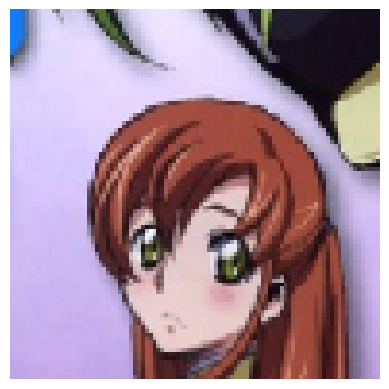

Label verdadera: Shirley Fenette-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 32ms/step
> Shirley Fenette-Code Geass : 99.57 % confianza.
> Aisaka Taiga-Toradora : 0.06 % confianza.
> Maki Nishikino-Love Live : 0.06 % confianza.
> Maka Albarn-Soul Eater : 0.04 % confianza.
> Suzaku Kururugi-Code Geass : 0.03 % confianza.


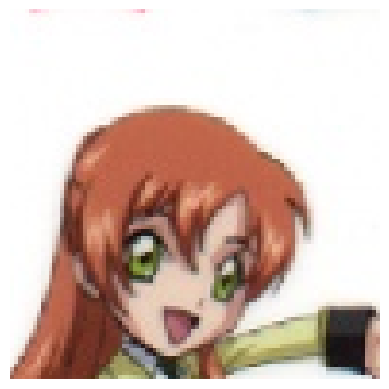

Label verdadera: Shirley Fenette-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Shirley Fenette-Code Geass : 98.93 % confianza.
> Aisaka Taiga-Toradora : 0.42 % confianza.
> Yoko Littner-Gurrenn Lagann : 0.18 % confianza.
> Yui Hirasawa-K ON! : 0.08 % confianza.
> Maka Albarn-Soul Eater : 0.07 % confianza.


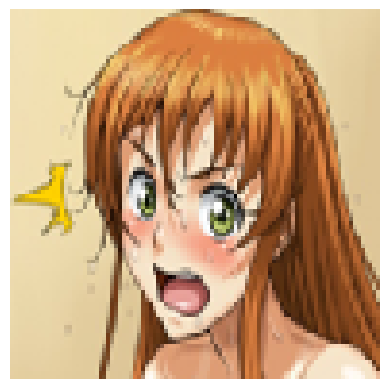

Label verdadera: Shirley Fenette-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 34ms/step
> Shirley Fenette-Code Geass : 88.56 % confianza.
> Aisaka Taiga-Toradora : 4.66 % confianza.
> Arcueid Brunestud-Tsukihime : 0.76 % confianza.
> Yui Hirasawa-K ON! : 0.64 % confianza.
> Suzaku Kururugi-Code Geass : 0.59 % confianza.


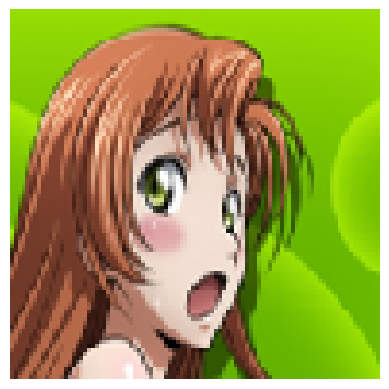

Label verdadera: Shirley Fenette-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Shirley Fenette-Code Geass : 99.36 % confianza.
> Aisaka Taiga-Toradora : 0.24 % confianza.
> Maki Nishikino-Love Live : 0.05 % confianza.
> Suzaku Kururugi-Code Geass : 0.04 % confianza.
> Yui Hirasawa-K ON! : 0.04 % confianza.


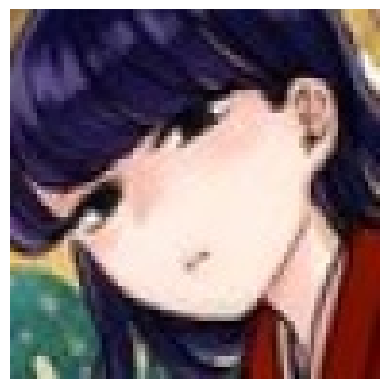

Label verdadera: Shouko Komi-Komi Cant Communicate
Este personaje posiblemente es:
1/1 [==============================] - 0s 39ms/step
> Misato Katsuragi-Neon Genesis Evangelion : 52.73 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 20.76 % confianza.
> Shouko Komi-Komi Cant Communicate : 13.36 % confianza.
> Nozomi Tojo-Love Live : 3.33 % confianza.
> Rikka Takanashi-Love, Chunibyo and Other Delusions! : 2.26 % confianza.


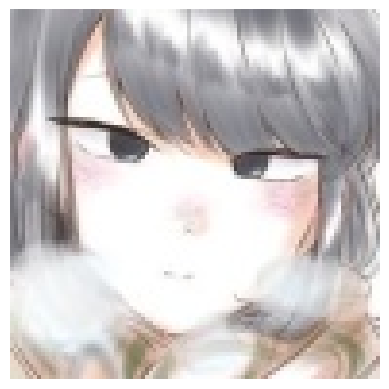

Label verdadera: Shouko Komi-Komi Cant Communicate
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Shouko Komi-Komi Cant Communicate : 87.33 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 2.32 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 1.12 % confianza.
> Gawr Gura-Hololive : 0.97 % confianza.
> Emilia-Re Zero : 0.75 % confianza.


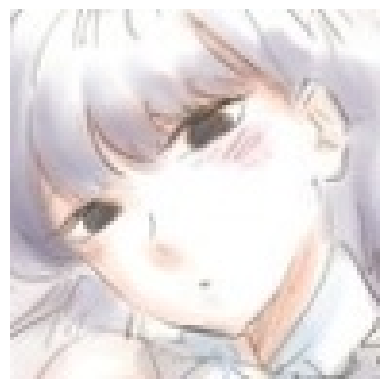

Label verdadera: Shouko Komi-Komi Cant Communicate
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Shouko Komi-Komi Cant Communicate : 44.09 % confianza.
> Emilia-Re Zero : 18.07 % confianza.
> Paimon-Genshin Impact : 4.56 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 3.33 % confianza.
> Rei Ayanami-Neon Genesis Evangelion : 3.20 % confianza.


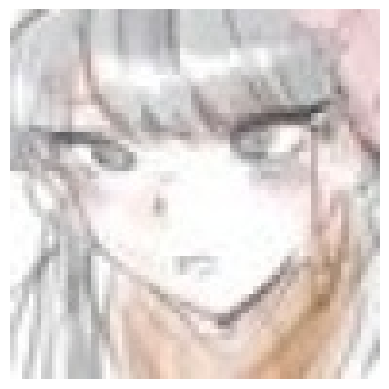

Label verdadera: Shouko Komi-Komi Cant Communicate
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 40.59 % confianza.
> Kurisu Makise-Steins Gate : 15.46 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 10.49 % confianza.
> Fubuki-One Punch Man : 5.82 % confianza.
> Asuna Yuuki-Sword Art Online : 4.03 % confianza.


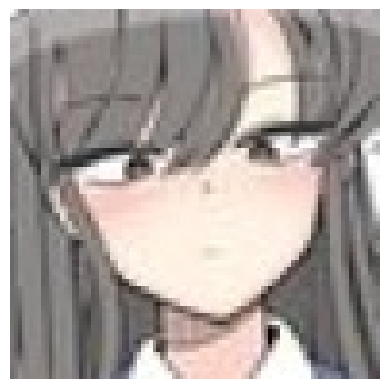

Label verdadera: Shouko Komi-Komi Cant Communicate
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Shouko Komi-Komi Cant Communicate : 99.52 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.10 % confianza.
> Asuna Yuuki-Sword Art Online : 0.04 % confianza.
> Fubuki-One Punch Man : 0.04 % confianza.
> Megumin-Konosuba : 0.04 % confianza.


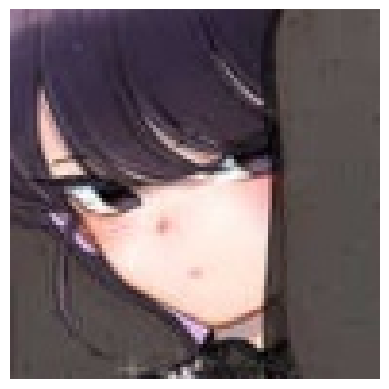

Label verdadera: Shouko Komi-Komi Cant Communicate
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Shouko Komi-Komi Cant Communicate : 96.73 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.42 % confianza.
> Hinata Hyuuga-Naruto : 0.30 % confianza.
> Megumin-Konosuba : 0.29 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.19 % confianza.


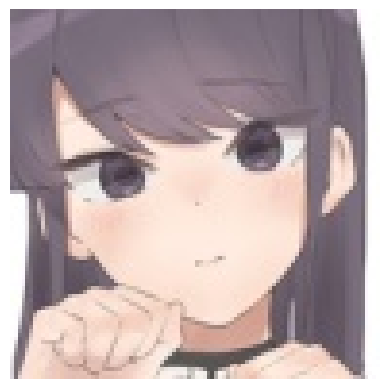

Label verdadera: Shouko Komi-Komi Cant Communicate
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Shouko Komi-Komi Cant Communicate : 98.61 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.19 % confianza.
> Hifumi Takimoto-New Game! : 0.16 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.10 % confianza.
> Shinobu Kochou-Demon Slayer : 0.08 % confianza.


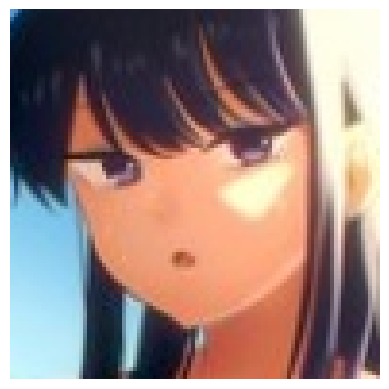

Label verdadera: Shouko Komi-Komi Cant Communicate
Este personaje posiblemente es:
1/1 [==============================] - 0s 37ms/step
> Shouko Komi-Komi Cant Communicate : 39.67 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 11.15 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 10.95 % confianza.
> Hinata Hyuuga-Naruto : 10.07 % confianza.
> Fubuki-One Punch Man : 5.36 % confianza.


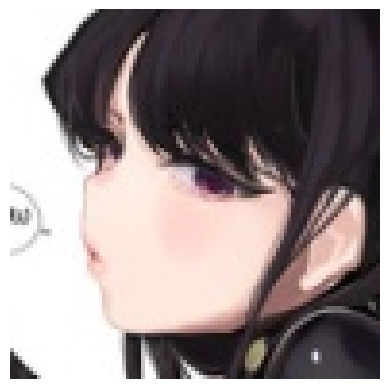

Label verdadera: Shouko Komi-Komi Cant Communicate
Este personaje posiblemente es:
1/1 [==============================] - 0s 35ms/step
> Shouko Komi-Komi Cant Communicate : 95.89 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 1.33 % confianza.
> Nezuko Kamado-Demon Slayer : 0.42 % confianza.
> Fubuki-One Punch Man : 0.32 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.27 % confianza.


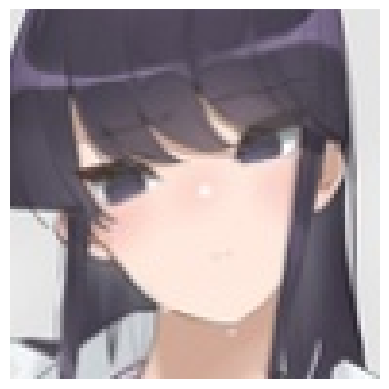

Label verdadera: Shouko Komi-Komi Cant Communicate
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Shouko Komi-Komi Cant Communicate : 99.78 % confianza.
> Hifumi Takimoto-New Game! : 0.04 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.03 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.02 % confianza.
> Shinobu Kochou-Demon Slayer : 0.01 % confianza.


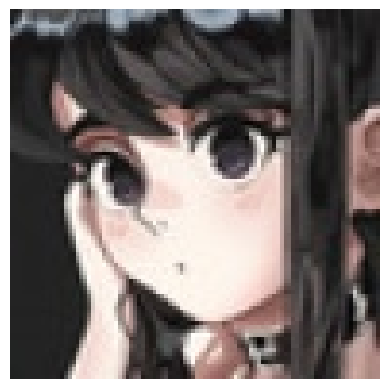

Label verdadera: Shouko Komi-Komi Cant Communicate
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Shouko Komi-Komi Cant Communicate : 78.59 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 6.72 % confianza.
> Kirito-Sword Art Online : 3.30 % confianza.
> Megumin-Konosuba : 2.57 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 1.85 % confianza.


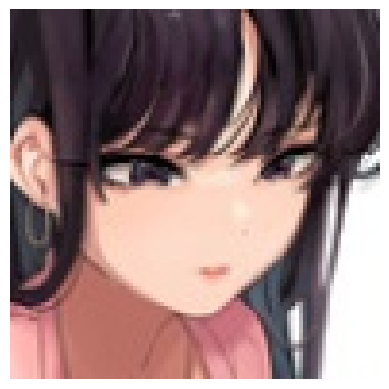

Label verdadera: Shouko Komi-Komi Cant Communicate
Este personaje posiblemente es:
1/1 [==============================] - 0s 39ms/step
> Shouko Komi-Komi Cant Communicate : 92.25 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 3.52 % confianza.
> Kaguya Shinomiya-Kaguya Sama Love Is War : 0.68 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.67 % confianza.
> Fubuki-One Punch Man : 0.51 % confianza.


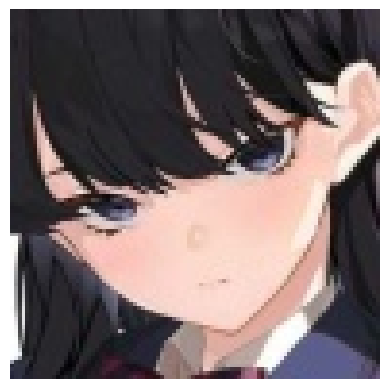

Label verdadera: Shouko Komi-Komi Cant Communicate
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Shouko Komi-Komi Cant Communicate : 99.81 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.03 % confianza.
> Nezuko Kamado-Demon Slayer : 0.02 % confianza.
> Fubuki-One Punch Man : 0.02 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 0.01 % confianza.


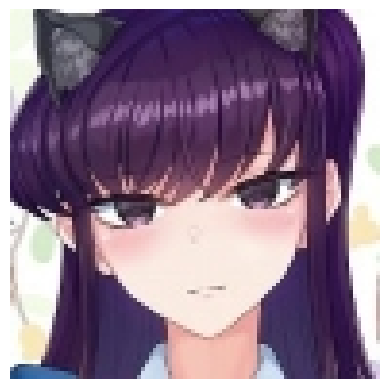

Label verdadera: Shouko Komi-Komi Cant Communicate
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Sakura Matou-Fate : 57.89 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 10.95 % confianza.
> Hifumi Takimoto-New Game! : 6.81 % confianza.
> Shouko Komi-Komi Cant Communicate : 3.34 % confianza.
> Reimu Hakurei-Touhou : 2.76 % confianza.


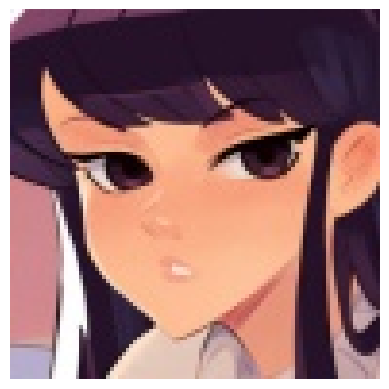

Label verdadera: Shouko Komi-Komi Cant Communicate
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Misato Katsuragi-Neon Genesis Evangelion : 83.22 % confianza.
> Shouko Komi-Komi Cant Communicate : 7.40 % confianza.
> Shinobu Kochou-Demon Slayer : 4.25 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 1.08 % confianza.
> Hinata Hyuuga-Naruto : 0.70 % confianza.


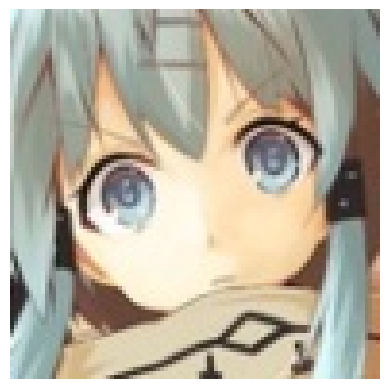

Label verdadera: Sinon-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Sinon-Sword Art Online : 93.65 % confianza.
> Aqua-Konosuba : 2.11 % confianza.
> Aegis-Persona : 1.02 % confianza.
> Paimon-Genshin Impact : 0.55 % confianza.
> Gawr Gura-Hololive : 0.31 % confianza.


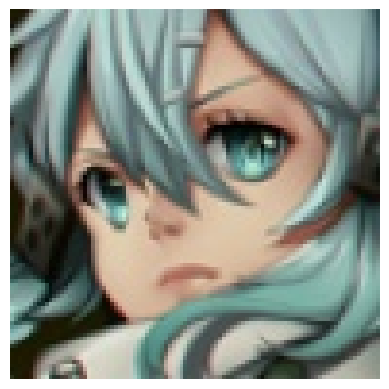

Label verdadera: Sinon-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Sinon-Sword Art Online : 92.26 % confianza.
> Hatsune Miku-Vocaloid : 2.24 % confianza.
> Aqua-Konosuba : 1.39 % confianza.
> Cirno-Touhou : 0.71 % confianza.
> Kirito-Sword Art Online : 0.42 % confianza.


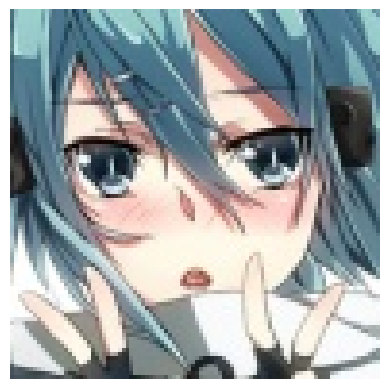

Label verdadera: Sinon-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Sinon-Sword Art Online : 39.83 % confianza.
> Aqua-Konosuba : 26.23 % confianza.
> Kirito-Sword Art Online : 12.28 % confianza.
> Paimon-Genshin Impact : 6.08 % confianza.
> Mai Sakurajima-Rascal Does Not Dream of Bunny Girl Senpai : 2.63 % confianza.


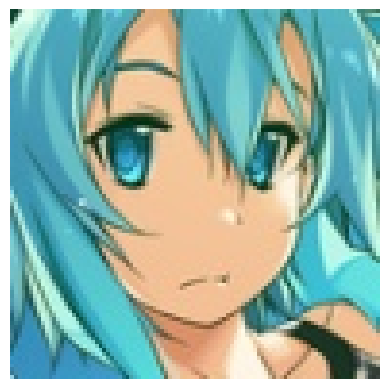

Label verdadera: Sinon-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Aqua-Konosuba : 40.01 % confianza.
> Sinon-Sword Art Online : 38.32 % confianza.
> Hatsune Miku-Vocaloid : 5.72 % confianza.
> C.C-Code Geass : 2.48 % confianza.
> Kirito-Sword Art Online : 0.99 % confianza.


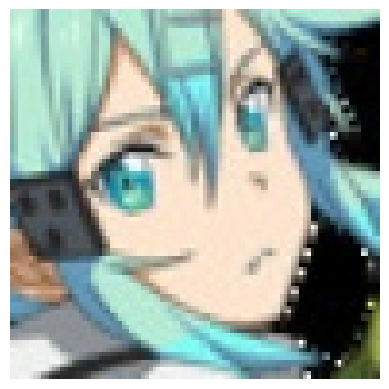

Label verdadera: Sinon-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Sinon-Sword Art Online : 98.78 % confianza.
> Aqua-Konosuba : 0.27 % confianza.
> Kirito-Sword Art Online : 0.20 % confianza.
> Fubuki-One Punch Man : 0.11 % confianza.
> Hatsune Miku-Vocaloid : 0.06 % confianza.


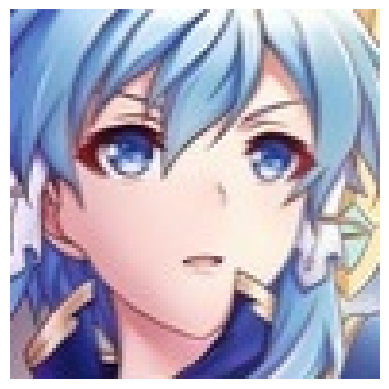

Label verdadera: Sinon-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Aqua-Konosuba : 69.23 % confianza.
> Sinon-Sword Art Online : 11.07 % confianza.
> Rem-Re Zero : 8.19 % confianza.
> Emilia-Re Zero : 1.70 % confianza.
> Cirno-Touhou : 1.18 % confianza.


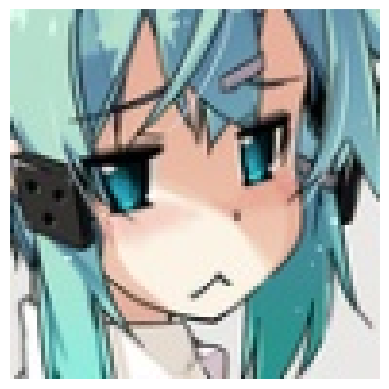

Label verdadera: Sinon-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Sinon-Sword Art Online : 96.52 % confianza.
> Aqua-Konosuba : 1.24 % confianza.
> Fubuki-One Punch Man : 0.34 % confianza.
> Kirito-Sword Art Online : 0.22 % confianza.
> Rem-Re Zero : 0.17 % confianza.


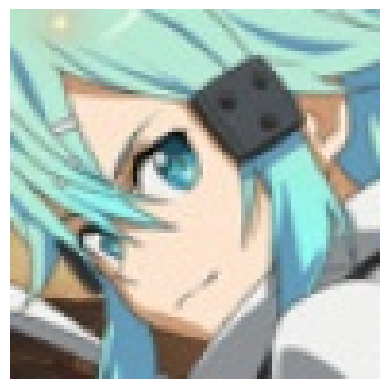

Label verdadera: Sinon-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 22ms/step
> Sinon-Sword Art Online : 97.46 % confianza.
> Aqua-Konosuba : 1.32 % confianza.
> Hatsune Miku-Vocaloid : 0.16 % confianza.
> Kirito-Sword Art Online : 0.16 % confianza.
> C.C-Code Geass : 0.14 % confianza.


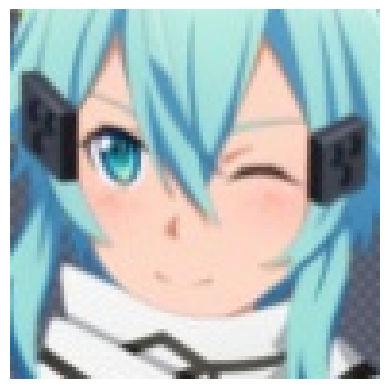

Label verdadera: Sinon-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Sinon-Sword Art Online : 96.29 % confianza.
> Aqua-Konosuba : 2.64 % confianza.
> Rem-Re Zero : 0.20 % confianza.
> Hatsune Miku-Vocaloid : 0.14 % confianza.
> Kirito-Sword Art Online : 0.12 % confianza.


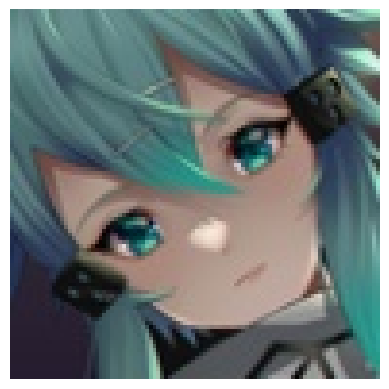

Label verdadera: Sinon-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 35ms/step
> Sinon-Sword Art Online : 93.34 % confianza.
> Kirito-Sword Art Online : 1.01 % confianza.
> Fubuki-One Punch Man : 0.89 % confianza.
> Nico Robin-One Piece : 0.87 % confianza.
> Gawr Gura-Hololive : 0.42 % confianza.


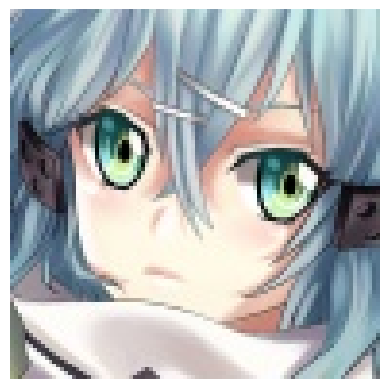

Label verdadera: Sinon-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Sinon-Sword Art Online : 92.87 % confianza.
> Aqua-Konosuba : 1.80 % confianza.
> Fubuki-One Punch Man : 0.85 % confianza.
> Cirno-Touhou : 0.47 % confianza.
> C.C-Code Geass : 0.42 % confianza.


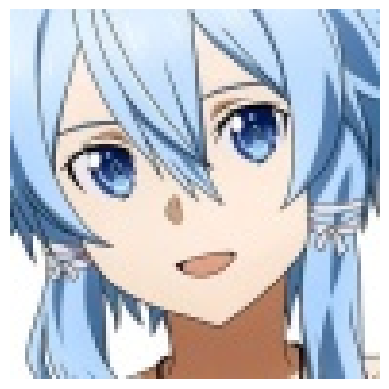

Label verdadera: Sinon-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Aqua-Konosuba : 50.42 % confianza.
> Sinon-Sword Art Online : 18.74 % confianza.
> Paimon-Genshin Impact : 11.63 % confianza.
> Cirno-Touhou : 2.96 % confianza.
> Emilia-Re Zero : 2.06 % confianza.


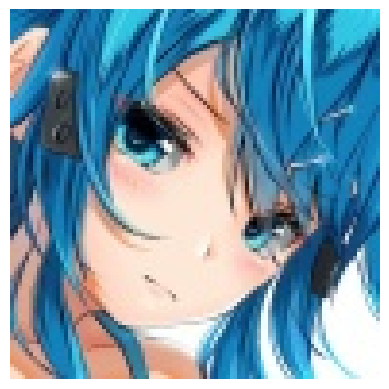

Label verdadera: Sinon-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Sinon-Sword Art Online : 47.60 % confianza.
> Aqua-Konosuba : 40.03 % confianza.
> Rem-Re Zero : 1.97 % confianza.
> Fubuki-One Punch Man : 1.88 % confianza.
> Gawr Gura-Hololive : 0.67 % confianza.


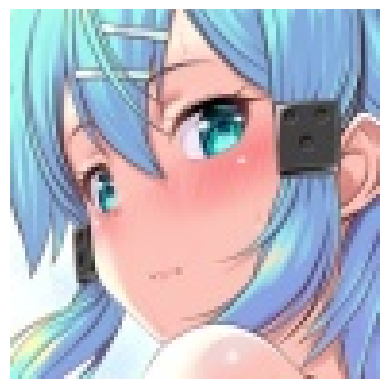

Label verdadera: Sinon-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Sinon-Sword Art Online : 64.61 % confianza.
> Aqua-Konosuba : 28.57 % confianza.
> Rem-Re Zero : 5.81 % confianza.
> Gawr Gura-Hololive : 0.10 % confianza.
> Nozomi Tojo-Love Live : 0.04 % confianza.


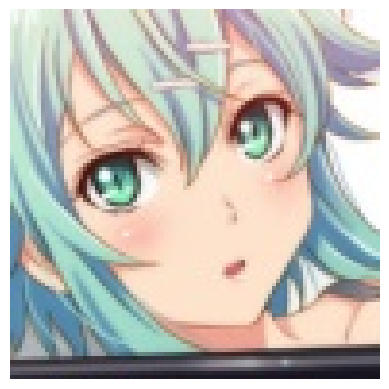

Label verdadera: Sinon-Sword Art Online
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Sinon-Sword Art Online : 75.95 % confianza.
> Aqua-Konosuba : 8.41 % confianza.
> C.C-Code Geass : 4.58 % confianza.
> Emilia-Re Zero : 1.63 % confianza.
> Rem-Re Zero : 0.74 % confianza.


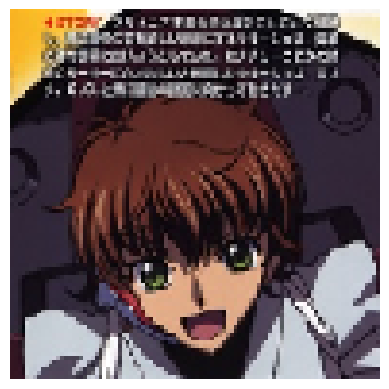

Label verdadera: Suzaku Kururugi-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 32ms/step
> Suzaku Kururugi-Code Geass : 98.77 % confianza.
> Lelouch Lamperouge-Code Geass : 0.27 % confianza.
> Saber-Fate : 0.06 % confianza.
> Reimu Hakurei-Touhou : 0.05 % confianza.
> Nozomi Tojo-Love Live : 0.05 % confianza.


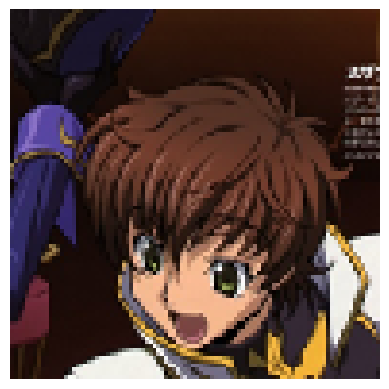

Label verdadera: Suzaku Kururugi-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Suzaku Kururugi-Code Geass : 97.03 % confianza.
> Saber-Fate : 0.32 % confianza.
> Lelouch Lamperouge-Code Geass : 0.27 % confianza.
> Shirley Fenette-Code Geass : 0.18 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.13 % confianza.


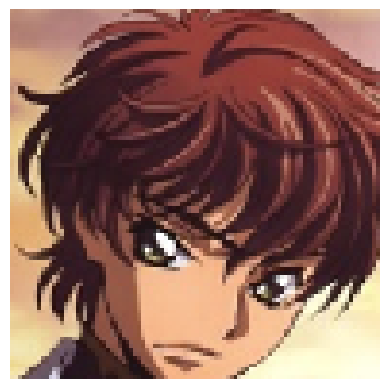

Label verdadera: Suzaku Kururugi-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Suzaku Kururugi-Code Geass : 84.05 % confianza.
> Reimu Hakurei-Touhou : 3.81 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 1.75 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.62 % confianza.
> Saber-Fate : 0.54 % confianza.


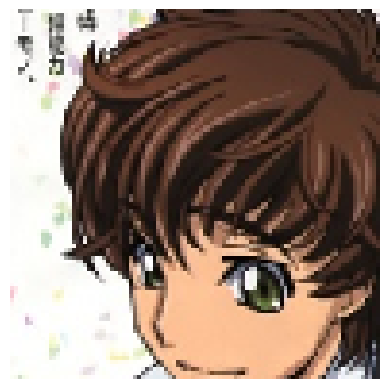

Label verdadera: Suzaku Kururugi-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Suzaku Kururugi-Code Geass : 92.89 % confianza.
> Reimu Hakurei-Touhou : 0.73 % confianza.
> Lelouch Lamperouge-Code Geass : 0.65 % confianza.
> Saber-Fate : 0.30 % confianza.
> Fubuki-One Punch Man : 0.28 % confianza.


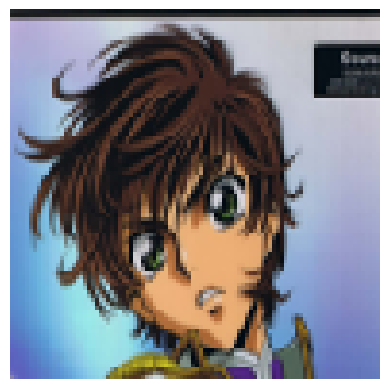

Label verdadera: Suzaku Kururugi-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Suzaku Kururugi-Code Geass : 98.28 % confianza.
> Lelouch Lamperouge-Code Geass : 0.32 % confianza.
> Saber-Fate : 0.19 % confianza.
> Shirley Fenette-Code Geass : 0.10 % confianza.
> Yoko Littner-Gurrenn Lagann : 0.08 % confianza.


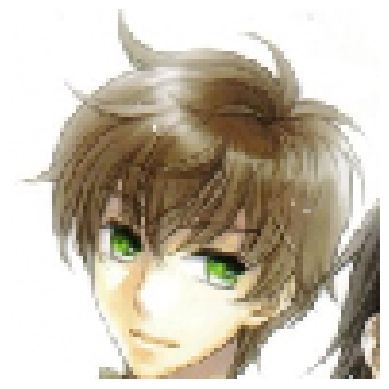

Label verdadera: Suzaku Kururugi-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Suzaku Kururugi-Code Geass : 96.23 % confianza.
> Saber-Fate : 0.46 % confianza.
> Fubuki-One Punch Man : 0.43 % confianza.
> Shirley Fenette-Code Geass : 0.19 % confianza.
> Lelouch Lamperouge-Code Geass : 0.18 % confianza.


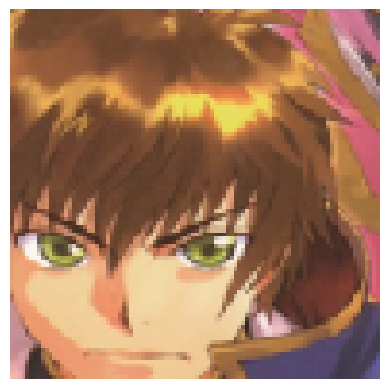

Label verdadera: Suzaku Kururugi-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Suzaku Kururugi-Code Geass : 68.07 % confianza.
> Lelouch Lamperouge-Code Geass : 12.32 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 2.79 % confianza.
> Reimu Hakurei-Touhou : 1.66 % confianza.
> Fubuki-One Punch Man : 1.16 % confianza.


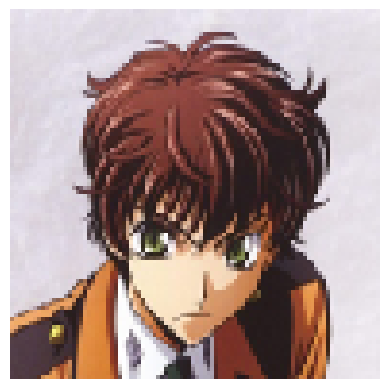

Label verdadera: Suzaku Kururugi-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Suzaku Kururugi-Code Geass : 96.02 % confianza.
> Lelouch Lamperouge-Code Geass : 0.49 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.43 % confianza.
> Saber-Fate : 0.22 % confianza.
> Reimu Hakurei-Touhou : 0.15 % confianza.


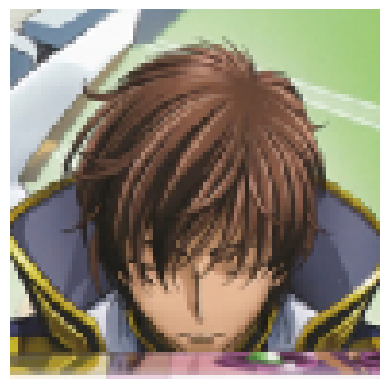

Label verdadera: Suzaku Kururugi-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Suzaku Kururugi-Code Geass : 90.95 % confianza.
> Lelouch Lamperouge-Code Geass : 2.62 % confianza.
> Reimu Hakurei-Touhou : 0.65 % confianza.
> Emilia-Re Zero : 0.51 % confianza.
> Gawr Gura-Hololive : 0.40 % confianza.


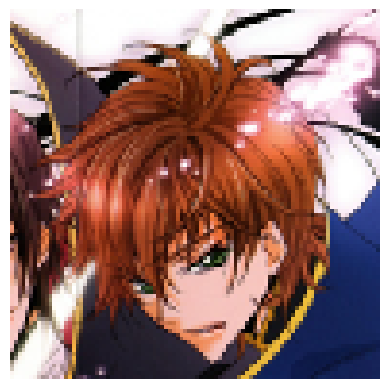

Label verdadera: Suzaku Kururugi-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Suzaku Kururugi-Code Geass : 94.86 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.64 % confianza.
> Saber-Fate : 0.57 % confianza.
> Yoko Littner-Gurrenn Lagann : 0.30 % confianza.
> Shirley Fenette-Code Geass : 0.30 % confianza.


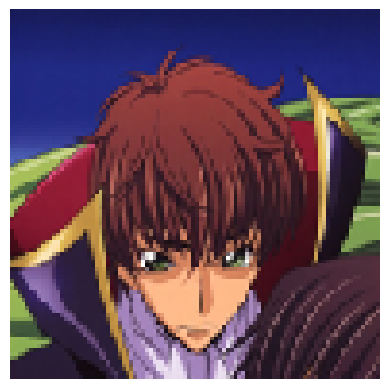

Label verdadera: Suzaku Kururugi-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 37ms/step
> Suzaku Kururugi-Code Geass : 80.04 % confianza.
> Reimu Hakurei-Touhou : 7.69 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 1.16 % confianza.
> Lelouch Lamperouge-Code Geass : 0.79 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.53 % confianza.


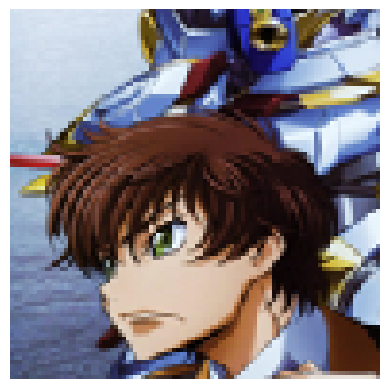

Label verdadera: Suzaku Kururugi-Code Geass
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Suzaku Kururugi-Code Geass : 94.52 % confianza.
> Lelouch Lamperouge-Code Geass : 1.98 % confianza.
> Shirley Fenette-Code Geass : 0.53 % confianza.
> Yui Hirasawa-K ON! : 0.34 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.24 % confianza.


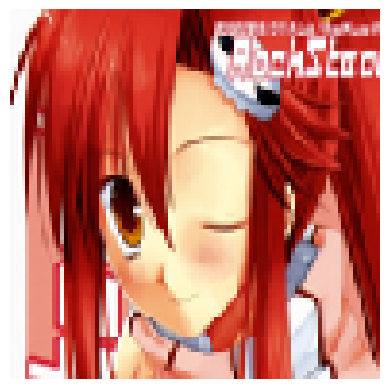

Label verdadera: Yoko Littner-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Yoko Littner-Gurrenn Lagann : 49.29 % confianza.
> Scarlet Remilia-Touhou : 4.40 % confianza.
> Maki Nishikino-Love Live : 2.73 % confianza.
> Kallen Stadtfeld-Code Geass : 2.35 % confianza.
> Kurisu Makise-Steins Gate : 2.20 % confianza.


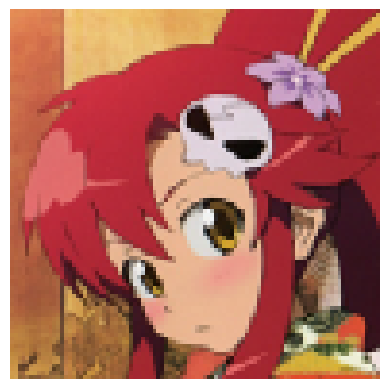

Label verdadera: Yoko Littner-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Yoko Littner-Gurrenn Lagann : 99.43 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 0.06 % confianza.
> Maki Nishikino-Love Live : 0.04 % confianza.
> Kallen Stadtfeld-Code Geass : 0.04 % confianza.
> Nia Teppelin-Gurrenn Lagann : 0.04 % confianza.


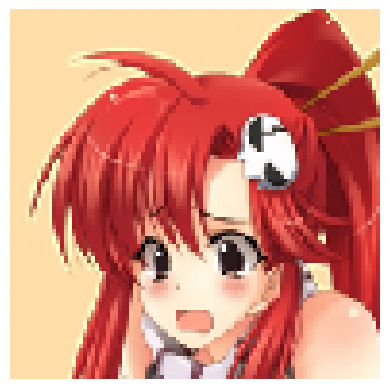

Label verdadera: Yoko Littner-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Yoko Littner-Gurrenn Lagann : 83.59 % confianza.
> Shirley Fenette-Code Geass : 3.30 % confianza.
> Kallen Stadtfeld-Code Geass : 2.72 % confianza.
> Yui Hirasawa-K ON! : 0.47 % confianza.
> Maka Albarn-Soul Eater : 0.35 % confianza.


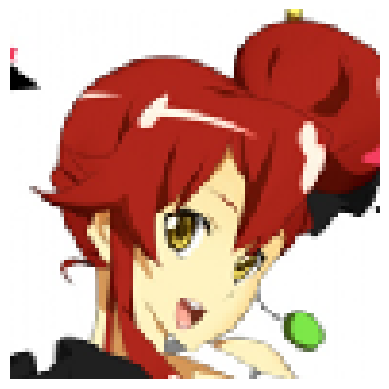

Label verdadera: Yoko Littner-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Yoko Littner-Gurrenn Lagann : 92.14 % confianza.
> Kallen Stadtfeld-Code Geass : 0.98 % confianza.
> Yui Hirasawa-K ON! : 0.42 % confianza.
> Maka Albarn-Soul Eater : 0.42 % confianza.
> Shirley Fenette-Code Geass : 0.38 % confianza.


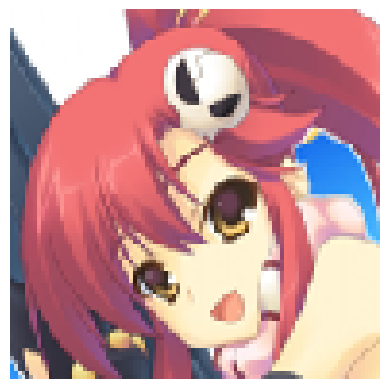

Label verdadera: Yoko Littner-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Yoko Littner-Gurrenn Lagann : 98.56 % confianza.
> Shirley Fenette-Code Geass : 0.17 % confianza.
> Scarlet Remilia-Touhou : 0.13 % confianza.
> Yui Hirasawa-K ON! : 0.11 % confianza.
> Nia Teppelin-Gurrenn Lagann : 0.10 % confianza.


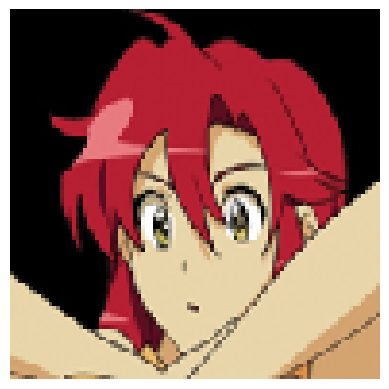

Label verdadera: Yoko Littner-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Yoko Littner-Gurrenn Lagann : 99.76 % confianza.
> Kallen Stadtfeld-Code Geass : 0.03 % confianza.
> Shirley Fenette-Code Geass : 0.02 % confianza.
> Scarlet Remilia-Touhou : 0.02 % confianza.
> Nezuko Kamado-Demon Slayer : 0.01 % confianza.


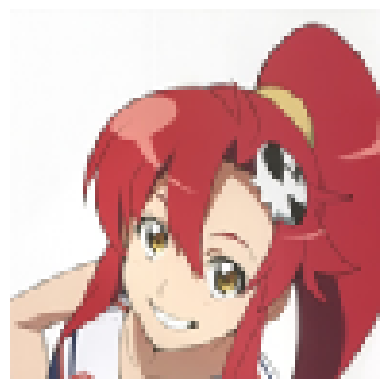

Label verdadera: Yoko Littner-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 29ms/step
> Yoko Littner-Gurrenn Lagann : 98.54 % confianza.
> Kallen Stadtfeld-Code Geass : 0.40 % confianza.
> Yui Hirasawa-K ON! : 0.15 % confianza.
> Kurisu Makise-Steins Gate : 0.07 % confianza.
> Shirley Fenette-Code Geass : 0.05 % confianza.


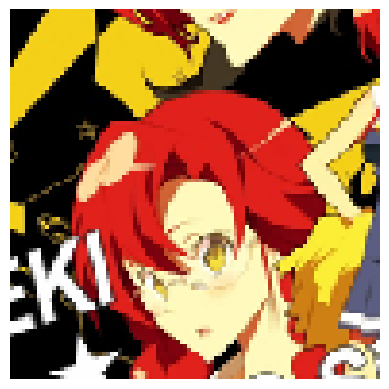

Label verdadera: Yoko Littner-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Yoko Littner-Gurrenn Lagann : 98.10 % confianza.
> Maka Albarn-Soul Eater : 0.16 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.11 % confianza.
> Kallen Stadtfeld-Code Geass : 0.08 % confianza.
> Flandre Scarlet-Touhou : 0.08 % confianza.


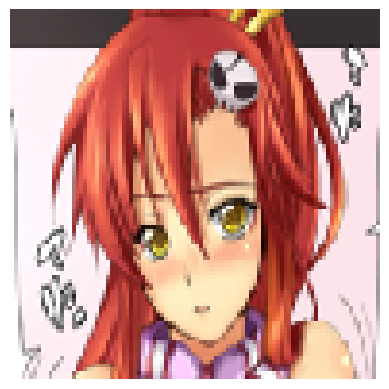

Label verdadera: Yoko Littner-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 34ms/step
> Shirley Fenette-Code Geass : 71.50 % confianza.
> Yoko Littner-Gurrenn Lagann : 10.90 % confianza.
> Kallen Stadtfeld-Code Geass : 6.61 % confianza.
> Suzaku Kururugi-Code Geass : 1.61 % confianza.
> Zero Two-Darling In the Franxx : 1.48 % confianza.


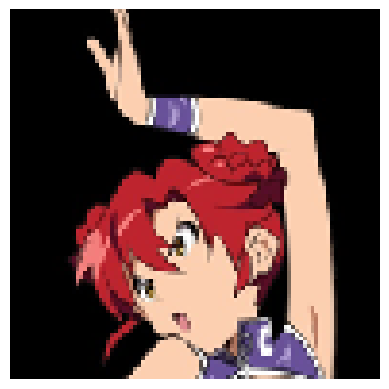

Label verdadera: Yoko Littner-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 32ms/step
> Yoko Littner-Gurrenn Lagann : 84.13 % confianza.
> Scarlet Remilia-Touhou : 1.06 % confianza.
> Megumin-Konosuba : 1.01 % confianza.
> Kallen Stadtfeld-Code Geass : 0.80 % confianza.
> Ouro Kronii-Hololive : 0.66 % confianza.


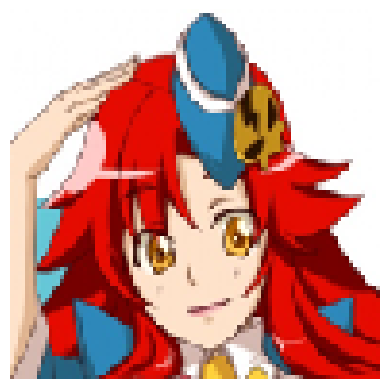

Label verdadera: Yoko Littner-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Yoko Littner-Gurrenn Lagann : 80.74 % confianza.
> Flandre Scarlet-Touhou : 2.12 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 1.94 % confianza.
> Reimu Hakurei-Touhou : 1.54 % confianza.
> Misato Katsuragi-Neon Genesis Evangelion : 0.88 % confianza.


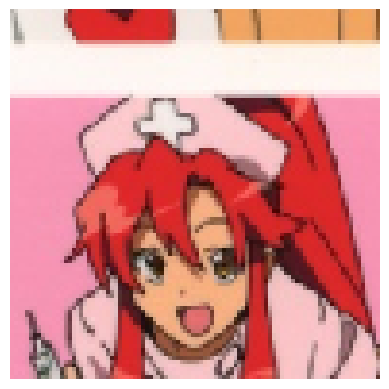

Label verdadera: Yoko Littner-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 32ms/step
> Yoko Littner-Gurrenn Lagann : 98.77 % confianza.
> Shirley Fenette-Code Geass : 0.14 % confianza.
> Nia Teppelin-Gurrenn Lagann : 0.13 % confianza.
> Scarlet Remilia-Touhou : 0.11 % confianza.
> Nezuko Kamado-Demon Slayer : 0.09 % confianza.


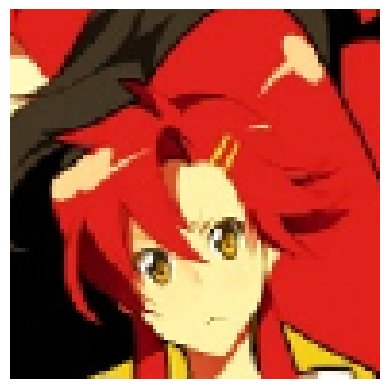

Label verdadera: Yoko Littner-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Yoko Littner-Gurrenn Lagann : 98.50 % confianza.
> Kallen Stadtfeld-Code Geass : 0.11 % confianza.
> Nia Teppelin-Gurrenn Lagann : 0.08 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.08 % confianza.
> Giorno Giovanna-JoJos Bizarre Adventure : 0.06 % confianza.


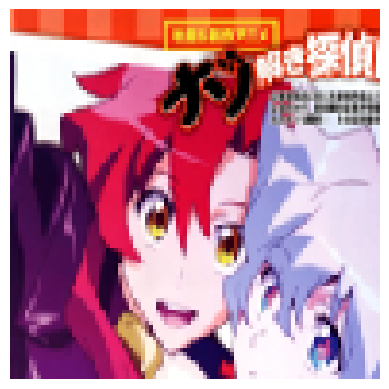

Label verdadera: Yoko Littner-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Scarlet Remilia-Touhou : 34.15 % confianza.
> Nia Teppelin-Gurrenn Lagann : 29.46 % confianza.
> Yoko Littner-Gurrenn Lagann : 24.36 % confianza.
> Sakuya Izayoi-Touhou : 1.37 % confianza.
> Konata Izumi-Lucky Star : 0.85 % confianza.


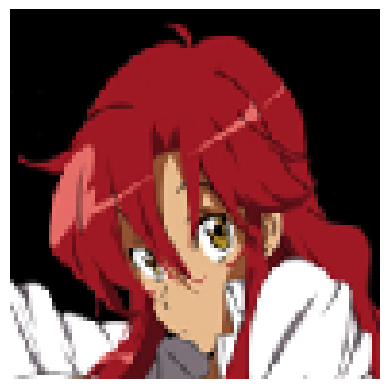

Label verdadera: Yoko Littner-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Yoko Littner-Gurrenn Lagann : 99.66 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.02 % confianza.
> Scarlet Remilia-Touhou : 0.02 % confianza.
> Kallen Stadtfeld-Code Geass : 0.02 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 0.02 % confianza.


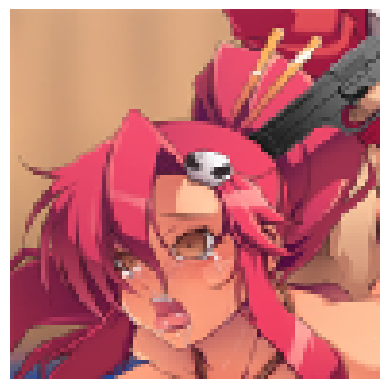

Label verdadera: Yoko Littner-Gurrenn Lagann
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Yoko Littner-Gurrenn Lagann : 95.49 % confianza.
> Kallen Stadtfeld-Code Geass : 0.71 % confianza.
> Reimu Hakurei-Touhou : 0.50 % confianza.
> Scarlet Remilia-Touhou : 0.34 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 0.27 % confianza.


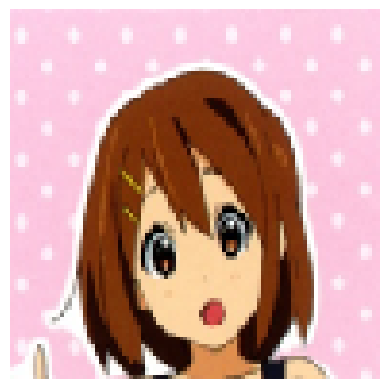

Label verdadera: Yui Hirasawa-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Yui Hirasawa-K ON! : 96.51 % confianza.
> Shirley Fenette-Code Geass : 0.32 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.29 % confianza.
> Kurisu Makise-Steins Gate : 0.27 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.24 % confianza.


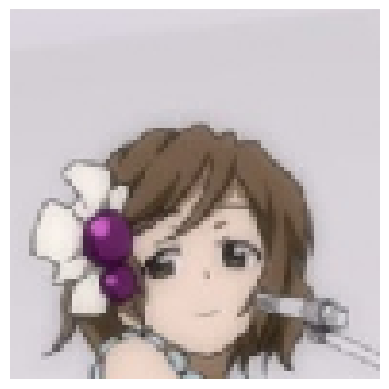

Label verdadera: Yui Hirasawa-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Yui Hirasawa-K ON! : 78.36 % confianza.
> Suzaku Kururugi-Code Geass : 1.99 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 1.65 % confianza.
> Shiki Ryougi-Garden of Sinners : 1.56 % confianza.
> Aisaka Taiga-Toradora : 1.14 % confianza.


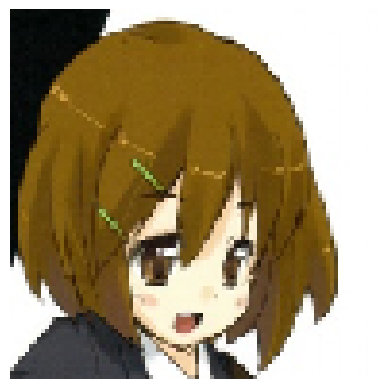

Label verdadera: Yui Hirasawa-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Yui Hirasawa-K ON! : 95.72 % confianza.
> Aisaka Taiga-Toradora : 1.58 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.20 % confianza.
> Shouko Komi-Komi Cant Communicate : 0.19 % confianza.
> Kotobuki Tsumugi-K ON! : 0.18 % confianza.


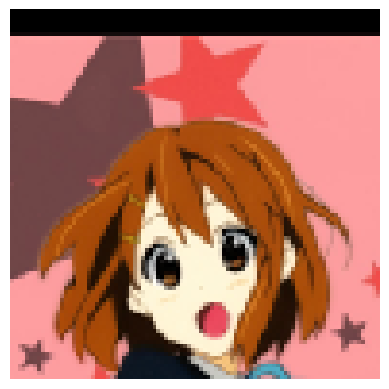

Label verdadera: Yui Hirasawa-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Yui Hirasawa-K ON! : 95.24 % confianza.
> Aisaka Taiga-Toradora : 1.03 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.63 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.42 % confianza.
> Yoko Littner-Gurrenn Lagann : 0.22 % confianza.


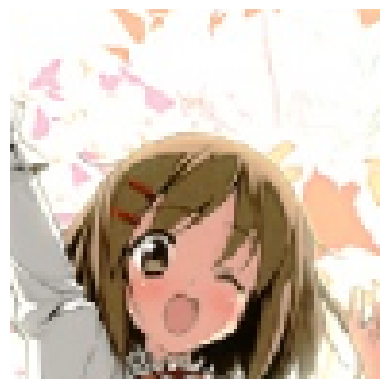

Label verdadera: Yui Hirasawa-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Shirley Fenette-Code Geass : 91.86 % confianza.
> Suzaku Kururugi-Code Geass : 1.24 % confianza.
> Maka Albarn-Soul Eater : 1.18 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 1.10 % confianza.
> Aisaka Taiga-Toradora : 0.83 % confianza.


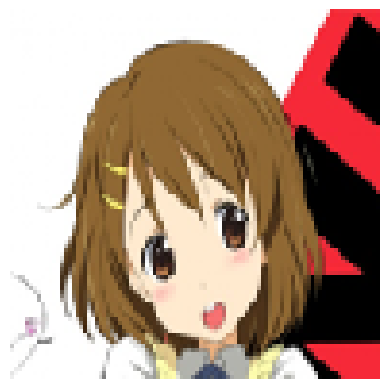

Label verdadera: Yui Hirasawa-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 23ms/step
> Yui Hirasawa-K ON! : 84.14 % confianza.
> Aisaka Taiga-Toradora : 5.77 % confianza.
> Kotobuki Tsumugi-K ON! : 1.09 % confianza.
> Shirley Fenette-Code Geass : 0.66 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 0.45 % confianza.


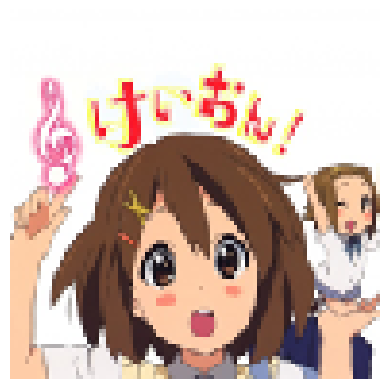

Label verdadera: Yui Hirasawa-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Yui Hirasawa-K ON! : 97.74 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.65 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.20 % confianza.
> Ritsu Tainaka-K ON! : 0.14 % confianza.
> Suzaku Kururugi-Code Geass : 0.11 % confianza.


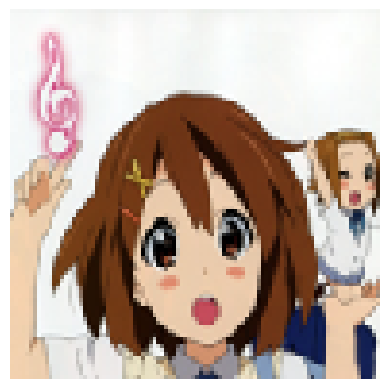

Label verdadera: Yui Hirasawa-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Yui Hirasawa-K ON! : 99.35 % confianza.
> Yoko Littner-Gurrenn Lagann : 0.06 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.05 % confianza.
> Ritsu Tainaka-K ON! : 0.05 % confianza.
> Aisaka Taiga-Toradora : 0.04 % confianza.


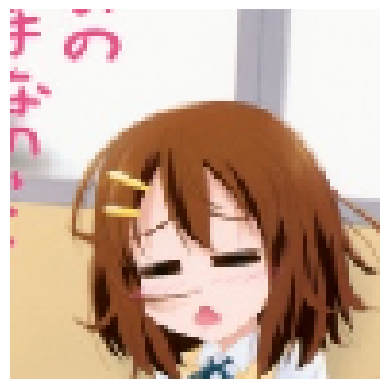

Label verdadera: Yui Hirasawa-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Yui Hirasawa-K ON! : 99.48 % confianza.
> Ritsu Tainaka-K ON! : 0.11 % confianza.
> Shiki Ryougi-Garden of Sinners : 0.05 % confianza.
> Kurisu Makise-Steins Gate : 0.04 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.03 % confianza.


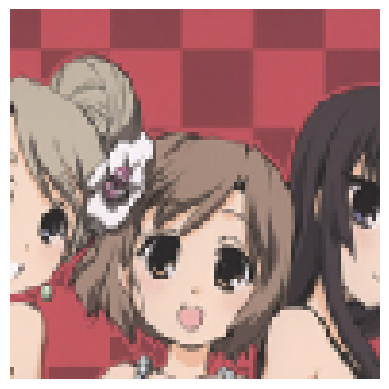

Label verdadera: Yui Hirasawa-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 34ms/step
> Maka Albarn-Soul Eater : 17.71 % confianza.
> Yui Hirasawa-K ON! : 17.10 % confianza.
> Reimu Hakurei-Touhou : 13.95 % confianza.
> Rin Tohsakaka-Fate : 11.91 % confianza.
> Aisaka Taiga-Toradora : 7.12 % confianza.


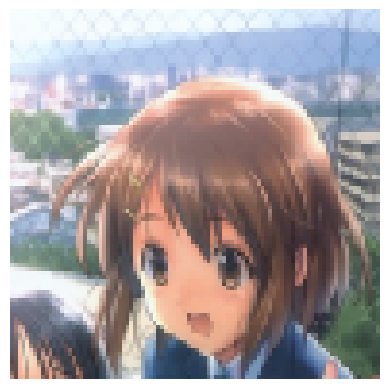

Label verdadera: Yui Hirasawa-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 37ms/step
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 54.31 % confianza.
> Suzaku Kururugi-Code Geass : 15.20 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 5.73 % confianza.
> Yui Hirasawa-K ON! : 3.41 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 2.88 % confianza.


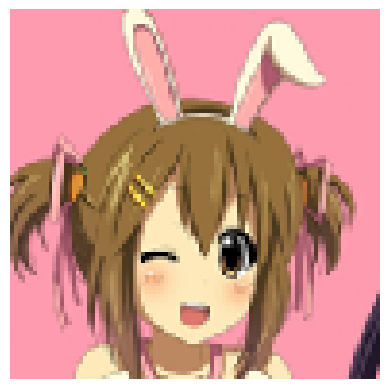

Label verdadera: Yui Hirasawa-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Aisaka Taiga-Toradora : 41.69 % confianza.
> Yui Hirasawa-K ON! : 30.41 % confianza.
> Shinji Ikari-Neon Genesis Evangelion : 3.40 % confianza.
> Reimu Hakurei-Touhou : 3.30 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 2.52 % confianza.


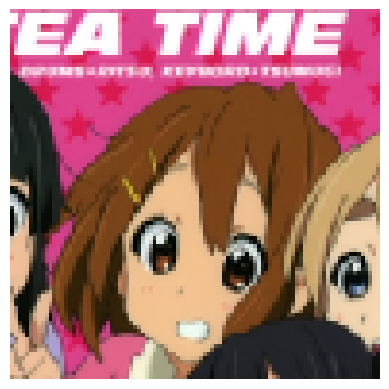

Label verdadera: Yui Hirasawa-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Yui Hirasawa-K ON! : 97.36 % confianza.
> Ritsu Tainaka-K ON! : 0.59 % confianza.
> Haruhi Suzumiya-The Melancholy of Haruhi Suzumiya : 0.24 % confianza.
> Kirito-Sword Art Online : 0.17 % confianza.
> Kotobuki Tsumugi-K ON! : 0.13 % confianza.


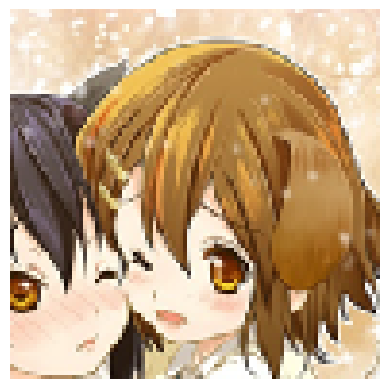

Label verdadera: Yui Hirasawa-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 33ms/step
> Yui Hirasawa-K ON! : 39.91 % confianza.
> Reimu Hakurei-Touhou : 14.23 % confianza.
> Aisaka Taiga-Toradora : 13.59 % confianza.
> Asuka Langley Souryuu-Neon Genesis Evangelion : 5.32 % confianza.
> Suzaku Kururugi-Code Geass : 5.00 % confianza.


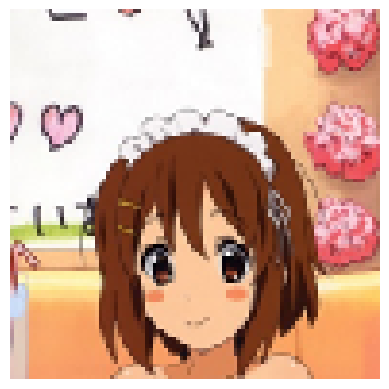

Label verdadera: Yui Hirasawa-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 40ms/step
> Yui Hirasawa-K ON! : 96.73 % confianza.
> Ritsu Tainaka-K ON! : 0.36 % confianza.
> Yoko Littner-Gurrenn Lagann : 0.29 % confianza.
> Kurisu Makise-Steins Gate : 0.24 % confianza.
> Shirley Fenette-Code Geass : 0.21 % confianza.


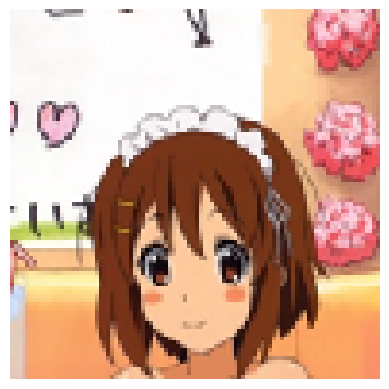

Label verdadera: Yui Hirasawa-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 37ms/step
> Yui Hirasawa-K ON! : 96.51 % confianza.
> Ritsu Tainaka-K ON! : 0.35 % confianza.
> Shirley Fenette-Code Geass : 0.33 % confianza.
> Yoko Littner-Gurrenn Lagann : 0.31 % confianza.
> Kurisu Makise-Steins Gate : 0.25 % confianza.


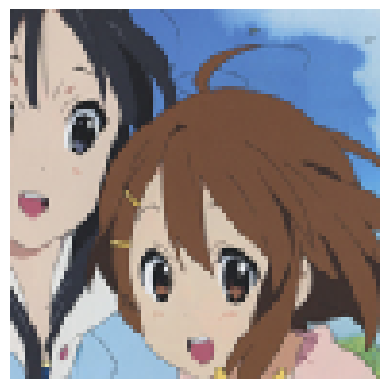

Label verdadera: Yui Hirasawa-K ON!
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Yui Hirasawa-K ON! : 83.32 % confianza.
> Aisaka Taiga-Toradora : 1.14 % confianza.
> Kurisu Makise-Steins Gate : 0.88 % confianza.
> Kirito-Sword Art Online : 0.81 % confianza.
> Kotobuki Tsumugi-K ON! : 0.71 % confianza.


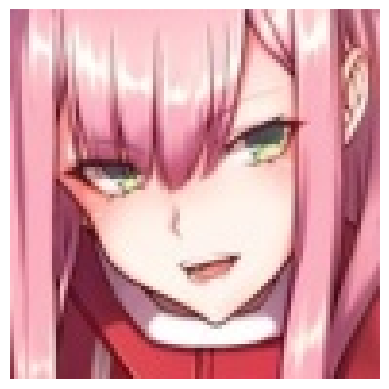

Label verdadera: Zero Two-Darling In the Franxx
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Zero Two-Darling In the Franxx : 92.27 % confianza.
> Astolfo-Fate : 2.59 % confianza.
> Miku Nakano-Quintessential Quintuplets : 2.16 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.99 % confianza.
> Albedo-Overlord : 0.29 % confianza.


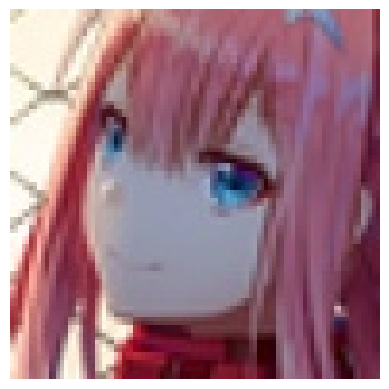

Label verdadera: Zero Two-Darling In the Franxx
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Nino Nakano-Quintessential Quintuplets : 80.10 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 4.97 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 3.40 % confianza.
> Hifumi Takimoto-New Game! : 2.35 % confianza.
> Sakura Matou-Fate : 0.92 % confianza.


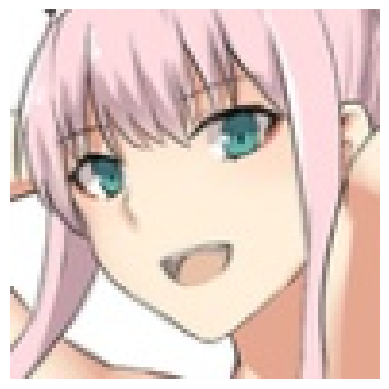

Label verdadera: Zero Two-Darling In the Franxx
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Zero Two-Darling In the Franxx : 76.11 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 13.02 % confianza.
> Saber-Fate : 1.90 % confianza.
> Nozomi Tojo-Love Live : 1.46 % confianza.
> Sakuya Izayoi-Touhou : 0.71 % confianza.


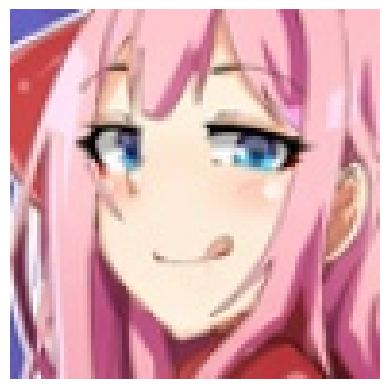

Label verdadera: Zero Two-Darling In the Franxx
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Chika Fujiwara-Kaguya Sama Love Is War : 64.82 % confianza.
> Nino Nakano-Quintessential Quintuplets : 27.98 % confianza.
> Zero Two-Darling In the Franxx : 4.00 % confianza.
> Hifumi Takimoto-New Game! : 0.70 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 0.32 % confianza.


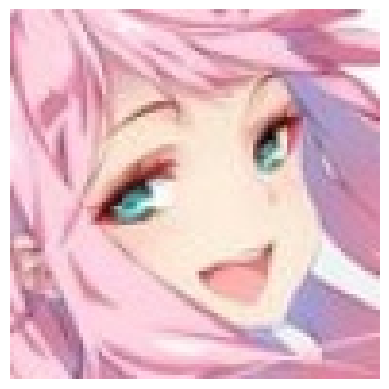

Label verdadera: Zero Two-Darling In the Franxx
Este personaje posiblemente es:
1/1 [==============================] - 0s 27ms/step
> Zero Two-Darling In the Franxx : 89.15 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 5.17 % confianza.
> Nozomi Tojo-Love Live : 1.48 % confianza.
> Ram-Re Zero : 1.04 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.52 % confianza.


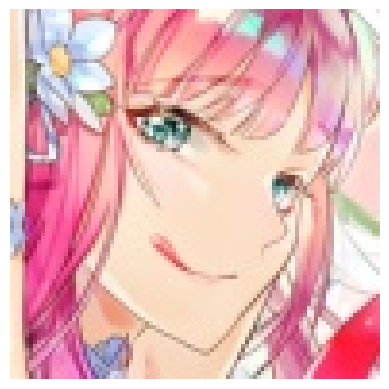

Label verdadera: Zero Two-Darling In the Franxx
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Nino Nakano-Quintessential Quintuplets : 67.31 % confianza.
> Zero Two-Darling In the Franxx : 23.16 % confianza.
> Fubuki-One Punch Man : 3.22 % confianza.
> Saber-Fate : 1.60 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.70 % confianza.


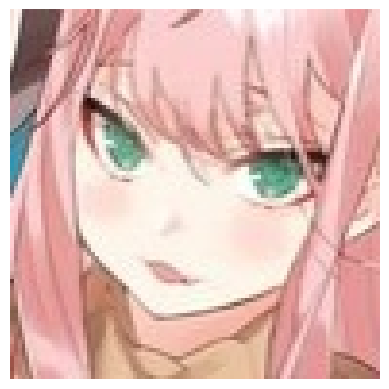

Label verdadera: Zero Two-Darling In the Franxx
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Zero Two-Darling In the Franxx : 98.80 % confianza.
> Miku Nakano-Quintessential Quintuplets : 0.21 % confianza.
> Fubuki-One Punch Man : 0.17 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.17 % confianza.
> Astolfo-Fate : 0.10 % confianza.


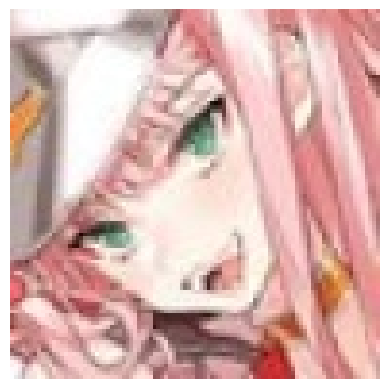

Label verdadera: Zero Two-Darling In the Franxx
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Zero Two-Darling In the Franxx : 97.68 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 0.36 % confianza.
> Astolfo-Fate : 0.35 % confianza.
> Fubuki-One Punch Man : 0.30 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.28 % confianza.


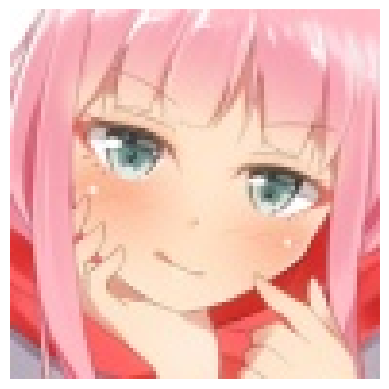

Label verdadera: Zero Two-Darling In the Franxx
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Zero Two-Darling In the Franxx : 71.39 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 22.69 % confianza.
> Nozomi Tojo-Love Live : 2.96 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.76 % confianza.
> Saber-Fate : 0.18 % confianza.


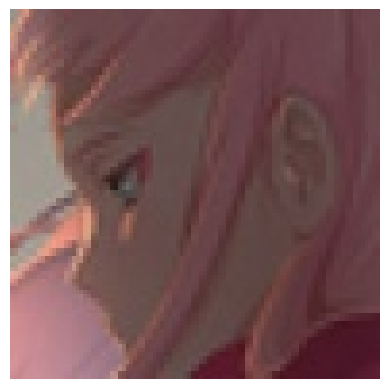

Label verdadera: Zero Two-Darling In the Franxx
Este personaje posiblemente es:
1/1 [==============================] - 0s 28ms/step
> Kurisu Makise-Steins Gate : 22.66 % confianza.
> Albedo-Overlord : 17.26 % confianza.
> Fubuki-One Punch Man : 16.64 % confianza.
> Miku Nakano-Quintessential Quintuplets : 6.93 % confianza.
> Hinata Hyuuga-Naruto : 6.38 % confianza.


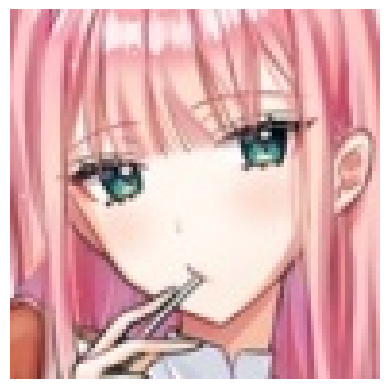

Label verdadera: Zero Two-Darling In the Franxx
Este personaje posiblemente es:
1/1 [==============================] - 0s 25ms/step
> Zero Two-Darling In the Franxx : 92.94 % confianza.
> Nino Nakano-Quintessential Quintuplets : 2.63 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 2.07 % confianza.
> Itsuki Nakano-Quintessential Quintuplets : 0.30 % confianza.
> Fubuki-One Punch Man : 0.24 % confianza.


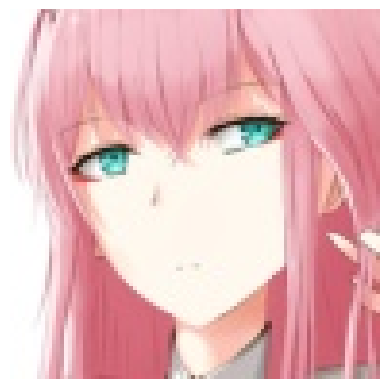

Label verdadera: Zero Two-Darling In the Franxx
Este personaje posiblemente es:
1/1 [==============================] - 0s 24ms/step
> Zero Two-Darling In the Franxx : 96.51 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.75 % confianza.
> Fubuki-One Punch Man : 0.60 % confianza.
> Nozomi Tojo-Love Live : 0.34 % confianza.
> Hifumi Takimoto-New Game! : 0.16 % confianza.


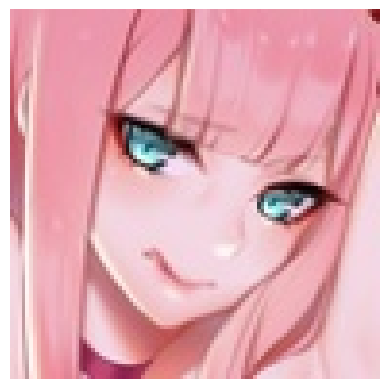

Label verdadera: Zero Two-Darling In the Franxx
Este personaje posiblemente es:
1/1 [==============================] - 0s 30ms/step
> Zero Two-Darling In the Franxx : 96.93 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 2.07 % confianza.
> Nino Nakano-Quintessential Quintuplets : 0.19 % confianza.
> Astolfo-Fate : 0.10 % confianza.
> Nozomi Tojo-Love Live : 0.08 % confianza.


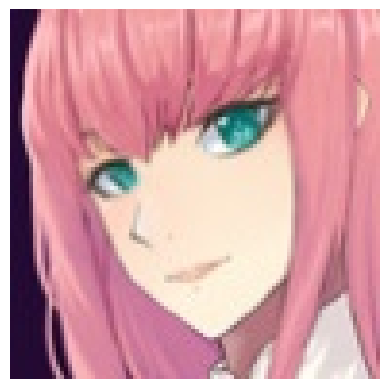

Label verdadera: Zero Two-Darling In the Franxx
Este personaje posiblemente es:
1/1 [==============================] - 0s 31ms/step
> Zero Two-Darling In the Franxx : 82.92 % confianza.
> Nino Nakano-Quintessential Quintuplets : 6.23 % confianza.
> Hifumi Takimoto-New Game! : 1.42 % confianza.
> Nozomi Tojo-Love Live : 1.20 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 1.08 % confianza.


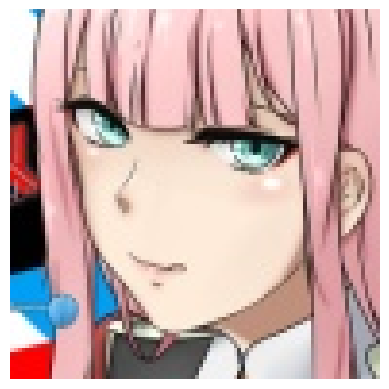

Label verdadera: Zero Two-Darling In the Franxx
Este personaje posiblemente es:
1/1 [==============================] - 0s 26ms/step
> Zero Two-Darling In the Franxx : 84.04 % confianza.
> Fubuki-One Punch Man : 4.40 % confianza.
> Nozomi Tojo-Love Live : 2.72 % confianza.
> Jonathan Joestar-Jojos Bizarre Adventure : 2.17 % confianza.
> Chika Fujiwara-Kaguya Sama Love Is War : 0.88 % confianza.


In [49]:
# Se define una funcion para probar el modelo con los personajes que hay en el dataset y predecir la confianza con los que el modelo los clasifica 
# Se utilizara el directorio test para probar el modelo

def predecir_personajes(src):
    # Esta funcion recibe el directorio donde estan las imagenes que se utilizaran para probar el modelo

    personajes = os.listdir(src)
    for personaje in personajes:
        archivos = os.listdir(src + '/' + personaje)
        for imagen_personaje in archivos:
            img_f = src + '/' + personaje + '/' + imagen_personaje
            img = tf.keras.utils.load_img(
                img_f , target_size=IMAGE_SIZE
            )
            img_array = tf.keras.utils.img_to_array(img)
            img_array = tf.expand_dims(img_array, 0) # Se crea un batch

            img_array = normalization_layer(img_array)

            imagen = img_array[0,:,:,:]
            plt.imshow(imagen)
            plt.axis('off')
            plt.show()
            
            print(f"Label verdadera: {personaje}")
            
            print("Este personaje posiblemente es:")
            predicciones = model.predict(img_array)

            score = tf.nn.softmax(predicciones[0])

            index_predecido = np.argsort(score)[-5:][::-1]
            
            for index in index_predecido:
                score_prediccion = (100 * score[index])

                print(
                    f"> {class_names[index]} : {score_prediccion:.2f} % confianza."
                )

predecir_personajes(test_data_dir)

In [45]:
# Se especifica la ruta donde se desea guardar el modelo
ruta_guardado = "modelo_guardado"

# Guarda el modelo como un SavedModel
model.save(ruta_guardado)

INFO:tensorflow:Assets written to: modelo_guardado\assets


INFO:tensorflow:Assets written to: modelo_guardado\assets


In [46]:
import tensorflow as tf

# Especifica la ruta donde esta el modelo
ruta_guardado = "modelo_guardado"

# Carga el modelo
modelo_cargado = tf.keras.models.load_model(ruta_guardado)